# 画图

In [2]:
%matplotlib notebook
import imp, time
import os
from pathlib import Path
from collections import Counter, OrderedDict, defaultdict, deque, namedtuple
import matplotlib.pyplot as plt
import numpy as np, sympy as sy
from sklearn.cluster import KMeans
from scipy import constants as const, signal
from scipy.fftpack import fft, hilbert, ifft
from scipy.optimize import curve_fit
from scipy.optimize import least_squares as ls, curve_fit, basinhopping as bh
from sympy import diff, symbols, jn
import pandas as pd, seaborn as sns
from numba import jit
import qulab.yhs.optimize, scipy
from qulab.yhs import waveform_new, data2imag, measureroutine_population, computewave_wave, dataTools
from qulab.storage.utils import save
from qulab.yhs import imatrix as im 

mrw = imp.reload(measureroutine_population)
op = imp.reload(qulab.yhs.optimize)
wn = imp.reload(waveform_new)
di = imp.reload(data2imag)
cww = imp.reload(computewave_wave)
dt = imp.reload(dataTools)
read = di.read
write = di.write

In [105]:
qubit = q2
volt_ex, vtarget = dt.biasshift(qubit.specfuncz,qubit.f_ex/1e9,-610e6/1e9,side='higher') 
volt_ex

0.20008194893646525

In [13]:
base = np.array([57.46019555+19.62797153j, 43.58449635+12.51846508j])

In [42]:
np.zeros((5,2),dtype='complex')

array([[0.+0.j, 0.+0.j],
       [0.+0.j, 0.+0.j],
       [0.+0.j, 0.+0.j],
       [0.+0.j, 0.+0.j],
       [0.+0.j, 0.+0.j]])

In [43]:
pop_m = np.ones((5,2),dtype='complex')
for i,j in enumerate(base):
    pop_m[:,i]= pop_m[:,i]*float(base[i])


C:\WPy64-3740\python-3.7.4.amd64\lib\site-packages\ipykernel_launcher.py:3: ComplexWarning: Casting complex values to real discards the imaginary part
  This is separate from the ipykernel package so we can avoid doing imports until


In [10]:
d = np.arange(0,1,0.001)
np.mean(d)
type(d)

numpy.ndarray

<IPython.core.display.Javascript object>


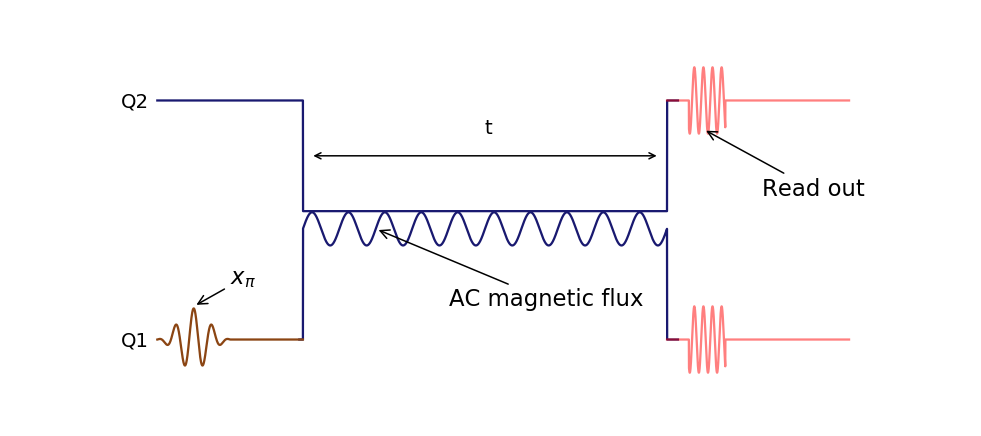

In [1187]:
color = 'midnightblue'
t = np.linspace(-5000,5000,20000)*1e-9
wav = wn.square(5000*1e-9)*0.5
wav1 = wn.square(5000*1e-9)*0.5
wav_ex = wn.gaussian(1000e-9)*0.15 << 4000e-9
wav_r = wn.square(500e-9)*0.15 >> 3050e-9
wav_rI, wav_rQ = wn.mixing(wav_r,phase=0.0,freq=8e6,ratioIQ=-1.0)
wav_exI, wav_exQ = wn.mixing(wav_ex,phase=0.0,freq=4e6,ratioIQ=-1.0)
wav_I, wav_Q = wn.mixing(wav,phase=0.0,freq=2e6,ratioIQ=-1.0)
plt.figure(figsize=(9,4))
plt.plot(t[4900:-4700],(wav+0.15*wav_Q)(t[4900:-4700])-0.55,color=color)
# plt.plot(t[5000:-5000],0.1*wav_Q(t[5000:-5000])-0.05,color)
line, =plt.plot(t[1000:5000],wav_exI(t[1000:5000])-0.55,'saddlebrown')
plt.plot(t[15000:],wav_rI(t[15000:])-0.55,'r',alpha=0.5)

plt.plot(t[1000:-4700],np.abs(wav1(t[1000:-4700])-0.53),color)
# plt.plot(t[1000:5000],wav_exI(t[1000:5000])+0.53,'saddlebrown')
plt.plot(t[15000:],wav_rI(t[15000:])+0.53,'r',alpha=0.5)
plt.text(-5e-6,0.5,str('Q2'),fontsize=fontsize)
plt.text(-5e-6,-0.58,str('Q1'),fontsize=fontsize)
plt.text(0,0.38,str('t'),fontsize=fontsize)
# plt.ylim(-2, 2)
plt.axis('off')


plt.annotate('$x_{\pi}$',
            xy=(-4e-6, -0.4), xycoords='data',
            xytext=(-3.5e-6, -0.3), textcoords='data',
            arrowprops=dict(arrowstyle="->",
                            connectionstyle="arc3"),size=15
            )
plt.annotate('AC magnetic flux',
            xy=(-1.5e-6, -0.05), xycoords='data',
            xytext=(-0.5e-6, -0.4), textcoords='data',
            arrowprops=dict(arrowstyle="->",
                            connectionstyle="arc3"),size=15
            )
plt.annotate('Read out',
            xy=(3e-6, 0.4), xycoords='data',
            xytext=(3.8e-6, 0.1), textcoords='data',
            arrowprops=dict(arrowstyle="->",
                            connectionstyle="arc3"),size=15
            )
plt.annotate('',
            xy=(-2.4e-6, 0.28), xycoords='data',
            xytext=(2.4e-6, 0.28), textcoords='data',
            arrowprops=dict(arrowstyle="<->",
                            connectionstyle="arc3"),
            )
plt.show()
plt.savefig(r'D:\skzhao\fig\waveseq.pdf',dpi=1200)
# plt.arrow(0, 0, 5e-3, 5e-3, head_width=0.05e-6, head_length=0.1e-6, fc='k', ec='k')

<IPython.core.display.Javascript object>


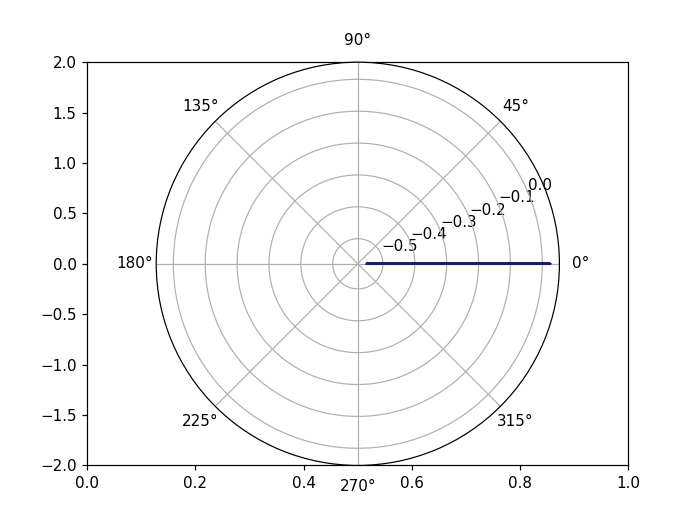

In [1137]:
import numpy as np
import matplotlib.pyplot as plt

fig, ax = plt.subplots()

t = np.arange(0.0, 5.0, 0.01)
s = np.cos(2*np.pi*t)
line, = ax.plot(t, s, lw=2)

ax.annotate('local max', xy=(2, 1), xytext=(3, 1.5),
            arrowprops=dict(facecolor='black', shrink=0.05),
            )
ax.set_ylim(-2, 2)
plt.show()

In [212]:
np.mean(wave[0])

-0.0007720671501920583

In [203]:
wave

(array([8.86770384e-06, 8.87959783e-06, 8.86769649e-06, ...,
        8.87961769e-06, 8.86771119e-06, 8.87960776e-06]),)

In [3]:
x = Record.objects(title='S21vsFlux').order_by('-finished_time')[0]
x

Record(title=S21vsFlux, finished_time=2020-08-05 17:05:19.470959, tags=['q1'])

In [4]:
data, ID, comment, tags, name, finishtime = read(title='S21vsFlux_awgoffset',which=0)
np.shape(data[2])

(21, 201, 10)

## 保存qubit工作点

In [2482]:
qstate = []
def tuple2dict(q):
    for i in q:
        qstate.append(i.asdict())
    return qstate

bit = [q1,q2,q3,q4,q5,q6,q7,q8,q9,q10]
filepath = save('QubitState','qubitstate',state = tuple2dict(bit),base_path=r'D:\skzhao\file_name\wave')
with open(r'D:\skzhao\file_name\qubit_state_wave.txt', mode='a') as filename:
    filename.write(str(filepath))
    filename.write('\n')
print(filepath)

D:\skzhao\file_name\wave\2021\0504\QubitState_20210504154426.npz


## 提取qubit工作点

In [68]:
fl = np.loadtxt(r'D:\skzhao\file_name\qubit_state_wave.txt',dtype='str')
f = str(fl[-1])
# f = r'D:\skzhao\file_name\wave\2021\0330\QubitState_20210330103852.npz'
data = np.load(f,allow_pickle=True)
def dict2tuple(q):
    for i,k in enumerate(q):
        attr = {}
        for j in mrw.qubit().asdict():
            if j in k:
                attr[j] = k[j]
            else:
                attr[j] = None
        globals()[k['q_name']] = mrw.qubit(**attr)

dict2tuple(data['state'])
print(f)

D:\skzhao\file_name\wave\2021\0714\q1-10-otoc_20210714101547.npz


In [7]:
q1.envelopename

['gaussian', 2]

In [1267]:
x = {}
for i in range(10):
    x[f'q{i+1}'] = [globals()[f'q{i+1}'].imAmp/2/np.pi,globals()[f'q{i+1}'].imAmpn/2/np.pi]
x

{'q1': [0.23157044219870773, 0.45827074313880345],
 'q2': [0.0, 0.0],
 'q3': [-0.2249177655774665, -0.44286454464750796],
 'q4': [0.0, 0.0],
 'q5': [0.23712494971261486, 0.4687590538885594],
 'q6': [0.0, 0.0],
 'q7': [-0.22859424476288925, -0.4479734183207579],
 'q8': [0.0, 0.0],
 'q9': [0.23063142803446554, 0.45578792602656987],
 'q10': [0.0, 0.0]}

In [36]:
q1.f_ex

4453793388.429752

In [87]:
qubitlist = [q1,q2,q3,q4,q5,q6,q7,q8,q9,q10]
q = {i.q_name:i for i in qubitlist}
amp = {i:q[i].delta_ex for i in q}
amp

{'q1': 100000000.0,
 'q2': 300000000.0,
 'q3': 100000000.0,
 'q4': 100000000.0,
 'q5': 100000000.0,
 'q6': 300000000.0,
 'q7': -80000000.0,
 'q8': 100000000.0,
 'q9': 100000000.0,
 'q10': -100000000.0}

<IPython.core.display.Javascript object>


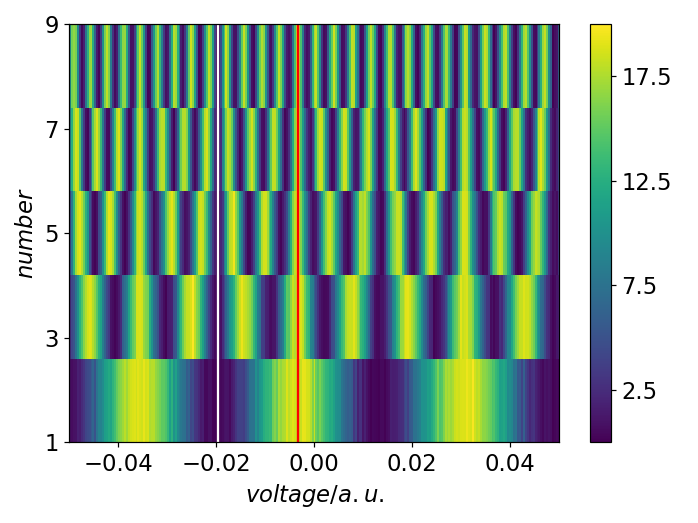

In [392]:
fig = plt.figure()
fig.subplots_adjust(top=0.85,bottom=0.15,hspace=0.5)
fontsize = 15
x, y, z = value[0][0], value[0][1], value[0][2]
extent = [min(y),max(y),min(x),max(x)]
plt.imshow(np.abs(z),origin='lower',aspect='auto',extent=extent)
plt.vlines(-0.00334949,1,9,'r')
plt.vlines(-0.0196692,1,9,'w')
cb = plt.colorbar(ticks=[2.5,7.5,12.5,17.5])
cb.ax.tick_params(labelsize=fontsize) 
plt.yticks(x)
plt.xlabel('$voltage/a.u.$',fontsize=fontsize)
plt.ylabel('$number$',fontsize=fontsize)
plt.xticks(fontsize=fontsize)
plt.yticks(fontsize=fontsize)
fig.tight_layout()
plt.savefig(r'D:\skzhao\fig\gate.pdf',dpi=1200)

# 查看图形

<IPython.core.display.Javascript object>


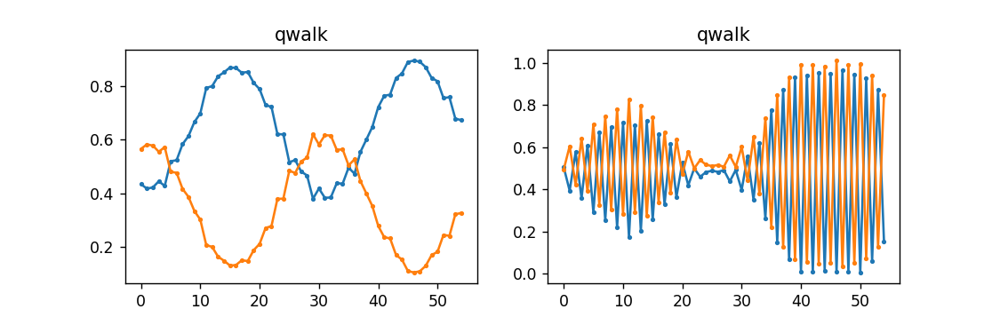

['q2', 'q1'] 2021-07-14 22:46:40.598116


In [260]:
value,num,tags,finishtime = write(title=None,height=3,which=0,peak=11200,transposition=True,dB=False,dePhase=True)
print(tags,finishtime)

<IPython.core.display.Javascript object>


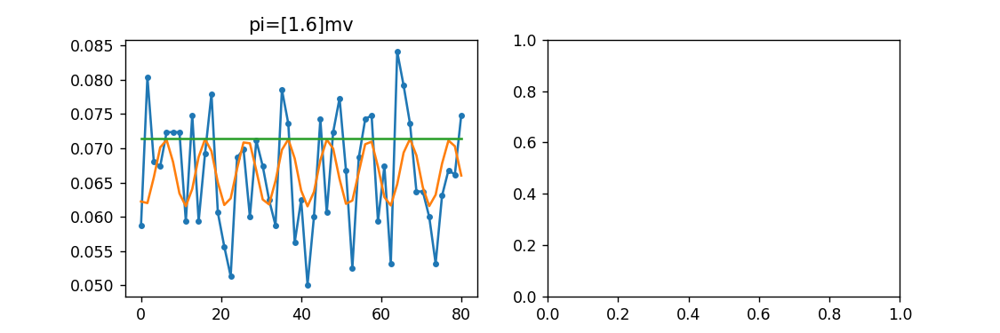

d:\qulab\qulab\yhs\optimize.py:267: RuntimeWarning: overflow encountered in square
  return np.sum((A * np.exp(-x*T1) + B - y)**2)
d:\qulab\qulab\yhs\optimize.py:267: RuntimeWarning: overflow encountered in exp
  return np.sum((A * np.exp(-x*T1) + B - y)**2)
d:\qulab\qulab\yhs\optimize.py:267: RuntimeWarning: overflow encountered in multiply
  return np.sum((A * np.exp(-x*T1) + B - y)**2)


(0.017006802721088413, 0.06928846492419846, 20000, 0.0980392156862745, 0)


In [179]:
x = value[0][0]
y = value[0][2][:,0]
fig, axes = plt.subplots(ncols=2,nrows=1,figsize=(9,3))
t_op = []
t_op.append(op.RowToRipe().firstMax(x,y,num=0,peakpercent=0.8))
A,B,T1,w,phi,out = op.Rabi_Fit(envelopemethod='hilbert',phi=0).fitRabi(np.abs(x),np.abs(y))
z = A*np.exp(-x/T1)*np.cos(2*np.pi*w*x+phi) + B
env = A*np.exp(-x/T1) + B
axes[0].plot(x,y,'-o',markersize=3)
axes[0].plot(x,z)
axes[0].plot(x,env)
axes[0].set_title(f'pi={t_op}mv')
plt.show()

In [180]:
w

0.09812837151871058

<IPython.core.display.Javascript object>


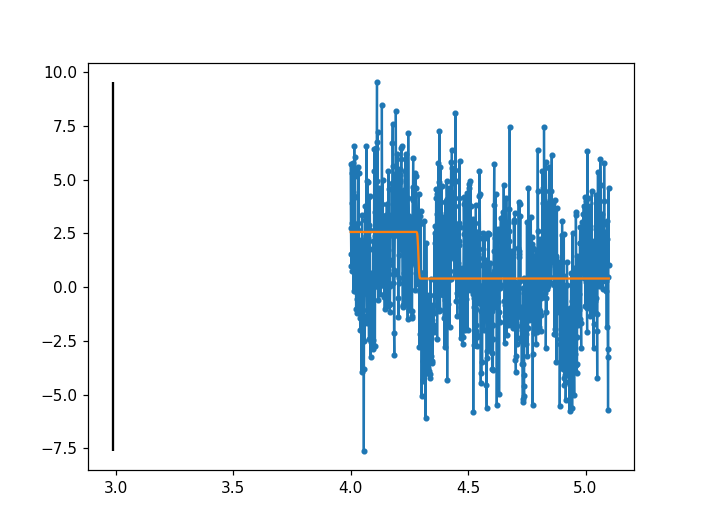

(0.5407080000001807, 0.5560940000001864, 5.099000000000367, 4.021980000000007, (-10.695356980197849+0.04205773451227557j), (0.8319916876576382+0.015070389080296493j))


C:\WPy64-3740\python-3.7.4.amd64\lib\site-packages\numpy\core\_asarray.py:83: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)
C:\WPy64-3740\python-3.7.4.amd64\lib\site-packages\scipy\optimize\optimize.py:689: ComplexWarning: Casting complex values to real discards the imaginary part
  fsim[k] = func(sim[k])
C:\WPy64-3740\python-3.7.4.amd64\lib\site-packages\scipy\optimize\optimize.py:717: ComplexWarning: Casting complex values to real discards the imaginary part
  fsim[-1] = fxr
C:\WPy64-3740\python-3.7.4.amd64\lib\site-packages\scipy\optimize\optimize.py:721: ComplexWarning: Casting complex values to real discards the imaginary part
  fsim[-1] = fxr
C:\WPy64-3740\python-3.7.4.amd64\lib\site-packages\scipy\optimize\optimize.py:740: ComplexWarning: Casting complex values to real discards the imaginary part
  fsim[-1] = fxcc
C:\WPy64-3740\python-3.7.4.amd64\lib\site-packages\scipy\optimize\optimize.py:730: Compl

(0.5407080000001807, 0.5560940000001864, 5.099000000000367, 4.021980000000007, (10.695356980197849-0.04205773451227557j), (0.8319916876576382+0.015070389080296493j))
(0.44509500000014857, 0.47037200000015744, 5.097901000000366, 4.183533000000061, (-9.381693442465128-0.8866927743108581j), (0.6342263517522405-0.009688731800970967j))
(0.44509500000014857, 0.47037200000015744, 5.097901000000366, 4.183533000000061, (9.381693442465128+0.8866927743108581j), (0.6342263517522405-0.009688731800970967j))
(0.3527790000001181, 0.3769570000001261, 4.915467000000306, 4.183533000000061, (-9.381693442465128-0.8866927743108581j), (0.7157145596150298+0.030412873648474205j))
(0.3527790000001181, 0.3769570000001261, 4.915467000000306, 4.183533000000061, (9.381693442465128+0.8866927743108581j), (0.7157145596150298+0.030412873648474205j))


C:\WPy64-3740\python-3.7.4.amd64\lib\site-packages\numpy\core\_asarray.py:83: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)
C:\WPy64-3740\python-3.7.4.amd64\lib\site-packages\numpy\core\_asarray.py:83: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)


In [648]:
# qubit = measure.qubits[qname[0]]
x,y = value[0][0],value[0][1]
plt.figure()
func = scipy.interpolate.interp1d(x,y)
x = np.linspace(min(x),max(x),1001)
y = func(x)
y0 = op.RowToRipe().smooth(y,f0=0.2)
res, func = op.Erf_fit().fitErf(x, y0)
paras = res.x
loc = (paras[2]+paras[3])/2
plt.plot(x,y,'-o',markersize=3)
plt.plot(x,func(x,paras))
plt.vlines(loc,np.min(y),np.max(y)) 

In [798]:
zbigxy = loc-3000
# qubit.timing['z>xy'] = (zbigxy*1e-9)

In [161]:
(loc-3000)*1e-9

1.026618117653925e-09

In [333]:
sf = value[0][2]
flux = value[0][0]
power = value[0][1]
index = np.argwhere(np.abs(sf)==np.max(np.abs(sf)))[0]
pumpF = float(tags[1][8:])*2+2e6
p_op, c_op = power[index[1]], flux[index[0]]
Jpa_para.append([c_op,p_op,pumpF])
np.shape(Jpa_para)
print('current=%f, power=%f, pumpF =%f'%(c_op,p_op,pumpF))

current=-0.300000, power=8.725000, pumpF =13330000000.000000


In [327]:
Jpa_para.append([c_op,p_op,pumpF])
np.shape(Jpa_para)

(15, 3)

In [367]:
Jpa_para

[[-1.0999999999999996, 20.425000000000004, 13210000000.0],
 [-3.2, 20.425000000000004, 13202000000.0],
 [-1.0999999999999996, 20.1, 13218000000.0],
 [-3.0999999999999996, 20.1, 13226000000.0],
 [-3.0999999999999996, 19.450000000000003, 13234000000.0],
 [-1.0999999999999996, 19.125, 13242000000.0],
 [-0.1999999999999993, 19.125, 13250000000.0],
 [-3.2, 17.175000000000004, 13258000000.0],
 [-3.2, 16.525000000000002, 13266000000.0],
 [-3.7, 23.35, 13274000000.0],
 [-1.0, 14.575, 13282000000.0],
 [-0.7999999999999998, 15.55, 13290000000.0],
 [-3.3, 14.25, 13298000000.0],
 [-3.3, 12.95, 13306000000.0],
 [-0.2999999999999998, 11.0, 13314000000.0],
 [-0.2999999999999998, 11.0, 13314000000.0],
 [-3.9, 9.7, 13322000000.0],
 [-0.2999999999999998, 8.725000000000001, 13330000000.0],
 [-0.1999999999999993, 7.425000000000001, 13338000000.0],
 [-4.0, 6.449999999999999, 13346000000.0],
 [-3.9, 6.449999999999999, 13354000000.0],
 [-0.2999999999999998, 7.425000000000001, 13362000000.0],
 [-3.9, 8.075, 1

In [223]:
(jpa_para)

[[-3.916666666666667, 5.4, 13402000000.0],
 [-4.0, 2.2, 13422000000.0],
 [-4.166666666666667, 4.0, 13442000000.0],
 [-4.083333333333333, 5.800000000000001, 13462000000.0],
 [-4.0, 7.6000000000000005, 13482000000.0],
 [-4.0, 9.8, 13502000000.0],
 [-3.3333333333333335, 13.600000000000001, 13302000000.0],
 [-4.0, 7.800000000000001, 13362000000.0],
 [-4.0, 3.8000000000000003, 13452000000.0]]

<IPython.core.display.Javascript object>


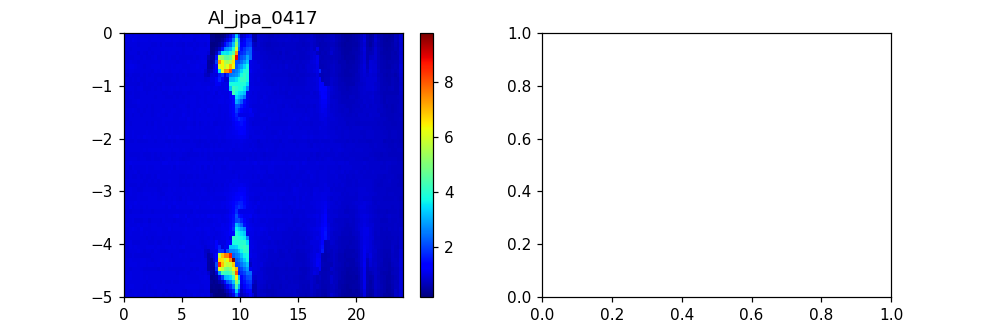

['Al_jpa_0417', 'fcenter=6700000000.0'] 2021-04-19 08:42:03.724412


In [1565]:
value,num,tags,finishtime = write(title='BiasvsPump',height=3,which=1,peak=11200,transposition=False,dB=False,dePhase=True)
print(tags,finishtime)
# value,num,tags,finishtime = write(title='S21vsPumpfreq',height=3,which=1,peak=11200,transposition=False,dB=True,phase='phase',dePhase=True)
# print(tags,finishtime)

In [1566]:
sf = value[0][2]
flux = value[0][0]
power = value[0][1]
index = np.argwhere(np.abs(sf)==np.max(np.abs(sf)))[0]
p_op, c_op = power[index[1]], flux[index[0]]
print('current=%f, power=%f'%(c_op,p_op))

current=-4.333333, power=9.360000


In [1679]:
 np.arange(-300,300,20)*1e6+6.75e9

array([6.45e+09, 6.47e+09, 6.49e+09, 6.51e+09, 6.53e+09, 6.55e+09,
       6.57e+09, 6.59e+09, 6.61e+09, 6.63e+09, 6.65e+09, 6.67e+09,
       6.69e+09, 6.71e+09, 6.73e+09, 6.75e+09, 6.77e+09, 6.79e+09,
       6.81e+09, 6.83e+09, 6.85e+09, 6.87e+09, 6.89e+09, 6.91e+09,
       6.93e+09, 6.95e+09, 6.97e+09, 6.99e+09, 7.01e+09, 7.03e+09])

In [1482]:
['Al_jpa_0417', 'fcenter=6730000000.0'], '2021-04-18 19:43:40.739668'

(['Al_jpa_0417', 'fcenter=6730000000.0'], '2021-04-18 19:43:40.739668')

In [96]:
value[1][1]/np.max(value[1][1])

array([1.        , 0.99590164, 0.99678777, 0.99684315, 0.99573549,
       0.46549623, 0.46317014, 0.46893   , 0.46250554])

<IPython.core.display.Javascript object>


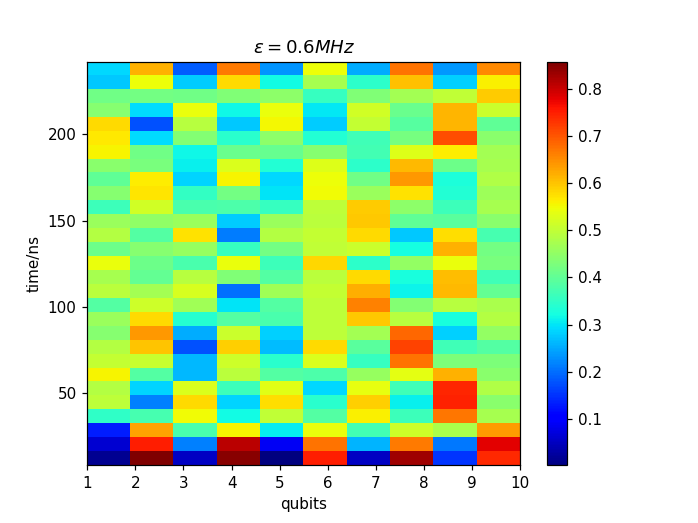

In [1333]:
x = value[0][0]
s = [np.array(value)[i,1,:] for i in np.arange(0,10)]
plt.figure()
extent = [1,10,min(x),max(x)]
plt.imshow(np.array(s).T,aspect='auto',extent=extent,origin='lower',cmap='jet')
plt.ylabel('time/ns')
plt.xlabel('qubits')
plt.title('$\epsilon=0.6MHz$')
plt.colorbar()

In [601]:
sf = value[0][2]
flux = np.linspace(-4,-1,61)
power = np.linspace(0,10,51)

In [602]:
index = np.argwhere(np.abs(sf)==np.max(np.abs(sf)))[0]
p_op, c_op = power[index[1]], flux[index[0]]
print('current=%f, power=%f'%(c_op,p_op))

current=-1.500000, power=8.000000


<IPython.core.display.Javascript object>


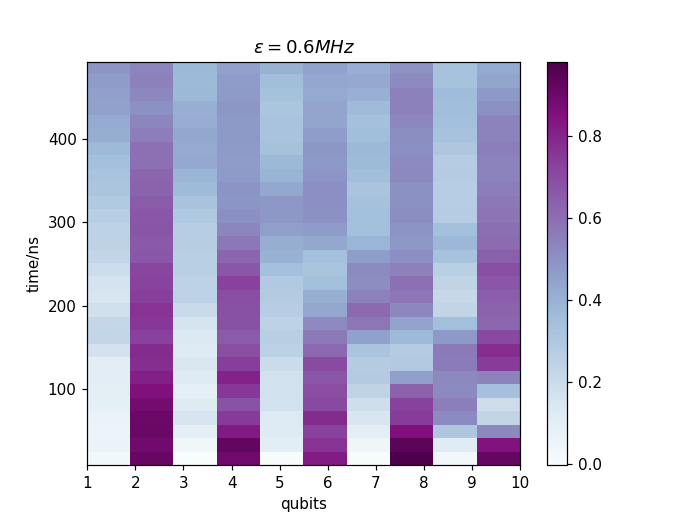

In [118]:
x = value[0][0]*2+1/0.12
s = [np.array(value)[i,1,:] for i in np.arange(0,10)]
plt.figure()
extent = [1,10,min(x),max(x)]
plt.imshow(np.array(s).T,aspect='auto',extent=extent,origin='lower',cmap='BuPu')
plt.ylabel('time/ns')
plt.xlabel('qubits')
plt.title('$\epsilon=0.6MHz$')
plt.colorbar()

In [1038]:
data = np.load(r'yhs_jpa_cali_test.npz')

<IPython.core.display.Javascript object>


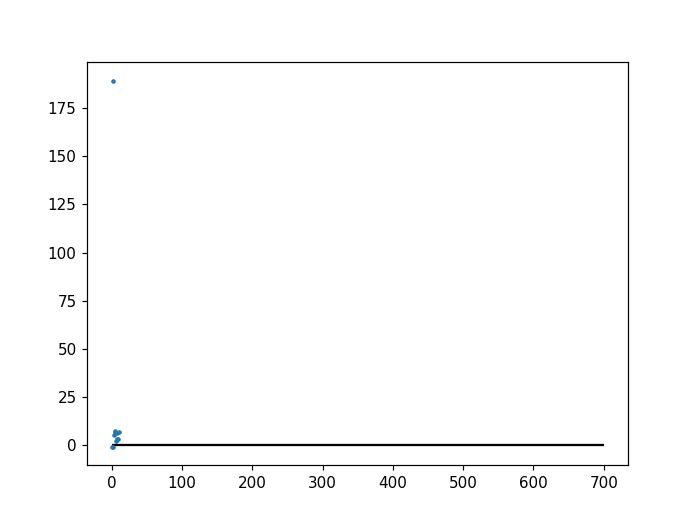

In [1039]:
son, soff = data['son'][:,:,0], data['soff'][:,:,0]
Gi, Ga, Th = -1, -1, 3
sigma_on_r = np.std(np.real(son),axis=1)
sigma_on_i = np.std(np.imag(son),axis=1)
sigma_on = np.sqrt(sigma_on_r**2+sigma_on_i**2)
sigma_off_r = np.std(np.real(soff),axis=1)
sigma_off_i = np.std(np.imag(soff),axis=1)
sigma_off = np.sqrt(sigma_off_r**2+sigma_off_i**2)
Gp = 20*np.log10(np.abs(son.mean(axis=1))/np.abs(soff.mean(axis=1)))
Y = sigma_on**2 / sigma_off**2
#         print(Gp,Y)
Tp = (Y - 1) / Gp / Gi / Ga * Th
plt.figure()
plt.plot(Tp[0:],'o',markersize=2)
plt.hlines(0,0,700)

In [1030]:
Y

array([0.04722984, 0.0521955 , 0.08946741, 0.13230425, 0.28186426,
       0.58848701, 0.17584336, 0.446531  , 0.84878298, 0.30243239,
       0.9568264 ])

<IPython.core.display.Javascript object>


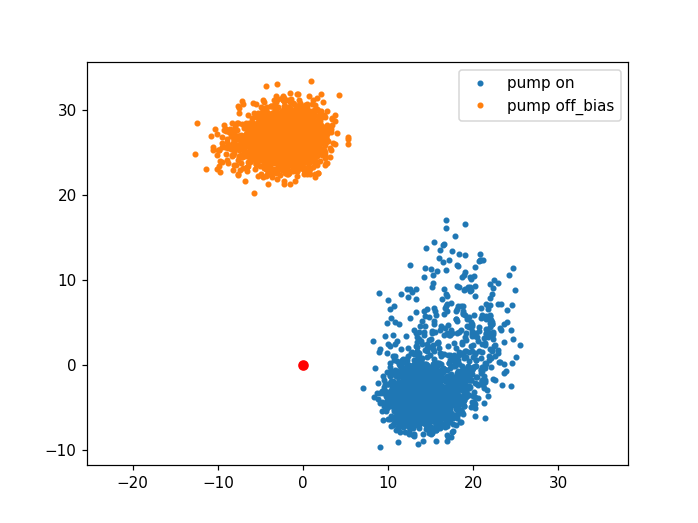

(-14.570272741661478,
 27.47249348879401,
 -11.782039261178943,
 35.600489862553054)

In [1040]:
plt.figure()
plt.plot(son[0,:].real,son[0,:].imag,'.',label='pump on')
plt.plot(soff[0,:].real,soff[0,:].imag,'.',label='pump off_bias')
plt.legend(loc='best')
plt.plot(0,0,'ro')
plt.axis('equal')

In [960]:
Gp.max()

16.568632692070207

In [911]:
data_y = np.load(r'D:\skzhao\Data\yhs\jpa_noise_origin_6.75_m1.32_5.3667.npz')

In [913]:
x,y1,y2 = data_y['x'], data_y['y1'], data_y['y2']

<IPython.core.display.Javascript object>


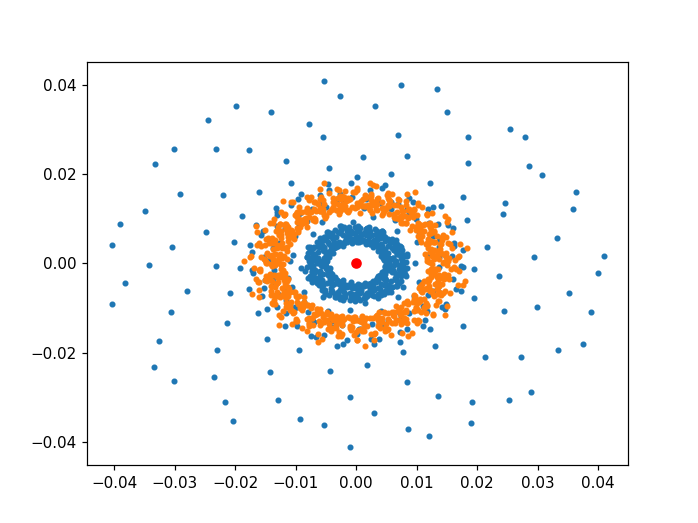

In [939]:
plt.figure()
plt.plot(y1[:,0,0].real,y1[:,0,0].imag,'.')
plt.plot(y2[:,0,0].real,y2[:,0,0].imag,'.')
# plt.plot(np.abs(y2[0,0,:])*100)
plt.plot(0,0,'ro')
# plt.axis('equal')

<IPython.core.display.Javascript object>


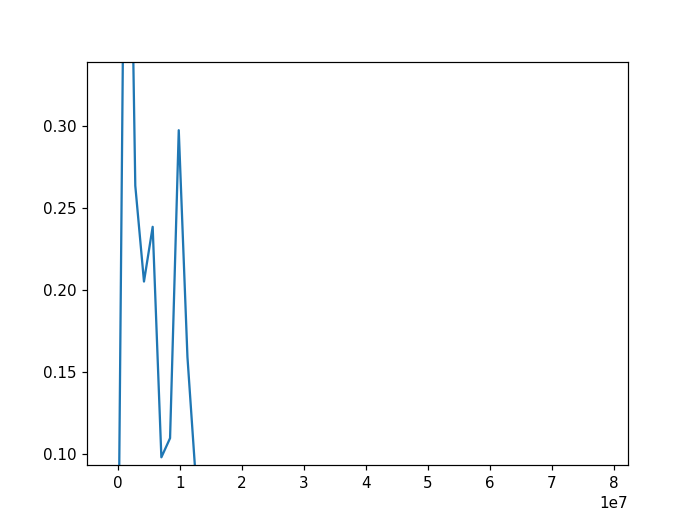

In [934]:
x = np.arange(0,len(y2[:,0,0]))*1e-9
w,yt,amp = op.RowToRipe().fourier(x,np.abs(y2[:,0,0]))
plt.figure()
plt.plot(yt,np.abs(amp))

In [926]:
np.shape(y1[0,0,:])

(2001,)

In [1335]:
data = np.load(r'D:\skzhao\Vmodulation\2021\0320\oToc_q246810_20210320012247.npz',allow_pickle=True)
s = data["value_classify"]
np.shape(data['value_classify'])

(30, 10)

In [1336]:
value, status = data['value'], data['status']

In [778]:
np.shape(value)

(10000, 30, 10)

In [1339]:
class test():
    def __init__(self):
        pass
measure = test()
def post_selection(measure,s,sigma_num=2):
    center0,center1 = [], []
    radius0, radius1 = [], []
    for i in measure.postSle:
        center0.append(np.complex(*(measure.postSle[i][0][0])))
        radius0.append(measure.postSle[i][0][1])
        center1.append(np.complex(*(measure.postSle[i][1][0])))
        radius1.append(measure.postSle[i][1][1])
    pop = []
    for i in range(np.shape(s)[1]):
        x0 = (np.abs(s[:,i,:]-np.array(center0))<np.array(radius0)*sigma_num)*1.0
        x1 = (np.abs(s[:,i,:]-np.array(center1))<np.array(radius1)*sigma_num)*1.0
#         y = x0 + x1
#         c = np.sum(y ,axis=1)
#         x0, x1 = x0[c==10,:], x1[c==10,:]
#         print(x0)
        pop_sum1 = np.sum(x1,axis=1)
#         pop_sum0 = np.sum(x0,axis=1)
        pop_q = x1[pop_sum1==5,:]
#         print(pop_q[:,8])
#         print(np.shape(pop_q))
        pop.append((np.count_nonzero(pop_q,axis=0)/len(pop_q)))
    return np.array(pop)

In [1340]:
measure.onwhich,measure.offwhich,measure.predict,measure.readmatrix,measure.postSle = status

In [1343]:
pop_m = []
for i in range(30):      
    pop_m.append(np.array(mrw.readPop(measure,value[:,i,:],readcali = True))[:,0])

In [1342]:
measure.qubitToread = [f'q{i+1}' for i in range(10)]

<IPython.core.display.Javascript object>


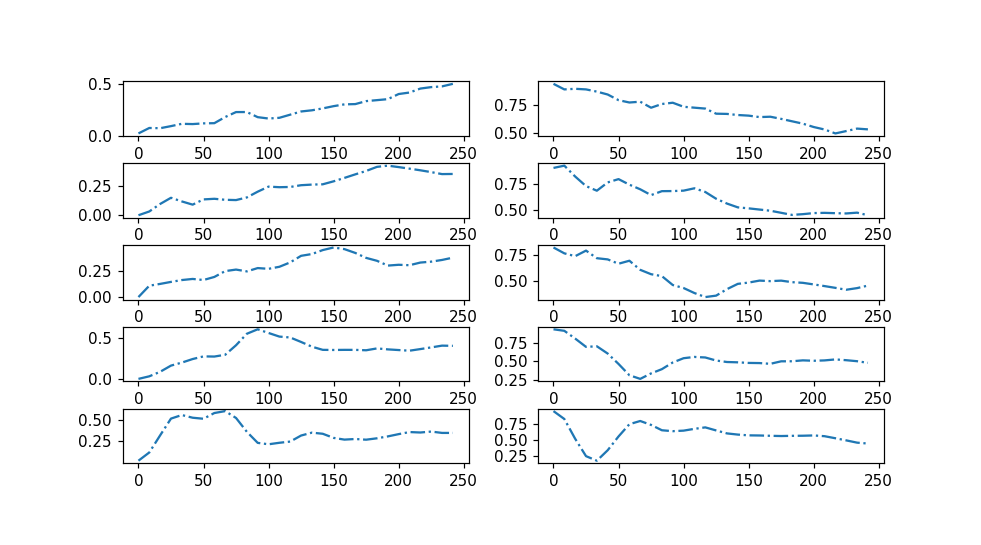

In [1345]:
# pop = post_selection(measure,value[:,0:,:])
pop = 1-np.array(pop_m)
pop = pop.T
num = 10
height = 1
dt = 1/0.12
x = np.arange(0,30*dt,dt)[0:]
n = num // 2 + num % 2
fig, axes = plt.subplots(ncols=2,nrows=n,figsize=(9,height*n))
fig.subplots_adjust(top=0.85,bottom=0.15,hspace=0.5)
v = []
for i in range(num): 
    f, res = x,np.array(pop)[i,:]
#     axes[i//2][i%2].plot(f[:15],res[:15],'-.')
# #     axes[i//2][i%2].plot(f[15],res[15],'o')
#     axes[i//2][i%2].plot(f[15:],res[15:],'r-.')
    axes[i//2][i%2].plot(f,res,'-.')

<IPython.core.display.Javascript object>


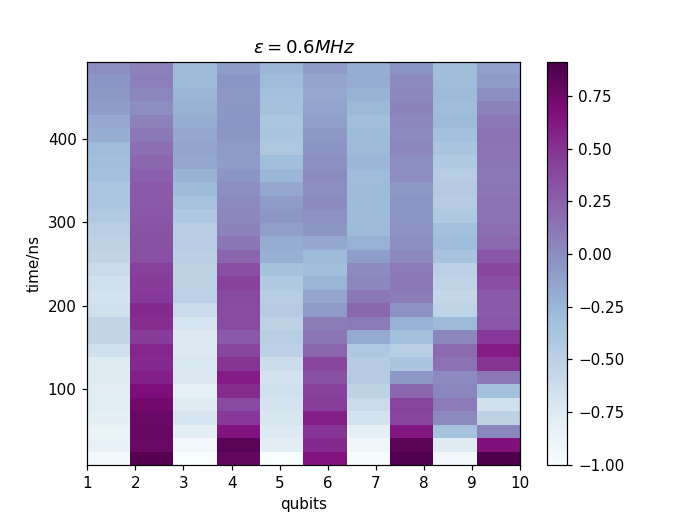

In [1346]:
dt = 1/0.12
x = np.arange(0,30*dt,dt)*2 + 1/0.12
# s = [np.array(value)[i,1,:] for i in np.arange(0,10)]
# s = [2*np.array(i)-1 if j//2==0 else abs(np.array(i)) for j,i in enumerate(np.array(s))]
plt.figure()
extent = [1,10,min(x),max(x)]
plt.imshow(2*np.array(s)-1,aspect='auto',extent=extent,origin='lower',cmap='BuPu')
plt.ylabel('time/ns')
plt.xlabel('qubits')
plt.title('$\epsilon=0.6MHz$')
plt.colorbar()

<IPython.core.display.Javascript object>


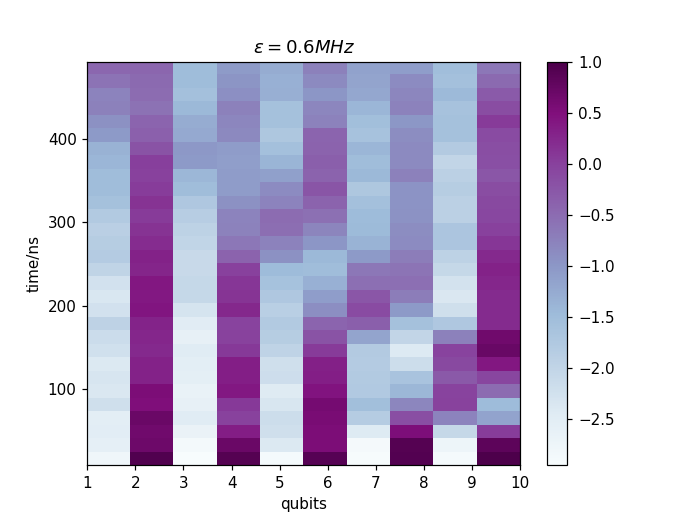

In [753]:
dt = 1/0.12
x = np.arange(0,30*dt,dt)*2 + 1/0.12
# s = [np.array(value)[i,1,:] for i in np.arange(0,10)]
# s = [2*np.array(i)-1 if j//2==0 else abs(np.array(i)) for j,i in enumerate(np.array(s))]
plt.figure()
extent = [1,10,min(x),max(x)]
plt.imshow(2*np.array(s)-1,aspect='auto',extent=extent,origin='lower',cmap='BuPu')
plt.ylabel('time/ns')
plt.xlabel('qubits')
plt.title('$\epsilon=0.6MHz$')
plt.colorbar()

<IPython.core.display.Javascript object>


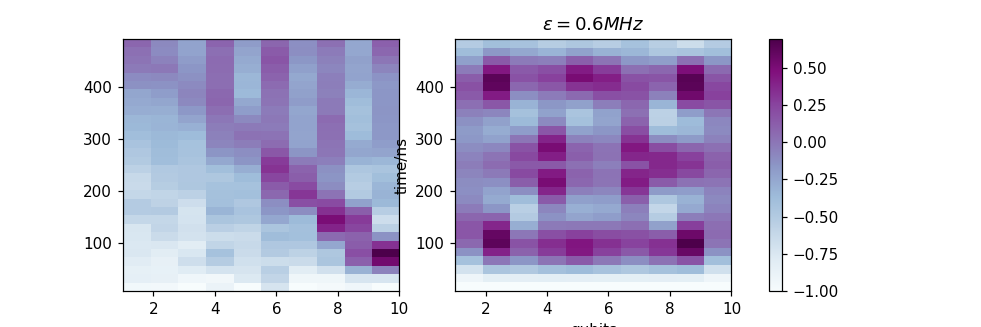

In [1347]:
s = np.abs(np.array([np.array(pop)[i,:] for i in [0,1,2,3,4,5,6,7,8,9]]).T)/np.max(np.abs(np.array([np.array(pop)[i,:] for i in [0,1,2,3,4,5,6,7,8,9]]).T))*2-1
s_q = []
for i in range(10):
    
    if i%2!=0:
        s[:,i] *=-1
        s_q.append(1-s_qWalk[:,i]*2)
    else:
        s_q.append(s_qWalk[:,i]*2-1)
        

fig, axes = plt.subplots(ncols=2,nrows=1,figsize=(9,3))
extent = [1,10,min(x),max(x)]
im = axes[0].imshow(s,aspect='auto',extent=extent,origin='lower',cmap='BuPu')
im1 =axes[1].imshow(np.array(s_q).T,aspect='auto',extent=extent,origin='lower',cmap='BuPu')
plt.ylabel('time/ns')
plt.xlabel('qubits')
plt.title('$\epsilon=0.6MHz$')
# cax = plt.axes([1, 1, 1, 1])
fig.colorbar(im1, ax=axes)
plt.show()

In [692]:
save('oToc',tags,base_path=r'D:\skzhao\Vmodulation',value=[x,np.abs(pop)/np.max(pop)])

WindowsPath('D:/skzhao/Vmodulation/2021/0324/oToc_20210324170133.npz')

<IPython.core.display.Javascript object>


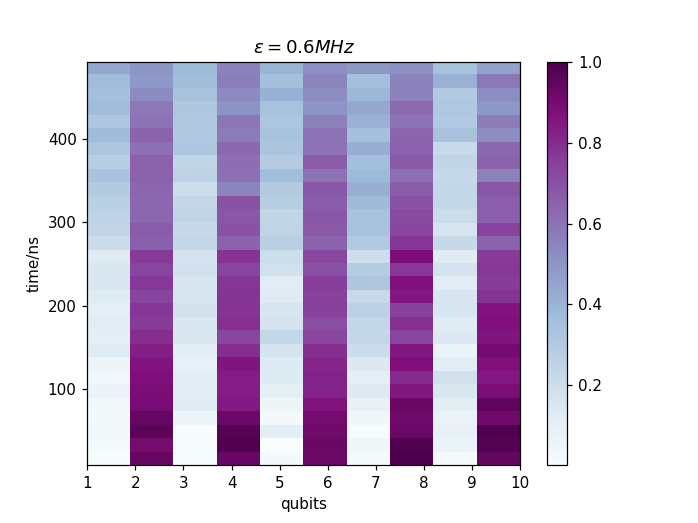

In [477]:
x = value[0][0]*2+1/0.12
s = [np.array(value)[i,1,:] for i in np.arange(0,10)]
plt.figure()
extent = [1,10,min(x),max(x)]
plt.imshow(np.abs(s).T/np.max(s),aspect='auto',extent=extent,origin='lower',cmap='BuPu')
plt.ylabel('time/ns')
plt.xlabel('qubits')
plt.title('$\epsilon=0.6MHz$')
plt.colorbar()

<IPython.core.display.Javascript object>


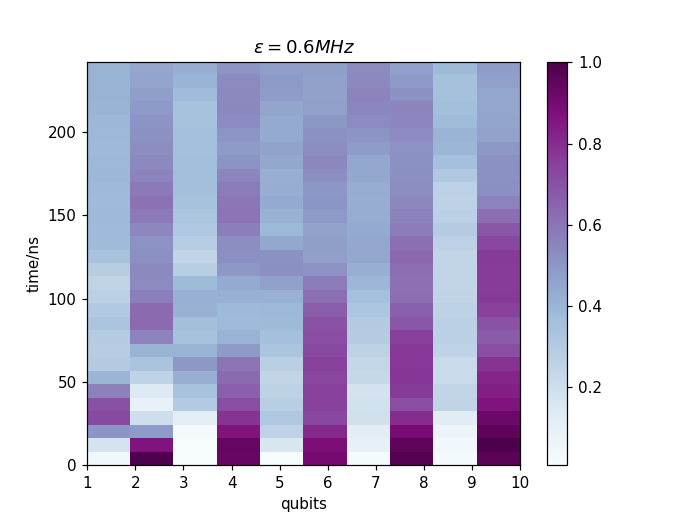

In [277]:
x = value[0][0]
s = [np.array(value)[i,1,:] for i in np.arange(0,10)]
plt.figure()
extent = [1,10,min(x),max(x)]
plt.imshow(np.abs(s).T/np.max(s),aspect='auto',extent=extent,origin='lower',cmap='BuPu')
plt.ylabel('time/ns')
plt.xlabel('qubits')
plt.title('$\epsilon=0.6MHz$')
plt.colorbar()

In [ ]:
def post_selection(measure,s,sigma_num=2):
    center0,center1 = [], []
    radius0, radius1 = [], []
    for i in measure.postSle:
        center0.append(np.complex(*(measure.postSle[i][0][0])))
        radius0.append(measure.postSle[i][0][1])
        center1.append(np.complex(*(measure.postSle[i][1][0])))
        radius1.append(measure.postSle[i][1][1])
    pop = []
    for i in range(np.shape(s)[1]):
        x0 = (np.abs(s[:,i,:]-np.array(center0))<np.array(radius0)*sigma_num)*1.0
        x1 = (np.abs(s[:,i,:]-np.array(center1))<np.array(radius1)*sigma_num)*1.0
        y = x0 + x1
        c = np.sum((y == np.array([1]*10))*1,axis=1)
        x0, x1 = x0[c==10,:], x1[c==10,:]
        pop_sum1 = np.sum(x1,axis=1)
#         pop_sum0 = np.sum(x0,axis=1)
        pop_q = x1[pop_sum1==5,:]
#         print(np.shape(pop_q))
        pop.append((np.count_nonzero(pop_q,axis=0)/len(pop_q)))
    return np.array(pop)

In [ ]:
data = np.load(r'D:\skzhao\Vmodulation\2021\0123\mEcho_q13579_20210123115129.npz')
s = data['value']
np.shape(s)

<IPython.core.display.Javascript object>


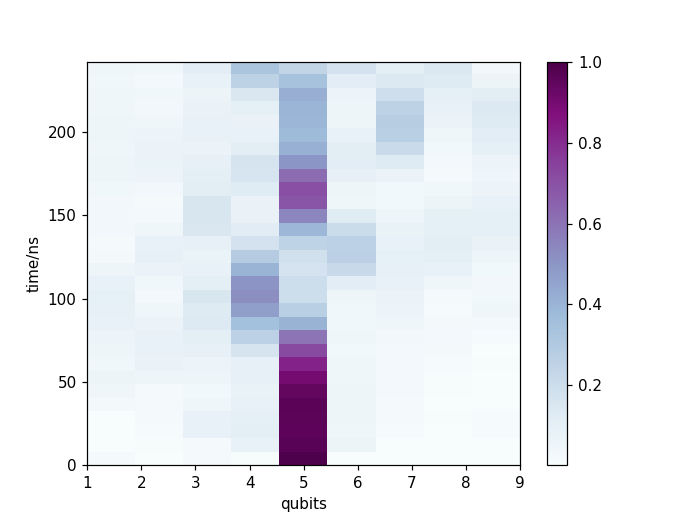

In [75]:
x = value[0][0]
s = [np.array(value)[i,1,:] for i in np.arange(0,9)]
plt.figure()
extent = [1,9,min(x),max(x)]
plt.imshow(np.abs(s).T/np.max(s),aspect='auto',extent=extent,origin='lower',cmap='BuPu')
plt.ylabel('time/ns')
plt.xlabel('qubits')
# plt.title('$\epsilon=0.6MHz$')
plt.colorbar()

<IPython.core.display.Javascript object>


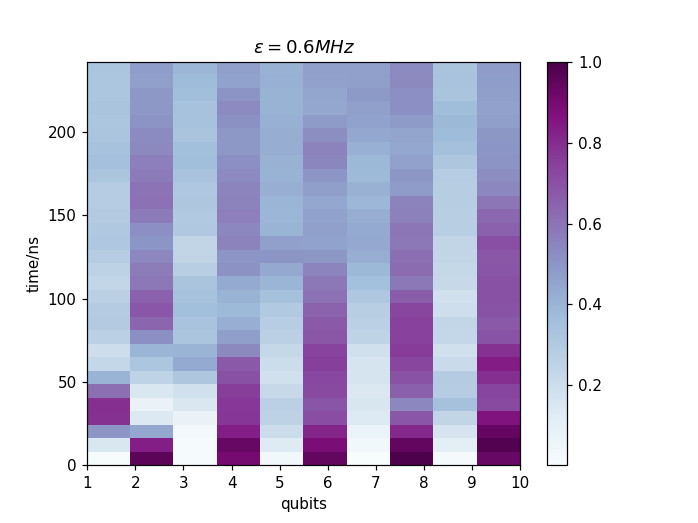

In [331]:
x = value[0][0]
s = [np.array(value)[i,1,:] for i in np.arange(0,10)]
plt.figure()
extent = [1,10,min(x),max(x)]
plt.imshow(np.abs(s).T/np.max(s),aspect='auto',extent=extent,origin='lower',cmap='BuPu')
plt.ylabel('time/ns')
plt.xlabel('qubits')
plt.title('$\epsilon=0.6MHz$')
plt.colorbar()

In [524]:
save('oToc',tags,base_path=r'D:\skzhao\Vmodulation',value=[value[0][0]*2+8,np.abs(s)/np.max(s)],tags=tags,finisfedtime=str(finishtime))

WindowsPath('D:/skzhao/Vmodulation/2021/0312/oToc_20210312200840.npz')

In [86]:
num = 0
x, y = value[num][0],np.abs(value[num][1])
y0 = op.RowToRipe().smooth(y,f0=0.2)
xnew,y0 = op.RowToRipe().resample(x,y0,1001)
# res, f = op.Cos_Fit(phi=0).fitCos(x,y0)
# A, C, W, phi = res.x
plt.figure()
bias0 = op.RowToRipe().firstMax(xnew,y0,num=0,peakpercent=0.9)
plt.plot(x,y)
plt.plot(xnew,y0)
plt.vlines(bias0,min(y0),max(y0))
plt.title(f'bias0={bias0}')

<IPython.core.display.Javascript object>

ValueError: x and y must have same first dimension, but have shapes (2,) and (121,)

In [253]:
bias0

208000.0

<IPython.core.display.Javascript object>


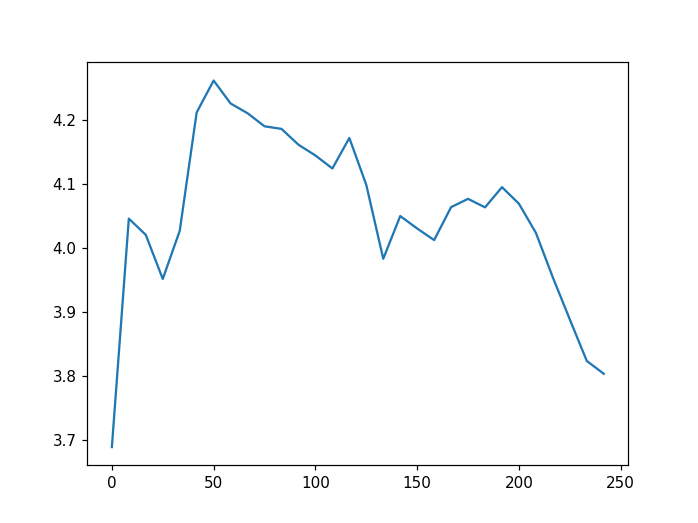

In [100]:
pop = np.sum(s,axis=0)
plt.figure()
plt.plot(x,pop)

In [200]:
dt = 1/0.12/3
len(np.arange(0,30*dt,dt))

30

<IPython.core.display.Javascript object>


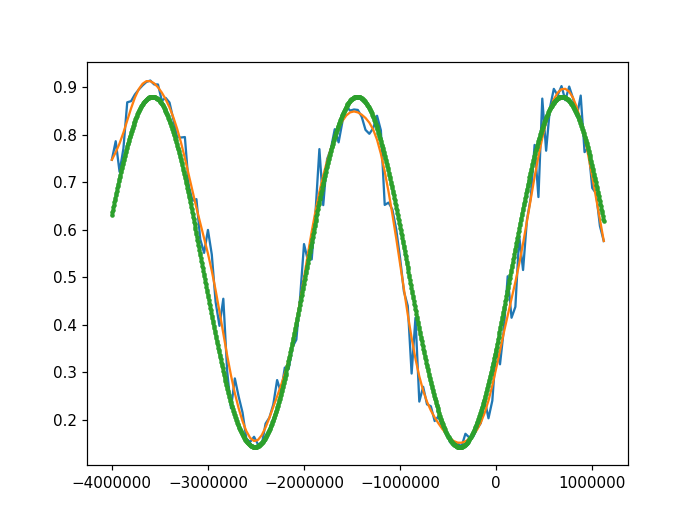

In [54]:
num = 9
x, y = value[num][0],np.abs(value[num][1])[:,0]
y0 = op.RowToRipe().smooth(y,f0=0.2)
res, f = op.Cos_Fit(phi=0).fitCos(x,y0)
A, C, W, phi = res.x
plt.figure()
xnew = np.linspace(min(x),max(x),1001)
plt.plot(x,y)
plt.plot(x,y0)
plt.plot(xnew,f(xnew,res.x),'-o',markersize=2)

In [168]:
W*1e3/2

4.3196980423052365

In [674]:
num = 0
index = signal.argrelmin(np.abs(value[num][1]))
value[0][0][index[0]]

array([-0.11826667, -0.1066    , -0.0941    , -0.0891    , -0.08326667,
       -0.06993333, -0.06826667, -0.05493333, -0.0416    ])

In [659]:
index

(array([  7,  36,  51,  67,  69,  87, 100, 102], dtype=int64),)

In [218]:
num =8
y0 = op.RowToRipe().smooth(np.abs(value[num][1]),f0=0.15)
# paras, func = op.Erf_fit().fitErf(value[num][0][:], y0[:])
paras,func = op.Gaussian_Fit().fitGaussian(value[num][0][:],np.abs(y0[:]))
fig = plt.gcf()
ax = plt.getp(fig,'axes')
ax[num].plot(value[num][0],func(value[num][0],paras.x))
# ax[num].vlines((paras.x[2]+paras.x[3])/2,np.min(np.abs(value[num][1])),np.max(np.abs(value[num][1]))) 
ax[num].vlines(paras.x[-1],np.min(np.abs(value[num][1])),np.max(np.abs(value[num][1]))) 

# ax[0].vlines((paras.x[1]),np.min(np.abs(value[0][1])),np.max(np.abs(value[0][1])))   
# x = np.linspace(-10,10,1001)
# paras = [2,2,-1,10,-5,2]
# plt.figure()
# # plt.plot(value[0][0],signal.detrend(np.abs(value[0][1]))+25)
# plt.plot(op.RowToRipe().smooth(np.abs(value[0][1]),0.05))
# (paras.x[2]+paras.x[3])/2

[0.2969201779319696, 0.3127813647371148, 0.00800000000000009, -0.1041364505911259]


In [180]:
paras.x

array([            inf,  5.55634584e-01,  1.36032047e+02, -8.38699051e+07])

<IPython.core.display.Javascript object>


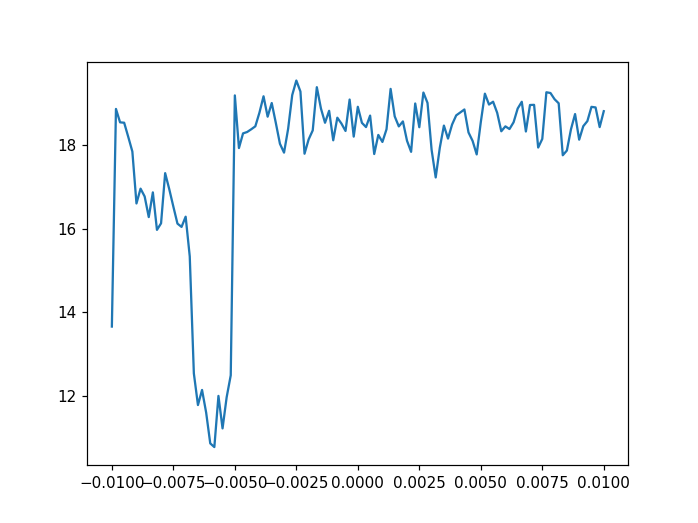

In [88]:
plt.figure()
plt.plot(value[0][1],np.abs(value[0][2])[0,:])

# 动力学局域化

<IPython.core.display.Javascript object>


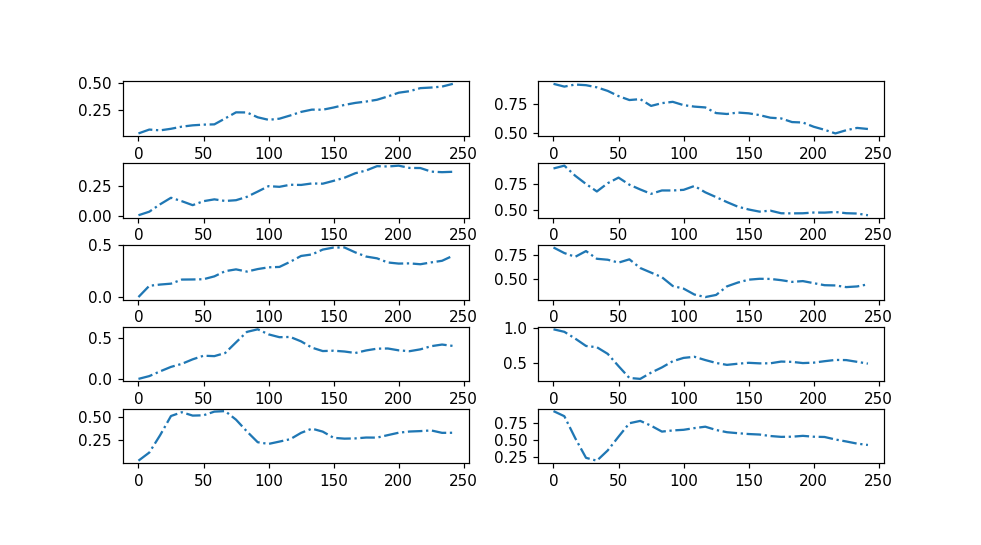

['ex-q246810', '4MHz', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '-0.03115', '-0.25064', '-0.08159', '-0.27587', '-0.04836', '-0.477', '-0.18481', '-0.35981', '-0.24977', '-0.10617', '-0.00777', '0.01498', '-0.00326', '0.01225', '0.01594', '-0.00637', '-0.01253', '-0.02384', '-0.01164', '0.0113', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0'] 2021-03-19 20:09:19.462754


In [117]:
value,num,tags,finishtime = write(title='oToc',height=1,which=25,peak=11200,transposition=False)
print(tags,finishtime)

In [208]:
np.min(s)

-0.014238817580707896

<IPython.core.display.Javascript object>


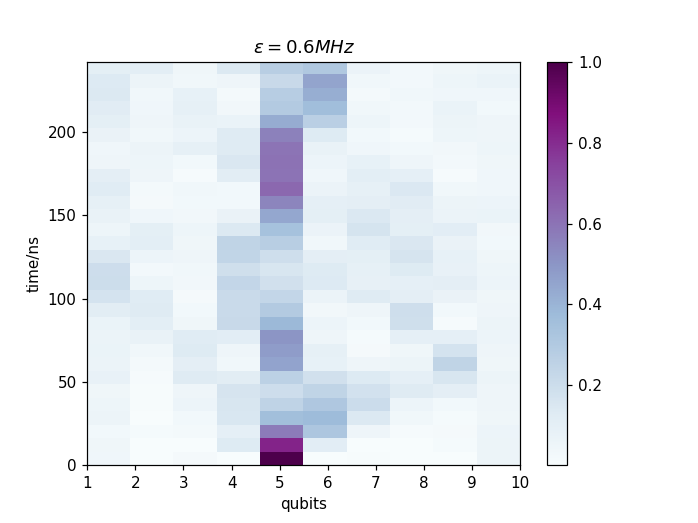

In [621]:
x = value[0][0]
s = [np.array(value)[i,1,:] for i in np.arange(0,10)]
plt.figure()
extent = [1,10,min(x),max(x)]
plt.imshow(np.abs(s).T/np.max(s),aspect='auto',extent=extent,origin='lower',cmap='BuPu')
plt.ylabel('time/ns')
plt.xlabel('qubits')
plt.title('$\epsilon=0.6MHz$')
plt.colorbar()

In [339]:
save('0.6',tags,base_path=r'D:\skzhao\Vmodulation',value=[value[0][0],np.abs(s)/np.max(s)],tags=tags,finisfedtime=str(finishtime))

WindowsPath('D:/skzhao/Vmodulation/2021/0129/0.6_20210129160445.npz')

<IPython.core.display.Javascript object>


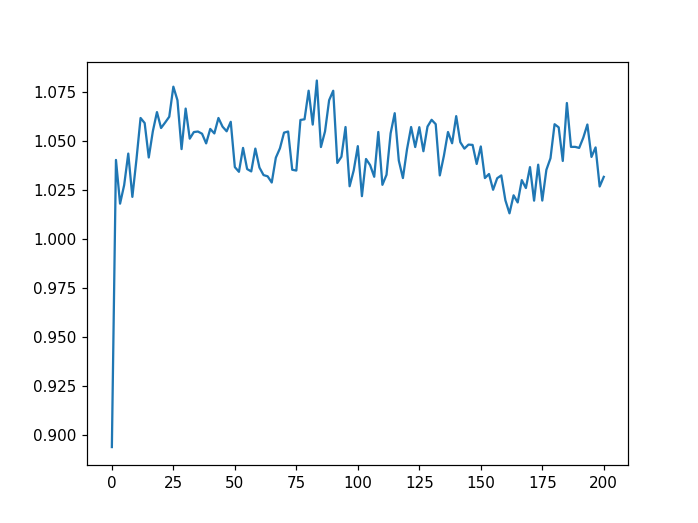

In [85]:
pop = np.sum(s,axis=0)
plt.figure()
plt.plot(x,pop)

<IPython.core.display.Javascript object>


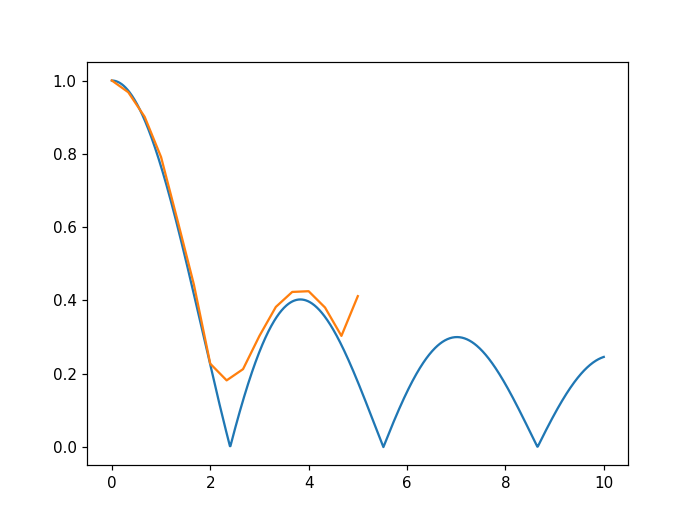

In [192]:
x = np.arange(0,0.61,0.04)/0.12
y = 1/np.array([9.1,9.4,10.1,11.5,14.7,20.5,40,50,42.8,30,23.8,21.5,21.4,23.9,30,22.1])
from scipy import special
plt.figure()
xnew = np.linspace(0,10,1001)
plt.plot(xnew,np.abs(special.jv(0,xnew)))
plt.plot(x,y/y.max())

In [69]:
x = np.lin

NameError: name 'x' is not defined

In [231]:
save('240MHz_final_q6',tags,base_path=r'D:\skzhao\Vmodulation',value=value,tags=tags,finisfedtime=str(finishtime))

WindowsPath('D:/skzhao/Vmodulation/2021/0117/240MHz_final_q6_20210117213129.npz')

In [157]:

for i in os.walk('D:/skzhao/Vmodulation/2020/1223'):
    print(i)

('D:/skzhao/Vmodulation/2020/1223', [], ['288.6MHz_final_q13579_20201223180602.npz', 'ssh_156MHz_final_q1_200_20201223164156.npz', 'ssh_156MHz_final_q1_200_nontrivial_20201223165658.npz'])


D:\skzhao\Vmodulation\2021\0308\oToc_q246810_20210308112101.npz


<IPython.core.display.Javascript object>


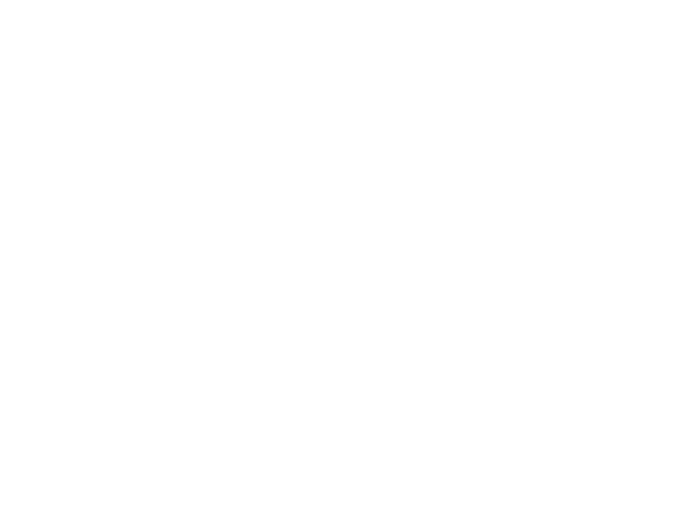

NameError: name 'x' is not defined

In [68]:
basepath = r'D:\skzhao\Vmodulation\2021\0308'
dirpath = next(os.walk(basepath))
num =0
f = Path(dirpath[0]) / Path(dirpath[2][num])
print(f)
data = np.load(f,allow_pickle=True)
value = data['value']
# x = value[0][0]
# s = [np.array(value)[i,1,:] for i in [0,1,2,3,4,5,6,7,8,9]]
# x, s = value
plt.figure()
extent = [1,10,min(x),max(x)]
plt.imshow(np.array(s).T[:,:],aspect='auto',extent=extent,origin='lower',cmap='BuPu')
plt.ylabel('time/ns')
plt.xlabel('qubits')
plt.title('$\epsilon=288.6MHz$')
plt.colorbar()

In [270]:
np.shape(value)

(30000, 30, 10)

In [251]:
zz = np.append(z,[zend],axis=0)
np.shape(zz)

(30, 10)

In [253]:
for i in range(10): 
    f, res = x,s[:,i]
    axes[i//2][i%2].errorbar(f[:,i],res,yerr=zz[:,i],fmt='.',capsize=5,ecolor='r',elinewidth=5,barsabove =True)

ValueError: The lengths of the data (29) and the error 30 do not match

<IPython.core.display.Javascript object>


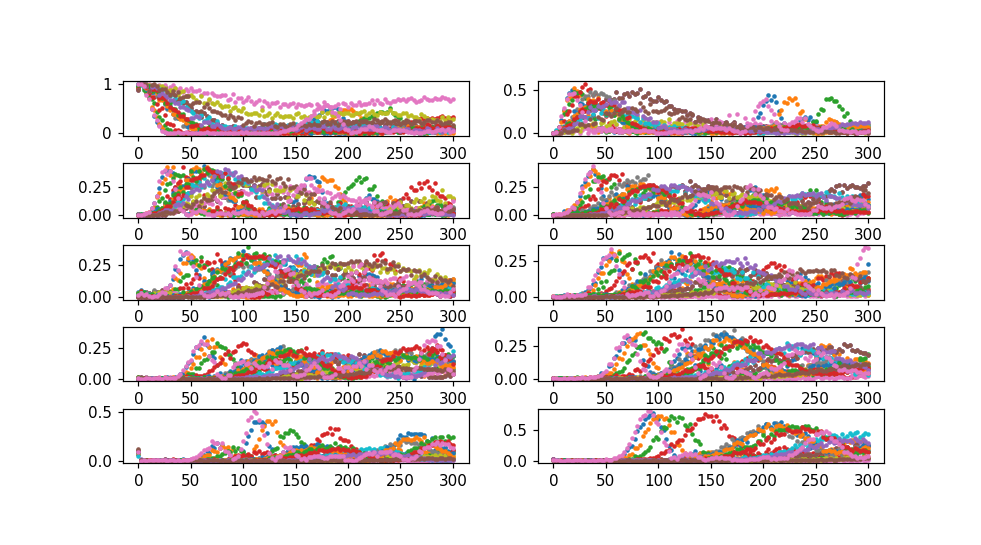

In [75]:
height = 1
n = 10 // 2 + 10 % 2
fig, axes = plt.subplots(ncols=2,nrows=n,figsize=(9,height*n))
fig.subplots_adjust(top=0.85,bottom=0.15,hspace=0.5)

In [1349]:
basepath = r'D:\skzhao\Vmodulation\2021\0220'
num =0
dirpath = next(os.walk(basepath))
f = Path(dirpath[0]) / Path(dirpath[2][num])
print(f)
data = np.load(f,allow_pickle=True)
value = data['value']
x, s = value
for i in range(10): 
    f, res = x,s[i,:]
    axes[i//2][i%2].plot(f,res,'o',markersize=2)

D:\skzhao\Vmodulation\2021\0220\oToc_q5_without10_20210220151656.npz


TypeError: 'AxesSubplot' object is not subscriptable

<IPython.core.display.Javascript object>


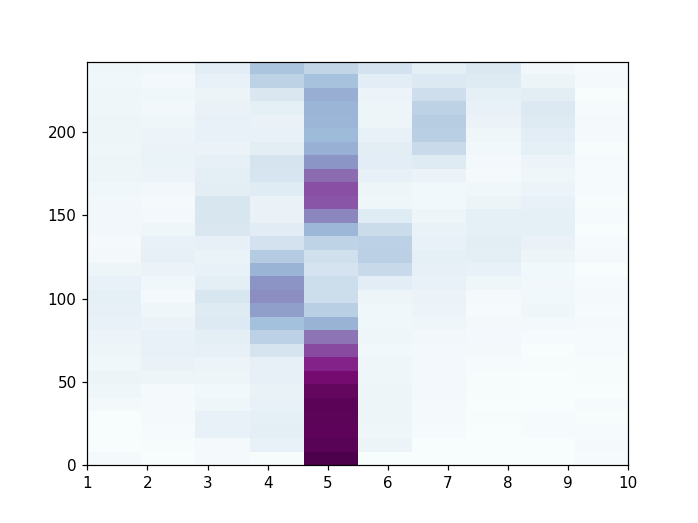

In [1351]:
plt.figure()
extent = [1,10,min(x),max(x)]
plt.imshow(np.abs(s).T,origin='lower',aspect='auto',extent=extent,cmap='BuPu')

In [139]:
basepath = r'D:\skzhao\Vmodulation\2021\0203'
s_echo = []
for num in range(11):
    dirpath = next(os.walk(basepath))
    f = Path(dirpath[0]) / Path(dirpath[2][num])
    data = np.load(f,allow_pickle=True)
    value = data['value']
    x, s = value
    s_echo.append(s)

In [255]:
np.savez('errorbar_mEcho.npz',errobar=zz)

<IPython.core.display.Javascript object>


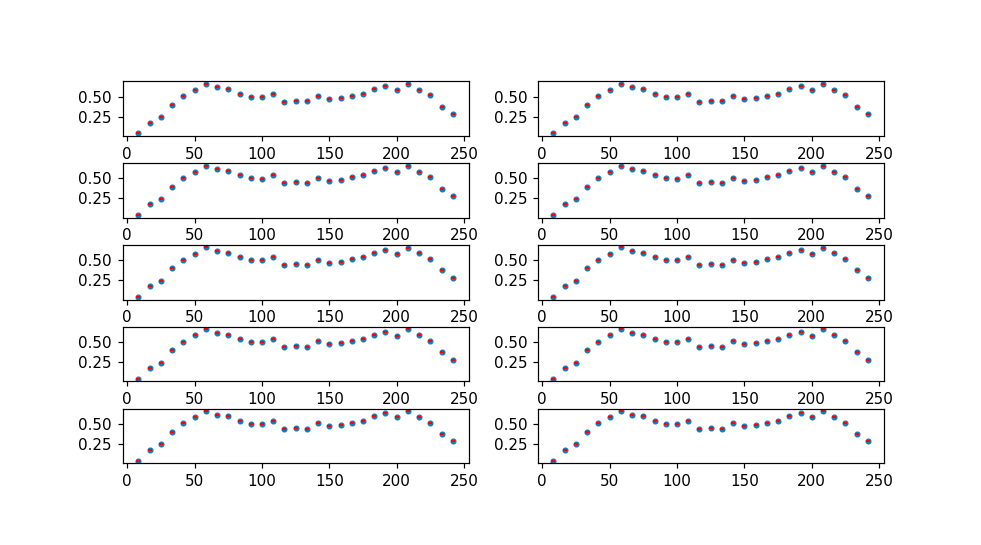

In [166]:
z = np.std(s_echo,axis=0)
height = 1
n = 10 // 2 + 10 % 2
fig, axes = plt.subplots(ncols=2,nrows=n,figsize=(9,height*n))
fig.subplots_adjust(top=0.85,bottom=0.15,hspace=0.5)
for i in range(10): 
    axes[i//2][i%2].errorbar(f,res,xerr=z[i,:],fmt='.',capsize=1,ecolor='r',elinewidth=5,barsabove =True)

<IPython.core.display.Javascript object>


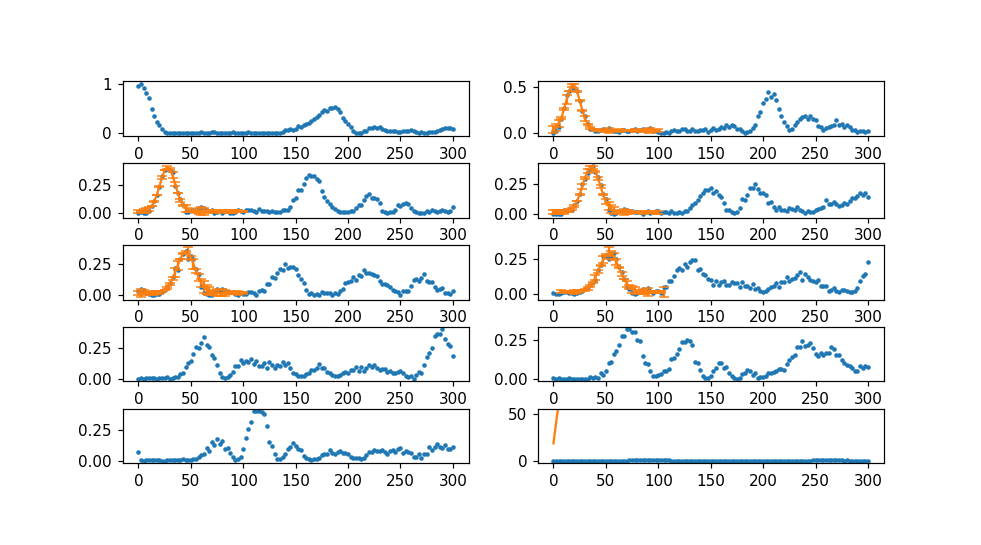

In [195]:
num = 10
height = 1
n = num // 2 + num % 2
fig, axes = plt.subplots(ncols=2,nrows=n,figsize=(9,height*n))
fig.subplots_adjust(top=0.85,bottom=0.15,hspace=0.5)
v = []
for i in range(num): 
    f, res = x,s[i,:]
    axes[i//2][i%2].plot(f,res,'o',markersize=2)
#     axes[i//2][i%2].plot(f,res1)

In [223]:
snew = op.RowToRipe().smooth(s,f0=0.2,axis=1)
index = np.argmax(snew,axis=1)[1:6]
index

array([  7,  11,  14,  18, 120], dtype=int64)

In [198]:
np.array(res_fit)[:,-1]

array([18.63284277, 27.8129828 , 36.22254594, 45.22619752, 53.23402466])

In [196]:
fig = plt.gcf()
ax = plt.getp(fig,'axes')
snew = op.RowToRipe().smooth(s,f0=0.2,axis=1)
index = np.argmax(snew,axis=1)[1:6]
index[-1] = 23
res_fit = []
errorbar = []
for j, i in enumerate(range(5),start=1):
    start, stop = (0, 41) if index[i] < 20 else (index[i]-20, index[i]+20)
    f, s_fit = x[start:stop],s[j,start:stop]
    res, func = op.Gaussian_Fit().fitGaussian(f,s_fit,True)
    res_fit.append(res.x)
    errorbar.append(res.fun)
    ax[j].errorbar(f,func(f,res.x),yerr=res.fun,ms=3,mfc='r',mec='r',capsize=3)

In [188]:
save('0_q2-q6',tags,base_path=r'D:\skzhao\Vmodulation',res_fit=res_fit,errorbar=errorbar)

WindowsPath('D:/skzhao/Vmodulation/2021/0219/0_q2-q6_20210219101301.npz')

In [70]:
basepath = r'D:\skzhao\Vmodulation\2021\final\光锥'
dirpath = next(os.walk(basepath))
v = []
for num in range(len(dirpath[2])):
    f = Path(dirpath[0]) / Path(dirpath[2][num])
    print(f)
    data = np.load(f,allow_pickle=True)
    y = data['res_fit'][:,-1]
    x = range(5)
    res = np.polyfit(range(5),y,1)
    v.append(res[0])

D:\skzhao\Vmodulation\2021\final\光锥\0.04_20210129160002.npz


KeyError: 'res_fit is not a file in the archive'

In [219]:
v = [8.562279001575336,8.679414029730186,
 9.463593683258866,
 10.801457096093454,
 13.407191528507585,
    18.42610696326204,
    26.685854340892373,
 32.59176240994356,34.35342715154089,
 25.492145953039717,
     21.318981330617454,
    19.573837202556845,
 19.72367132808736,
     21.888566043303868,
 27.78731095952879,
 41.573303820588016
 ]

<IPython.core.display.Javascript object>


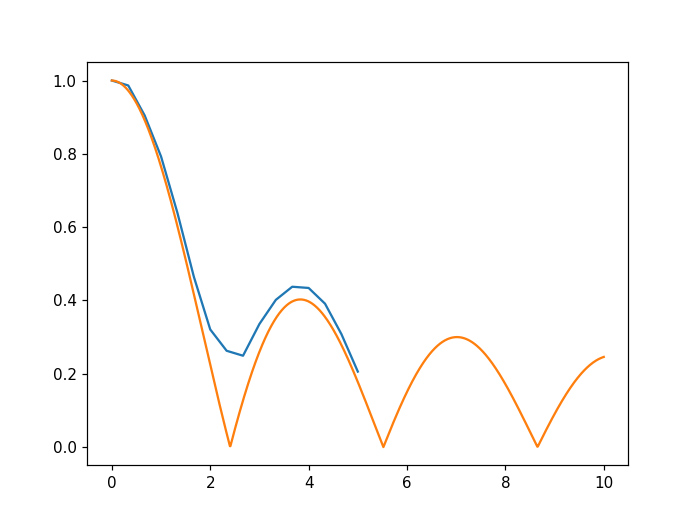

In [224]:
plt.figure()
x = np.arange(0,0.61,0.04)/0.12
plt.plot(x,(1/np.array(v))*8.562279001575336)
xnew = np.linspace(0,10,1001)
plt.plot(xnew,np.abs(special.jv(0,xnew)))

In [205]:
help(np.poly1d)

Help on class poly1d in module numpy:

class poly1d(builtins.object)
 |  poly1d(c_or_r, r=False, variable=None)
 |  
 |  A one-dimensional polynomial class.
 |  
 |  A convenience class, used to encapsulate "natural" operations on
 |  polynomials so that said operations may take on their customary
 |  form in code (see Examples).
 |  
 |  Parameters
 |  ----------
 |  c_or_r : array_like
 |      The polynomial's coefficients, in decreasing powers, or if
 |      the value of the second parameter is True, the polynomial's
 |      roots (values where the polynomial evaluates to 0).  For example,
 |      ``poly1d([1, 2, 3])`` returns an object that represents
 |      :math:`x^2 + 2x + 3`, whereas ``poly1d([1, 2, 3], True)`` returns
 |      one that represents :math:`(x-1)(x-2)(x-3) = x^3 - 6x^2 + 11x -6`.
 |  r : bool, optional
 |      If True, `c_or_r` specifies the polynomial's roots; the default
 |      is False.
 |  variable : str, optional
 |      Changes the variable used when printi

In [48]:
save('400MHz_withoutq1',tags,base_path=r'D:\skzhao\Vmodulation',value=[x,np.abs(s)/np.max(s)])

WindowsPath('D:/skzhao/Vmodulation/2021/0126/400MHz_withoutq1_20210126173011.npz')

In [47]:
data['arr_0']

array(['ex-q6', '240MHz', '-0.0308442', '-0.24930775971091107',
       '-0.07905155153064314', '-0.27348824090293206',
       '-0.045279852474836346', '-0.4749874885915557',
       '-0.18190283668923055', '-0.35825', '-0.24787',
       '-0.10453645059112582'], dtype='<U21')

<IPython.core.display.Javascript object>


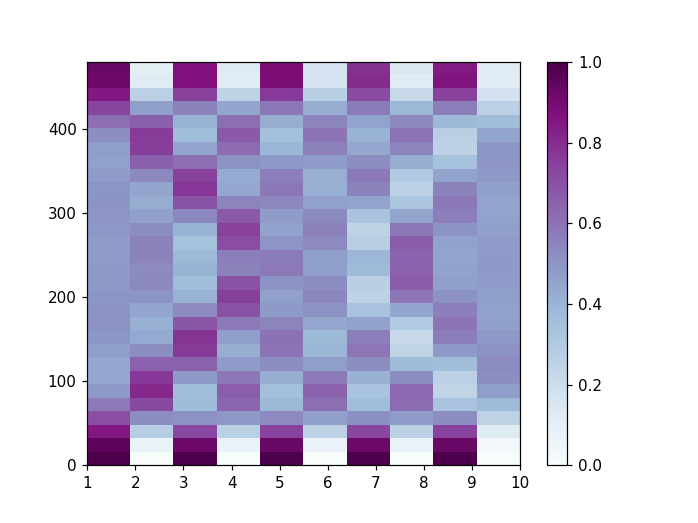

In [607]:
s_qWalk = np.load(r'D:\skzhao\Data\qWalk\echo.npz')['data']
plt.figure()
x =[0,480]
extent = [1,10,min(x),max(x)]
plt.imshow(s_qWalk[:,:],aspect='auto',extent=extent,origin='lower',cmap='BuPu')
plt.colorbar()

In [633]:
data = np.load(r'D:\skzhao\Vmodulation\2021\final\echo_q13579_4MHz_20210117215325.npz',allow_pickle=True)
s = data['value'][1]
x = data['value'][0]

In [634]:
x

array([  0.        ,   8.33333333,  16.66666667,  25.        ,
        33.33333333,  41.66666667,  50.        ,  58.33333333,
        66.66666667,  75.        ,  83.33333333,  91.66666667,
       100.        , 108.33333333, 116.66666667, 125.        ,
       133.33333333, 141.66666667, 150.        , 158.33333333,
       166.66666667, 175.        , 183.33333333, 191.66666667,
       200.        , 208.33333333, 216.66666667, 225.        ,
       233.33333333, 241.66666667])

In [639]:
np.arange(0,30/0.12,1/0.12)

array([  0.        ,   8.33333333,  16.66666667,  25.        ,
        33.33333333,  41.66666667,  50.        ,  58.33333333,
        66.66666667,  75.        ,  83.33333333,  91.66666667,
       100.        , 108.33333333, 116.66666667, 125.        ,
       133.33333333, 141.66666667, 150.        , 158.33333333,
       166.66666667, 175.        , 183.33333333, 191.66666667,
       200.        , 208.33333333, 216.66666667, 225.        ,
       233.33333333, 241.66666667])

In [636]:
dt = 1/0.12
times = np.arange(0,30*dt,dt)
times

array([  0.        ,   8.33333333,  16.66666667,  25.        ,
        33.33333333,  41.66666667,  50.        ,  58.33333333,
        66.66666667,  75.        ,  83.33333333,  91.66666667,
       100.        , 108.33333333, 116.66666667, 125.        ,
       133.33333333, 141.66666667, 150.        , 158.33333333,
       166.66666667, 175.        , 183.33333333, 191.66666667,
       200.        , 208.33333333, 216.66666667, 225.        ,
       233.33333333, 241.66666667])

In [1305]:
s_qWalk = np.load(r'D:\skzhao\Data\qWalk\echo_q246810.npz')['data']

<IPython.core.display.Javascript object>


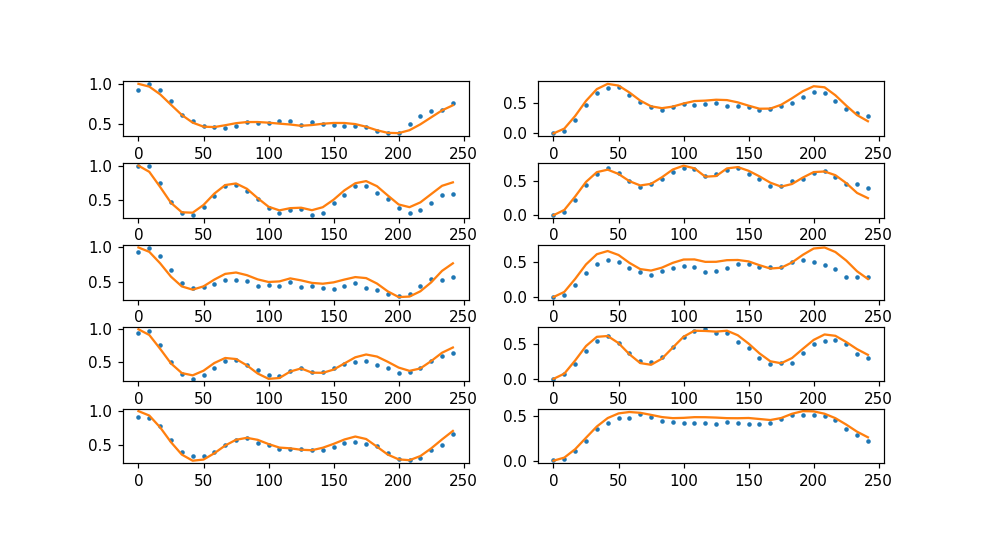

In [630]:
num = 10
height = 1
n = num // 2 + num % 2
fig, axes = plt.subplots(ncols=2,nrows=n,figsize=(9,height*n))
fig.subplots_adjust(top=0.85,bottom=0.15,hspace=0.5)
v = []
for i in range(num): 
    f, res,res1 = x,s[i,:], s_qWalk1[:,i]
    axes[i//2][i%2].plot(f,res,'o',markersize=2)
    axes[i//2][i%2].plot(f,res1)
#     axes[i//2][i%2].plot(f[15:],res[15:],'r-.')
#     axes[i//2][i%2].plot(f[15:],res1[15:],'y-.')

In [1307]:
dt = 1/0.12
x = np.arange(dt,30*dt,dt)
np.shape(s_qWalk)

(29, 10)

<IPython.core.display.Javascript object>


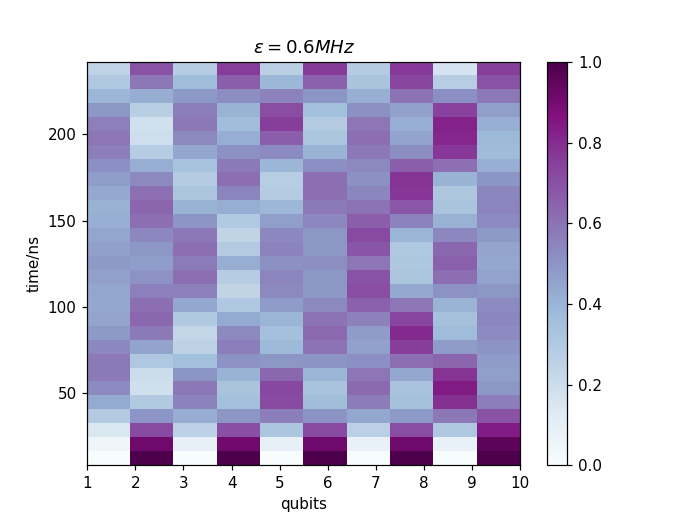

In [1306]:
s = s_qWalk
# for i in range(10):
#     if i%2!=0:
#         s[:,i] *=-1

plt.figure()
extent = [1,10,min(x),max(x)]
plt.imshow(s[:,:],aspect='auto',extent=extent,origin='lower',cmap='BuPu')
plt.ylabel('time/ns')
plt.xlabel('qubits')
plt.title('$\epsilon=0.6MHz$')
plt.colorbar()

In [294]:
np.max(s_qWalk,axis=0)

array([0.82900004, 1.        , 0.78852867, 1.        , 0.65648987,
       1.        , 0.65408933, 1.        , 0.50923311, 1.        ])

In [292]:
np.shape(s_qWalk)

(30, 10)

<IPython.core.display.Javascript object>


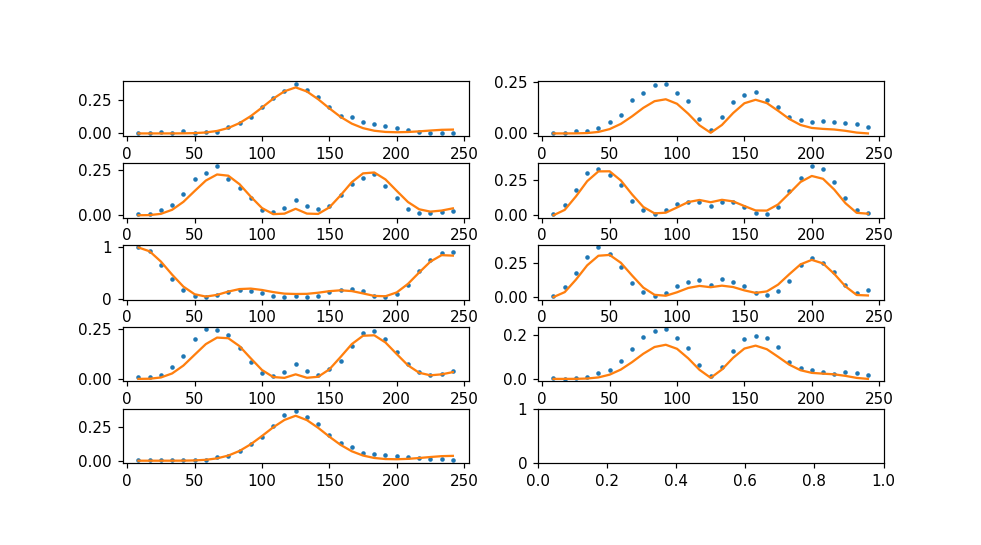

In [129]:
num = 9
height = 1
n = num // 2 + num % 2
fig, axes = plt.subplots(ncols=2,nrows=n,figsize=(9,height*n))
fig.subplots_adjust(top=0.85,bottom=0.15,hspace=0.5)
v = []
for i in range(num): 
    f, res,res1 = x,s[i,:], s_qWalk[:,i]
    axes[i//2][i%2].plot(f,res,'o',markersize=2)
    axes[i//2][i%2].plot(f,res1)
#     axes[i//2][i%2].plot(f[15:],res[15:],'r-.')
#     axes[i//2][i%2].plot(f[15:],res1[15:],'y-.')

In [79]:
np.shape(s_qWalk)

(30, 10)

<IPython.core.display.Javascript object>


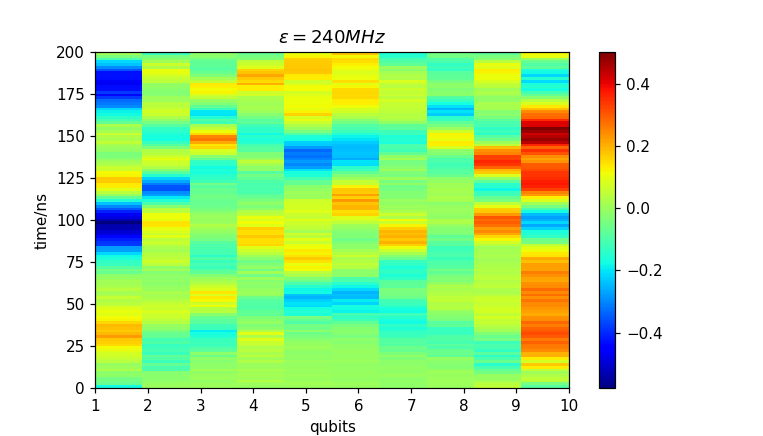

In [232]:
x = value[0][0]
s = [np.array(value)[i,1,:] for i in [0,1,2,3,4,5,6,7,8,9]]
s = np.array(s).T/np.max(s)
s_qWalk = np.load(r'D:\skzhao\Data\qWalk\qWalk.npz')['value']
plt.figure(figsize=(7,4))
extent = [1,10,min(x),max(x)]
plt.imshow(np.array(s-s_qWalk),aspect='auto',extent=extent,origin='lower',cmap='jet')
plt.ylabel('time/ns')
plt.xlabel('qubits')
plt.title('$\epsilon=240MHz$')
plt.colorbar()

# 多体Echo

In [918]:
# fig, axes = plt.subplots(num='mEcho',ncols=2,nrows=5,figsize=(7,1.5*5))
# fig.subplots_adjust(top=0.98,bottom=0.1,hspace=0.2)

<IPython.core.display.Javascript object>


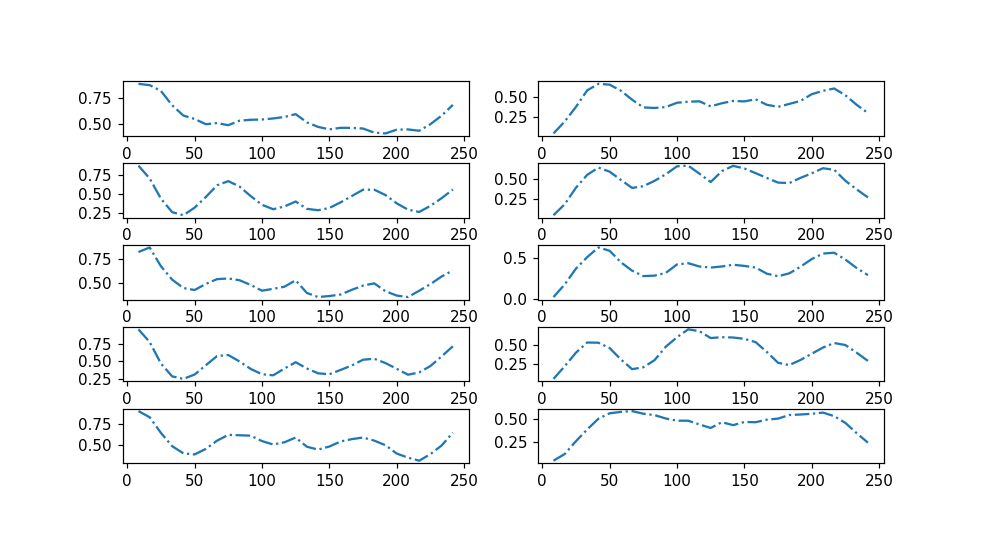

['ex-q13579', '4MHz', '-0.0314', '-0.2508', '-0.0819', '-0.2759', '-0.0486', '-0.4775', '-0.1849', '-0.359', '-0.2499', '-0.1065'] 2021-02-03 22:20:03.014358


In [610]:
value,num,tags,finishtime = write(title='mEcho',height=1,which=12,peak=11200,transposition=False)
print(tags,finishtime)

In [297]:
x = value[0][0]
s = [np.array(value)[i,1,:] for i in [0,1,2,3,4,5,6,7,8]]

In [76]:
save('echo_q5_withoutq1_4MHz',tags,base_path=r'D:\skzhao\Vmodulation',value=[value[0][0],np.abs(s)],tags=tags,finisfedtime=str(finishtime))

WindowsPath('D:/skzhao/Vmodulation/2021/0126/echo_q5_withoutq1_4MHz_20210126185938.npz')

In [168]:
s1 = np.load(r'mEcho_classify.npz')['s']

<IPython.core.display.Javascript object>


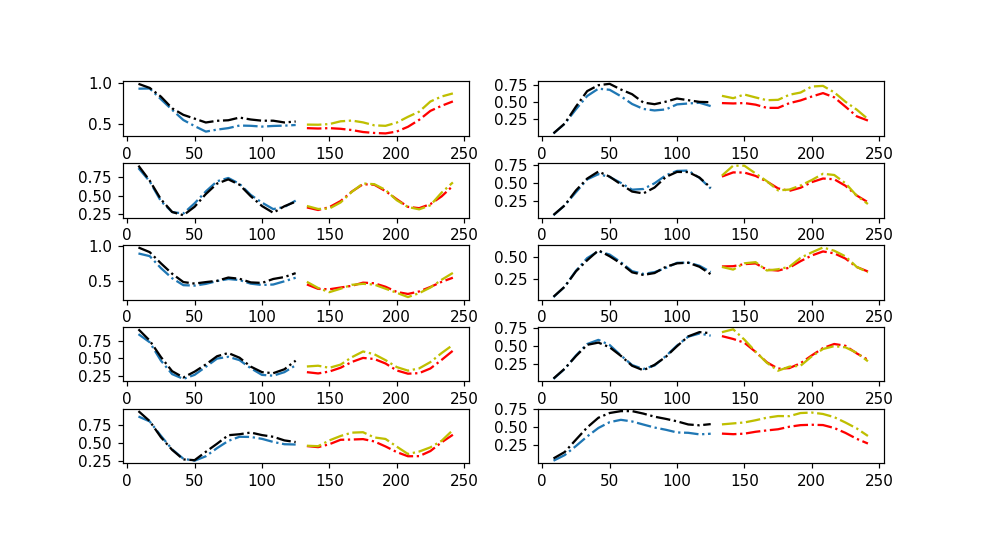

In [169]:
num = 10
height = 1
n = num // 2 + num % 2
fig, axes = plt.subplots(ncols=2,nrows=n,figsize=(9,height*n))
fig.subplots_adjust(top=0.85,bottom=0.15,hspace=0.5)
v = []
for i in range(num): 
    f, res,res1 = x,np.array(s)[i,:], s1[i,:]
    axes[i//2][i%2].plot(f[:15],res[:15],'-.')
    axes[i//2][i%2].plot(f[:15],res1[:15],'k-.')
    axes[i//2][i%2].plot(f[15:],res[15:],'r-.')
    axes[i//2][i%2].plot(f[15:],res1[15:],'y-.')

<IPython.core.display.Javascript object>


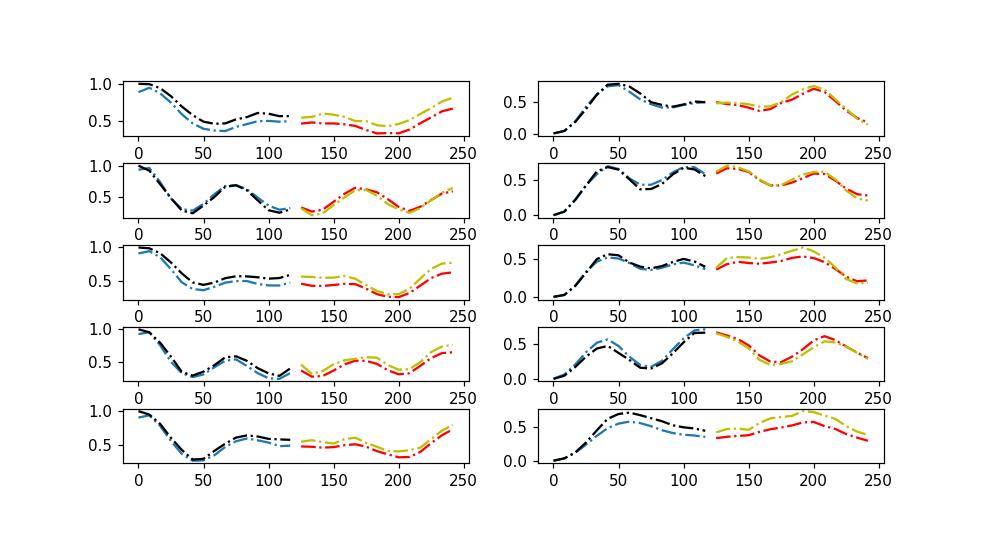

In [209]:
num = 10
height = 1
n = num // 2 + num % 2
fig, axes = plt.subplots(ncols=2,nrows=n,figsize=(9,height*n))
fig.subplots_adjust(top=0.85,bottom=0.15,hspace=0.5)
v = []
for i in range(num): 
    f, res,res1 = x,np.array(s)[i,:], s1[i,:]
    axes[i//2][i%2].plot(f[:15],res[:15],'-.')
    axes[i//2][i%2].plot(f[:15],res1[:15],'k-.')
    axes[i//2][i%2].plot(f[15:],res[15:],'r-.')
    axes[i//2][i%2].plot(f[15:],res1[15:],'y-.')

<IPython.core.display.Javascript object>


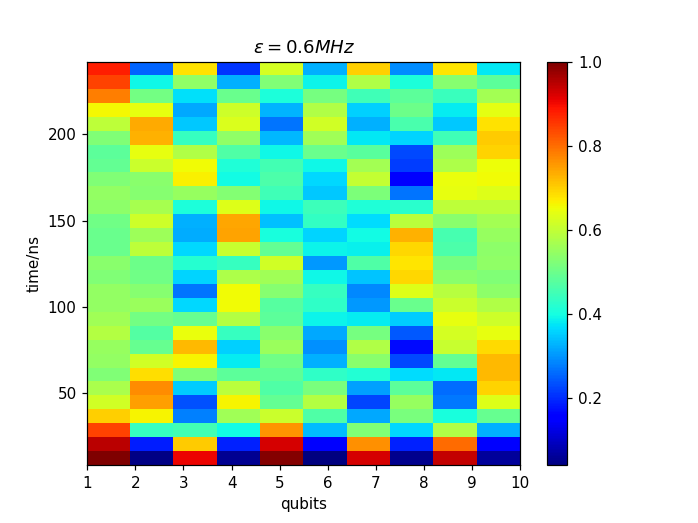

In [295]:
x = value[0][0]
# s = [np.array(value)[i,1,:] for i in [0,1,2,3,4,5,6,7,8,9]]
s = s1
plt.figure()
extent = [1,10,min(x),max(x)]
plt.imshow(np.abs(s).T/np.max(s),aspect='auto',extent=extent,origin='lower',cmap='jet')
plt.ylabel('time/ns')
plt.xlabel('qubits')
plt.title('$\epsilon=0.6MHz$')
plt.colorbar()

In [251]:
save('echo_q13579_4MHz',tags,base_path=r'D:\skzhao\Vmodulation',value=[value[0][0],np.abs(s)/np.max(s)],tags=tags,finisfedtime=str(finishtime))

WindowsPath('D:/skzhao/Vmodulation/2021/0117/echo_q13579_4MHz_20210117215325.npz')

In [867]:
x = value[0][0]
# s = [np.array(value)[i,1,:] for i in [0,1,2,3,4,5,6,7,8,9]]
plt.figure(num='mEcho')
for i in range(10):
    axes[i//2][i%2].plot(x,np.array(value)[i,1,:])
# plt.plot(np.array(s).T)
# plt.ylabel('time/ns')
# plt.xlabel('qubits')
# plt.title('$\epsilon=288.6MHz$')

In [105]:
save('mEcho4MHz_final_q13579_opt',tags,base_path=r'D:\skzhao\Vmodulation',value=value,tags=tags,finisfedtime=str(finishtime))

WindowsPath('D:/skzhao/Vmodulation/2021/0116/mEcho4MHz_final_q13579_opt_20210116103852.npz')

<IPython.core.display.Javascript object>


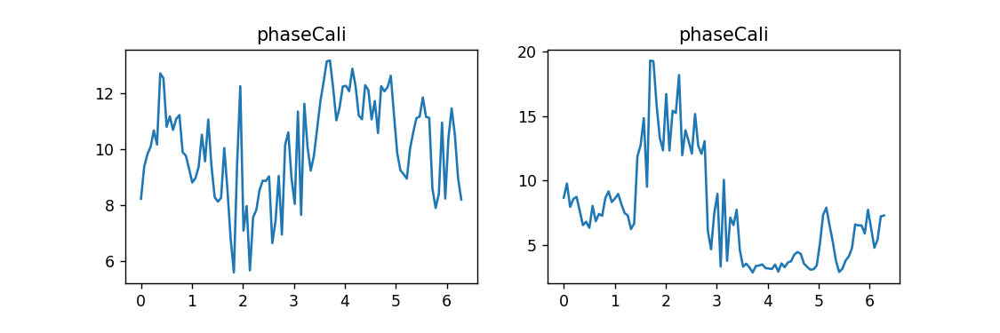

['90.0MHz', 'dc-q4', 'ex-q93'] 2020-12-06 19:34:37.209756


In [54]:
value,num,tags,finishtime = write(height=3,which=0,peak=11200,transposition=False)
print(tags,finishtime)

<IPython.core.display.Javascript object>


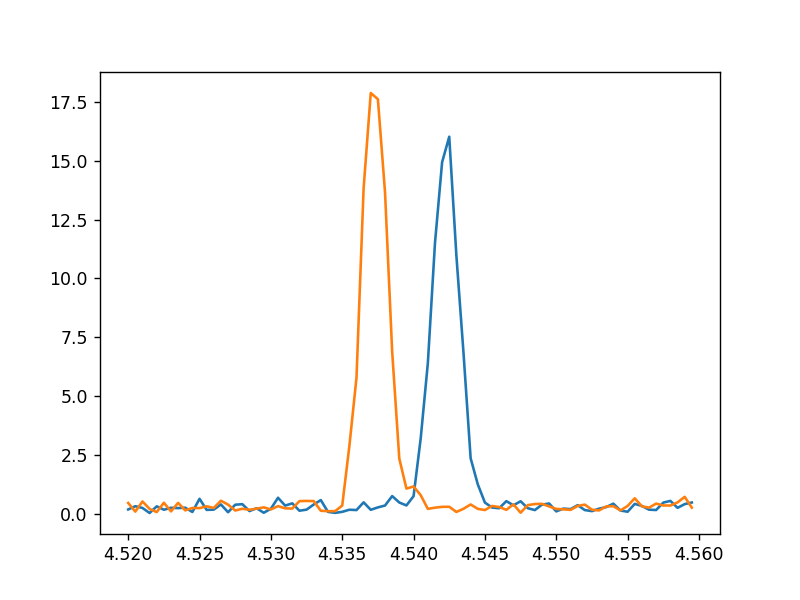

In [793]:
plt.figure()
plt.plot(value[0][1],np.abs(value[0][2][0,:]))
plt.plot(value[0][1],np.abs(value[0][2][-1,:]))

In [72]:
data = np.load(r'D:\skzhao\Vmodulation\2021\0119\mEcho_q13579_20210119143957.npz')
s = data['value']
np.shape(s)

(30000, 30, 10)

<IPython.core.display.Javascript object>


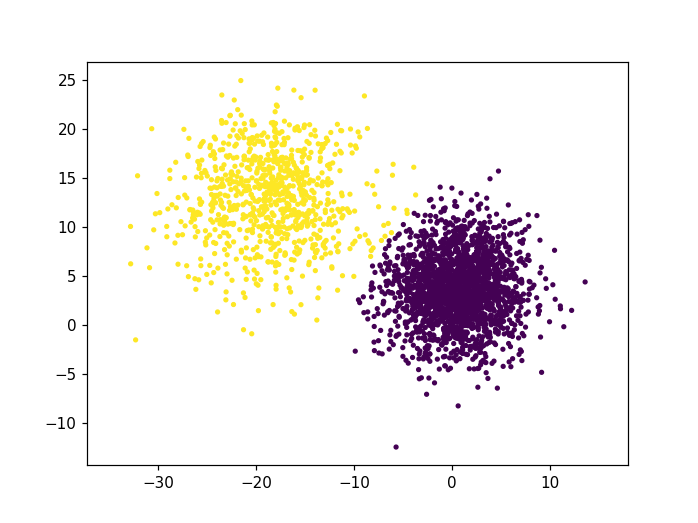

(-35.14041683865968,
 15.947404776770764,
 -14.340378608020012,
 26.845712331481796)

In [73]:
y = s[0::10,-1,7]
x,z = np.real(y), np.imag(y)
d = list(zip(x,z))
c = postSle['q8'](d)
plt.figure()
plt.scatter(np.real(y),np.imag(y),c=c,s=6)
plt.axis('equal')

In [46]:
import pickle
fname=r'D:\skzhao\log\status_with_q1_piopt.obj'
with open(fname, 'rb') as f:
    status = pickle.load(f)
postSle = status[-3]

In [66]:
x0 = value[0][0]
y0 = op.RowToRipe().smooth(np.abs(value[1][1]),f0=0.2)
res, func = op.Cos_Fit().fitCos(x0[x0>0], np.abs(value[0][1])[x0>0])
w,yt,amp = op.RowToRipe().fourier(x0, np.abs(value[0][1]))
paras = res.x
fig = plt.gcf()
ax = plt.getp(fig,'axes')
x = np.linspace(min(x0),max(x0),2001)
ax[0].plot(x,func(x,paras))
ax[0].plot(x0,y0)
ax[1].plot(yt,np.abs(amp))
ax[1].plot(w,np.max(np.abs(amp)),'ro')
# ax[0].vlines((paras[2]+paras[3])/2,np.min(np.abs(value[0][1])),np.max(np.abs(value[0][1]))) 

In [266]:
f1,f2=6.6417e3,6.6485e3
fm = (f1+f2)/2+2
f1-fm,f2-fm

(-5.400000000000546, 1.3999999999996362)

In [467]:
paras.fun

58.10234734659294

In [127]:
f = (value[0][0])

<IPython.core.display.Javascript object>


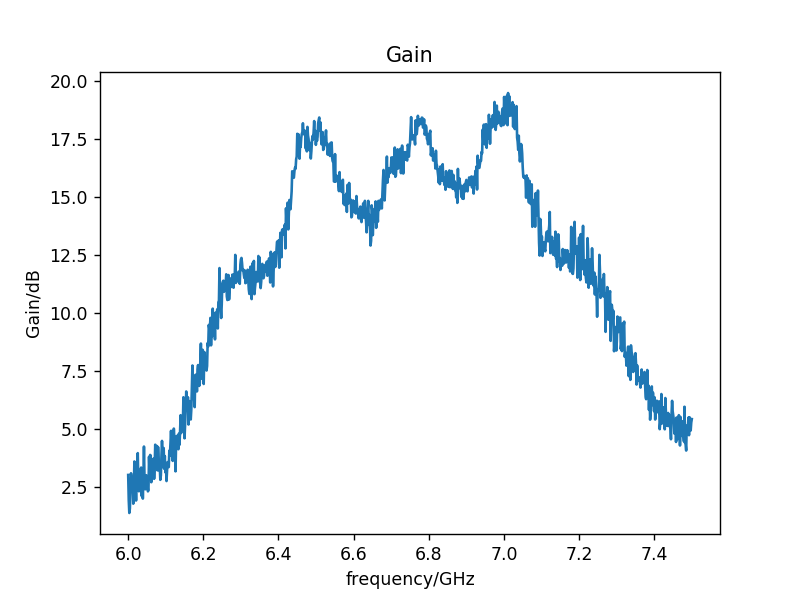

Text(0, 0.5, 'Gain/dB')

In [143]:
plt.figure()
# plt.plot(f,abs(d_on))
# plt.plot(f,abs(d_off))
plt.plot(f,20*np.log10(abs(d_on))-20*np.log10(abs(d_off)))
plt.title('Gain')
plt.xlabel('frequency/GHz')
plt.ylabel('Gain/dB')
# plt.legend('NF')

In [112]:
np.savez('jpa_off_1111',data = value)

In [402]:
flux, power, sf = value[0][0], value[0][1], value[0][2]
index = np.argwhere(np.abs(sf)==np.max(np.abs(sf)))[0]
p_op, c_op = power[index[1]], flux[index[0]]
print('current=%f, power=%f'%(c_op,p_op))

current=-1.250000, power=4.700000


In [147]:
(4.844-4.714)*2

0.2599999999999998

<IPython.core.display.Javascript object>


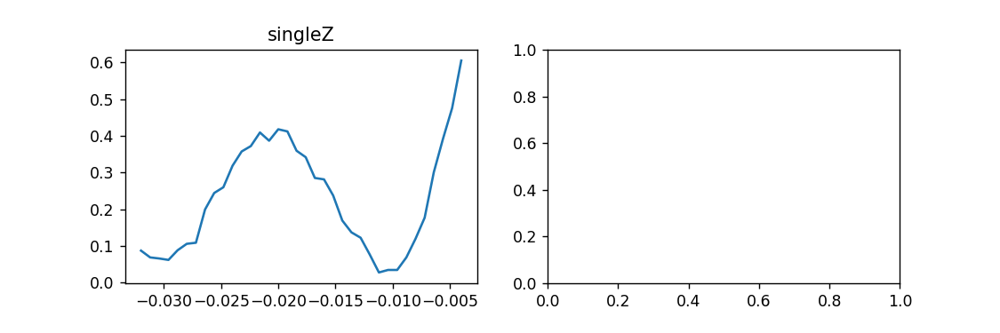

[] 2020-11-11 11:35:07.117446


In [150]:
value,num,tags,finishtime = write(height=3,which=0,peak=11200)
print(tags,finishtime)

<IPython.core.display.Javascript object>


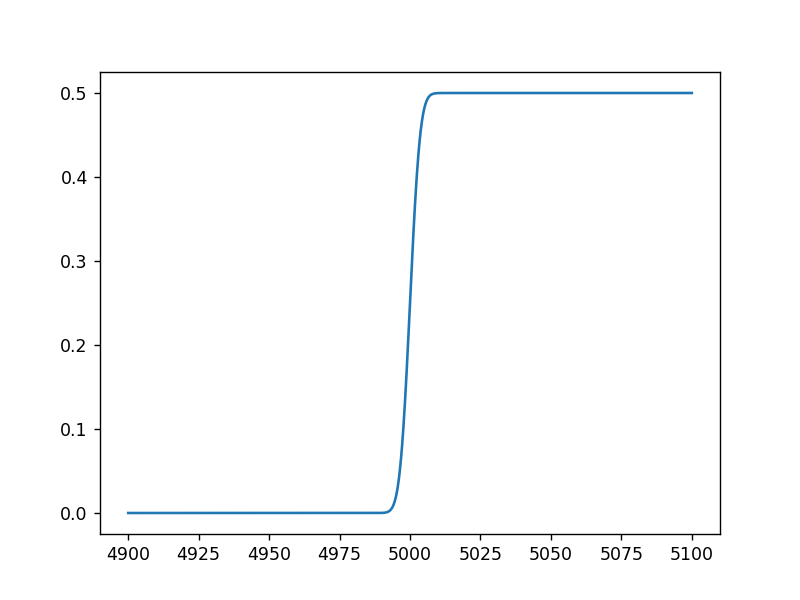

In [145]:
func = lambda t: (scipy.special.erf((t-5000)/4)+1)/2*0.5
t = np.linspace(4900,5100,1001)
plt.figure()
plt.plot(t,func(t))

<IPython.core.display.Javascript object>


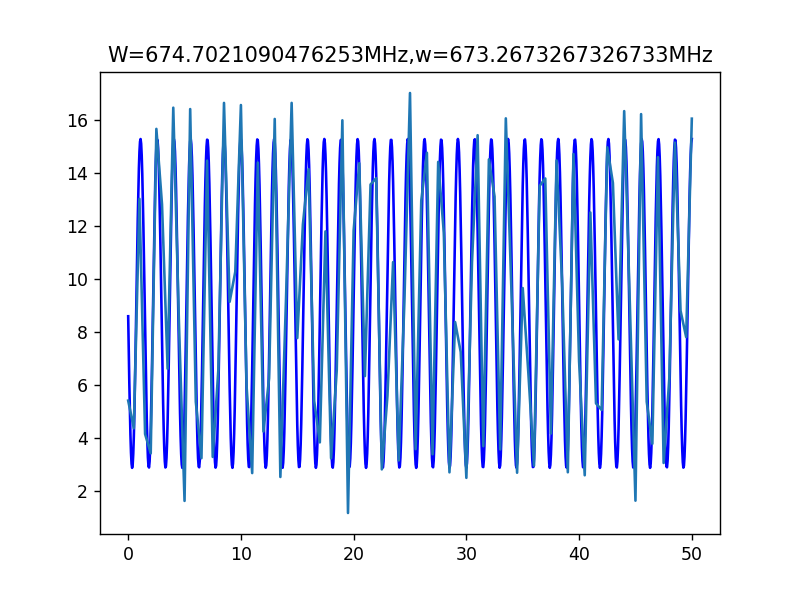

Text(0.5, 1.0, 'W=674.7021090476253MHz,w=673.2673267326733MHz')

In [117]:
x, y = value[1][0], np.abs(value[1][1])
res, func = op.Cos_Fit().fitCos(x,y)
w,yt,amp = op.RowToRipe().fourier(x, y)
A, C, W, phi = res.x
xnew = np.linspace(min(x),max(x),1001)
y1 = A*np.cos(2*np.pi*W*xnew+phi)
plt.figure()
plt.plot(xnew,y1+C,'b-')
plt.plot(x,y)
plt.title(f'W={W*1e3}MHz,w={w*1e3}MHz')

In [523]:
W

0.1587462809771947

In [318]:
value[0]

(array([0.  , 0.01, 0.02, 0.03, 0.04, 0.05, 0.06, 0.07, 0.08]),
 array([0.6662234 , 0.67054521, 0.68151596, 0.69514628, 0.70611702,
        0.72074468, 0.73271277, 0.7400266 , 0.7450133 ]))

In [319]:
data, ID, comment, tags, name, finishtime = read(title='singleVrabi',which=0)
print(finishtime)

2020-11-07 17:02:36.581156


In [2415]:
(4.419-4.314)*2

0.20999999999999908

<IPython.core.display.Javascript object>


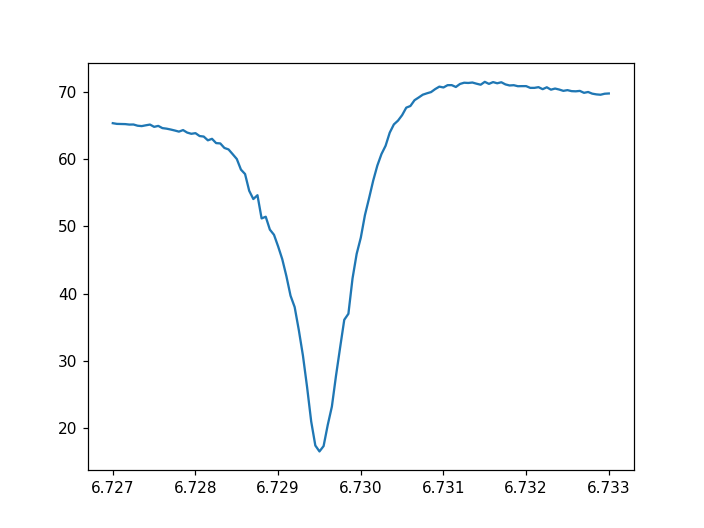

In [703]:
plt.figure()
plt.plot(value[0][1],np.abs(value[0][2][7]))
plt.show()

<IPython.core.display.Javascript object>


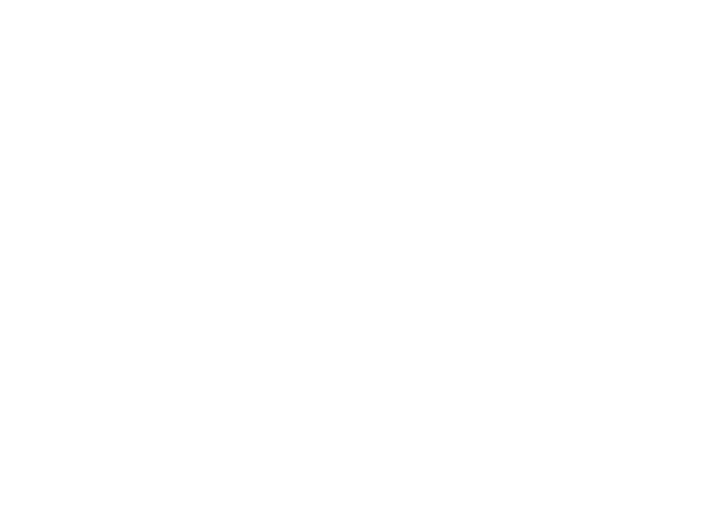

In [113]:
x,y,z = value[0][0], value[0][1], np.abs(value[0][2])
plt.figure()
plt.pcolor(z)

<IPython.core.display.Javascript object>


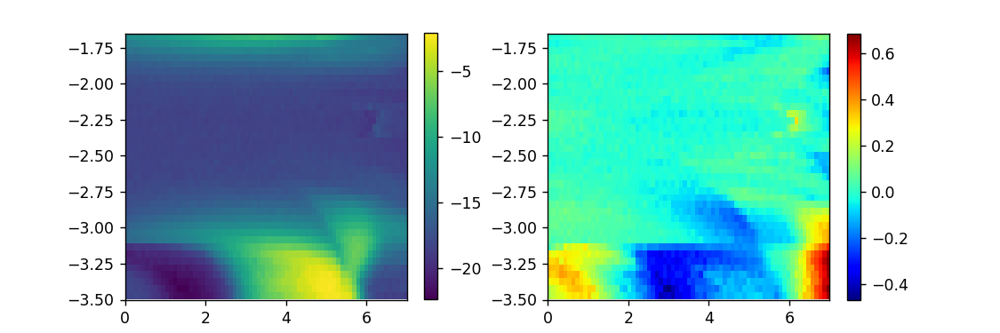

['bluefors_jpa_xue', 'fcenter=6750000000.0'] 2020-09-30 18:40:26.858460


In [36]:
value,num,tags,finishtime = write(title='BiasvsPump',height=3,which=0,peak=1120,phase='phase',dePhase=True,dB=True)
print(tags,finishtime)

# oToc_tomo

In [43]:
def rotation(x,y):
    theta = np.arctan(y/x)
    if x>=0 and y>=0:
        theta += 0
    if x<0 and y>=0:
        theta += np.pi
    if x<0 and y<0:
        theta += np.pi
    if x>=0 and y<0:
        theta += np.pi*2
    return theta

2021-02-25 01:43:01.864746 ['q1', '-0.0314', '-0.2508', '-0.0819', '-0.2759', '-0.0486', '-0.4775', '-0.1849', '-0.359', '-0.2499', '-0.1065']


<IPython.core.display.Javascript object>


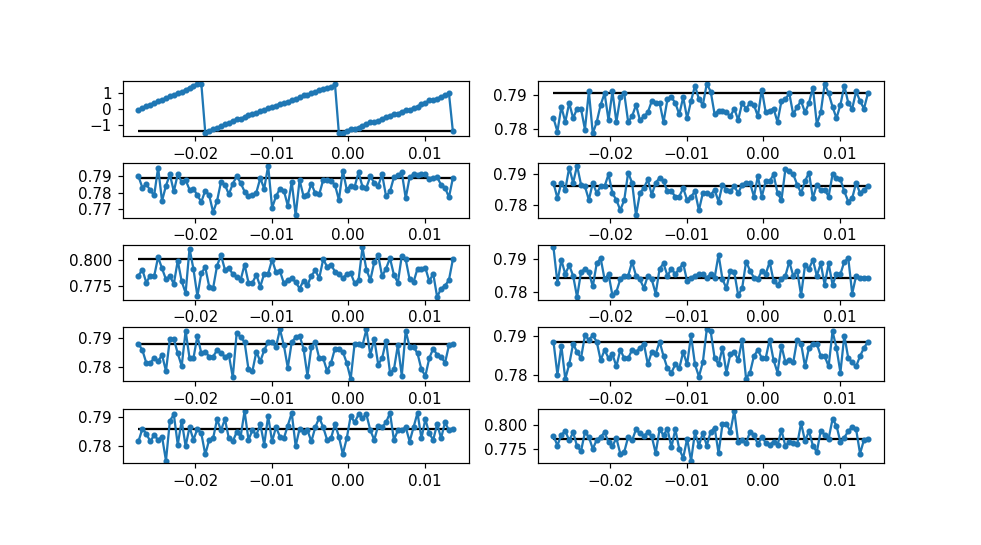

In [10]:
value, ID, comment, tags, name, finishtime = read(title='oToc_wave_single',which=9)
print(finishtime,tags)
td, pop_d, popm = value
num = 10
height = 1
n = num // 2 + num % 2
fig, axes = plt.subplots(ncols=2,nrows=n,figsize=(9,height*n))
fig.subplots_adjust(top=0.85,bottom=0.15,hspace=0.5)
for i in range(num): 
    data = [[1-2*j[i] for i in range(3)] for j in pop_d[:,:,i]]
    theta = np.arctan(np.array(data)[:,1]/np.array(data)[:,0])
    v = td[:,i]
    axes[i//2][i%2].plot(v,theta,'-o',markersize=3)
    axes[i//2][i%2].hlines(theta[0],min(v),max(v))
#     axes[i//2][i%2].vlines(v[54],-1,1)

2021-02-25 01:43:01.864746 ['q1', '-0.0314', '-0.2508', '-0.0819', '-0.2759', '-0.0486', '-0.4775', '-0.1849', '-0.359', '-0.2499', '-0.1065']


<IPython.core.display.Javascript object>


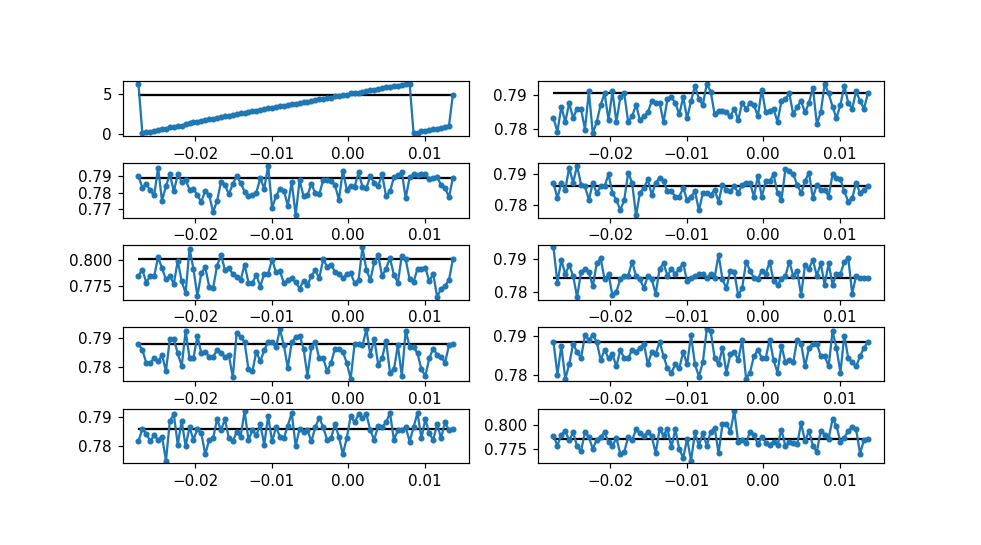

In [26]:
value, ID, comment, tags, name, finishtime = read(title='oToc_wave_single',which=9)
print(finishtime,tags)
td, pop_d, popm = value
num = 10
height = 1
n = num // 2 + num % 2
fig, axes = plt.subplots(ncols=2,nrows=n,figsize=(9,height*n))
fig.subplots_adjust(top=0.85,bottom=0.15,hspace=0.5)
for i in range(num): 
    data = [[1-2*j[i] for i in range(3)] for j in pop_d[:,:,i]]
    theta = list(map(rotation,np.array(data)[:,0],np.array(data)[:,1]))
    v = td[:,i]
    axes[i//2][i%2].plot(v,theta,'-o',markersize=3)
    axes[i//2][i%2].hlines(theta[0],min(v),max(v))
#     axes[i//2][i%2].hlines(theta[0]-np.pi,min(v),max(v))
#     axes[i//2][i%2].vlines(v[54],-1,1)

In [11]:
s = []
t = []
for j in range(10):
    value, ID, comment, tags, name, finishtime = read(title='oToc_wave_single',which=(9-j))
    td, pop_d, popm = value
    for i in range(num): 
        data = [[1-2*j[i] for i in range(3)] for j in pop_d[:,:,i]]
        theta = list(map(rotation,np.array(data)[:,0],np.array(data)[:,1]))
        if i == j:
            s.append(theta)
            t.append(td[:,i])

<IPython.core.display.Javascript object>


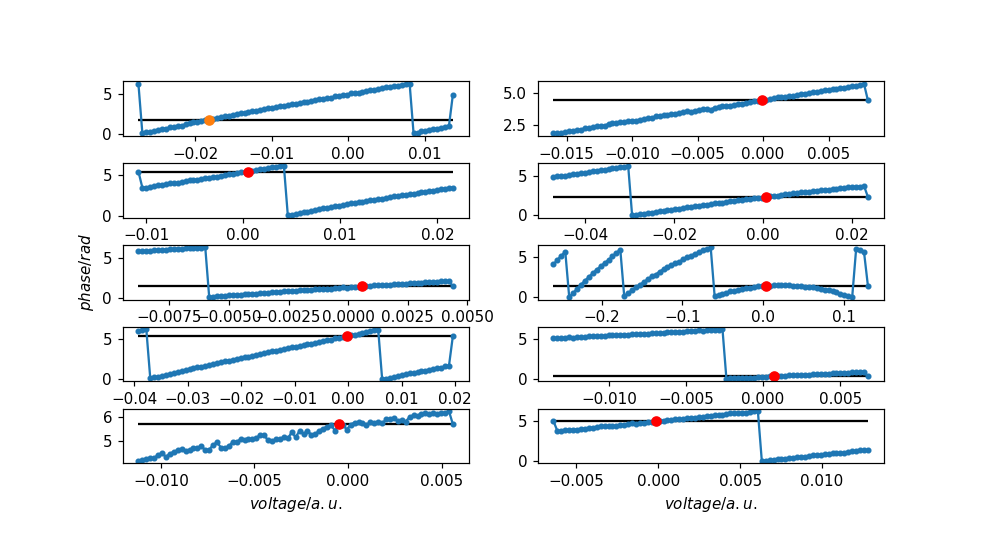

In [12]:
fig, axes = plt.subplots(ncols=2,nrows=n,figsize=(9,height*n))
fig.subplots_adjust(top=0.85,bottom=0.15,hspace=0.5)
# fig.set_label('x')
# plt.grid('both')
# plt.tight_layout()
for i in range(num): 
#     data = [[1-2*j[i] for i in range(3)] for j in pop_d[:,:,i]]
    theta = s[i]
    v = t[i]
    axes[i//2][i%2].plot(v,np.array(theta),'-o',markersize=3)
    if i != 0:
        _, vtarget = dt.nearest(theta[1:],theta[0],v[1:])
        axes[i//2][i%2].hlines(theta[0],min(v),max(v))
        axes[i//2][i%2].plot(vtarget,theta[0],'ro')
#         axes[i//2][i%2].grid(which='major')
    if i==0:
        _, vtarget = dt.nearest(theta[1:],(theta[0]-np.pi),v[1:])
        axes[i//2][i%2].plot(vtarget,theta[0]-np.pi,'o')
        axes[i//2][i%2].hlines(theta[0]-np.pi,min(v),max(v))

In [13]:
axes[2][0].set_ylabel('$phase/rad$')
axes[4][0].set_xlabel('$voltage/a.u.$')
axes[4][1].set_xlabel('$voltage/a.u.$')
# plt.tight_layout()

Text(0.5, 50.15151515151514, '$voltage/a.u.$')

In [14]:
plt.savefig(r'D:\Q03测量数据\fig\otoc_tomo.pdf',dpi=1200)

In [264]:
q1.volt_zgate = -0.01831
q2.volt_zgate = -0.00009
q3.volt_zgate = 0.00038
q4.volt_zgate = 0.00061
q5.volt_zgate = 0.00061
q6.volt_zgate = 0.04272
q7.volt_zgate = -0.00023
q8.volt_zgate = 0.00044
q9.volt_zgate = 0.00183
q10.volt_zgate = -0.00015

54.0

# phase_gate

2021-01-12 16:16:12.668430 ['q1']


<IPython.core.display.Javascript object>


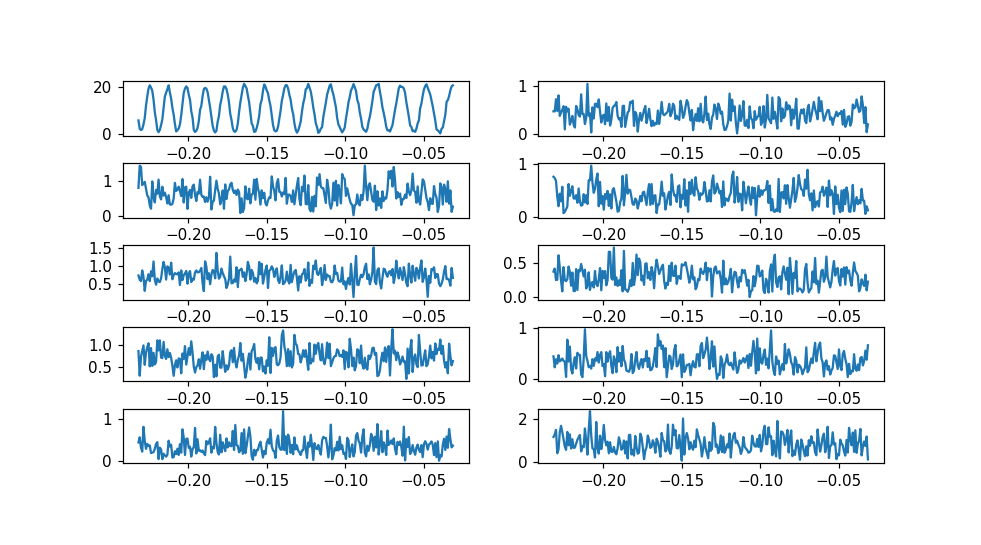

In [336]:
value, ID, comment, tags, name, finishtime = read(title='Phase_gate',which=76)
print(finishtime,tags)
td, pop_d = value
num = 10
height = 1
n = num // 2 + num % 2
fig, axes = plt.subplots(ncols=2,nrows=n,figsize=(9,height*n))
fig.subplots_adjust(top=0.85,bottom=0.15,hspace=0.5)
for i in range(num): 
    axes[i//2][i%2].plot(td[:,i],np.abs(pop_d[:,i]))

In [488]:
s = []
t = []
for j in range(10):
    value, ID, comment, tags, name, finishtime = read(title='Phase_gate',which=(76-j))
    td, pop_d = value
    for i in range(10): 
        if i == j:
            s.append(pop_d[:,i])
            t.append(td[:,i])

<IPython.core.display.Javascript object>


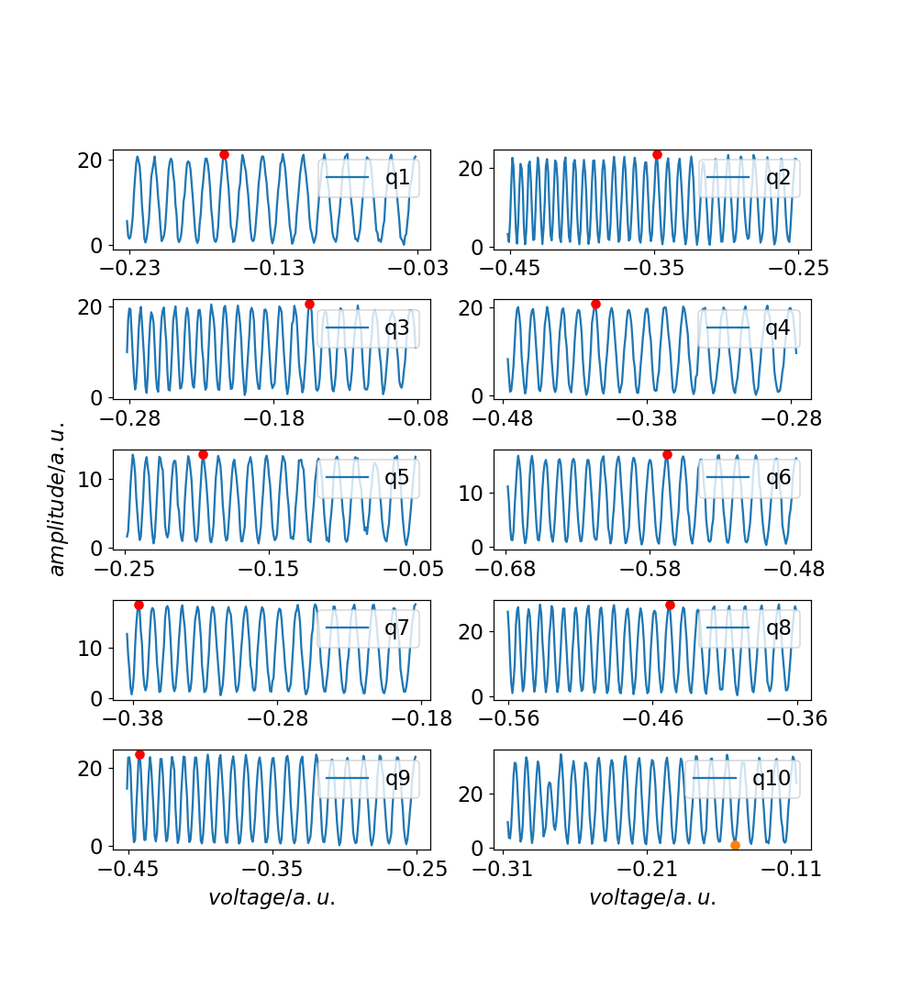

In [498]:
fig, axes = plt.subplots(ncols=2,nrows=5,figsize=(9,2*5))
fig.subplots_adjust(top=0.85,bottom=0.15,hspace=0.5)
for i in range(10): 
    theta = np.abs(s[i])
    v = t[i]
    xmin, xmax = np.min(v), np.max(v)
    axes[i//2][i%2].plot(v,np.abs(theta),label=f'q{i+1}')
    axes[i//2][i%2].legend(loc='upper right',fontsize=fontsize)
    axes[i//2][i%2].tick_params(labelsize=fontsize)
    
    if i != 9:
        _, vtarget = dt.nearest(theta,np.max(theta),v)
#         axes[i//2][i%2].hlines(theta[0],min(v),max(v))
        axes[i//2][i%2].plot(vtarget,np.max(theta),'ro')
    
#         axes[i//2][i%2].grid(which='major')
    if i==9:
        _, vtarget = dt.nearest(theta,np.min(theta),v)
        axes[i//2][i%2].plot(vtarget,np.min(theta),'o')
    axes[i//2][i%2].set_xticks(np.around(np.linspace(xmin,xmax,3),2))
#         axes[i//2][i%2].hlines(theta[0]-np.pi,min(v),max(v))
# plt.xticks(fontsize=20)
# plt.yticks(fontsize=20)

In [487]:
np.shape(s)

(1, 251)

In [499]:
axes[2][0].set_ylabel('$amplitude/a.u.$',fontsize=fontsize)
axes[4][0].set_xlabel('$voltage/a.u.$',fontsize=fontsize)
axes[4][1].set_xlabel('$voltage/a.u.$',fontsize=fontsize)

Text(0.5, 123.96969696969697, '$voltage/a.u.$')

In [500]:
plt.savefig(r'D:\skzhao\fig\phase_gate.pdf',dpi=1200)

# 优化失谐

<IPython.core.display.Javascript object>


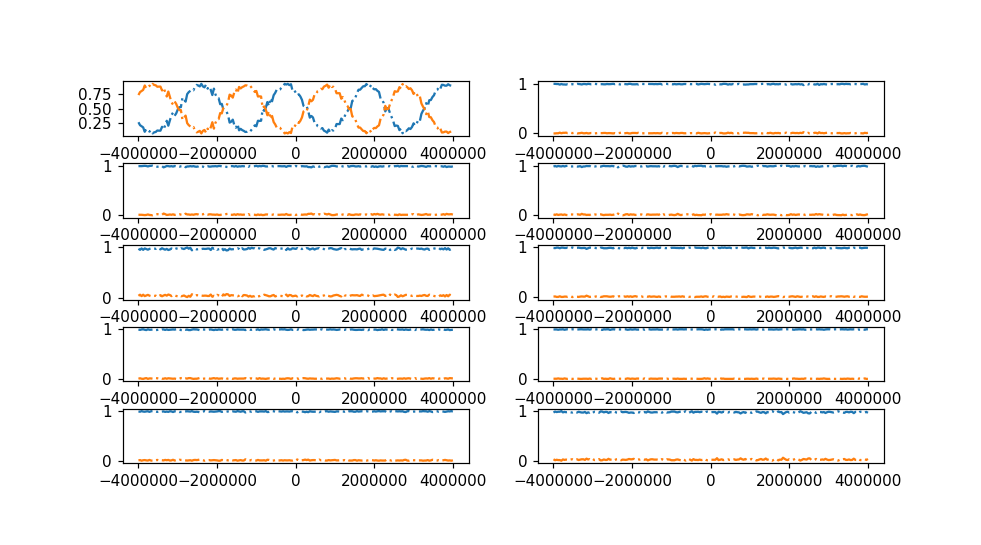

['q1'] 2021-02-02 19:23:13.040051


In [140]:
value,num,tags,finishtime = write(title='optPidetune',height=1,which=9,peak=11200,transposition=True)
print(tags,finishtime)

<IPython.core.display.Javascript object>


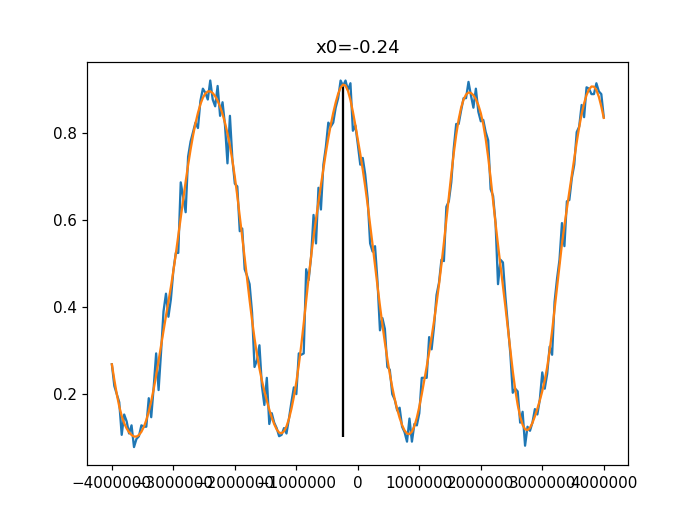

Text(0.5, 1.0, 'x0=-0.24')

In [141]:
num = eval(tags[0][1:]) - 1
x, y = value[num][0],np.abs(value[num][1])[:,0]
y0 = op.RowToRipe().smooth(y,f0=0.2)
x_candidate = x[scipy.signal.argrelmax(y0)[0]]
index, x_target = dt.nearest(x_candidate,0,x_candidate)
# res, f = op.Cos_Fit(phi=0).fitCos(x,y0)
# A, C, W, phi = res.x
plt.figure()
# xnew = np.linspace(min(x),max(x),1001)
plt.plot(x,y)
plt.plot(x,y0)
plt.vlines(x_target,min(y0),max(y0))
plt.title(f'x0={x_target/1e6}')
# plt.plot(xnew,f(xnew,res.x),'-o',markersize=2)

In [59]:
dt.nearest(x[scipy.signal.argrelmax(y0)[0]],0)

2

# 拟合谱

In [105]:
data, ID, comment, tags, name, finishtime = read(title='singlespec',which=10)
num = len(data[0].T)
print(finishtime)
f_ss, s_ss = np.array(data)[0,:,:], np.array(data)[1,:,:]
index = np.abs(s_ss).argmax(axis=0)
x,y,z,band= f_ss/1e9, s_ss,[],[]
for i in range(np.shape(s_ss)[1]):

    res, e = op.Lorentz_Fit().fitLorentz(x[:,i],np.abs(y[:,i]))
    a,b,c,d = res.x
    z.append(a/(1.0+c*(x[:,i]-b)**2)+d)
    band.append((b,e))
z = np.array(z).T
f_rabi = np.array([x[:,i][j] for i, j in enumerate(index)])
n = num // 2 + num % 2
fig, axes = plt.subplots(ncols=2,nrows=n,figsize=(9,2*n))
fig.subplots_adjust(top=0.85,bottom=0.15,hspace=0.5)
for i in range(num): 
    if n != 1:
        axes[i//2][i%2].plot(x[:,i],np.abs(y[:,i]),'-o',markersize=2)
        axes[i//2][i%2].plot(x[:,i],z[:,i],alpha=1)
    else:
        axes[i].plot(x[:,i],np.abs(y[:,i]),'-o',markersize=2)
        axes[i].plot(x[:,i],z[:,i],alpha=1)
plt.show()

2020-11-16 09:32:59.449937


ValueError: not enough values to unpack (expected 2, got 1)

<IPython.core.display.Javascript object>


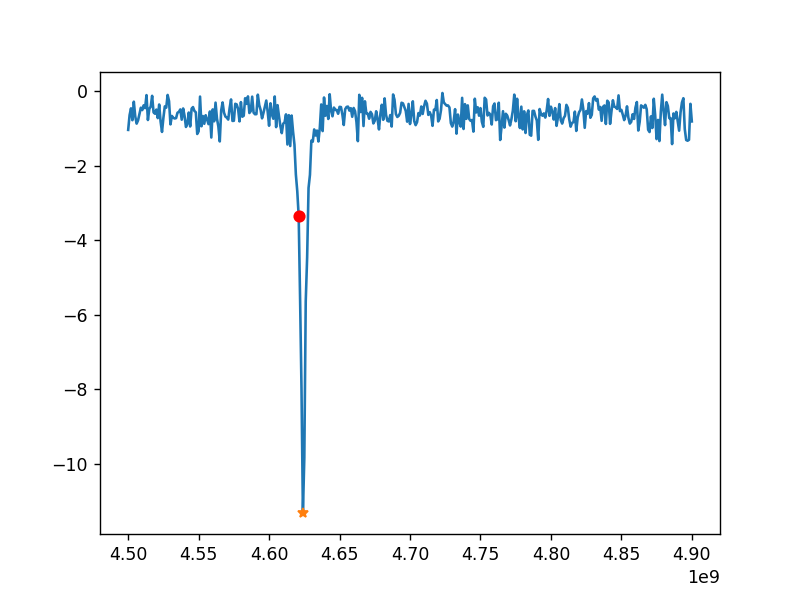

In [723]:
data, ID, comment, tags, name, finishtime = read(title='singlespec',which=0)
x, y = data[0][:,0], -np.abs(data[1][:,0])
index, half_widths, prominence = op.RowToRipe().findPeaks(y,rel_height=0.5)
plt.figure()
plt.plot(x,y)
plt.plot(x[index],y[index],'*')
plt.plot(x[121],y[121],'ro')

In [718]:
half_widths

(array([127], dtype=int64), array([121], dtype=int64))

In [659]:
widths

array([], dtype=float64)

In [685]:
property_peaks[1]['right_bases']

array([223], dtype=int64)

# 拟合Q值

In [69]:
data, ID, comment, tags, name, finishtime = read(title='S21',which=0)
print(finishtime,tags)

2021-01-21 21:18:48.390401 ['q1']


<IPython.core.display.Javascript object>


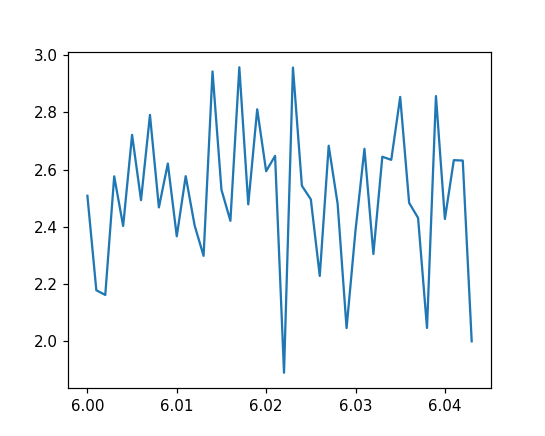

In [70]:
f, s21 = data[0][:,0]/1e9, data[1][:,0]
# f0, Qi, Qe, QL, phi, f, s = op.Cavity_fit().fitCavity(f,s21)
plt.figure(figsize=(5,4))
plt.plot(f,np.abs(s21))
# plt.title(f'Low Power_ATS_q1, Qi={int(Qi)},Qe={int(Qe)},QL={int(QL)}')
# plt.plot(f,1/np.abs(op.Cavity_fit().invS21(f, f0, Qi, Qe, phi)))
plt.show()

In [ ]:
from qulab import getplotlydat
gpd = imp.reload(getplotlydat)
path = r'D:\step1\14Q1changePwr.html'
x, y, z = gpd.gethtmldata(path,flag='x'), gpd.gethtmldata(path,flag='y'), gpd.gethtmldata(path,flag='z')


In [818]:
data = np.load(r'D:\skzhao\data\ffsu\Nb10bits_2_cuqiang\2020\0824\S21\q6_20200824171301.npz')

In [820]:
f, s21 = data['ffrr'], data['dataGhz']
# f0, Qi, Qe, QL, phi, f, s = op.Cavity_fit().fitCavity(f,s21)
plt.figure(figsize=(5,4))
plt.plot(f,np.abs(s))
plt.title(f'Low Power_wangzhan, Qi={int(Qi)},Qe={int(Qe)},QL={int(QL)}')
# plt.plot(f,1/np.abs(op.Cavity_fit().invS21(f, f0, Qi, Qe, phi)))
plt.show()

KeyError: 'ffrr is not a file in the archive'

In [333]:
tag = ''
for i in tags:
    tag += i
save('S21',tag,base_path=r'D:\skzhao\data\ffsu\Nb10bits_2_cuqiang',row=data[0],col=data[1])

WindowsPath('D:/skzhao/data/ffsu/Nb10bits_2_cuqiang/2020/0824/S21/q6_20200824171301.npz')

In [43]:
x, y = value[0][0], value[0][1]
fig = plt.gcf()
ax = plt.getp(fig,'axes')
w,yt,amp = op.RowToRipe().fourier(x,np.abs(y))
ax[1].plot(yt[yt!=0],np.abs(amp[yt!=0]))
ax[1].set_title('$W=%.3fMHz$'%(w*1000))
plt.show()

# 移动偏置看谱

<IPython.core.display.Javascript object>


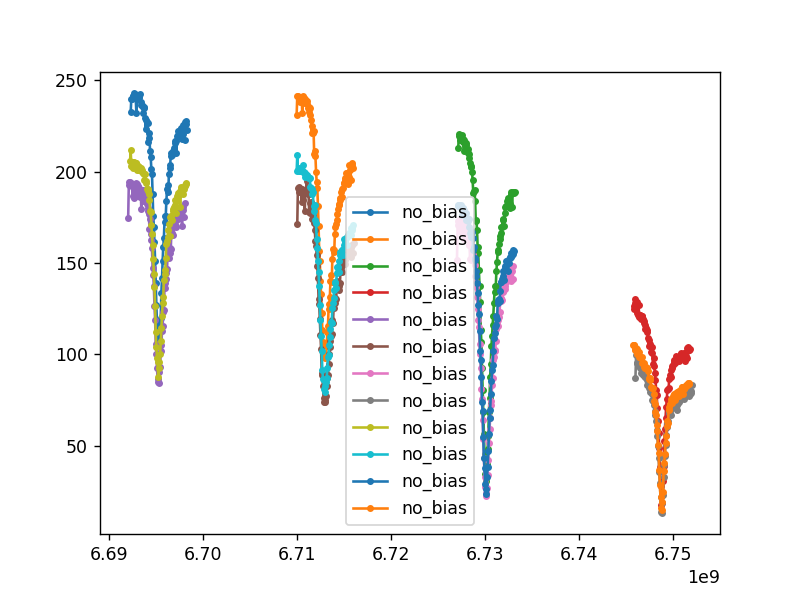

In [59]:
fig = plt.figure(num='specvsbias')

In [179]:
5.189-5.063

0.12600000000000033

In [64]:
data, ID, comment, tags, name, finishtime = read(title='S21',which=0)
print(finishtime)

2021-04-25 10:01:20.223093


In [65]:
plt.figure(num='specvsbias')
plt.plot(data[0],np.abs(data[1]),'-o',markersize=3,label='no_bias',alpha=1)
plt.legend(loc='best')
plt.show()

In [60]:
data, ID, comment, tags, name, finishtime = read(title='spec2d',which=5)
print(finishtime)
data[1][:-1]

2020-11-05 15:00:46.936593


array([array([[4.600e+09],
       [4.601e+09],
       [4.602e+09],
       ...,
       [5.948e+09],
       [5.949e+09],
       [5.950e+09]]),
       array([[4.600e+09],
       [4.601e+09],
       [4.602e+09],
       ...,
       [5.948e+09],
       [5.949e+09],
       [5.950e+09]]),
       array([[4.600e+09],
       [4.601e+09],
       [4.602e+09],
       ...,
       [5.948e+09],
       [5.949e+09],
       [5.950e+09]]),
       array([[4.600e+09],
       [4.601e+09],
       [4.602e+09],
       ...,
       [5.948e+09],
       [5.949e+09],
       [5.950e+09]]),
       array([[4.600e+09],
       [4.601e+09],
       [4.602e+09],
       ...,
       [5.948e+09],
       [5.949e+09],
       [5.950e+09]]),
       array([[4.600e+09],
       [4.601e+09],
       [4.602e+09],
       ...,
       [5.948e+09],
       [5.949e+09],
       [5.950e+09]]),
       array([[4.600e+09],
       [4.601e+09],
       [4.602e+09],
       ...,
       [5.948e+09],
       [5.949e+09],
       [5.950e+09]]),
       array(

In [78]:
tag = ''
for i in tags:
    tag += i
save('singlespec',tag,base_path=r'D:\skzhao\data\ffsu\Nb10bits_2_cuqiang',row=data[0],col=data[1])

WindowsPath('D:/skzhao/data/ffsu/Nb10bits_2_cuqiang/2020/0831/singlespec/Nbq6_20200831094455.npz')

# 读出点

In [118]:
data, ID, comment, tags, name, finishtime = read(title='readOp',which=2)
print(tags, finishtime)

['q8'] 2021-01-22 12:57:50.908361


<IPython.core.display.Javascript object>


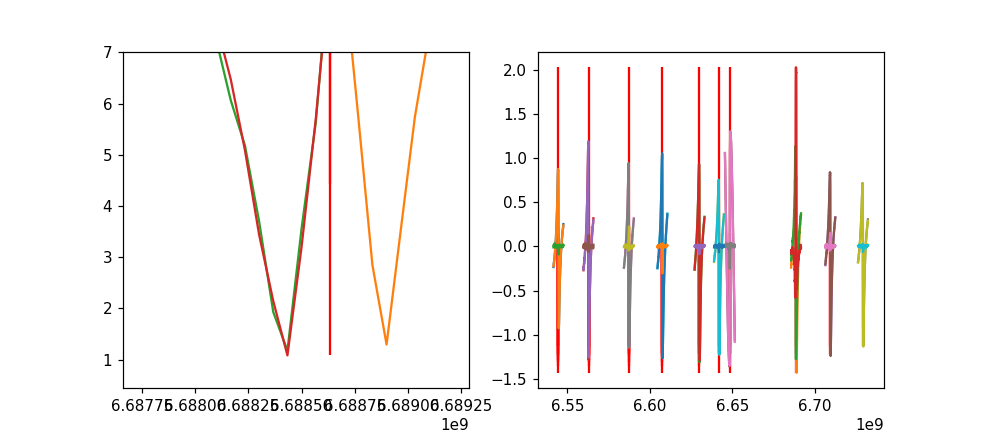

In [119]:
f_lo = []
f_op, s_op = data[1], data[2]
fig, axes = plt.subplots(ncols=2,nrows=1,figsize=(9,4))
for i in range(np.shape(data[1])[2]):
    f, s_off, s_on, s_on2 = f_op[0,:,i], s_op[0,:,i], s_op[1,:,i], s_op[2,:,i]
    f_lo1 = (f[np.argmin(np.abs(s_off))] + f[np.argmin(np.abs(s_on))])/2
    x_off, y_off = op.RowToRipe().deductPhase(f,s_off)
    x_on, y_on = op.RowToRipe().deductPhase(f,s_on)
    anglediff = (np.angle(y_off[0])-np.angle(y_on[0]))
    index = np.abs(anglediff).argmax(axis=0)
    #index = np.abs(s_off).argmin(axis=0)
    f_lo.append(f[index] if np.abs(f[index]-f_lo1)<0.1e6 else f_lo1)
    axes[0].plot(f_op[:,:,i].T,np.abs(s_op[:,:,i].T))
    axes[0].vlines(f_lo,np.max(np.abs(s_op[:,:,i].T)),np.min(np.abs(s_op[:,:,i].T)),'r')
    axes[1].plot(x_off,np.angle(y_off[0]))
    axes[1].plot(x_on,np.angle(y_on[0]))
    axes[1].plot(x_off,anglediff)
    axes[1].vlines(f_lo,np.max(anglediff),np.min(np.angle(y_off[0])),'r')
plt.show()

In [ ]:
6.689, 6.6885 6.6882

In [374]:
(6.6483-6.64805)*1e9/1e6

0.25000000000030553

In [1181]:
f[np.argmin(np.abs(s_off))]

0.0002199999999996649

In [88]:
np.argmin(np.abs(s_op),axis=1)

array([[40],
       [33],
       [29]], dtype=int64)

In [84]:
f_op[]

(3, 81, 1)

In [351]:
delta = 1998
k = 0.9/2
kappa = 228
np.sqrt(k*delta*(1+delta/kappa))

93.69127634501461

In [368]:
tag = ''
for i in tags:
    tag += i
save('readOp',tag,base_path=r'D:\skzhao\data\ffsu\Nb10bits_2_cuqiang',row=data[1],col=data[1])

WindowsPath('D:/skzhao/data/ffsu/Nb10bits_2_cuqiang/2020/0824/readOp/q6_20200824172750.npz')

# OPTweight

In [408]:
data, ID, comment, tags, name, finishtime = read(title='readOpweight',which=0)
np.shape(data)

(1, 2, 1088)

<IPython.core.display.Javascript object>


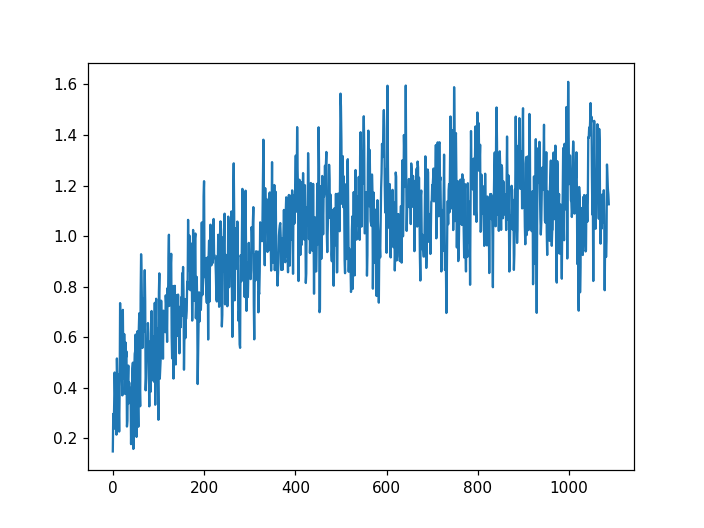

In [369]:
amp_off, amp_on = data[0][0,:], data[0][1,:]
ampdiff = np.abs(amp_on-amp_off)
weight = ampdiff/np.mean(ampdiff)
plt.figure()
# plt.plot(np.abs(amp_off))
# plt.plot(np.abs(amp_on))
# plt.plot(ampdiff)
plt.plot(weight)

In [370]:
weight

array([0.14818184, 0.29686572, 0.23693768, ..., 1.18676457, 1.16506066,
       1.1258274 ])

# AC-Stark

<IPython.core.display.Javascript object>


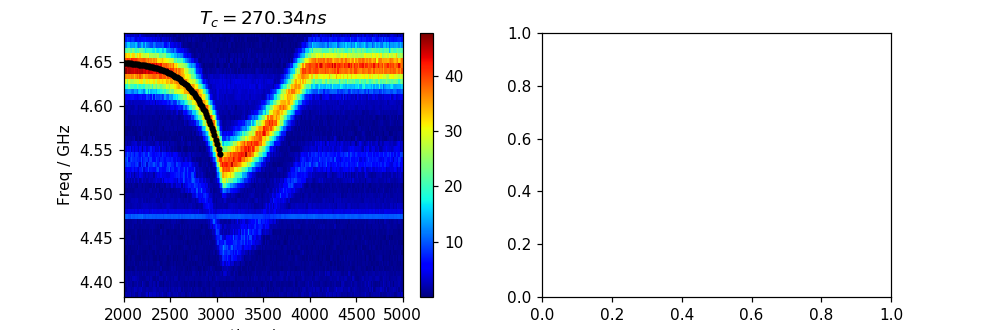

['q1'] 2020-10-09 21:28:18.750503


In [828]:
value,num,tags,finished_time = write(title='acStark',height=3,which=0,peak=1000)
print(tags,finished_time)

<IPython.core.display.Javascript object>


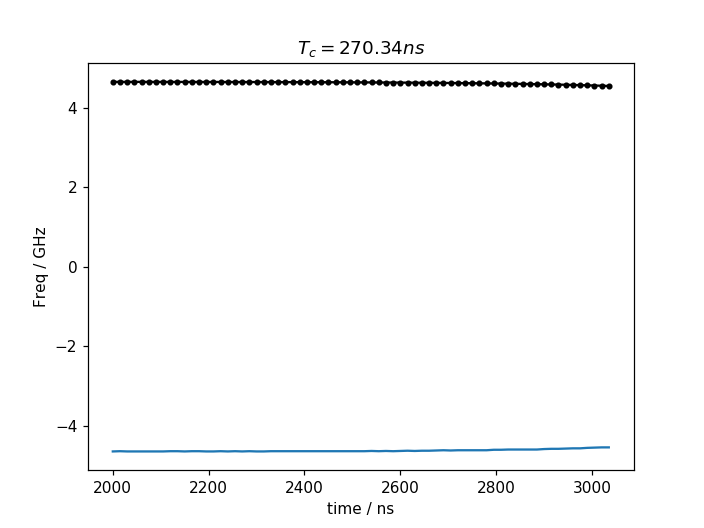

In [829]:
v, f, s = value[0][0], value[0][1], np.abs(value[0][2])
peak = (np.max(s) + np.min(s)) / 2
v, f = op.RowToRipe().profile(v,f,s,peak,axis=0)
plt.figure()
plt.plot(f[:70],-v[:70])

In [831]:
x, y = f[:70],-v[:70]
A, B, T1 = op.Exp_Fit().fitExp(x,y)
z = A * np.exp(-x*T1) + B
fig = plt.gcf()
ax = plt.getp(fig,'axes')
ax[0].plot(x,-z,'k-o',markersize=3)
ax[0].set_title('$T_{c}=%.2fns$'%(abs(1/T1)))
ax[0].set_xlabel('time / ns')
ax[0].set_ylabel('Freq / GHz')
plt.show()

# 腔内光子数

<IPython.core.display.Javascript object>


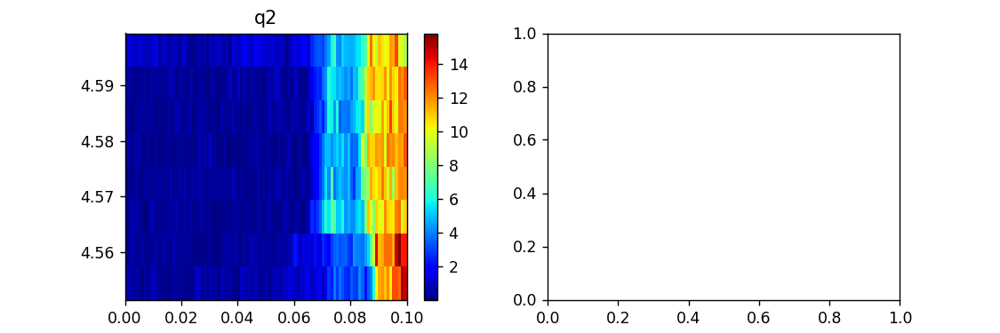

['q2'] 2020-10-27 22:55:26.616300


In [576]:
value,num,tags,finished_time = write(title='photonNum',height=3,which=0,peak=1000)
print(tags,finished_time)

<IPython.core.display.Javascript object>


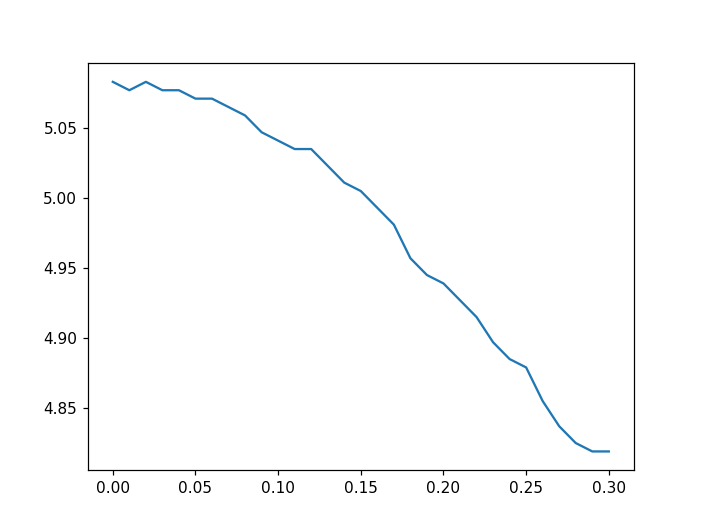

In [833]:
v, f, s = value[0][0], value[0][1][:40], np.abs(value[0][2])[:,:40]
peak = (np.max(s) + np.min(s)) / 2
v, f = op.RowToRipe().profile(v,f,s,peak,axis=0)
plt.figure()
plt.plot(f,v)

In [834]:
x, y = f,v
res, func = op.Exp_Fit().poly(x,y,2)
z = func(x)
fig = plt.gcf()
ax = plt.getp(fig,'axes')
ax[0].plot(x,z,'k-o',markersize=3)
# ax[0].set_title('$T_{c}=%.2fns$'%(abs(1/T1)))
ax[0].set_xlabel('time / ns')
ax[0].set_ylabel('Freq / GHz')
plt.show()

In [837]:
x = sy.Symbol('x',real=True)
k = 0.2 ###MHz
photonnum_func = res[0]*x**2/k/(-2)
photonnum_func

6.21144706239264*x**2

In [836]:
res

array([-2.48457882, -0.227207  ,  5.08864457])

In [779]:
np.float(photonnum_func.evalf(subs={x:0.3}))

0.5590302356153374

In [128]:
import inspect, logging
LOG_FORMAT = "%(asctime)s - %(levelname)s - %(message)s"
logging.basicConfig(filename='D:\skzhao\log\qubit.log', level=logging.DEBUG, format=LOG_FORMAT,filemode='a')
def test():
    print(1)
    logging.info("This is a info log.")
test()
# logging.basicConfig(level=logging.DEBUG)

# logging.debug("This is a debug log.")
# logging.info("This is a info log.")
# logging.warning("This is a warning log.")
# logging.error("This is a error log.")
# logging.critical("This is a critical log.")

1


W1116 23:25:17.484698  9928 <ipython-input-128-f99e1a096955>:6] This is a info log.


In [384]:
import logging
from logging import handlers

class Logger(object):
    level_relations = {
        'debug':logging.DEBUG,
        'info':logging.INFO,
        'warning':logging.WARNING,
        'error':logging.ERROR,
        'crit':logging.CRITICAL
    }     #日志关系映射

    def __init__(self,filename,level='info',backCount=10,fmt='%(asctime)s - %(pathname)s[line:%(lineno)d] - %(levelname)s: %(message)s'):
        self.logger = logging.getLogger(filename)
#         self.logger.propagate = False
        format_str = logging.Formatter(fmt)                  #设置日志格式
        self.logger.setLevel(self.level_relations.get(level))#设置日志级别
        
#         sh = logging.StreamHandler()  #往屏幕上输出
#         sh.setFormatter(format_str)   #设置屏幕上显示的格式
#         self.logger.addHandler(sh)    #把对象加到logger里
        
        fh = handlers.RotatingFileHandler(filename=filename,maxBytes=10485760,backupCount=backCount)   # 按照文件大小分割日志文件
        fh.setLevel(self.level_relations.get(level))
        fh.setFormatter(format_str)   #设置文件里写入的格式
        self.logger.addHandler(fh)
        
if __name__ == '__main__':
    log = Logger(r'D:\skzhao\log\qubit.log',level='debug')
    log.logger.debug('------0. it is a debug ------')
    log.logger.info('------ 1. it is a test ------')
    log.logger.warning('------ 2. it is a warning ------')
    log.logger.error('------ 3. it is an error ------')
    log.logger.critical('------ 4. serious problem ------')

2020-11-17 20:18:43,977 - <ipython-input-384-6c418ba4c7ab>[line:30] - DEBUG: ------0. it is a debug ------
2020-11-17 20:18:43,977 - <ipython-input-384-6c418ba4c7ab>[line:30] - DEBUG: ------0. it is a debug ------
2020-11-17 20:18:43,981 - <ipython-input-384-6c418ba4c7ab>[line:31] - INFO: ------ 1. it is a test ------
2020-11-17 20:18:43,981 - <ipython-input-384-6c418ba4c7ab>[line:31] - INFO: ------ 1. it is a test ------
2020-11-17 20:18:43,983 - <ipython-input-384-6c418ba4c7ab>[line:32] - WARNING: ------ 2. it is a warning ------
2020-11-17 20:18:43,983 - <ipython-input-384-6c418ba4c7ab>[line:32] - WARNING: ------ 2. it is a warning ------
2020-11-17 20:18:43,985 - <ipython-input-384-6c418ba4c7ab>[line:33] - ERROR: ------ 3. it is an error ------
2020-11-17 20:18:43,985 - <ipython-input-384-6c418ba4c7ab>[line:33] - ERROR: ------ 3. it is an error ------
2020-11-17 20:18:43,988 - <ipython-input-384-6c418ba4c7ab>[line:34] - CRITICAL: ------ 4. serious problem ------
2020-11-17 20:18:43

In [157]:
help(signal.butter)

Help on function butter in module scipy.signal.filter_design:

butter(N, Wn, btype='low', analog=False, output='ba', fs=None)
    Butterworth digital and analog filter design.
    
    Design an Nth-order digital or analog Butterworth filter and return
    the filter coefficients.
    
    Parameters
    ----------
    N : int
        The order of the filter.
    Wn : array_like
        The critical frequency or frequencies. For lowpass and highpass
        filters, Wn is a scalar; for bandpass and bandstop filters,
        Wn is a length-2 sequence.
    
        For a Butterworth filter, this is the point at which the gain
        drops to 1/sqrt(2) that of the passband (the "-3 dB point").
    
        For digital filters, `Wn` are in the same units as `fs`.  By default,
        `fs` is 2 half-cycles/sample, so these are normalized from 0 to 1,
        where 1 is the Nyquist frequency. (`Wn` is thus in
        half-cycles / sample.)
    
        For analog filters, `Wn` is an angular

# Zpulse_offset

<IPython.core.display.Javascript object>


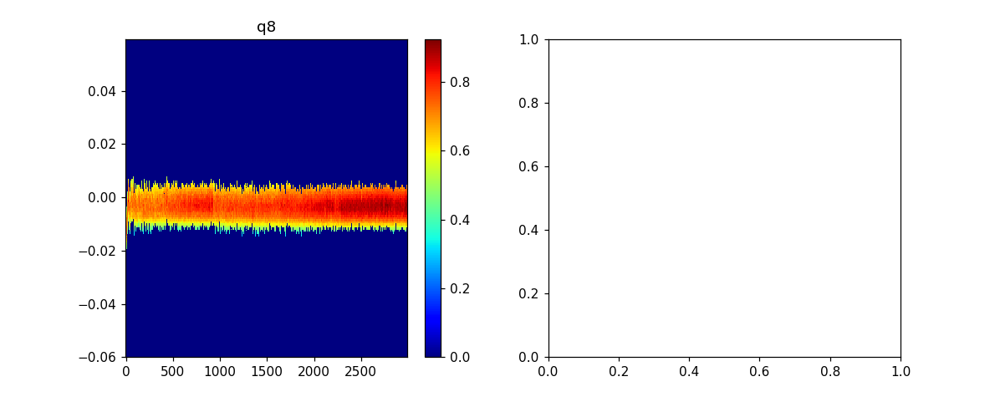

['q8'] 2021-05-11 21:58:09.104970


In [869]:
value,num,tags,finished_time = write(title='zPulse_pop',height=4,which=3,peak=1000,transposition=True)
print(tags,finished_time)

In [526]:
x, y, s = value[0][0][0:-10],value[0][1][:], np.abs(value[0][2])[0:-10,:]
peak = 0.1
# tstart = 4995 - np.max(x)
# v = v[np.abs(s).max(axis=1)>peak]
# s = s[np.abs(s).max(axis=1)>peak]
# f = f[np.abs(s).argmax(axis=1)]
col, row = np.shape(s)
sm = []
for i in range(col):
    smm = op.RowToRipe().smooth(s[i,:],f0=0.15,axis=0)
    sm.append(smm)
# axis0, axis1 = np.where(s>peak)

In [527]:
snew = np.array(sm)
index = snew>peak
res = []
for i in range(col): 
    snewm = y[index[i,:]]
    res.append(np.mean(snewm))
# x = x[np.abs(s).max(axis=0)>peak]
# s = s[np.abs(s).max(axis=0)>peak]
# y = y[np.abs(s).argmax(axis=0)]
# x = x[np.abs(s).max(axis=0)>peak]
# res = x[np.abs(s).argmax(axis=0)]
fig = plt.gcf()
ax = plt.getp(fig,'axes')
ax[0].plot(x,np.array(res),'ko',markersize=2)
ybar = op.RowToRipe().smooth(res,f0=0.1)
ax[0].plot(x,ybar,'b')

In [459]:
ybar=res

<IPython.core.display.Javascript object>


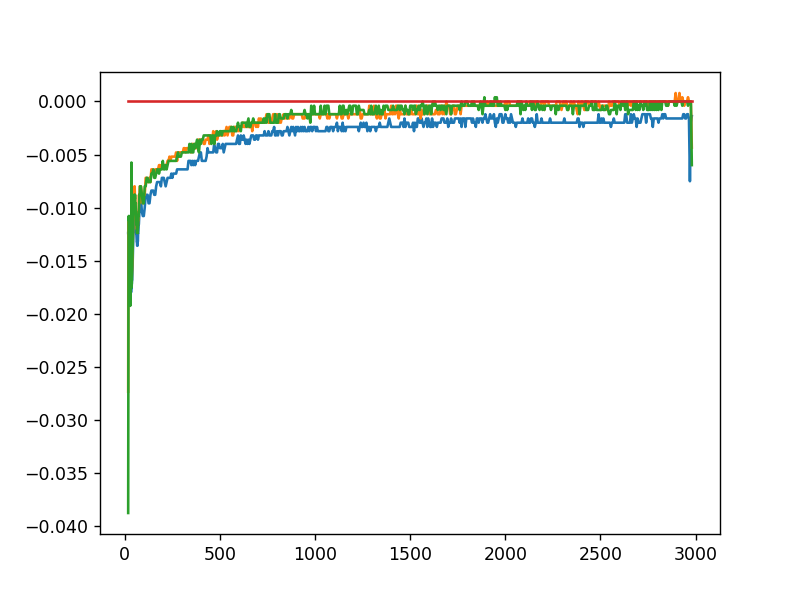

In [2051]:
plt.figure()
plt.plot(x,rrs[0])
plt.plot(x,rrs[1])
plt.plot(x,rrs[2])
plt.plot(x,[0]*len(rrs[0]))
# plt.plot(x,rrs[1])

## 拟合

In [528]:
data = np.array([x[::-1][:],(ybar[::-1][:])]).T
np.shape(data)

(107, 2)

4.0 0.9


<IPython.core.display.Javascript object>


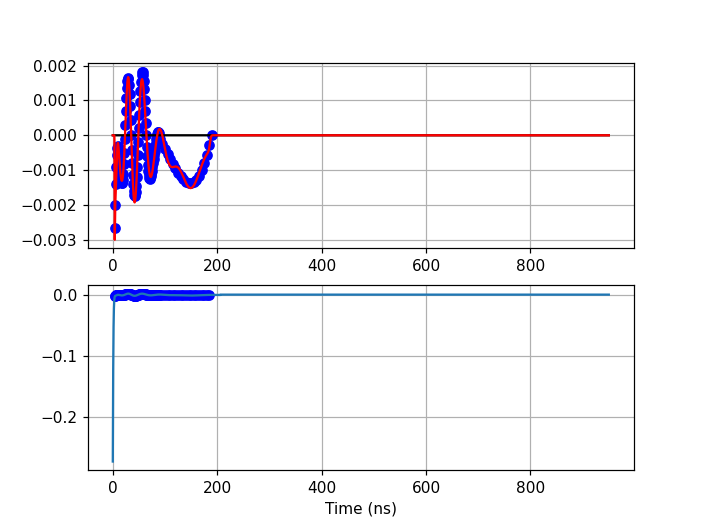

C:\WPy64-3740\python-3.7.4.amd64\lib\site-packages\ipykernel_launcher.py:68: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.


In [529]:
data[:,1] -= data[-1,1]
updatePara = False
polyNum = 18 #10  polyNum阶多项式拟合
expNum = 1 #######################目前固定为1
timeconstants =0 # expNum阶指数拟合
tCut = 186#100 ,200  polyNUm的拟合范围
tCut1 = 0
tshift = 0
# height = eval(tags[1])
height = 0.9

polyRatio = 1
sigma = 0.4
tstart = np.min(data[:,0])
print(tstart,height)
tcuts = [0,10e3]
tcuts1 = None

def fitfunc(t, p):
    return (t >= 0) *(p[0] + np.sum(p[1::2,None]*np.exp(-p[2::2,None]*t[None,:]), axis=0))
def errfunc(p):
    return (fitfunc(data[:,0], p) - data[:,1])*(1.0+0.5*scipy.special.erf(0.4*(data[:,0]-tCut)))**5

p0 = np.zeros(2*timeconstants+1)
p0[1::2] = -np.linspace(0, 0.02, timeconstants)
p0[2::2] = np.linspace(0, 0.5, timeconstants)
# print(p0)
p, _ = scipy.optimize.leastsq(errfunc,p0,maxfev=5000)
ts = np.arange(0,data[-1,0]*5,0.02)
p[0] = 0

plt.plot(data[:,0],data[:,1],'bo')
plt.figure()
plt.subplot(211)
plt.plot(data[:,0],data[:,1],'bo')
plt.plot(ts,fitfunc(ts,p),'k-')

data1 = np.copy(data)
restData = data[:,1]-fitfunc(data[:,0], p)
restData = restData[data1[:,0]<=tCut]
data1 = data1[data1[:,0]<=tCut,:]
def fitfunc1(t, p):
    pExp = p[:expNum*2]
    pPoly = p[expNum*2:]
    if np.iterable(t):
        return np.sum(pExp[0::2,None]*np.exp(-pExp[1::2,None]*t[None,:]), axis=0)*np.polyval(pPoly,t)*(t<=tCut+20)
    else:
        return np.sum(pExp[0::2]*np.exp(-pExp[1::2]*t))*np.polyval(pPoly,t)*(t<=tCut)
def errfunc1(p):
    return (fitfunc1(data1[:,0], p) - restData)*(1.0+0.5*scipy.special.erf(0.4*(data1[:,0]-tCut1)))**0
def smoothFuncATtCut(ts,tCut,tshift):    
    return (0.5-0.5*scipy.special.erf(sigma*(ts-tCut+tshift)))*(0.5+0.5*scipy.special.erf(4.0*(ts-data[0,0]+0.5)))
pExp0 = np.zeros(2*expNum)
pExp0[1::2] = np.linspace(0.001, 0.03, expNum)
pPoly0 = np.zeros(polyNum)
pPoly0[-1] = 1.0
pAll0 = np.hstack([pExp0,pPoly0])
p2, _ = scipy.optimize.leastsq(errfunc1, pAll0)
smoothData = fitfunc1(ts,p2)*smoothFuncATtCut(ts,tCut,tshift)*polyRatio
timeFunData0 = smoothData+fitfunc(ts,p)
paras= {'p':p,'p2':p2,'tCut':tCut,'tshift':tshift,'sigma':sigma}
plt.subplot(212)
plt.plot(data1[:,0],restData,'bo')
# plt.plot(ts,smoothData,'r-')
plt.plot(ts,fitfunc1(ts,p2))
plt.xlabel('Time (ns)')
plt.grid(True)
plt.subplot(211)
plt.plot(ts,timeFunData0,'r-')
plt.grid(True)
p2 = np.asarray(p2)
p = np.asarray(p)
p_uniform = np.copy(p)
p2_uniform = np.copy(p2)
p_uniform[1::2] = p_uniform[1::2]/height
pExp = p2_uniform[:expNum*2]
pPoly = p2_uniform[expNum*2:]
pExp[0::2] = pExp[0::2]/height*polyRatio
p2_uniform[:expNum*2] = pExp


## 保存矫正参数

In [51]:
array = np.array
zParas = {'1st': {'pexp': array([ 0.        , -0.0005909 ,  0.00164297, -0.0057304 ,  0.00164301,
         -0.12710394,  0.05338671, -0.00480261,  0.00420333,  0.12446494,
          0.05675554]),
  'ppoly': array([-6.93314236e+01,  1.26267353e-01, -9.15315266e-28,  2.46332802e-25,
         -1.82682018e-23, -5.89397001e-22,  1.26798974e-19, -1.01752416e-18,
         -6.76912863e-16,  5.49897002e-14, -2.11516989e-12,  3.74244087e-11,
          2.25912362e-10, -2.42963351e-08,  4.36756355e-07, -2.82136834e-06,
          3.62722160e-06, -4.68163496e-05,  2.70992262e-04]),
  'time': [80, 0, 1.0, 0.4]},
 '2th': {'pexp': array([0.]),
  'ppoly': array([ 1.22867514e+03,  1.63333864e-01,  6.00091093e-29, -3.39150603e-26,
          6.34750720e-24, -1.41058994e-23, -1.86628991e-19,  3.53263731e-17,
         -3.47089278e-15,  2.12792050e-13, -8.61797389e-12,  2.35614866e-10,
         -4.37189583e-09,  5.45775738e-08, -4.44602470e-07,  2.20359082e-06,
         -5.86664804e-06,  9.06468606e-06, -1.73598711e-05]),
  'time': [200, 0, 1.0, 0.4]},
 '3nd': {'pexp': array([0.]),
  'ppoly': array([-1.93474703e+01,  7.60443239e-02,  1.44469950e-29, -2.66562630e-27,
          1.61694795e-27,  4.99116307e-24,  2.73129622e-21, -4.27864300e-20,
         -3.46413605e-17,  4.00111372e-16,  3.65353985e-13, -3.04895536e-11,
          9.67556402e-10, -9.39416631e-09, -1.40347034e-07,  3.38628089e-06,
         -1.58625453e-05, -5.47787589e-05,  6.32274788e-04]),
  'time': [90, 0, 0.0, 0.4]},
 '4th': {'pexp': array([0.]),
  'ppoly': array([-1.18074484e+01,  8.61650244e-02,  1.00300076e-28, -2.48850650e-26,
          1.49926859e-24,  1.87168638e-24,  6.08790643e-21,  6.68068911e-21,
         -1.70170651e-16,  7.32301285e-15,  1.26125237e-12, -1.44998797e-10,
          6.33145499e-09, -1.35676274e-07,  1.35489740e-06, -4.03865509e-06,
         -6.51534534e-06, -1.53261476e-04,  1.38697952e-03]),
  'time': [90, 0, 0.0, 0.4]},
 '5th': {'pexp': array([0.]),
  'ppoly': array([-1.30535321e+04,  1.70267381e-01, -1.26090111e-28,  9.50657208e-26,
         -3.13332246e-23,  5.94868090e-21, -7.22677449e-19,  5.91142611e-17,
         -3.34172850e-15,  1.32104063e-13, -3.65825110e-12,  7.04084338e-11,
         -9.23628634e-10,  7.98021801e-09, -4.32170494e-08,  1.37725319e-07,
         -2.39263928e-07,  1.20396029e-07,  1.18473334e-06]),
  'time': [180, 0, 0.0, 0.4]}}

In [313]:
[tCut,tshift,tstart,sigma]

[80, 0, 1.0, 0.4]

In [530]:
{'pexp':p_uniform,'ppoly':p2_uniform,'time':[tCut,tshift,tstart,sigma]}

{'pexp': array([0.]),
 'ppoly': array([-2.67491267e+04,  1.31052234e-01,  1.00604377e-32, -8.32379131e-30,
         2.61256685e-27, -2.95119256e-25, -3.78400892e-23,  1.81832649e-20,
        -3.02867359e-18,  3.01757732e-16, -2.00343564e-14,  9.21454028e-13,
        -2.98036361e-11,  6.79812257e-10, -1.08624515e-08,  1.19407021e-07,
        -8.72386905e-07,  3.99075595e-06, -1.02452382e-05,  1.13541987e-05]),
 'time': [186, 0, 4.0, 0.4]}

In [251]:
# zParas['1st'] = {'pexp':p_uniform,'ppoly':p2_uniform,'time':[tCut,tshift,tstart,sigma]}
# zParas['3nd'] = {'pexp':p_uniform,'ppoly':p2_uniform,'time':[tCut,tshift,tstart,sigma]}
zParas['1th'] = {'pexp':p_uniform,'ppoly':p2_uniform,'time':[tCut,tshift,tstart,sigma]}
# q8.zCali = zParas

# 分割线----------------------------------------------------------分割线

d:\qulab\qulab\zsk\computewave_wave.py:478: RuntimeWarning: overflow encountered in multiply
  (0.5-0.5*scipy.special.erf(sigma1*(tlist-tCut+tShift)))*(0.5+0.5*scipy.special.erf(4.0*(tlist-tstart+0.5)))
d:\qulab\qulab\zsk\computewave_wave.py:478: RuntimeWarning: invalid value encountered in multiply
  (0.5-0.5*scipy.special.erf(sigma1*(tlist-tCut+tShift)))*(0.5+0.5*scipy.special.erf(4.0*(tlist-tstart+0.5)))
d:\qulab\qulab\zsk\computewave_wave.py:481: RuntimeWarning: invalid value encountered in true_divide
  precalc /= (1.0+timeFunDataf*i_two_pi_freqs/sample_rate)


<IPython.core.display.Javascript object>


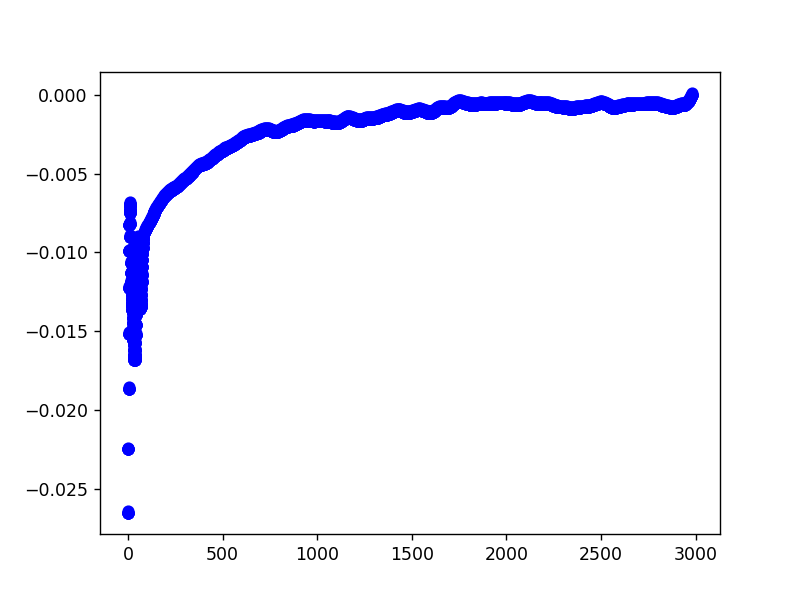

In [2558]:
def polycaliZ(waveform,paras):

    def smoothfilt(f,h):
        f0, sigma = 0.05, 0.02
        return 1+0.5*(1/h-1)*(np.tanh((f-f0)/sigma)+1)

    length = len(waveform)
    # height = np.max(waveform)-np.min(waveform)
    samplingRate = 2
    nrfft = length/2+1
    nfft = 2*(nrfft-1)
    # freqs = np.linspace(0, nrfft*1.0/nfft*samplingRate,nrfft, endpoint=False)
    freqs = np.fft.rfftfreq(int(nfft),1/samplingRate)
    # freqs = np.fft.fftfreq(length,0.4)
    i_two_pi_freqs = 2j*np.pi*freqs
    
    precalc = 1.0
    for i in paras:
        timeFunData = 0.0
        if paras[i] != {}:
            expAmpRates, polyParas, delayParasAND2nd = np.array(paras[i]['pexp']), np.array(paras[i]['ppoly']),\
                 np.array(paras[i]['time'])
        else:
            continue
        pExp0 = expAmpRates
        pExp1 = polyParas[:2]
        pPoly = polyParas[2:]
        tCut,tShift,tstart,sigma1 = delayParasAND2nd
        # tlist = np.arange(2*(nrfft-1),dtype=float)/samplingRate
        tlist = np.arange(length,dtype=float)/samplingRate
        if len(pExp0) > 1:
            timeFunData += np.sum(pExp0[1::2,None]*np.exp(-pExp0[2::2,None]*tlist[None,:]), axis=0)
        timeFunData += pExp1[0]*np.exp(-pExp1[1]*tlist)*np.polyval(pPoly,tlist)*(tlist<=tCut+20)*\
        (0.5-0.5*scipy.special.erf(sigma1*(tlist-tCut+tShift)))*(0.5+0.5*scipy.special.erf(4.0*(tlist-tstart+0.5)))
        timeFunDataf = np.fft.rfft(timeFunData)
#         timeFunDataf *= smoothfilt(freqs,timeFunDataf)
        precalc /= (1.0+timeFunDataf*i_two_pi_freqs/samplingRate)
    f_cali = precalc
    f_step = np.fft.rfft(waveform)
    signal = np.fft.irfft(f_step*f_cali)
    # signal = op.RowToRipe().smooth(np.fft.irfft(f_step*f_cali),0.4)
    return (np.real(signal),)

wave = wn.square(2000e-9,0e-9) << 1000e-9
# pulse_overshot = ((wn.square(0.8e-9) << (0 + 2000e-9 - 0.4e-9))-(wn.square(0.8e-9) << (0.4e-9 + 0)))
# wave += pulse_overshot
t = np.linspace(-15000,5000,50000)*1e-9
wave = wave(t)*0.8
# signal1, = polycaliZ(wave,zParas)
signal1, = cww.caliZ([wave],zParas)
# signal_conv = np.convolve(signal1,timeFunData,"same")
plt.figure()
plt.plot(t*1e9,signal1,'-o',markersize=1)
# plt.plot(t*1e9,op.RowToRipe().smooth(wave,0.4))
# plt.plot(t*1e9,op.RowToRipe().smooth(signal1,0.4),'-o',markersize=1)
# plt.plot(t,pulse_overshot(t))
# plt.plot(xbar*1e-9+500e-9,ybar)
# plt.plot(t,wave)

# Ramsey_zpulse

In [56]:
def test(theta):
    j = 0
    theta_new = []
    theta_new.append(theta[0])
    for i,j in enumerate(theta[1:],start=1):
        while 1:
            if theta_new[i-1]>j+0.8:
                j += np.pi
            else:
                break
        theta_new.append(j)
    return np.array(theta_new)

<IPython.core.display.Javascript object>


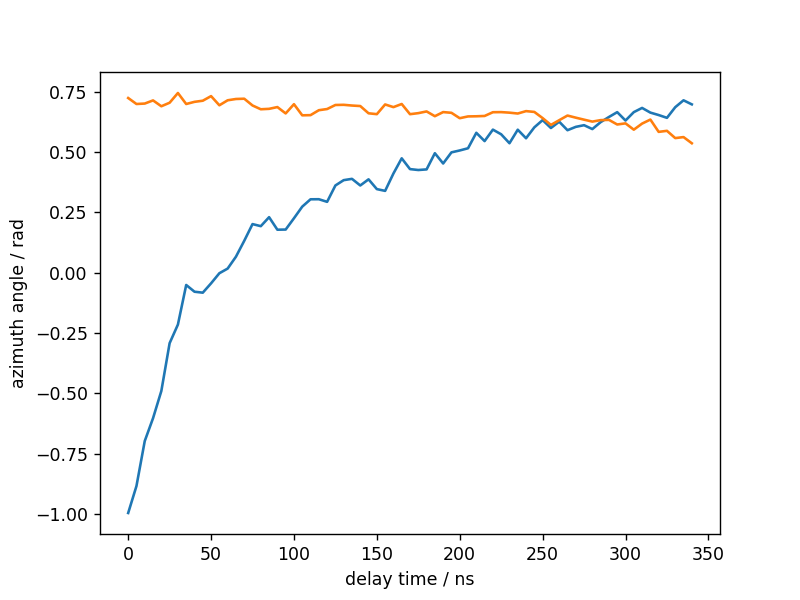

In [23]:
coordinate = [[1-2*j[i] for i in range(2)] for j in poplist_rz]
theta = np.array([np.arctan(i[1]/i[0]) for i in coordinate])
# theta = np.array([theta[i] if i<47 else theta[i]-np.pi for i in range(len(theta))])
# theta = test(theta)
plt.figure()
plt.plot(t_rz,theta)
plt.xlabel('delay time / ns')
plt.ylabel('azimuth angle / rad')
plt.show()

In [25]:
coordinate = [[1-2*j[i] for i in range(2)] for j in poplist_rz]
theta = np.array([np.arctan(i[1]/i[0]) for i in coordinate])
fig = plt.gcf()
ax = plt.getp(fig,'axes')
ax[0].plot(t_rz,theta)
plt.show()

In [1017]:
j = 0
theta_new = []
theta_new.append(theta[0])
for i,j in enumerate(theta[1:],start=1):
    if theta_new[i-1]-j>np.pi/2:
        theta_new.append(j+np.pi/2)
    elif theta_new[i-1]-j<-np.pi/2:
        theta_new.append(j-np.pi/2)
    else:
        theta_new.append(j)

<IPython.core.display.Javascript object>


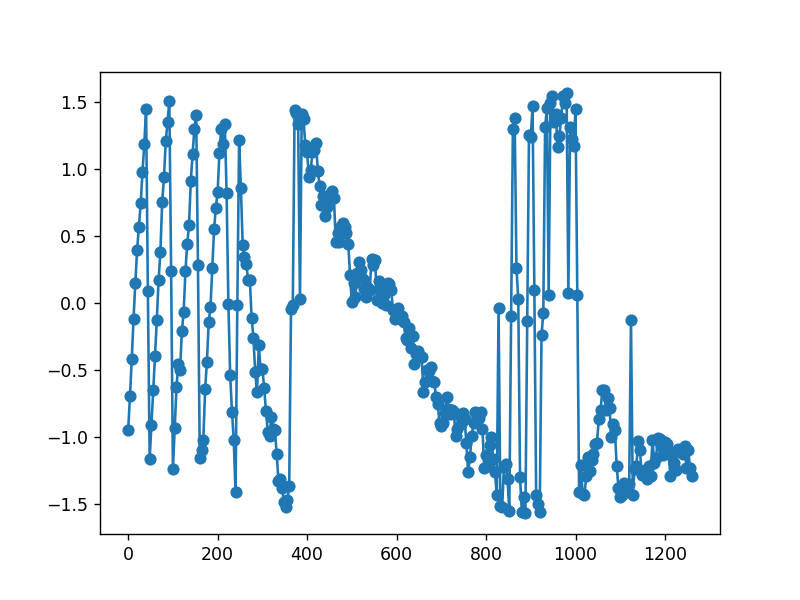

In [1019]:
plt.figure()
plt.plot(t_rz,theta_new,'-o')
plt.show()

In [1016]:
np.shape(theta_new)

(335,)

In [13]:
a, b, c, d, e = op.TwoExp_Fit().fitTwoexp(t_rz,theta)
z = a*np.exp(b*t_rz) + c*np.exp(d*t_rz) + e
fig = plt.gcf()
ax = plt.getp(fig,'axes')
ax[0].plot(t_rz,z)
plt.show()

(-1.2305019961822254, -0.019269795441661734, -0.2461003992364451, -0.003853959088332347, 0.7487539570727105)


d:\qulab\qulab\optimize.py:423: RuntimeWarning: overflow encountered in square
  return np.sum((a*np.exp(b*x) + c*np.exp(d*x) + e - y)**2)
d:\qulab\qulab\optimize.py:423: RuntimeWarning: overflow encountered in exp
  return np.sum((a*np.exp(b*x) + c*np.exp(d*x) + e - y)**2)


In [1782]:
print(1/b,1/d)

-35.332317708042 -330.1660583068357


# RB

['q1', 'False'] 2021-06-25 21:50:48.496464


<IPython.core.display.Javascript object>


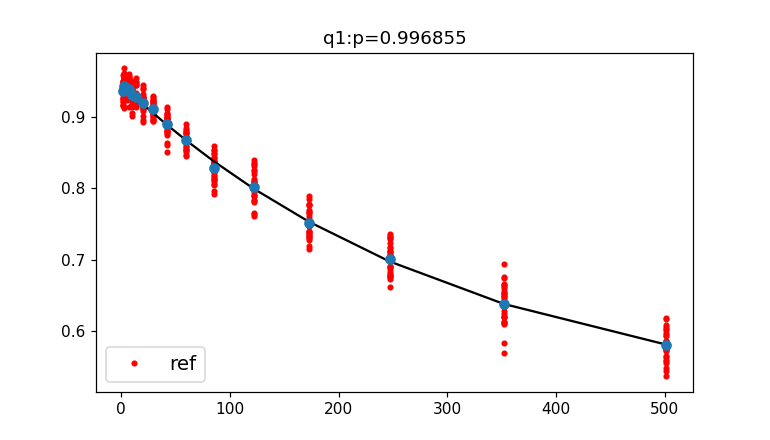

In [115]:
data, ID, comment, tags, name, finishtime = read(title='RB_waveform',which=0)
print(tags,finishtime)

if [tags[1]][0] =='False':
    label = 'ref'
else:
    label = im.op[tags[1]][0]
fontsize = 13
n, pop = data[0][:,0:1],data[1][:,:,0:1]
x = np.meshgrid(range(np.shape(pop)[1]),n)[1]
plt.figure(figsize=(7,4))
plt.plot(x.flatten(),pop.flatten(),'r.',label=label)
plt.legend(loc='lower left',fontsize=fontsize)
x, y = n, np.mean(pop,axis=1)
A,B,p = op.RB_Fit().fitRB(x[:,0],y[:,0])
z = A*p**x+B
plt.plot(x,z,'k')
plt.plot(x,y,'o')
plt.title(tags[0]+':p=%f'%p)
plt.show()
# plt.figure()
# x, y = m_RB[:,:,0].T, pop_RBw[:,:,0].T
# # plt.plot(x.flatten(),y.flatten(),'ro')
# plt.plot(np.mean(x,axis=1), np.mean(y,axis=1),'bo')
# xmean, ymean = np.mean(x,axis=1), np.mean(y,axis=1)
# A,B,p = op.RB_Fit().fitRB(xmean,ymean)
# z = A*p**xmean+B
# plt.plot(xmean,z,'k')
# # plt.plot(xmean,ymean,'o')
# plt.title('p=%f'%p)

In [1576]:
len(x)

16

['q8', '7'] 2021-04-16 00:10:11.398264


<IPython.core.display.Javascript object>


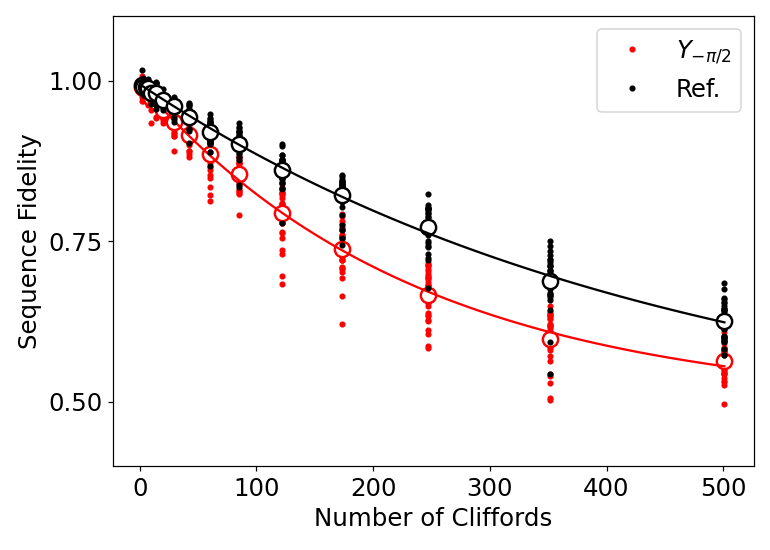

['q8', 'False'] 2021-04-15 23:03:51.940574


In [1599]:
data, ID, comment, tags, name, finishtime = read(title='RB_waveform',which=32)
print(tags,finishtime)

if [tags[1]][0] =='False':
    label = 'ref'
else:
    label = im.op[tags[1]][0]
fontsize = 13
n, pop = data[0][:,0:1],data[1][:,:,0:1]
x = np.meshgrid(range(np.shape(pop)[1]),n)[1]
plt.figure(figsize=(7,5))
plt.plot(x.flatten(),pop.flatten(),'r.',label=r"$Y_{-\pi/2}$")
plt.legend(loc='lower left',fontsize=fontsize)
x, y = n, np.mean(pop,axis=1)
A,B,p = op.RB_Fit().fitRB(x[:,0],y[:,0])
z = A*p**x+B
# plt.plot(x,z,'k')
plt.plot(x,y,'o',markersize=10,markeredgecolor='r',markerfacecolor='w',markeredgewidth=1.6)
z1 = A*p**x1+B
plt.plot(x1,z1,'r')
# plt.title(tags[0]+':p=%f'%p)
plt.show()

data, ID, comment, tags, name, finishtime = read(title='RB_waveform',which=38)
print(tags,finishtime)

if [tags[1]][0] =='False':
    label = 'Ref.'
else:
    label = im.op[tags[1]][0]
fontsize = 13
n, pop = data[0][:,0:1],data[1][:,:,0:1]
x = np.meshgrid(range(np.shape(pop)[1]),n)[1]
# plt.figure(figsize=(7,4))
plt.plot(x.flatten(),pop.flatten(),'k.',label=label)
plt.legend(loc='upper right',fontsize=fontsize)
x, y = n, np.mean(pop,axis=1)
A,B,p = op.RB_Fit().fitRB(x[:,0],y[:,0])
z = A*p**x+B
# plt.plot(x,z,'b')
plt.plot(x,y,'o',markersize=10,markeredgecolor='k',markerfacecolor='w',markeredgewidth=1.6)
x1 = np.linspace(x.min(),x.max(),101)
z1 = A*p**x1+B
plt.plot(x1,z1,'k')
# plt.title(tags[0]+':p=%f'%p)
plt.show()

fontsize=16
plt.xlabel('Number of Cliffords',fontsize=fontsize)
plt.ylabel('Sequence Fidelity',fontsize=fontsize)
plt.xticks([0,100,200,300,400,500],fontsize=fontsize)
plt.yticks([0.5,0.75,1.0],fontsize=fontsize)
plt.tight_layout()
# plt.figure()
# x, y = m_RB[:,:,0].T, pop_RBw[:,:,0].T
# # plt.plot(x.flatten(),y.flatten(),'ro')
# plt.plot(np.mean(x,axis=1), np.mean(y,axis=1),'bo')
# xmean, ymean = np.mean(x,axis=1), np.mean(y,axis=1)
# A,B,p = op.RB_Fit().fitRB(xmean,ymean)
# z = A*p**xmean+B
# plt.plot(xmean,z,'k')
# # plt.plot(xmean,ymean,'o')
# plt.title('p=%f'%p)

plt.legend(loc='upper right',fontsize=fontsize)

In [1600]:
# plt.xlim((-5, 5))
plt.ylim((0.4, 1.1))

(0.4, 1.1)

In [1535]:
plt.savefig(r'D:\skzhao\fig\rb2.pdf',dpi=1200)

In [1426]:
help(plt.plot)

Help on function plot in module matplotlib.pyplot:

plot(*args, scalex=True, scaley=True, data=None, **kwargs)
    Plot y versus x as lines and/or markers.
    
    Call signatures::
    
        plot([x], y, [fmt], *, data=None, **kwargs)
        plot([x], y, [fmt], [x2], y2, [fmt2], ..., **kwargs)
    
    The coordinates of the points or line nodes are given by *x*, *y*.
    
    The optional parameter *fmt* is a convenient way for defining basic
    formatting like color, marker and linestyle. It's a shortcut string
    notation described in the *Notes* section below.
    
    >>> plot(x, y)        # plot x and y using default line style and color
    >>> plot(x, y, 'bo')  # plot x and y using blue circle markers
    >>> plot(y)           # plot y using x as index array 0..N-1
    >>> plot(y, 'r+')     # ditto, but with red plusses
    
    You can use `.Line2D` properties as keyword arguments for more
    control on the appearance. Line properties and *fmt* can be mixed.
    The f

In [266]:
{'x':0.995704,
 'xh':0.994420,
 'xnh':0.995767,
 'y':0.995322,
 'yh':0.995730,
 'ynh':0.995790,
}


{'x': 0.995704,
 'xh': 0.99442,
 'xnh': 0.995767,
 'y': 0.995322,
 'yh': 0.99573,
 'ynh': 0.99579}

In [386]:
Pref

0.9978357185790758

In [275]:
Pgates = np.array([0.995704,0.994420,0.995767,0.995322,0.995730,0.995790])
1-(1-Pgates/Pref)*(1-1/d)

array([0.99893183, 0.99828844, 0.9989634 , 0.99874041, 0.99894486,
       0.99897492])

In [251]:
Pgate = p
d=2
Rgate = (1-Pgate/Pref)*(1-1/d)
1-Rgate

0.9999929617607722

In [273]:
plt.xlabel('$number$',fontsize=fontsize)
plt.ylabel('$population$',fontsize=fontsize)
plt.xticks([0,100,200,300,400,500],fontsize=fontsize)
plt.yticks([0.5,0.75,1],fontsize=fontsize)
plt.tight_layout()

In [421]:
plt.savefig(r'D:\skzhao\fig\rb.pdf',dpi=1200)

'Y'

In [531]:
im.op[tags[1]][0] 

KeyError: 'False'

In [551]:
Pref

0.9942963020454618

In [554]:
Pgate = p
Rgate = (1-Pgate/Pref)*(1-1/d)
1-Rgate

0.9997547113628034

In [482]:
Pref, Pgate, d = 0.997836, p, 2**(1)
Rgate = (1-Pgate/Pref)*(1-1/d)
1-Rgate

0.9999998589843802

# pi脉冲优化

<IPython.core.display.Javascript object>


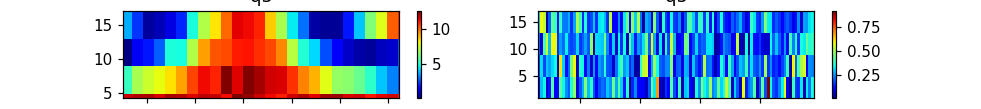

['q5'] 2021-04-12 11:55:23.965081


In [26]:
value,num,tags,finishtime = write(title='pipulseOpt',height=1,which=1,peak=1120)
print(tags,finishtime)

In [119]:
num = eval(tags[0][1:])-1
x, y, s = value[num][0],value[num][1], np.abs(value[num][2])
index = y[np.argmax(op.RowToRipe().smooth(s[0],f0=0.2))]
y = np.array([op.RowToRipe().firstMax(y,op.RowToRipe().smooth(z,f0=0.2),num=index,peakpercent=0.7,insitu=True) for z in s])
fig = plt.gcf()
ax = plt.getp(fig,'axes')
ax[num].set_xlabel('time / ns')
ax[num].set_yticks(x)
ax[num].set_ylabel('number of pi pulse')
ax[num].scatter(y[1:-1],x[1:-1],marker='.',c='',edgecolors='m')
ax[num].vlines(np.mean(y),np.max(x),np.min(x))
ax[num].set_title('pi=%.3fns'%np.mean(y))
plt.show()
np.mean(y)

0.20204000000000003

In [97]:
index

0.20834999999999987

<IPython.core.display.Javascript object>


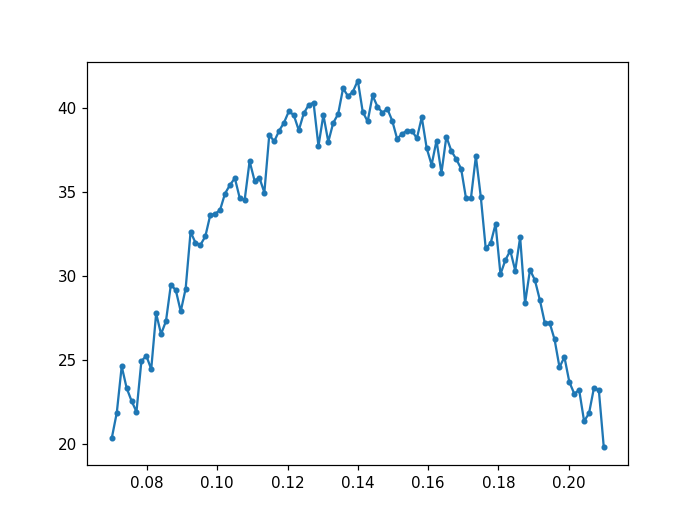

In [322]:
x,y = value[9][1],np.abs(value[9][2][0])
# a,b,c,d,e,f = op.Lorentz_Fit().fitLorentz(x,y)
# z = a/(1.0+c*(x-b)**2)+d
# fig = plt.gcf()
# ax = plt.getp(fig,'axes')
plt.figure()
plt.plot(x,y,'-o',markersize=3)
# plt.plot(x,y,'.')
plt.show()

# IQ-Mixer线性度

<IPython.core.display.Javascript object>


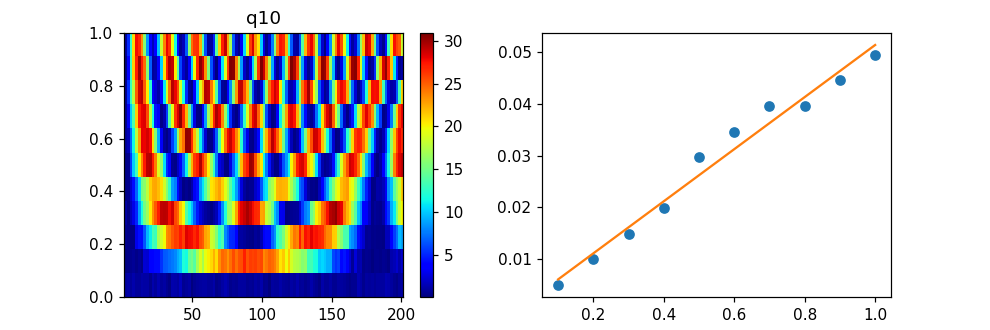

['q10'] 2020-10-14 13:42:31.095382


In [71]:
value,num,tags,finishtime = write(title='lineIQMixer',height=3,which=0,peak=1120)
print(tags,finishtime)

In [72]:
x, y, s = value[0][0][1:],value[0][1][:], np.abs(value[0][2])[1:,:]
w, f, P = op.RowToRipe().spectrum(y,s,axis=1,shift=False)
z, func = op.RowToRipe().poly(x,w,1)
plt.plot(x,np.array(w),'o')
plt.plot(x,func(x))

# AllXY drag

['q8'] 2021-05-25 19:54:16.788815


<IPython.core.display.Javascript object>


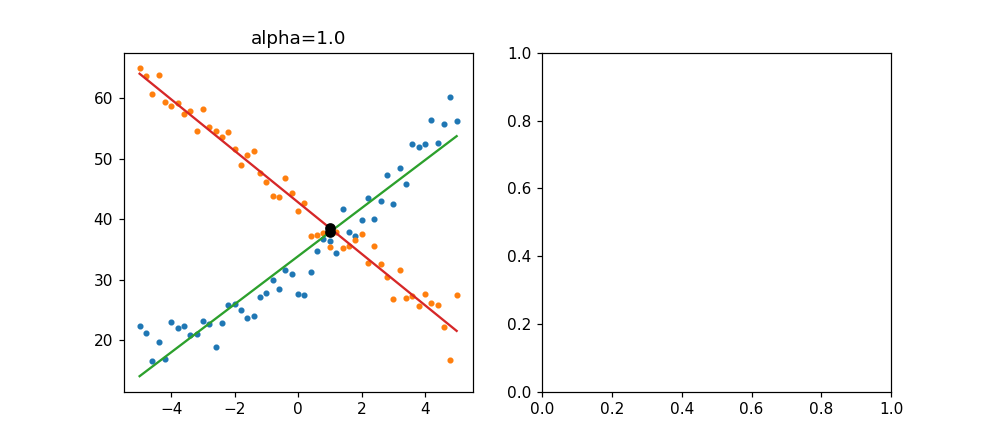

In [2]:
data, ID, comment, tags, name, finishtime = read(title='AllXYdragdetune',which=0)
print(tags,finishtime)
num = 0
fall, sall = data[0],data[1]
fig, axes = plt.subplots(ncols=2,nrows=1,figsize=(9,4))
l = np.shape(fall)[0]//2
f1, f2, s1, s2 = fall[:l,0], fall[l:,0], np.abs(sall[:l,num]), np.abs(sall[l:,num])
z1 = np.poly1d(np.polyfit(f1,s1,1))(f1)
z2 = np.poly1d(np.polyfit(f2,s2,1))(f2)
index = np.argmin(np.abs(z1-z2))
axes[0].plot(np.array([f1,f2]).T,np.array([s1,s2]).T,'.')
axes[0].plot(np.array([f1,f2]).T,np.array([z1,z2]).T)
# axes[0].plot(fall[l:,:],np.abs(sall[l:,:]))
axes[0].plot([f1[index],f2[index]],[z1[index],z2[index]],'ko')
axes[0].set_title(f'alpha={round(f1[index],3)}')
plt.show()

In [180]:
np.shape(data[1])

(82, 10)

# HD

In [396]:
data, ID, comment, tags, name, finishtime = read(title='dragcoefHD',which=5)
print(tags,finishtime)

['q3'] 2020-06-25 15:55:51.476244


<IPython.core.display.Javascript object>


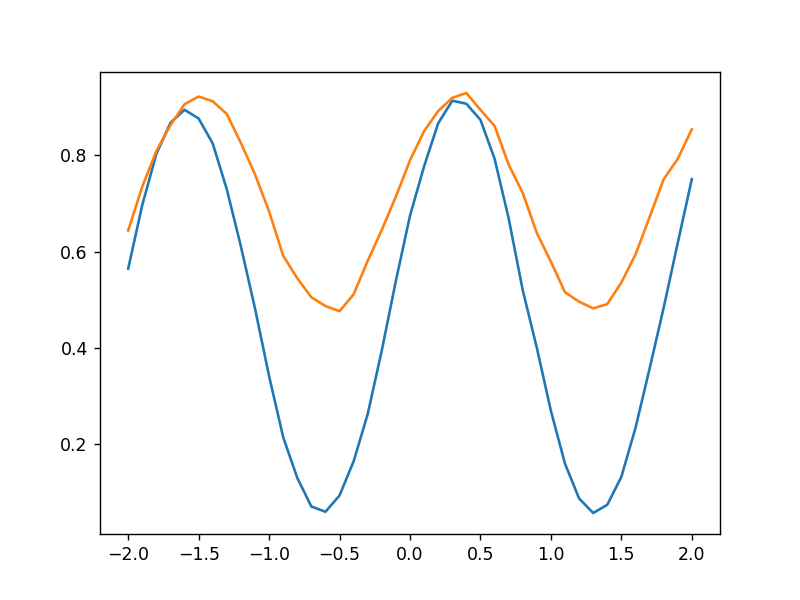

In [395]:
x, y = data[0][:,0], data[1][:,0]
plt.figure()
plt.plot(x,y)
plt.show()

In [397]:
x, y = data[0][:,0], data[1][:,0]
fig = plt.gcf()
ax = plt.getp(fig,'axes')
ax[0].plot(x,y)
plt.show()

# 临界线

['q1'] 2021-06-29 11:45:08.257333


<IPython.core.display.Javascript object>


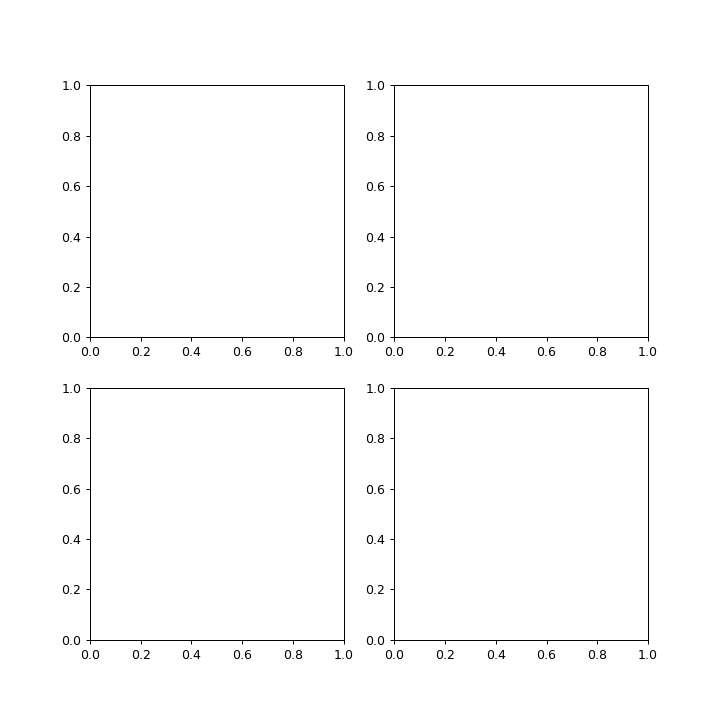

IndexError: index 2 is out of bounds for axis 0 with size 2

In [3]:
data, ID, comment, tags, name, finishtime = read(title='threshHold',which=0)
print(tags,finishtime)
s_st = data[1]
n = np.shape(s_st)[2]
num = n

fig, axes = plt.subplots(ncols=2,nrows=num,figsize=(8,4*num))
for i in range(n):
    s_off, s_on, s_on2 = s_st[0,:,i], s_st[1,:,i], s_st[2,:,i]
    res = await mrw.visibility(1,s_off,s_on)
    ax0 = axes[i][0] if num>1 else axes[i]
    ax0.plot(np.real(s_off),np.imag(s_off),'.')
    ax0.plot(np.real(s_on),np.imag(s_on),'.',alpha=0.6)
    if np.shape(s_st)[0] == 3:
        ax0.plot(np.real(s_on2),np.imag(s_on2),'.',alpha=0.6)
    ax0.plot(*(res[0][3]),'k--')
    ax0.plot(*(res[0][4]),'k--')
    ax0.axis('equal')
    ax1 = axes[i][1] if num>1 else axes[i+1]
    for j in res[0][:3]:
        ax1.plot(j)
    maxdata = np.max(res[0][2])
    ax1.hlines(maxdata,0,60,'r','--',label=f'visibility={round(maxdata*100,1)}%')
    ax1.legend(loc='lower left')
#     ax.vlines([0],10,-100)
#     ax.hlines([0],-10,100)

plt.show()

In [447]:
for i in range(n):
    s_off, s_on= s_st[0,:,i], s_st[1,:,i]
    res = await mrw.visibility(1,s_off,s_on)
    ax0 = axes[i][0] if num>1 else axes[i]
    ax0.plot(np.real(s_off),np.imag(s_off),'.')
    ax0.plot(np.real(s_on),np.imag(s_on),'.',alpha=0.6)
    if np.shape(s_st)[0] == 3:
        ax0.plot(np.real(s_on2),np.imag(s_on2),'.',alpha=0.6)
    ax0.plot(*(res[0][3]),'k--')
    ax0.plot(*(res[0][4]),'k--')
    ax0.axis('equal')
    ax1 = axes[i][1] if num>1 else axes[i+1]
    for j in res[0][:3]:
        ax1.plot(j)
    maxdata = np.max(res[0][2])
    ax1.hlines(maxdata,0,60,'r','--',label=f'visibility={round(maxdata*100,1)}%')
    ax1.legend(loc='lower left')
#     ax.vlines([0],10,-100)
#     ax.hlines([0],-10,100)

plt.show()

In [449]:
np.savez('IQRaw.npz',data=data[1])

array([-30.33282-10.15842j, -77.9969 +15.89038j, -44.37749-62.02881j, ...,
       -35.68887-19.88488j, -17.43813-86.51328j,  14.20625-44.44585j])

In [771]:
np.savez('IQRaw.npz',data=data[1])

-3.0591906181359434 58.075454832561064


<IPython.core.display.Javascript object>


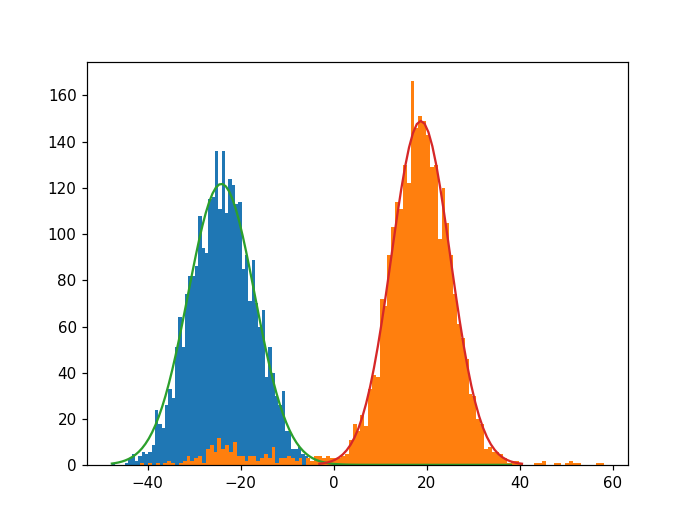

In [261]:
async def post_selection(s_st):
    s_off, s_on = s_st[0,:,0], s_st[1,:,0]
    S = list(s_off) + list(s_on)
    x,z = np.real(S), np.imag(S)
    d = list(zip(x,z))
    kmeans = KMeans(n_clusters=2,max_iter=1000,tol=0.0001)
    kmeans.fit(d)
    c0, c1 = kmeans.cluster_centers_[0,:], kmeans.cluster_centers_[1,:]
    center0 = np.array([np.real(np.mean(s_off)),np.imag(np.mean(s_off))]) 
    center1 = np.array([np.real(np.mean(s_on)),np.imag(np.mean(s_on))])
    center0, center1 = (c0,c1) if np.sum((center0-c0)**2)<np.sum((center0-c1)**2) else (c1,c0)
    sdiff = np.complex(*(center1-center0))
    s0 = s_off / (sdiff/np.abs(sdiff))
    s1 = s_on / (sdiff/np.abs(sdiff))
    s0 = np.real(s0)
    s1 = np.real(s1)
    bins = 120
    mu = np.complex(*center1)/ (sdiff/np.abs(sdiff))
    x0 = np.linspace(min(s0),max(s0),bins)
    x1_old = np.linspace(min(s1),max(s1),bins)
    lower, high = np.real(mu)-2*np.std(s1), np.real(mu)+2*np.std(s1)
    x1 = x1_old[x1_old>lower]
#     x1 = np.linspace(np.real(mu)-np.std(s1),np.real(mu)+np.std(s1),bins)
#     s1 = s1[x1.min()<s1]
#     s1 = s1[s1<x1.max()]
#     x1 = np.linspace(min(s1),max(s1),bins)
    print(x1.min(),x1.max())
    plt.figure()
    bin0 = plt.hist(s0,bins=bins)
    bin1 = plt.hist(s1,bins=bins)
    para0, func0 = op.Gaussian_Fit().fitGaussian(x0,bin0[0])
    plt.plot(x0,func0(x0,para0.x))
    b1 = bin1[0][x1_old>lower]
    b1 = b1[x1<high]
    x1 = x1[x1<high]
    para1, func1 = op.Gaussian_Fit().fitGaussian(x1,b1)
    plt.plot(x1,func1(x1,para1.x))
    return (center0,para0.x[2]), (center1,para1.x[2])
#     S = list(s_off) 
#     x,z = np.real(S), np.imag(S)
#     d = list(zip(x,z))
#     print(kmeans.predict(d))
para0, para1 = await post_selection(s_st)

In [259]:
s_st = np.load(r'D:\skzhao\Data\yhs\q10_20210310193423.npz')['row']
para0, para1 = await post_selection(s_st)

NameError: name 'post_selection' is not defined

<IPython.core.display.Javascript object>


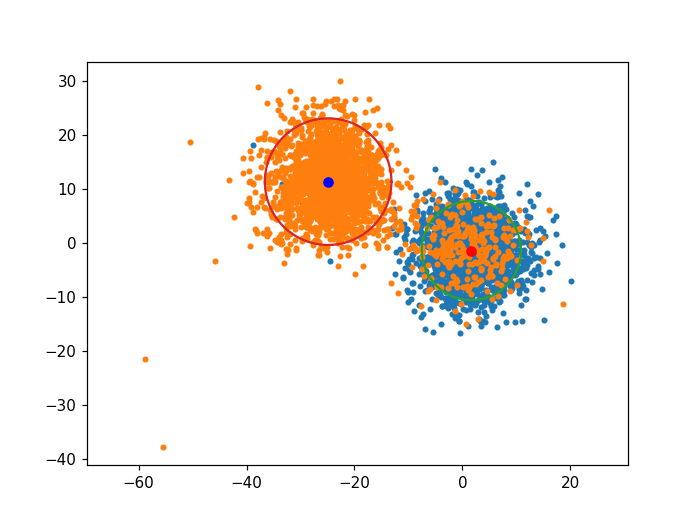

(-62.806858375269464,
 24.06387175855795,
 -41.20433279110061,
 33.541759038440624)

In [195]:
s_off, s_on = s_st[0,:,9], s_st[1,:,9]
c0, offstd = para0
c1, onstd = para1
theta = np.arange(0, 2*np.pi, 0.01)
roff = c0[0] + 2*offstd * np.cos(theta)
ioff = c0[1] + 2*offstd * np.sin(theta)
ron = c1[0] + 2*onstd * np.cos(theta)
ion = c1[1] + 2*onstd * np.sin(theta)
plt.figure()
plt.plot(np.real(s_off),np.imag(s_off),'.')
plt.plot(np.real(s_on),np.imag(s_on),'.')
plt.plot(*c1,'bo')
plt.plot(*c0,'ro')
plt.plot(roff,ioff)
plt.plot(ron,ion)
plt.axis('equal')

<IPython.core.display.Javascript object>


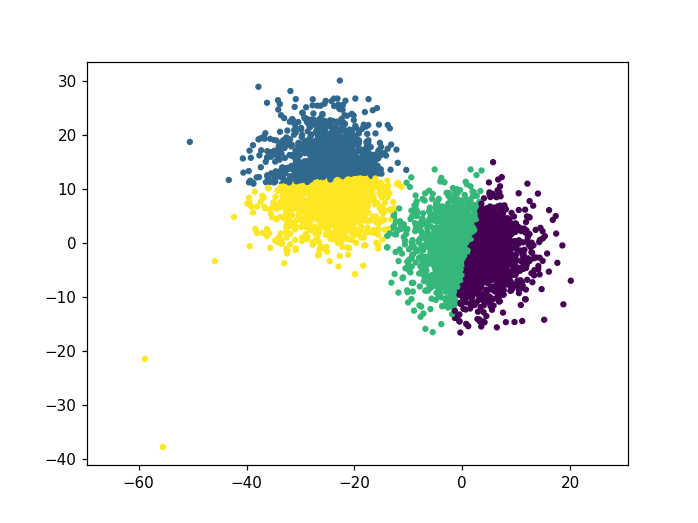

(-62.81036493315876,
 24.067378316447254,
 -41.20903856142825,
 33.546464808768256)

In [174]:
s_off, s_on = s_st[0,:,9], s_st[1,:,9]
s_off1 = s_st[2,:,9]
S = list(s_off) + list(s_on)
x,z = np.real(S), np.imag(S)
d = list(zip(x,z))
kmeans = KMeans(n_clusters=4,max_iter=1000,tol=0.0001)
kmeans.fit(d)
y = kmeans.predict(d)
plt.figure()
plt.scatter(x,z,c=y,s=10)
plt.axis('equal')

[ 3.55848754 29.85487548]


<IPython.core.display.Javascript object>


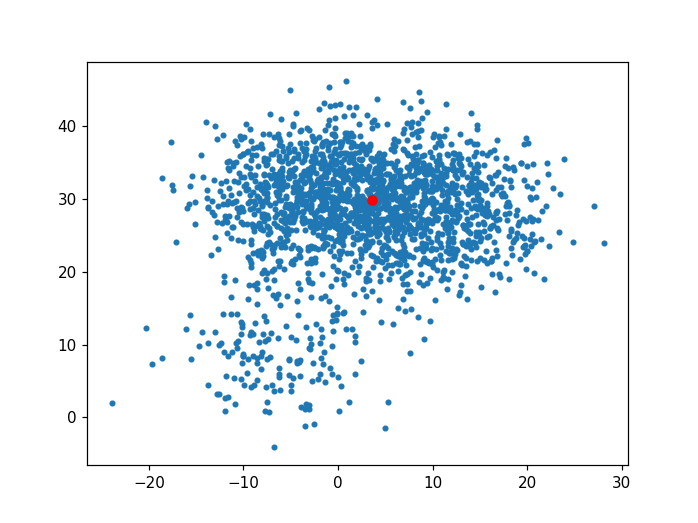

In [142]:
s_off, s_on = s_st[0,:,0], s_st[1,:,0]
S = list(s_off) + list(s_on)
x,z = np.real(S), np.imag(S)
d = list(zip(x,z))
kmeans = KMeans(n_clusters=2,max_iter=1000,tol=0.0001)
kmeans.fit(d)
c0, c1 = kmeans.cluster_centers_[0,:], kmeans.cluster_centers_[1,:]
print(c1)
plt.figure()
plt.plot(np.real(s_on),np.imag(s_on),'.')
plt.plot(*c1,'ro')

In [104]:
np.shape(s_st)

(3, 2048, 10)

In [407]:
tag = ''
for i in tags:
    tag += i
save('threshHold',tag,base_path=r'D:\skzhao\data\ffsu\Nb10bits_2_cuqiang',row=data[1])

WindowsPath('D:/skzhao/data/ffsu/Nb10bits_2_cuqiang/2020/0824/threshHold/q6_20200824200935.npz')

# Crosstalk矩阵

In [630]:
z_crosstalk = np.ones((10,10))

In [1093]:
value,num,tags,finishtime = write(height=3,title='crosstalkSpec',which=0,peak=1000)
print(tags,finishtime)
# target = 1
# q_target, q_bias = tags[0].split('_')
# v, f, s = value[target-1][0][:-1], value[target-1][1][:], np.abs(value[target-1][2])[:-1,:]
# peak = (np.max(np.abs(s))+np.min(np.abs(s))) / 2
# v, f, res = op.Crosstalk_Fit(peak=peak).fitCrosstalk(v,f,s,classify=False)
# z = res[0]*f + res[1]
# row, col = eval(q_target[1:])-1, eval(q_bias[1:])-1
# z_crosstalk[row,col] = -1/res[0]
# fig = plt.gcf()
# ax = plt.getp(fig,'axes')
# ax[target-1].scatter(f[:],v[:],marker='o',c='w',edgecolors='m')
# ax[target-1].plot(f[:],z[:],'k--')
# plt.show()

IndexError: no such item for Cursor instance

In [515]:
target = 1
q_target, q_bias = tags[0].split('_')
v, f, s = value[target-1][0][:], value[target-1][1][:], np.abs(value[target-1][2])[:,:]
peak = (np.max(np.abs(s))+np.min(np.abs(s))) / 2
v, f, res = op.Crosstalk_Fit(peak=peak).fitCrosstalk(v,f,s,classify=False)
z = res[0]*f + res[1]
row, col = eval(q_target[1:])-1, eval(q_bias[1:])-1
z_crosstalk[row,col] = -1/res[0]
fig = plt.gcf()
ax = plt.getp(fig,'axes')
ax[target-1].scatter(f[:],v[:],marker='o',c='w',edgecolors='m')
ax[target-1].plot(f[:],z[:],'k--')
plt.show()

In [323]:
0.9*np.exp(-2/34)

0.8485858294693875

## 异常值拟合

In [26]:
np.shape(value[0][2])

(30, 21)

<IPython.core.display.Javascript object>


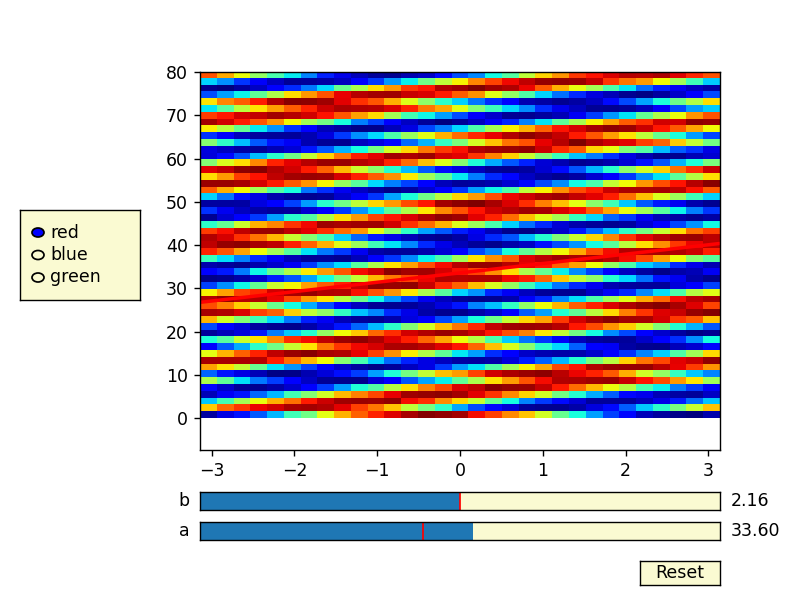

In [182]:
# data, ID, comment, tags, name, finishtime = read(title='crosstalkSpec',which=2)
# print(finishtime)
# x, y, z = data[0][:,0], data[1][0,:,0], data[2][0,:,0]
num = 1
plt.figure()
plt.subplots_adjust(left=0.25, bottom=0.25)
x,y,z = value[num][0], value[num][1], np.abs(value[num][2])
extent = [min(y),max(y),min(x),max(x)]
plt.imshow(z,extent=extent,aspect='auto',origin='lower',cmap='jet')
fig = plt.gcf()
ax = plt.getp(fig,'axes')
sa, sb = di.slidePlot(fig,ax[0],y)


In [186]:
-1/sb.val/2/np.pi

-0.07356364367547356

In [49]:
w

0.00998401263894946

In [840]:
z_crosstalk[row,col] = -1/sb.val

In [834]:
z_crosstalk = np.array([[ 1.00000000e+00,  1.43524416e-03,  2.30693642e-02,
         4.96919315e-03, -1.23232323e-03, -6.00000000e-03,
        -6.00000000e-03, -3.46526316e-03, -5.13361806e-03,
        -3.62416107e-03],
       [-4.95336788e-03,  1.00000000e+00, -1.81405054e-02,
        -7.22801303e-03, -8.69565217e-04,  6.26400515e-03,
         5.10810811e-03,  3.55616438e-03,  5.72925764e-03,
         4.00000000e-03],
       [-4.27190332e-03, -1.67357238e-02,  1.00000000e+00,
        -6.66133760e-03, -1.72762646e-03,  5.72913817e-03,
         3.72147350e-03,  3.70802920e-03,  6.28178694e-03,
         4.27122381e-03],
       [-4.68808290e-03, -9.82518519e-03, -2.48682976e-02,
         1.00000000e+00, -2.78005865e-03,  5.71464968e-03,
         3.12076455e-03,  4.41226994e-03,  7.70886076e-03,
         4.75918367e-03],
       [-4.11681416e-03, -7.45016287e-03, -1.37114058e-02,
        -1.89117949e-02,  1.00000000e+00,  5.94612245e-03,
         1.26666667e-03,  4.83642496e-03,  8.36869565e-03,
         4.48888889e-03],
       [ 4.21271676e-03,  5.75527426e-03,  8.74840499e-03,
         7.32715232e-03,  7.84148607e-03,  1.00000000e+00,
         1.34683499e-02, -1.43204064e-02, -1.45966777e-02,
        -6.11428571e-03],
       [-4.77310924e-03, -7.30949445e-03, -1.20000000e-02,
        -1.06156716e-02, -1.77429952e-02,  1.22517007e-02,
         1.00000000e+00,  7.19729425e-03,  1.13158146e-02,
         5.49836280e-03],
       [ 4.40881543e-03,  5.71464968e-03,  7.83653251e-03,
         6.58007380e-03,  6.50447761e-03,  3.26792453e-03,
         7.14499151e-03,  1.00000000e+00, -2.63615950e-02,
        -6.96585366e-03],
       [ 4.00000000e-03,  5.08735084e-03,  6.78787879e-03,
         5.75189873e-03,  5.70940171e-03,  4.53333333e-03,
         6.53179191e-03, -2.08190225e-03,  1.00000000e+00,
        -7.68275862e-03],
       [-3.92265193e-03, -4.53038674e-03, -6.30933333e-03,
        -5.32656514e-03, -6.11428571e-03, -6.47643979e-03,
        -7.64037855e-03,  1.36448598e-03,  2.09694400e-02,
         1.00000000e+00]])

In [836]:
z_crosstalk[0::1,0::1][0:2,0:2]

array([[ 1.        ,  0.00143524],
       [-0.00495337,  1.        ]])

In [368]:
qname = [f'q{i+1}' for i in range(10)]
pd.DataFrame(z_crosstalk,columns=qname,index=qname)

,q1,q2,q3,q4,q5,q6,q7,q8,q9,q10
q1,1.000000,0.001435,0.023069,0.004969,-0.001232,-0.006000,-0.006000,-0.003465,-0.005134,-0.003624
q2,-0.004953,1.000000,-0.018141,-0.007228,-0.000870,0.006264,0.005108,0.003556,0.005729,0.004000
q3,-0.004272,-0.016736,1.000000,-0.006661,-0.001728,0.005729,0.003721,0.003708,0.006282,0.004271
q4,-0.004688,-0.009825,-0.024868,1.000000,-0.002780,0.005715,0.003121,0.004412,0.007709,0.004759
q5,-0.004117,-0.007450,-0.013711,-0.018912,1.000000,0.005946,0.001267,0.004836,0.008369,0.004489
q6,0.004213,0.005755,0.008748,0.007327,0.007841,1.000000,0.013468,-0.014320,-0.014597,-0.006114
q7,-0.004773,-0.007309,-0.012000,-0.010616,-0.017743,0.012252,1.000000,0.007197,0.011316,0.005498
q8,0.004409,0.005715,0.007837,0.006580,0.006504,0.003268,0.007145,1.000000,-0.026362,-0.006966
q9,0.004000,0.005087,0.006788,0.005752,0.005709,0.004533,0.006532,-0.002082,1.000000,-0.007683
q10,-0.003923,-0.004530,-0.006309,-0.005327,-0.006114,-0.006476,-0.007640,0.001364,0.020969,1.000000


<IPython.core.display.Javascript object>


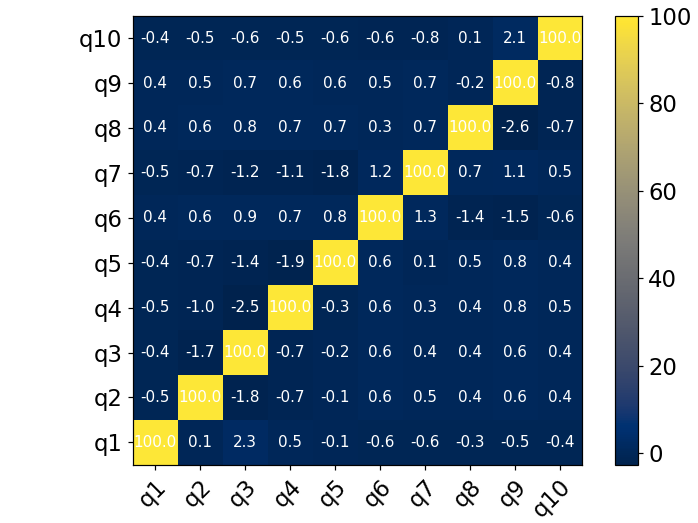

In [503]:
import numpy as np
import matplotlib
import matplotlib.pyplot as plt

vegetables = [f'q{i+1}' for i in range(10)]
farmers = [f'q{i+1}' for i in range(10)]

harvest = z_crosstalk*100


fig, ax = plt.subplots()
fig.subplots_adjust(top=0.85,bottom=0.15,hspace=0.5)
fontsize = 15
im = ax.imshow(harvest,origin='lower',cmap='cividis')

# We want to show all ticks...
ax.set_xticks(np.arange(len(farmers)))
ax.set_yticks(np.arange(len(vegetables)))
# ... and label them with the respective list entries
ax.set_xticklabels(farmers)
ax.set_yticklabels(vegetables)

# Rotate the tick labels and set their alignment.
plt.setp(ax.get_xticklabels(), rotation=45, ha="right",
         rotation_mode="anchor")

# Loop over data dimensions and create text annotations.
for i in range(len(vegetables)):
    for j in range(len(farmers)):
        text = ax.text(j, i, round(harvest[i, j],1),
                       ha="center", va="center", color="w",fontsize=10)

# ax.set_title("Harvest of local farmers (in tons/year)")
fig.tight_layout()
cb = fig.colorbar(im, ax=ax, fraction=.1,ticks=[0,20,40,60,80,100])
cb.ax.tick_params(labelsize=fontsize) 
plt.xticks(fontsize=fontsize)
plt.yticks(fontsize=fontsize)
plt.savefig(r'D:\skzhao\fig\crosstalk.pdf',dpi=1200)
# plt.show()

In [148]:
help(plt.savefig)

Help on function savefig in module matplotlib.pyplot:

savefig(*args, **kwargs)
    Save the current figure.
    
    Call signature::
    
      savefig(fname, dpi=None, facecolor='w', edgecolor='w',
              orientation='portrait', papertype=None, format=None,
              transparent=False, bbox_inches=None, pad_inches=0.1,
              frameon=None, metadata=None)
    
    The output formats available depend on the backend being used.
    
    Parameters
    ----------
    
    fname : str or PathLike or file-like object
        A path, or a Python file-like object, or
        possibly some backend-dependent object such as
        `matplotlib.backends.backend_pdf.PdfPages`.
    
        If *format* is not set, then the output format is inferred from
        the extension of *fname*, if any, and from :rc:`savefig.format`
        otherwise.  If *format* is set, it determines the output format.
    
        Hence, if *fname* is not a path or has no extension, remember to
      

In [189]:
z = z_crosstalk.T[1:5,1:5] - old[1:5,1:5]
qname = ['q2','q3','q4','q5']
pd.DataFrame(z,columns=qname,index=qname)

,q2,q3,q4,q5
q2,0.000000,-0.001474,-0.000817,-0.001812
q3,-0.001776,0.000000,-0.000304,-0.000442
q4,-0.001909,-0.004526,0.000000,-0.003282
q5,-0.000948,-0.000164,-0.001641,0.000000


In [1202]:
save('crosstalk_cali_correct',mat=z_crosstalk)

WindowsPath('D:/QuLabData/2020/1212/crosstalk_cali_correct_20201212231657.npz')

In [1190]:
data = np.load(r'D:/QuLabData/2020/1203/crosstalk_cali/zheng2_crosstalk_q1-10_20201203154147.npz')
z_crosstalk = data['mat']

In [1200]:
z_crosstalk[:,5] = col6

In [1198]:
# row5 = np.array([ 0.00421272,  0.00575527,  0.0087484 ,  0.00732715,  0.00784149,
#         1.        ,  0.01346835, -0.01432041, -0.01459668, -0.00611429])
# row6 = np.array([-0.00477311, -0.00730949, -0.012     , -0.01061567, -0.017743  ,
#         0.0122517 ,  1.        ,  0.00719729,  0.01131581,  0.00549836])
col5 = np.array([-0.006     ,  0.00626401,  0.00572914,  0.00571465,  0.00594612,
        0.0122517 ,  1.        ,  0.00326792,  0.00453333, -0.00647644])
col6 = np.array([-0.006     ,  0.00510811,  0.00372147,  0.00312076,  0.00126667,
        1.        ,  0.01346835,  0.00714499,  0.00653179, -0.00764038])

In [1191]:
qname = [f'q{i+1}' for i in range(10)]
pd.DataFrame(z_crosstalk,columns=qname,index=qname)

,q1,q2,q3,q4,q5,q6,q7,q8,q9,q10
q1,1.000000,0.001435,0.023069,0.004969,-0.001232,-0.006000,-0.006000,-0.003465,-0.005134,-0.003624
q2,-0.004953,1.000000,-0.018141,-0.007228,-0.000870,0.006264,0.005108,0.003556,0.005729,0.004000
q3,-0.004272,-0.016736,1.000000,-0.006661,-0.001728,0.005729,0.003721,0.003708,0.006282,0.004271
q4,-0.004688,-0.009825,-0.024868,1.000000,-0.002780,0.005715,0.003121,0.004412,0.007709,0.004759
q5,-0.004117,-0.007450,-0.013711,-0.018912,1.000000,0.005946,0.001267,0.004836,0.008369,0.004489
q6,0.004213,0.005755,0.008748,0.007327,0.007841,1.000000,0.013468,-0.014320,-0.014597,-0.006114
q7,-0.004773,-0.007309,-0.012000,-0.010616,-0.017743,0.012252,1.000000,0.007197,0.011316,0.005498
q8,0.004409,0.005715,0.007837,0.006580,0.006504,0.003268,0.007145,1.000000,-0.026362,-0.006966
q9,0.004000,0.005087,0.006788,0.005752,0.005709,0.004533,0.006532,-0.002082,1.000000,-0.007683
q10,-0.003923,-0.004530,-0.006309,-0.005327,-0.006114,-0.006476,-0.007640,0.001364,0.020969,1.000000


In [1204]:
qname = [f'q{i+1}' for i in range(10)]
pd.DataFrame(z_crosstalk,columns=qname,index=qname)

,q1,q2,q3,q4,q5,q6,q7,q8,q9,q10
q1,1.000000,0.001435,0.023069,0.004969,-0.001232,-0.006000,-0.006000,-0.003465,-0.005134,-0.003624
q2,-0.004953,1.000000,-0.018141,-0.007228,-0.000870,0.005108,0.006264,0.003556,0.005729,0.004000
q3,-0.004272,-0.016736,1.000000,-0.006661,-0.001728,0.003721,0.005729,0.003708,0.006282,0.004271
q4,-0.004688,-0.009825,-0.024868,1.000000,-0.002780,0.003121,0.005715,0.004412,0.007709,0.004759
q5,-0.004117,-0.007450,-0.013711,-0.018912,1.000000,0.001267,0.005946,0.004836,0.008369,0.004489
q6,-0.004773,-0.007309,-0.012000,-0.010616,-0.017743,1.000000,0.012252,0.007197,0.011316,0.005498
q7,0.004213,0.005755,0.008748,0.007327,0.007841,0.013468,1.000000,-0.014320,-0.014597,-0.006114
q8,0.004409,0.005715,0.007837,0.006580,0.006504,0.007145,0.003268,1.000000,-0.026362,-0.006966
q9,0.004000,0.005087,0.006788,0.005752,0.005709,0.006532,0.004533,-0.002082,1.000000,-0.007683
q10,-0.003923,-0.004530,-0.006309,-0.005327,-0.006114,-0.007640,-0.006476,0.001364,0.020969,1.000000


In [1203]:
z_crosstalk[6:8,6:8]

array([[ 1.        , -0.01432041],
       [ 0.00326792,  1.        ]])

# crosstalk二遍校

In [1102]:
z_crosstalk = np.eye(10)

<IPython.core.display.Javascript object>


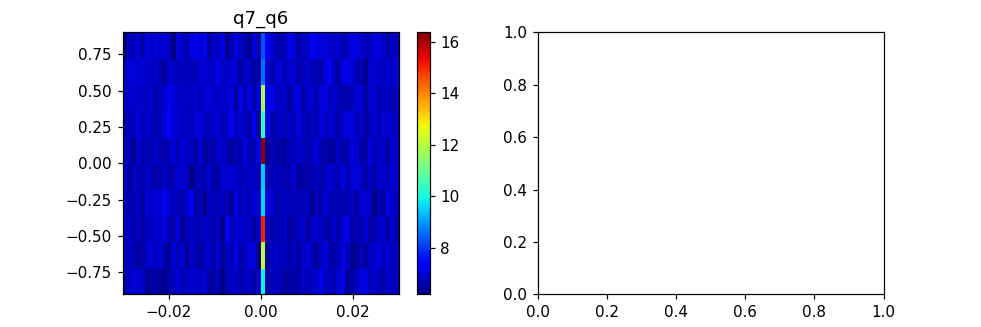

['q7_q6'] 2020-12-13 20:08:11.687710


In [15]:
value,num,tags,finishtime = write(height=3,title='crosstalkSpec_second',which=0,peak=1000)
print(tags,finishtime)
# target = 1
# q_target, q_bias = tags[0].split('_')
# v, f, s = value[target-1][0][:-1], value[target-1][1][:], np.abs(value[target-1][2])[:-1,:]
# peak = (np.max(np.abs(s))+np.min(np.abs(s))) / 2
# v, f, res = op.Crosstalk_Fit(peak=peak).fitCrosstalk(v,f,s,classify=False)
# z = res[0]*f + res[1]
# row, col = eval(q_target[1:])-1, eval(q_bias[1:])-1
# z_crosstalk[row,col] = -1/res[0]
# fig = plt.gcf()
# ax = plt.getp(fig,'axes')
# ax[target-1].scatter(f[:],v[:],marker='o',c='w',edgecolors='m')
# ax[target-1].plot(f[:],z[:],'k--')
# plt.show()

In [12]:
0.908394*0.31764

0.28854227016

In [1104]:
z_crosstalk

array([[ 1.        ,  0.        ,  0.        ,  0.        ,  0.        ,
         0.        ,  0.        ,  0.        ,  0.        ,  0.        ],
       [ 0.        ,  1.        ,  0.        ,  0.        ,  0.        ,
         0.        ,  0.        ,  0.        ,  0.        ,  0.        ],
       [ 0.        ,  0.        ,  1.        ,  0.        ,  0.        ,
         0.        ,  0.        ,  0.        ,  0.        ,  0.        ],
       [ 0.        ,  0.        ,  0.        ,  1.        ,  0.        ,
         0.        ,  0.        ,  0.        ,  0.        ,  0.        ],
       [ 0.        ,  0.        ,  0.        ,  0.        ,  1.        ,
         0.        ,  0.        ,  0.        ,  0.        ,  0.        ],
       [ 0.        ,  0.        ,  0.        ,  0.        , -0.03001792,
         1.        ,  0.        ,  0.        ,  0.        ,  0.        ],
       [ 0.        ,  0.        ,  0.        ,  0.        ,  0.        ,
         0.        ,  1.        ,  0.        

In [878]:
np.mat([[ 1.        , -0.02182464],[-0.00372871,  1.        ]])*np.mat([[1.        , 0.00719729],[0.00714499, 1.        ]])

matrix([[ 0.99984406, -0.01462735],
        [ 0.00341628,  0.99997316]])

# 用谱验证crosstalk

<IPython.core.display.Javascript object>


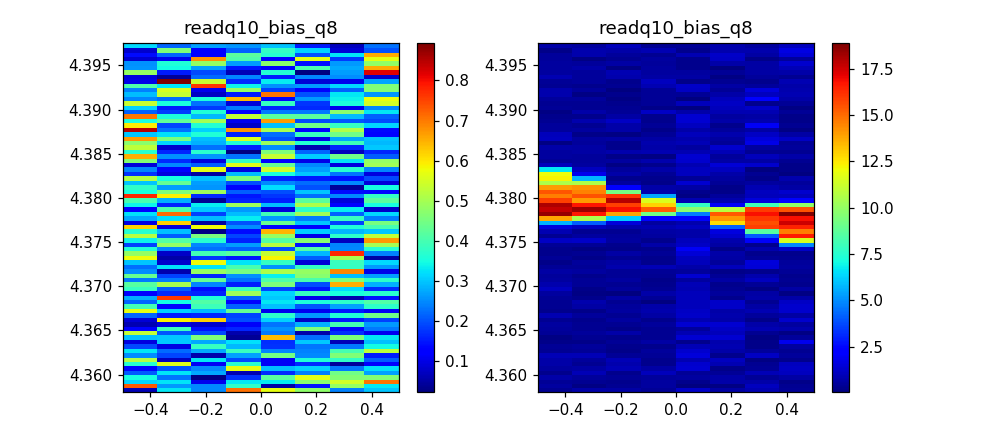

['readq10_bias_q8'] 2020-12-15 22:04:02.635869


In [65]:
value,num,tags,finishtime = write(height=4,title='spec2d_crosstalk',which=3,peak=1000,transposition=True)
print(tags,finishtime)

In [519]:
np.info(np.real)

 real(val)

Return the real part of the complex argument.

Parameters
----------
val : array_like
    Input array.

Returns
-------
out : ndarray or scalar
    The real component of the complex argument. If `val` is real, the type
    of `val` is used for the output.  If `val` has complex elements, the
    returned type is float.

See Also
--------
real_if_close, imag, angle

Examples
--------
>>> a = np.array([1+2j, 3+4j, 5+6j])
>>> a.real
array([ 1.,  3.,  5.])
>>> a.real = 9
>>> a
array([ 9.+2.j,  9.+4.j,  9.+6.j])
>>> a.real = np.array([9, 8, 7])
>>> a
array([ 9.+2.j,  8.+4.j,  7.+6.j])
>>> np.real(1 + 1j)
1.0


<IPython.core.display.Javascript object>


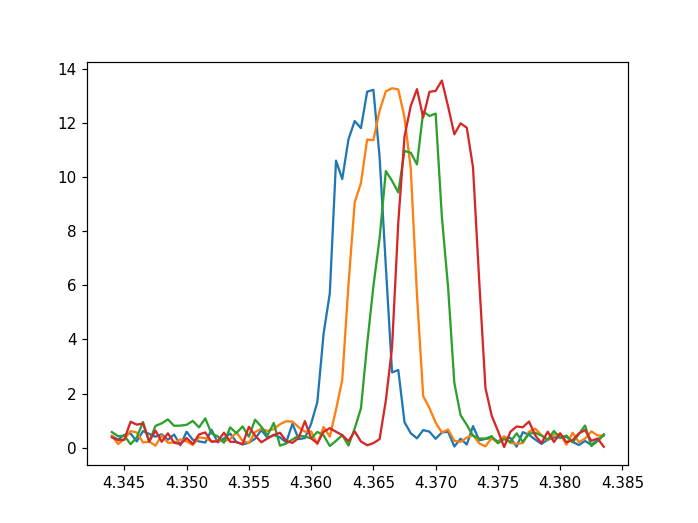

In [512]:
plt.figure()
num = 0
for i in range(np.shape(value[num][2])[0]):
    plt.plot(value[num][1],np.abs(value[num][2][i,:]))
#     plt.plot(value[num][1],np.abs(value[num][2][4,:]))


# 拟合二维谱

In [3]:
specfunc = {}
specinterp = {}
x = sy.Symbol('x',real=True)

In [33]:
np.shape(value[1][0])

(32,)

In [ ]:
[np.shape(s_s2),np.shape(f_s2),np.shape(v_s2)]

<IPython.core.display.Javascript object>


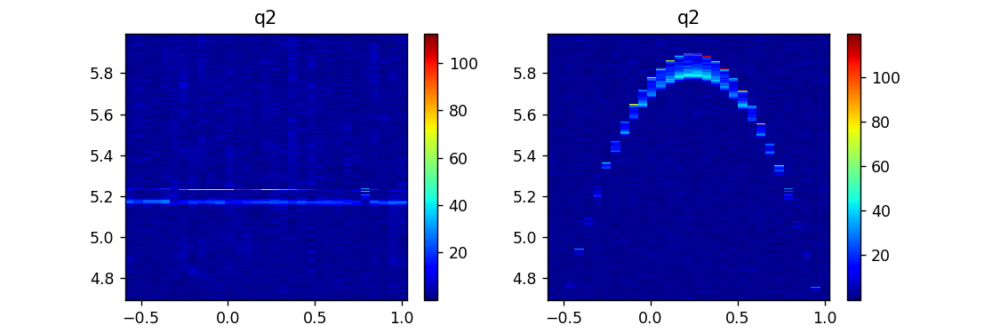

['q2'] 2021-07-14 03:25:12.159934


In [25]:
value,num,tags,finishtime = write(height=3,title='spec2d',which=3,peak=1000,transposition=True)
print(tags,finishtime)

<IPython.core.display.Javascript object>


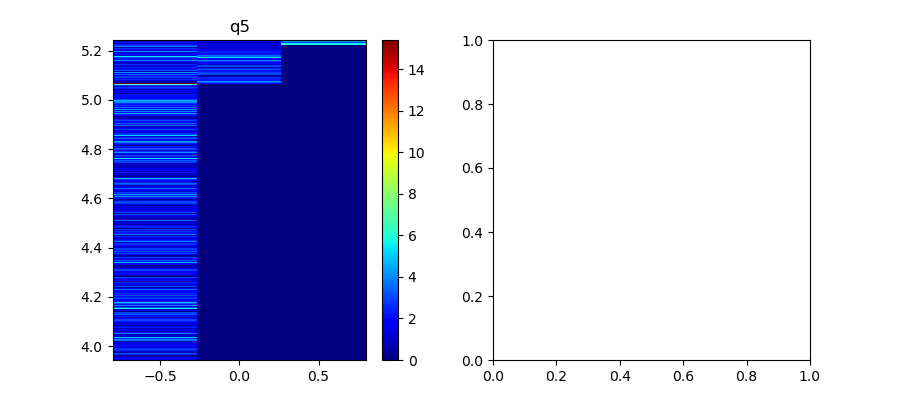

['q5'] 2021-07-07 12:42:48.868203


In [15]:
value,num,tags,finishtime = write(height=4,title='spec2d_awg2',which=0,peak=1000,transposition=True)
print(tags,finishtime)

In [8]:
# target = eval(tags[0][1:])
target = 1
v, f, s = value[target-1][0][:], value[target-1][1][:900], np.abs(value[target-1][2][:,:900])
# s = s[1:,:]
peak = (np.max(np.abs(s))+np.min(np.abs(s))) / 2

f, v, res, func = op.Spec2d_Fit(peak=peak).fitSpec2d(v,f,np.abs(s),classify=False)
voffset, vperiod, ejs, ec, d = res.x
v1 = np.linspace((min(v)-np.abs((max(v)-min(v))/2)),(max(v)+np.abs((max(v)-min(v))/2)),1001)
# z = np.sqrt(A*np.abs(np.cos(W*v1+phi))) + C
tmp = np.pi*(v1-voffset)/vperiod
z = np.sqrt(8*ejs*ec*np.abs(np.cos(tmp))*np.sqrt(1+d**2*np.tan(tmp)**2))-ec
tmp_s = np.pi*(x-voffset)/vperiod
y = sy.sqrt(8*ejs*ec*sy.Abs(sy.cos(tmp_s))*sy.sqrt(1+d**2*sy.tan(tmp_s)**2))-ec
specfunc[tags[0]] = [y,voffset, vperiod, ejs, ec, d]
print(specfunc)
fig = plt.gcf()
ax = plt.getp(fig,'axes')
ax[target-1].scatter(v,f,marker='.',c='',edgecolors='m')
ax[target-1].plot(v1,z,'y--')
ax[target-1].hlines(np.max(z),np.max(v),np.min(v),'w',label=f'w_max={round(np.max(z),3)}GHz')
ax[target-1].legend(loc='best',fontsize='xx-small')
plt.show()

d:\qulab\qulab\yhs\optimize.py:581: RuntimeWarning: invalid value encountered in sqrt
  f01 = np.sqrt(8*ejs*ec*np.abs(np.cos(tmp))*np.sqrt(1+d**2*np.tan(tmp)**2))-ec


AttributeError: 'ImmutableDenseNDimArray' object has no attribute 'could_extract_minus_sign'

In [1003]:
indexx
fs=[]
for i in indexx:
    fs.append(value[0][1][i])

In [53]:
target = eval(tags[0][1:])
target = 0
v, f, s = value[target-1][0][:], value[target-1][1][:], value[target-1][2][:,:]
# s = s[1:,:]
peak = (np.max(np.abs(s))+np.min(np.abs(s))) / 2
# f,v,A, C, W, phi = op.Spec2d_Fit(peak=peak).fitSpec2d(v,f,s,classify=False)
f, v, voffset, vperiod, ejs, ec, d = op.Spec2d_Fit(peak=peak).fitSpec2d(v,f,np.abs(s),classify=False)
v1 = np.linspace((min(v)-np.abs((max(v)-min(v))/2)),(max(v)+np.abs((max(v)-min(v))/2)),1001)
# z = np.sqrt(A*np.abs(np.cos(W*v1+phi))) + C
tmp = np.pi*(v1-voffset)/vperiod
z = np.sqrt(8*ejs*ec*np.abs(np.cos(tmp))*np.sqrt(1+d**2*np.tan(tmp)**2))-ec
tmp_s = np.pi*(x-voffset)/vperiod
y = sy.sqrt(8*ejs*ec*sy.Abs(sy.cos(tmp_s))*sy.sqrt(1+d**2*sy.tan(tmp_s)**2))-ec
specfunc[tags[0]] = [y,voffset, vperiod, ejs, ec, d]
print(specfunc)
fig = plt.gcf()
ax = plt.getp(fig,'axes')
ax[target-1].scatter(v,f,marker='.',c='',edgecolors='m')
ax[target-1].plot(v1,z,'y--')
ax[target-1].hlines(np.max(z),np.max(v),np.min(v),'w',label=f'w_max={round(np.max(z),3)}GHz')
ax[target-1].legend(loc='best',fontsize='xx-small')
plt.show()

C:\WPy64-3740\python-3.7.4.amd64\lib\site-packages\numpy\core\fromnumeric.py:3257: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
C:\WPy64-3740\python-3.7.4.amd64\lib\site-packages\numpy\core\_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
d:\qulab\qulab\yhs\optimize.py:581: RuntimeWarning: invalid value encountered in sqrt
  f01 = np.sqrt(8*ejs*ec*np.abs(np.cos(tmp))*np.sqrt(1+d**2*np.tan(tmp)**2))-ec


ValueError: not enough values to unpack (expected 7, got 4)

# 坠饰态能谱

<IPython.core.display.Javascript object>


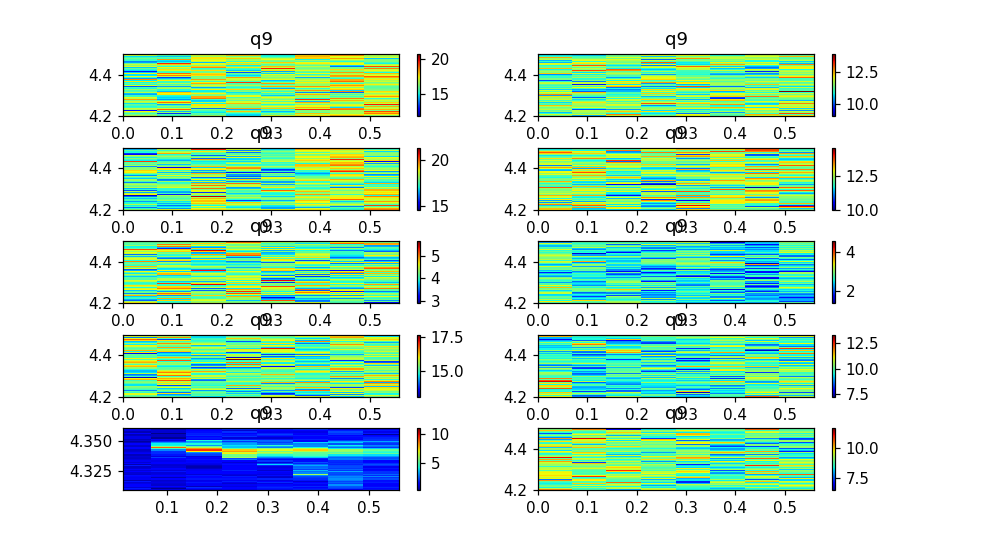

['q9', '4.3469'] 2021-01-26 15:00:17.395419


In [367]:
value,num,tags,finishtime = write(height=1,title='spec2d_dress',which=0,peak=1000,transposition=True)
print(tags,finishtime)

In [1051]:
q7.dressenergy(0.3)

array(4.34828571)

<IPython.core.display.Javascript object>


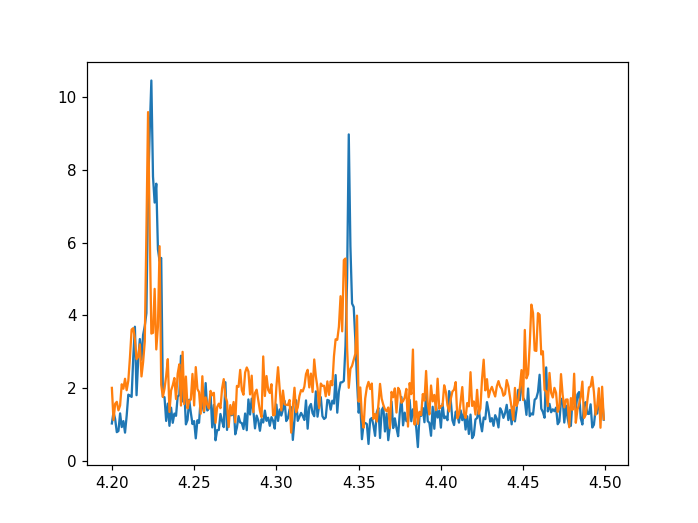

In [368]:
plt.figure()
num = 8
plt.plot(value[num][1],np.abs(value[num][2][1,:]))
plt.plot(value[num][1],np.abs(value[num][2][-1,:]))

In [1038]:
q7.dressenergy(0.6)

array(4.35514286)

In [1123]:
target = eval(tags[0][1:])
# target = 1
v, f, s = value[target-1][0][:], value[target-1][1][:], value[target-1][2][:,:]
peak = (np.max(np.abs(s))+np.min(np.abs(s))) / 2
v,f = op.Spec2d_Fit(peak=peak).profile(v,f,np.abs(s),classify=False)

In [6]:
np.savez(r'q9.npz',rows=value[0][0],cols=value[0][1],s=value[0][2])

<IPython.core.display.Javascript object>


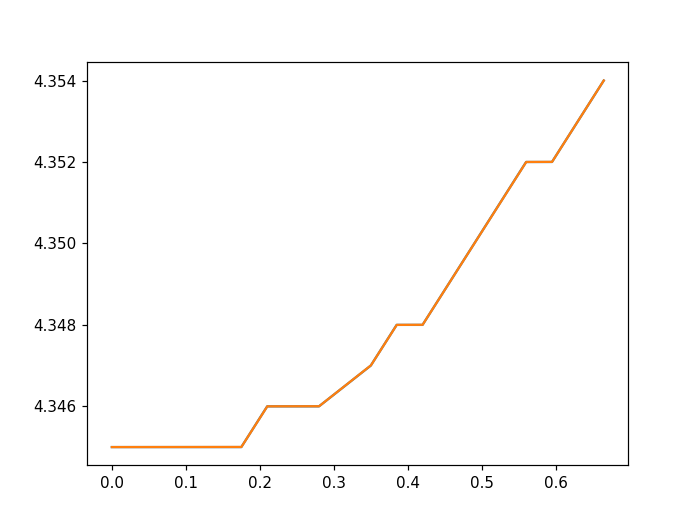

In [1124]:
plt.figure()
vnew = np.linspace(min(v),max(v),50001)
func = scipy.interpolate.interp1d(v,f)
plt.plot(v,f)
plt.plot(vnew,func(vnew))

In [1113]:
f

array([4.342])

In [1070]:

# plt.figure()
# vnew = np.linspace(min(v),max(v),50001)
# func = scipy.interpolate.interp1d(v,f)
# fnew = func(vnew)-4.346
# bias = dt.biasshift(q1.specfuncz,4.346,fnew,'lower')
# # plt.plot(v,f)
# plt.plot(vnew,bias)

In [1125]:
q2.dressenergy = func

In [1081]:
func(0.3)

array(4.34857143)

<IPython.core.display.Javascript object>


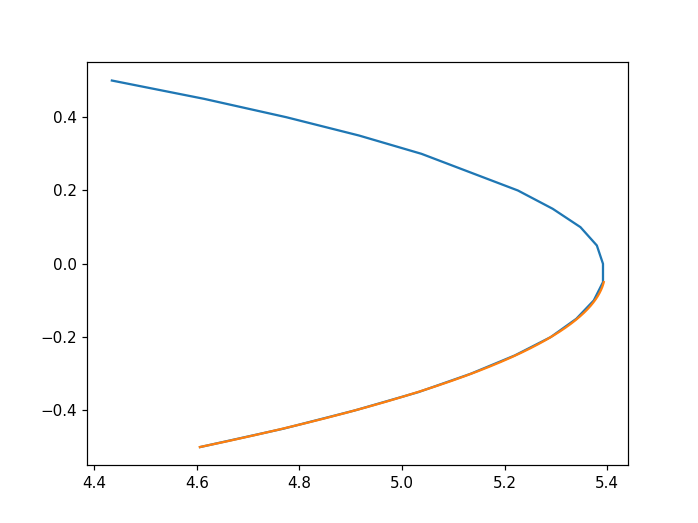

In [981]:
func = specfunc[tags[0]][0]
y = sy.lambdify(x,func,'numpy')
v_new = np.linspace(min(v[v<voffset]),max(v[v<voffset]),250000)
func = scipy.interpolate.interp1d(y(v_new),v_new )
specinterp[tags[0]] = [y(v_new),func(y(v_new))]
plt.figure()
plt.plot(f,v)
plt.plot(y(v_new),func(y(v_new)))

In [982]:
bit = [q7]
for i, j in enumerate(bit):
    j.specfuncz=specfunc[j.q_name]
    j.specinterp=specinterp[j.q_name]

In [984]:
specfunc['q7'][1]

-0.023619854635608957

In [1156]:
q5.specfuncz[1]

0.03347707704934161

In [ ]:
z = np.abs(value[0][2][:36,:])
s = [i if (i.mean()>10) else (i+8) for i in z]
extent = [min(value[0][1]),max(value[0][1]),min(value[0][0][:36]),250*max(value[0][0][:36])]
plt.figure()
plt.imshow(s,aspect='auto',origin='lower',extent=extent)
plt.xlabel('Ex Freq/GHz')
plt.ylabel('modulation Amp/mV')
plt.title('drive freq = 120MHz')

In [ ]:
plt.figure()
plt.plot(value[0][1],np.abs(value[0][2][20]))
plt.show()

In [ ]:
voffset, vperiod, ejs, ec, d

<IPython.core.display.Javascript object>


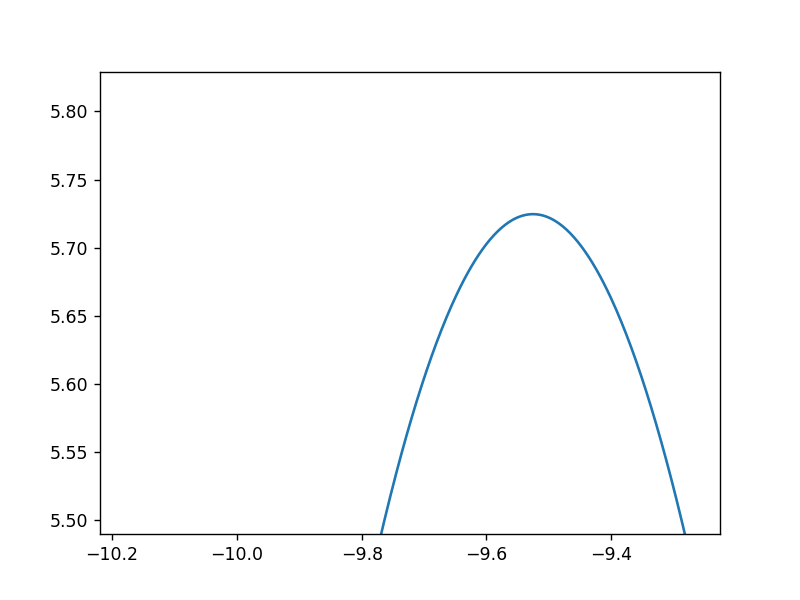

In [139]:
plt.figure()
v1 = np.linspace(-10,10,10001)
tmp = np.pi*(v1-voffset)/vperiod
z = np.sqrt(8*ejs*ec*np.abs(np.cos(tmp))*np.sqrt(1+d**2*np.tan(tmp)**2))-ec
plt.plot(v1,z)

In [306]:
np.shape(value[0][1])

(201,)

In [303]:
bit = [q1,q2,q3,q4,q5,q6,q7]
for i, j in enumerate(bit):
    globals()['q%d'%(i+1)] = j._replace(specfunc=specfunc['q%d'%(i+1)])

<IPython.core.display.Javascript object>


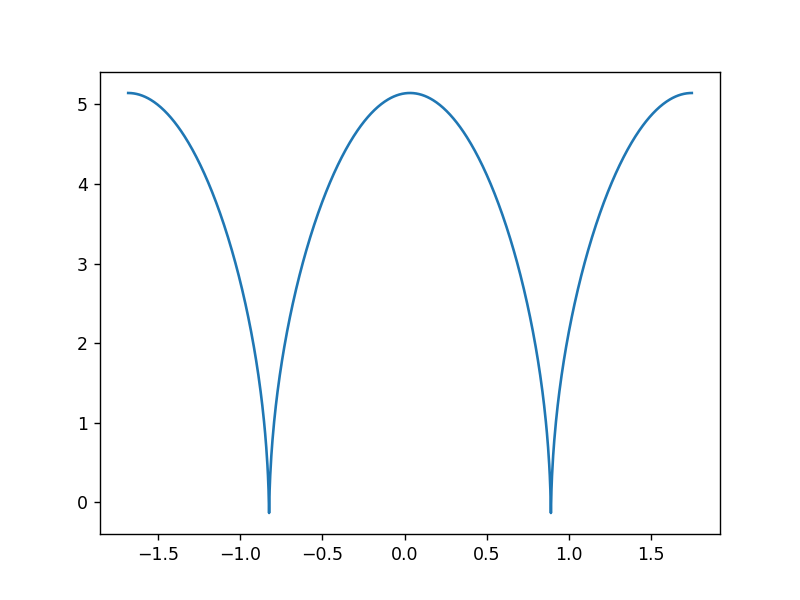

In [1167]:
q = q5
func = q.specfuncz[0]
y = sy.lambdify(x,func,'numpy')
current = np.linspace(-q.specfuncz[2],q.specfuncz[2],1001) + q.specfuncz[1]
plt.figure()
plt.plot(current,y(current))
plt.show()

# 免交叉

<IPython.core.display.Javascript object>


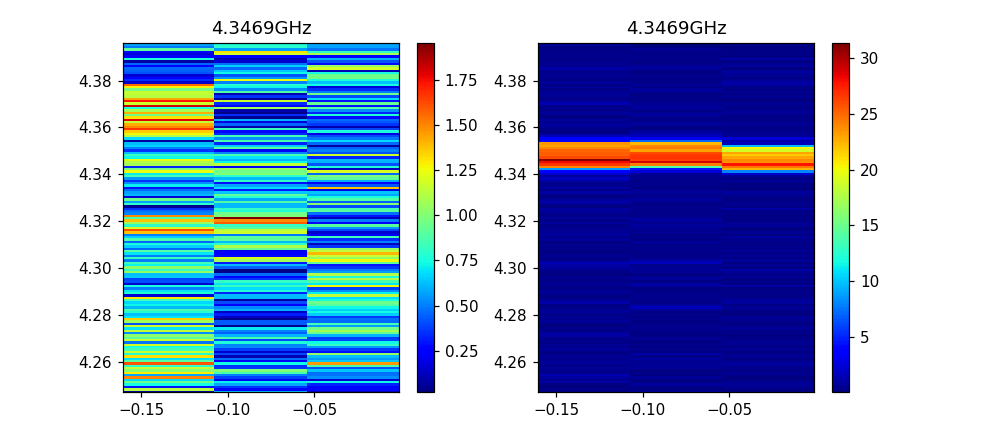

['4.3469GHz'] 2020-12-13 16:42:56.777919


In [1418]:
value,num,tags,finishtime = write(height=4,title='anticross',which=0,peak=1000,transposition=True)
print(tags,finishtime)

<IPython.core.display.Javascript object>


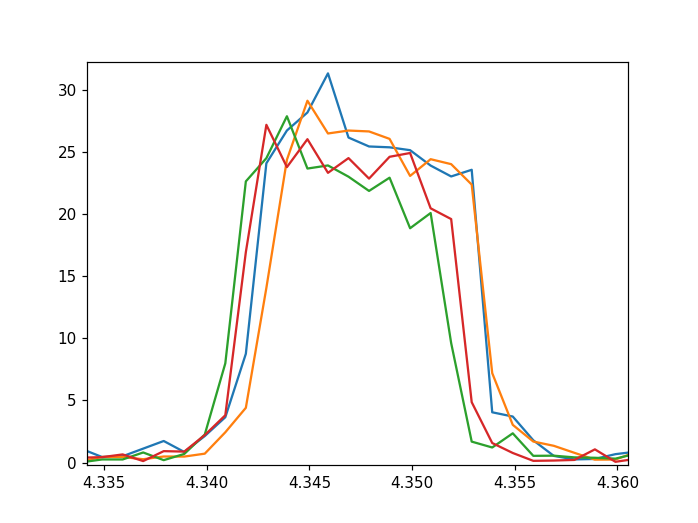

In [1419]:
plt.figure()
num = 1
plt.plot(value[num][1],np.abs(value[num][2][0,:]))
plt.plot(value[num][1],np.abs(value[num][2][1,:]))
plt.plot(value[num][1],np.abs(value[num][2][2,:]))
plt.plot(value[num][1],np.abs(value[num][2][3,:]))

## 能级分布

In [400]:

alpha, f01 = [], []
for i in range(10):
    alpha.append(round(globals()['q%d'%(i+1)].alpha/1e9,3))
    xvar = sy.Symbol('x',real=True)
    func,voffset, vperiod, ejs, ec, d = globals()['q%d'%(i+1)].specfuncz
    v = np.linspace(-vperiod/2,vperiod/2,50001) + voffset
    y = sy.lambdify(xvar,func,'numpy')
    f01.append(round(y(voffset),3))
alpha,f01

([0.212, 0.256, 0.209, 0.258, 0.212, 0.256, 0.194, 0.228, 0.204, 0.264],
 [5.308, 5.895, 5.387, 5.097, 5.144, 5.326, 5.396, 5.804, 5.388, 5.725])

<IPython.core.display.Javascript object>


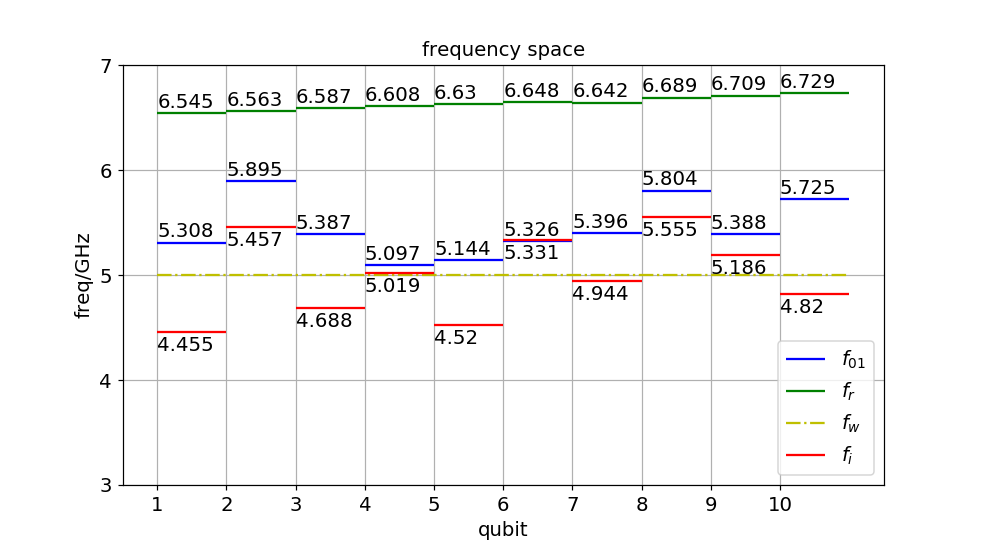

In [708]:
fontsize = 13
freqall = np.round(np.array([6.544550e+09, 6.562725e+09, 6.587250e+09, 6.607625e+09,
       6.630075e+09, 6.648475e+09, 6.641925e+09, 6.688925e+09,
       6.709475e+09, 6.729250e+09])/1e9,3)
# w01 = np.array([5.308,5.91,5.394,5.095,5.132,5.405,5.34,5.813,5.4,5.73])
w01 = f01
fidle = [4.455, 5.457, 4.688, 5.019, 4.52 , 5.331, 4.944, 5.555, 5.186,4.82]
# w01_diff = np.diff(w01)
qnum = np.linspace(1,10,10)
plt.figure(figsize=(9,5))
plt.hlines(w01,qnum,(qnum+1),'b',label='$f_{01}$')
plt.hlines(freqall,qnum,(qnum+1),'g',label='$f_{r}$')
plt.hlines(5,min(qnum),max(qnum+1),'y',label='$f_{w}$',linestyles='dashdot')
plt.hlines(fidle,qnum,(qnum+1),'r',label='$f_{i}$')
# plt.hlines(np.round(w01-np.array(alpha)/2,3),qnum,(qnum+1),'r',label='half f02')
# plt.vlines(qnum[1:],w01[:-1],w01[1:],color='y',alpha=0.5)
plt.ylim(3,7)
for i, j in zip(qnum,w01):
    plt.text(i,j+0.05,str(j),fontsize=fontsize)
for i, j in zip(qnum,np.round(fidle,3)):
    plt.text(i,j-0.18,str(j),fontsize=fontsize)
for i, j in zip(qnum,freqall):
    plt.text(i,j+0.05,str(j),fontsize=fontsize)
plt.grid(which='both')
plt.ylabel('freq/GHz',fontsize=fontsize)
plt.xlabel('qubit',fontsize=fontsize)
plt.xticks(qnum,fontsize=fontsize)
plt.yticks([3,4,5,6,7],fontsize=fontsize)
plt.title('frequency space',fontsize=fontsize)
plt.legend(loc='lower right',fontsize=fontsize)
plt.show()
plt.savefig(r'D:\skzhao\fig\freq_space.pdf',dpi=1200)

In [410]:
help(plt.text)

Help on function text in module matplotlib.pyplot:

text(x, y, s, fontdict=None, withdash=<deprecated parameter>, **kwargs)
    Add text to the axes.
    
    Add the text *s* to the axes at location *x*, *y* in data coordinates.
    
    Parameters
    ----------
    x, y : scalars
        The position to place the text. By default, this is in data
        coordinates. The coordinate system can be changed using the
        *transform* parameter.
    
    s : str
        The text.
    
    fontdict : dictionary, optional, default: None
        A dictionary to override the default text properties. If fontdict
        is None, the defaults are determined by your rc parameters.
    
    withdash : boolean, optional, default: False
        Creates a `~matplotlib.text.TextWithDash` instance instead of a
        `~matplotlib.text.Text` instance.
    
    Returns
    -------
    text : `.Text`
        The created `.Text` instance.
    
    Other Parameters
    ----------------
    **kwargs : 

In [813]:
q7.timing

{'read>xy': 1.0386015994588593e-07, 'z>xy': 1.4862055712792881e-08}

<IPython.core.display.Javascript object>


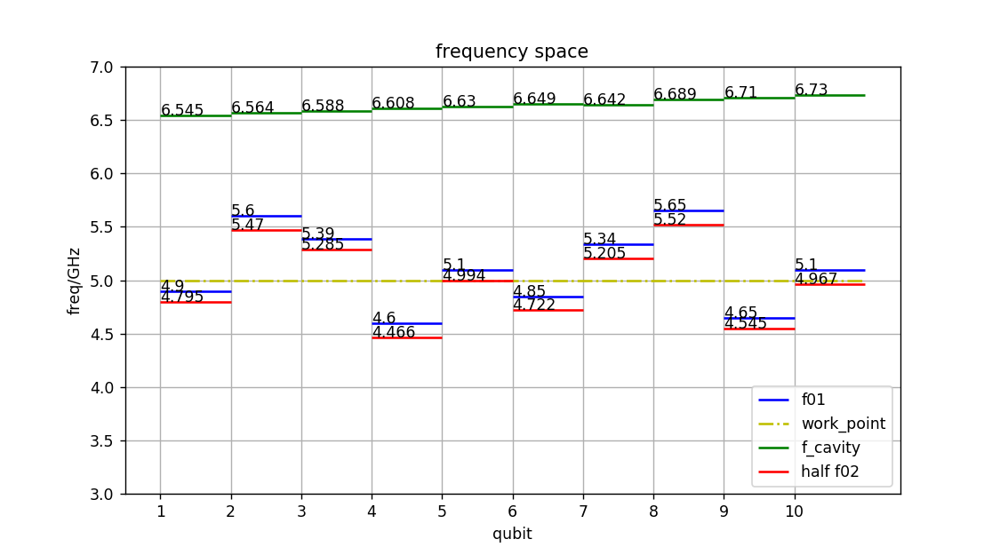

In [1531]:
freqall = np.array([6.545, 6.564, 6.588, 6.608, 6.63, 6.649, 6.642, 6.689, 6.71, 6.73])
w01 = np.array([4.9,5.6,5.39,4.6,5.1,4.85,5.34,5.65,4.65,5.1])
# w01_diff = np.diff(w01)
qnum = np.linspace(1,10,10)
plt.figure(figsize=(9,5))
plt.hlines(w01,qnum,(qnum+1),'b',label='f01')
plt.hlines(5,min(qnum),max(qnum+1),'y',label='work_point',linestyles='dashdot')
plt.hlines(freqall,qnum,(qnum+1),'g',label='f_cavity')
plt.hlines(np.round(w01-np.array(ec)/2,3),qnum,(qnum+1),'r',label='half f02')
# plt.vlines(qnum[1:],w01[:-1],w01[1:],color='y',alpha=0.5)
plt.ylim(3,7)
for i, j in zip(qnum,w01):
    plt.text(i,j,str(j))
for i, j in zip(qnum,np.round(w01-np.array(ec)/2,3)):
    plt.text(i,j,str(j))
for i, j in zip(qnum,freqall):
    plt.text(i,j,str(j))
plt.grid(which='both')
plt.ylabel('freq/GHz')
plt.xlabel('qubit')
plt.xticks(qnum)
plt.title('frequency space')
plt.legend(loc='lower right')
plt.show()

<IPython.core.display.Javascript object>


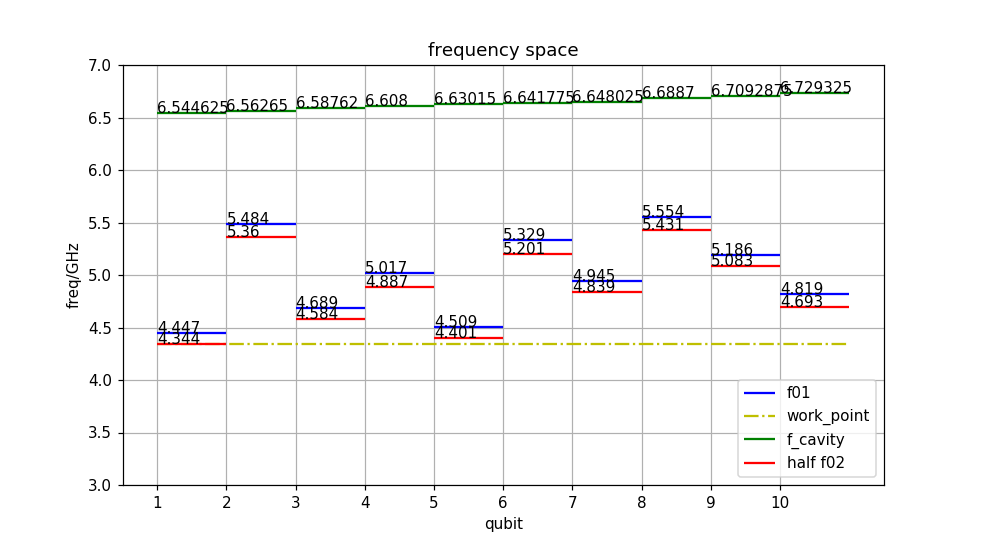

In [5]:
alpha, w01, fread = [], [], []
for i in range(10):
    alpha.append(round(globals()['q%d'%(i+1)].alpha/1e9,3))
    w01.append(round(globals()['q%d'%(i+1)].f_ex/1e9,3))
    fread.append(round((globals()['q%d'%(i+1)].f_lo[0]-50e6)/1e9,3))
w01 = [4.447, 5.484, 4.689, 5.017, 4.509, 5.329, 4.945, 5.554, 5.186,
       4.819]
fread = [6.544625, 6.56265, 6.58762, 6.608, 6.63015, 6.641775, 6.648025, 6.6887, 6.7092875, 6.729325]
qnum = np.linspace(1,10,10)
plt.figure(figsize=(9,5))
plt.hlines(w01,qnum,(qnum+1),'b',label='f01')
plt.hlines(4.342,min(qnum),max(qnum+1),'y',label='work_point',linestyles='dashdot')
plt.hlines(fread,qnum,(qnum+1),'g',label='f_cavity')
plt.hlines(np.round(w01-np.array(alpha)/2,3),qnum,(qnum+1),'r',label='half f02')
# plt.vlines(qnum[1:],w01[:-1],w01[1:],color='y',alpha=0.5)
plt.ylim(3,7)
for i, j in zip(qnum,w01):
    plt.text(i,j,str(j))
for i, j in zip(qnum,np.round(w01-np.array(alpha)/2,3)):
    plt.text(i,j,str(j))
for i, j in zip(qnum,fread):
    plt.text(i,j,str(j))
plt.grid(which='both')
plt.ylabel('freq/GHz')
plt.xlabel('qubit')
plt.xticks(qnum)
plt.title('frequency space')
plt.legend(loc='lower right')
plt.show()

In [505]:
np.mean([4.689,4.519,4.945,5.186])

4.83475

In [504]:
np.array([4.689,4.509,4.945,5.186]) - 4.83225 -0.03

array([-0.17325, -0.35325,  0.08275,  0.32375])

<IPython.core.display.Javascript object>


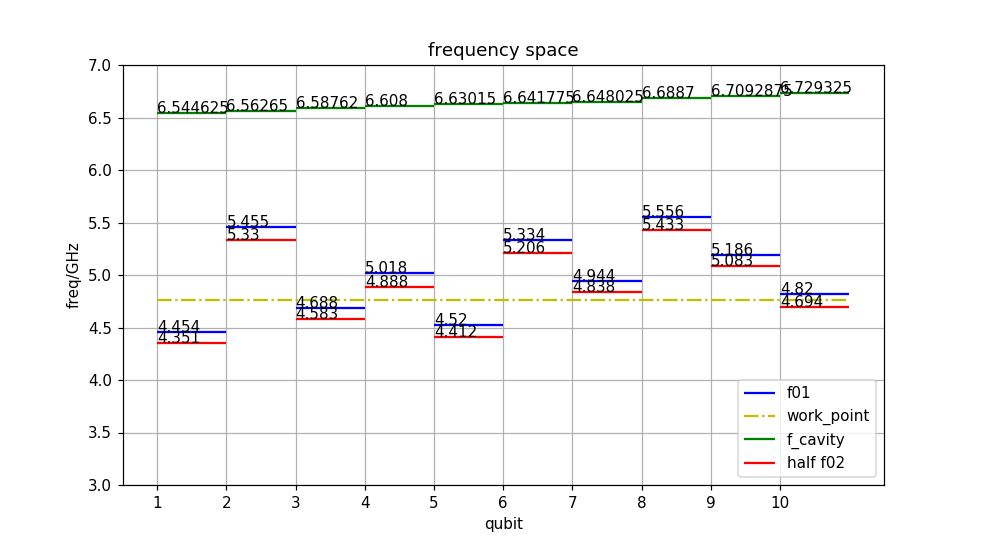

In [306]:
alpha, w01, fread = [], [], []
for i in range(10):
    alpha.append(round(globals()['q%d'%(i+1)].alpha/1e9,3))
    w01.append(round(globals()['q%d'%(i+1)].f_ex/1e9,3))
    fread.append(round((globals()['q%d'%(i+1)].f_lo[0]-50e6)/1e9,3))
w01 = [4.454, 5.455, 4.688, 5.018, 4.52 , 5.334, 4.944, 5.556, 5.186,
       4.82]
fread = [6.544625, 6.56265, 6.58762, 6.608, 6.63015, 6.641775, 6.648025, 6.6887, 6.7092875, 6.729325]
qnum = np.linspace(1,10,10)
plt.figure(figsize=(9,5))
plt.hlines(w01,qnum,(qnum+1),'b',label='f01')
plt.hlines(4.7584,min(qnum),max(qnum+1),'y',label='work_point',linestyles='dashdot')
plt.hlines(fread,qnum,(qnum+1),'g',label='f_cavity')
plt.hlines(np.round(w01-np.array(alpha)/2,3),qnum,(qnum+1),'r',label='half f02')
# plt.vlines(qnum[1:],w01[:-1],w01[1:],color='y',alpha=0.5)
plt.ylim(3,7)
for i, j in zip(qnum,w01):
    plt.text(i,j,str(j))
for i, j in zip(qnum,np.round(w01-np.array(alpha)/2,3)):
    plt.text(i,j,str(j))
for i, j in zip(qnum,fread):
    plt.text(i,j,str(j))
plt.grid(which='both')
plt.ylabel('freq/GHz')
plt.xlabel('qubit')
plt.xticks(qnum)
plt.title('frequency space')
plt.legend(loc='lower right')
plt.show()

In [305]:
np.mean(np.array(w01)[0::2])

4.7584

In [440]:
q10.delta_ex

-100000000.0

In [439]:
np.mean([4.688,4.52,4.945,5.185])

4.834499999999999

# 拟合调制曲线找周期

In [48]:
def fit_cos(tag):
    mat = []
    At = 0
    for i in range(len(value)):
        volt, freq, s = value[i]
        volt, s = volt[:], s[:,:]
        x, y = op.RowToRipe().manipulation(volt,freq,s)
#         y = moving_average(y,5)
#         x, y = x[3:-3], y[3:-3]
        res, func = op.Cos_Fit().fitCos(x,y)
        A, C, W, phi = res.x
        T = 1 / W
        fig = plt.gcf() 
        axes = plt.getp(fig,'axes')
        axes[i].plot(y,x,'ro')
        x1 = np.linspace(min(volt),max(volt),10001)
        y1 = A*np.cos(2*np.pi/T*x1+phi)
        axes[i].plot(y1+C,x1,'b-')
        #if i != int(tag[2:]) - 1:
        t = symbols("t")
        z = A*sy.cos(2*np.pi/T*t+phi)+C
        z_diff = diff(z,t)
        if z_diff.evalf(subs = {t:0}) < 0:
            T *= -1
            if phi<0:
                phi *= -1
        phi = phi % (2*np.pi)
        mat.append((1/T,phi))
        if i == int(tag[2:]) - 1:
            bias0 = op.RowToRipe().firstMax(x1,y1,num=0)
            Tlist[tags[0]] = [round(np.abs(T),3),bias0]
        axes[i].set_title(r'$ q%d,T = %g,phi=%g $' %(i+1,T,phi))
    return mat
        

In [7]:
n = 10
Tlist = {}
matrix_cross = np.eye(n) #收集crosstalk矩阵元
matrix_phi = np.eye(n)
specfunc = {}
x = sy.Symbol('x',real=True)

<IPython.core.display.Javascript object>


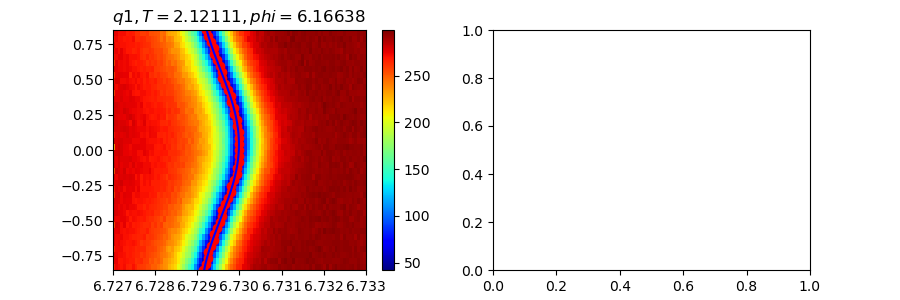

['q10'] 2021-06-30 16:42:03.544983


In [54]:
value,num,tags,finishtime = write(height=3,title='S21vsFlux_awgoffset',which=0,peak=1000) #S21vsFlux_awgoffset
print(tags,finishtime)

In [55]:
# n_target = eval(tags[0][1:])
n_target = 1
mat = fit_cos(tag='q_%d'%n_target)
# matrix_cross[:,n_target-1] = np.array(mat)[:,0]
# matrix_phi[:,n_target-1] = np.array(mat)[:,1]
Tlist

{'q8': [2.11, -0.01343],
 'q7': [2.555, -0.05525],
 'q6': [2.402, 0.25364],
 'q5': [2.482, 0.24959],
 'q4': [2.62, 0.23749],
 'q3': [2.236, 0.17964],
 'q2': [2.015, 0.22525],
 'q1': [2.746, -0.25381],
 'q9': [2.312, -0.16609],
 'q10': [2.121, 0.03944]}

In [91]:
TDC = {'q10': [2.934, 0.032],
 'q9': [2.564, -0.158],
 'q8': [2.996, -0.015],
 'q6': [2.607, 0.22],
 'q5': [2.595, 0.237],
 'q4': [2.624, 0.216],
 'q3': [2.623, 0.178],
 'q2': [2.612, 0.218],
 'q1': [3.249, -0.242],
 'q7': [2.955, -0.058]}

In [81]:
def moving_average(interval, window_size):
    window = np.ones(int(window_size)) / float(window_size)
    return np.convolve(interval, window, 'same')  # numpy的卷积函数

In [734]:
# def fit_spec():
#     n_target = eval(tags[0][1:])
#     volt, freq, s = value[n_target-1]
#     volt, s = volt[0:], -np.abs(s[0:,:])
#     peak = (np.max(s)+np.min(s)) / 2
#     f,v,res, func = op.Cavitymodulation_Fit(peak=peak).fitCavitymodulation(volt,freq,s,classify=False)
#     voffset, vperiod, ejs, ec, d, g, fc = res.x
#     print('voffset, vperiod, ejs, ec, d, g, fc',voffset, vperiod, ejs, ec, d, g, fc)
#     v1 = np.linspace(min(v),max(v),1001)
#     tmp = np.pi*(v1-voffset)/vperiod
#     f01 = np.sqrt(8*ejs*ec*np.abs(np.cos(tmp))*np.sqrt(1+d**2*np.tan(tmp)**2))-ec
#     z = (fc+f01+np.sqrt(4*g**2+(f01-fc)**2))/2
# #     voffset = op.RowToRipe().firstMax(v1,z,num=0,peakpercent=0.9,insitu=True)
# #     print(voffset)
# #     globals()[f'q{n_target}'].T_bias.append((vperiod, voffset))
#     tmp_s = np.pi*(x-voffset)/vperiod
#     y01 = sy.sqrt(8*ejs*ec*sy.Abs(sy.cos(tmp_s))*sy.sqrt(1+d**2*sy.tan(tmp_s)**2))-ec
#     y = (fc+y01+sy.sqrt(4*g**2+(y01-fc)**2))/2
#     specfunc[tags[0]] = y
# #     globals()[f'q{n_target}'].specfunc = y01
# #     globals()[f'q{n_target}'].specfunc_cavity = y
#     globals()[f'q{n_target}'].T_bias = [vperiod,voffset]
# #     globals()[f'q{n_target}'].T_z = [vperiod,voffset]
#     fig = plt.gcf() 
#     axes = plt.getp(fig,'axes')
#     axes[n_target-1].plot(f,v,'w.')
#     axes[n_target-1].plot(z,v1,'-k')
# #     Tlist[tags[0]] = [round(np.abs(vperiod),3),voffset]
#     axes[n_target-1].set_title(r'$ q%d,T = %g$' %(n_target,vperiod))
# fit_spec()
# print(specfunc)

In [47]:
Tlist

{'q8': [2.11, -0.01343],
 'q7': [2.555, -0.05525],
 'q6': [2.402, 0.25364],
 'q5': [2.482, 0.24959],
 'q4': [2.62, 0.23749],
 'q3': [2.236, 0.17964],
 'q2': [2.015, 0.22525],
 'q1': [2.746, -0.25381],
 'q9': [2.312, -0.16609]}

<IPython.core.display.Javascript object>


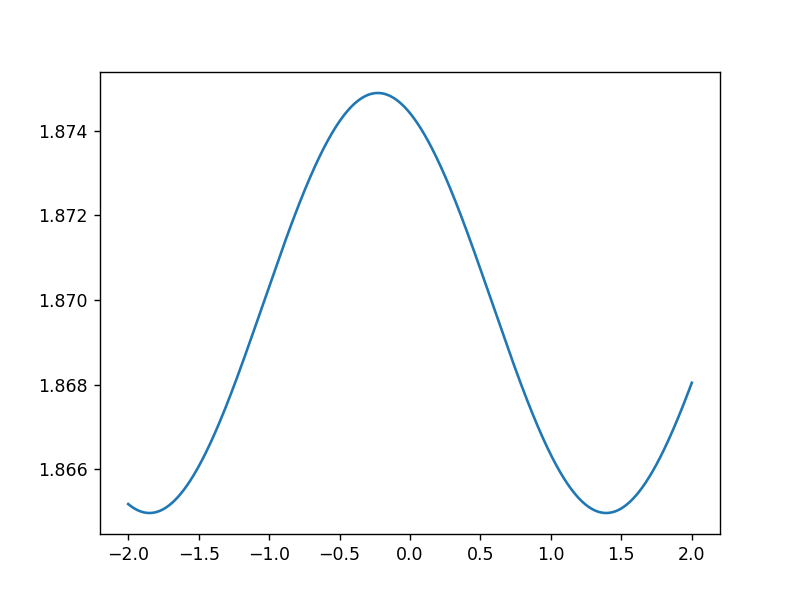

In [797]:
x = sy.Symbol('x')
f = q1.specfunc
y = sy.lambdify(x,f,'numpy')
t = np.linspace(-2,2,1001)
plt.figure()
plt.plot(t,y(t))

In [23]:
mat

[(0.18804389767498625, 5.94886180582986)]

In [1150]:
n_target = eval(tags[0][1:])
mat = fit_cos(tag='q_%d'%n_target)
# matrix_cross[:7,n_target-1] = np.array(mat)[:,0]
# matrix_phi[:7,n_target-1] = np.array(mat)[:,1]
Tlist

{'q10': [1.796, 0.2318],
 'q9': [1.666, 0.0508],
 'q8': [1.981, -0.0682],
 'q7': [1.766, 0.3314],
 'q6': [1.956, 0.1472],
 'q5': [1.676, 0.2908],
 'q4': [1.714, 0.304],
 'q3': [1.681, 0.274],
 'q2': [2.692, 0.44],
 'q1': [2.107, 0.0404]}

In [1016]:
q1.specfuncz[1] = 0.0404

In [1147]:
q10.T_bias

[2.966, 0.372]

In [778]:
Tlist = {'q10': [2.966, 0.068],
 'q9': [2.631, -0.184],
 'q8': [3.088, -0.412],
 'q7': [2.659, 0.216],
 'q6': [3.021, -0.068],
 'q5': [2.656, 0.164],
 'q4': [2.674, 0.19],
 'q3': [2.703, 0.16],
 'q2': [2.692, 0.164],
 'q1': [3.345, -0.284]}

{}

In [280]:
Tlist = {'q10': [3.029, 0.281],
 'q9': [2.639, -0.151],
 'q8': [3.104, -0.317],
 'q7': [2.643, 0.166],
 'q6': [3.045, -0.036],
 'q5': [2.666, 0.156],
 'q4': [2.706, 0.146],
 'q3': [2.704, 0.125],
 'q2': [2.717, 0.14],
 'q1': [3.364, -0.229]}

In [1152]:
for i in range(10):
    globals()[f'q{i+1}'].T_bias = Tlist[f'q{i+1}']

In [137]:
q8.T_bias = Tlist['q8']

In [187]:
matrix_cross[3,n_target-1] = -1/60
# matrix_phi[0,n_target-1] = 0
matrix_cross

array([[ 0.        ,  0.        ,  0.        ,  0.        , -0.01886792,
        -0.04048476, -0.04381544,  0.        ,  0.        ,  0.        ],
       [ 0.        ,  0.        ,  0.        ,  0.        , -0.01646792,
        -0.04206386, -0.04478635,  0.        ,  0.        ,  0.        ],
       [ 0.        ,  0.        ,  0.        ,  0.        , -0.01666667,
        -0.03207076, -0.04327996,  0.        ,  0.        ,  0.        ],
       [ 0.        ,  0.        ,  0.        ,  0.        , -0.01666667,
        -0.03083636, -0.04220373,  0.        ,  0.        ,  0.        ],
       [ 0.        ,  0.        ,  0.        ,  0.        ,  0.55179184,
        -0.02814003, -0.03893577,  0.        ,  0.        ,  0.        ],
       [ 0.        ,  0.        ,  0.        ,  0.        ,  0.02317556,
        -0.56072143, -0.04623969,  0.        ,  0.        ,  0.        ],
       [ 0.        ,  0.        ,  0.        ,  0.        ,  0.01855807,
         0.01428571, -0.55296654,  0.        

In [229]:
# I0 = -np.mat(matrix_cross).I*np.mat(matrix_phi).mean(axis=1)/2/const.pi
# mat_crosstalk = np.mat([matrix_cross[:,i]/matrix_cross[i,i] if matrix_cross[i][i]!=0 else matrix_cross[i,i]\
#                  for i in range(len(matrix_cross))])
#最终加在qubits上的电流为I = mat_crosstalk.I*[0,0,0,0,1]+I0
save('crosstalk_cali','q1-q7',mat=mat_crosstalk)

In [240]:
for i in range(10):
    if matrix_cross[i][i]!=0:
        mat_crosstalk[:,i] = matrix_cross[:,i]/matrix_cross[i,i] 
    mat_crosstalk[i,i] = 1
    
save('crosstalk_cali','q1-q7',mat=mat_crosstalk)

WindowsPath('D:/QuLabData/2020/0624/crosstalk_cali/q1-q7_20200624171927.npz')

In [241]:
mat_crosstalk

array([[ 1.        ,  0.        ,  0.02081242, -0.00556228, -0.03419392,
         0.0722012 ,  0.07923705,  0.        ,  0.        ,  0.        ],
       [-0.11087751,  1.        ,  0.00911005, -0.03760278, -0.02984445,
         0.07501739,  0.08099287,  0.        ,  0.        ,  0.        ],
       [-0.09237872,  0.        ,  1.        , -0.02808258, -0.03020463,
         0.05719553,  0.07826868,  0.        ,  0.        ,  0.        ],
       [-0.09966487,  0.        ,  0.08454681,  1.        , -0.03020463,
         0.05499408,  0.0763224 ,  0.        ,  0.        ,  0.        ],
       [-0.07804834,  0.        ,  0.07193357, -0.06137783,  1.        ,
         0.0501854 ,  0.07041253,  0.        ,  0.        ,  0.        ],
       [-0.08190848,  0.        ,  0.10309907, -0.06923761,  0.04200055,
         1.        ,  0.08362114,  0.        ,  0.        ,  0.        ],
       [-0.06118311,  0.        ,  0.07212722, -0.06237858,  0.03363237,
        -0.02547738,  1.        ,  0.        

In [100]:
bit = [q1,q3,q6,q8,q10]
for i, j in enumerate(bit,start=0):
    globals()['q%d'%(i+1)] = j._replace(T_bias=Tlist['q%d'%(i+1)])

KeyError: 'q2'

In [849]:
voffset = -0.049585349572415706

In [850]:
q6.specfuncz[1] = voffset

In [456]:
dt.specshift(q3.specfuncz,4.254,bias=0.4,side='lower')

(5.358082419340422, -0.07852106527056152)

In [105]:
q8 = q8._replace(T_bias=[1.844, 0.556])

# 拟合T1

In [1108]:
f_rabi=11
str('%f')%f_rabi

'11.000000'

In [1075]:
data = np.load(r'D:\notebooks\skzhao\TT_q6_amp.npz')  ##指定文件路径
data.files

['t', 'T1_2d', 'T1data', 'Frabi']

In [1076]:
data['Frabi'].T[0][15]

4.183000000000061

<IPython.core.display.Javascript object>


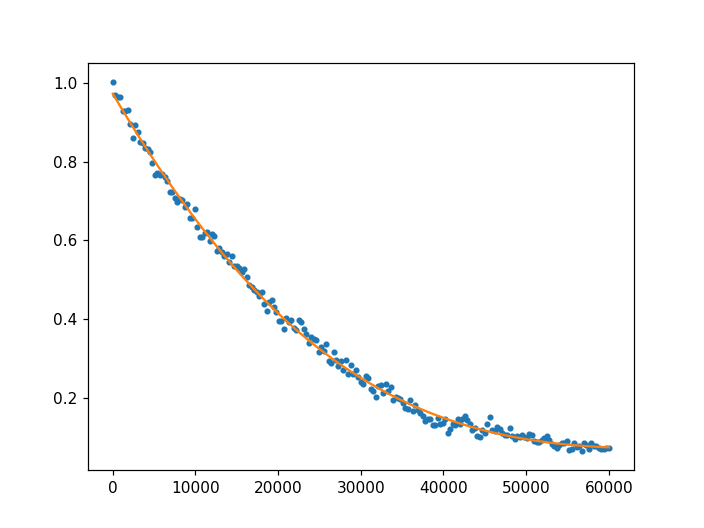

In [727]:
data = np.load(r'D:\notebooks\skzhao\T1_34.2us.npz')  ##指定文件路径
t = data['t']
s_data = data['s_data']
s_fitting = data['s_fitting']
plt.figure()
plt.plot(t,s_data,'.')
plt.plot(t,s_fitting)

<IPython.core.display.Javascript object>


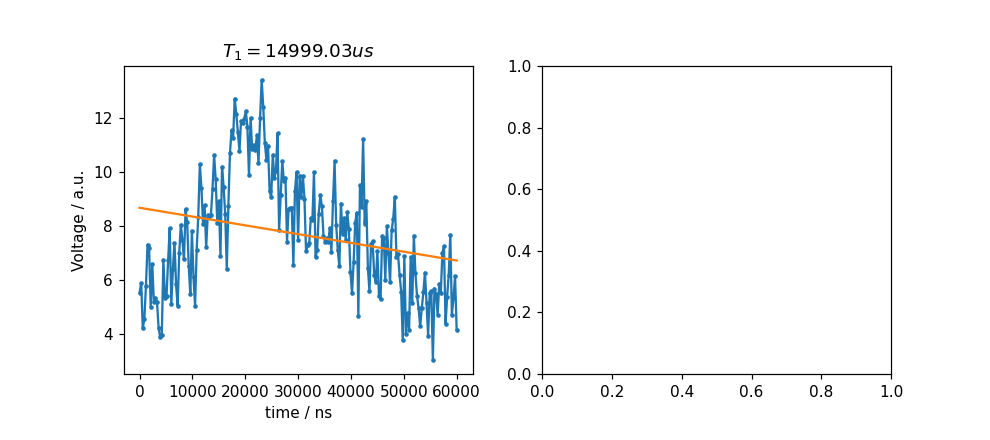

['q8'] 2021-06-13 21:55:05.205686


d:\qulab\qulab\zsk\optimize.py:264: RuntimeWarning: overflow encountered in exp
  return np.sum((A * np.exp(-x*T1) + B - y)**2)
d:\qulab\qulab\zsk\optimize.py:264: RuntimeWarning: overflow encountered in square
  return np.sum((A * np.exp(-x*T1) + B - y)**2)
d:\qulab\qulab\zsk\optimize.py:264: RuntimeWarning: overflow encountered in multiply
  return np.sum((A * np.exp(-x*T1) + B - y)**2)
C:\WPy64-3740\python-3.7.4.amd64\lib\site-packages\scipy\optimize\optimize.py:700: RuntimeWarning: invalid value encountered in subtract
  np.max(np.abs(fsim[0] - fsim[1:])) <= fatol):


In [1135]:
value,num,tags, finishtime = write(height=4,title='T1',which=0)
print(tags,finishtime)
num = 0
x, y = value[num][0], value[num][1]
A, B, T1 = op.Exp_Fit().fitExp(x,np.abs(y))
z = A * np.exp(-x*T1) + B
fig = plt.gcf()
ax = plt.getp(fig,'axes')
ax[num].plot(x,z)
ax[num].set_title('$T_{1}=%.2fus$'%(1/T1/1e3))
ax[num].set_xlabel('time / ns')
ax[num].set_ylabel('Voltage / a.u.')
plt.show()

<IPython.core.display.Javascript object>


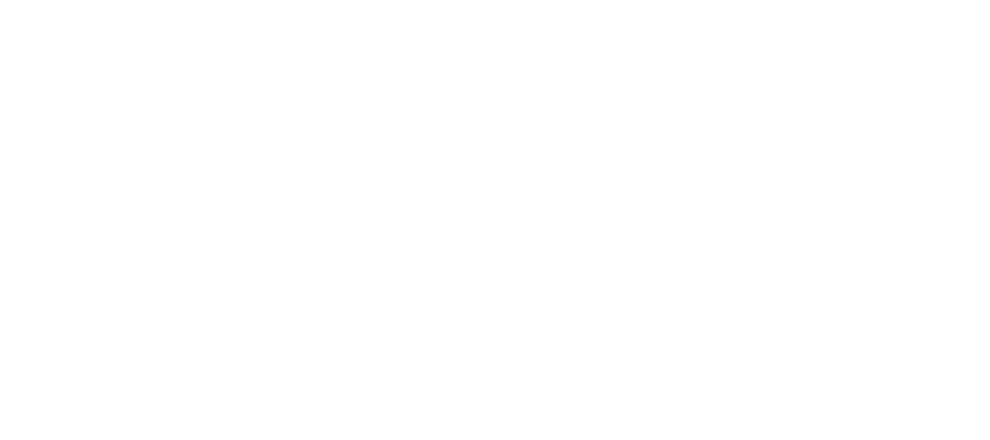

['q8'] 2021-06-13 22:21:19.293447


<IPython.core.display.Javascript object>


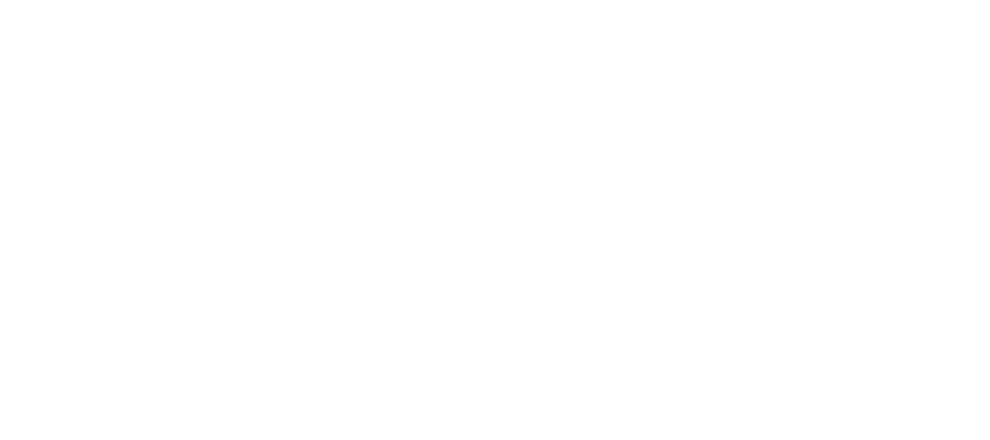

['q8'] 2021-06-13 22:10:38.640999


<IPython.core.display.Javascript object>


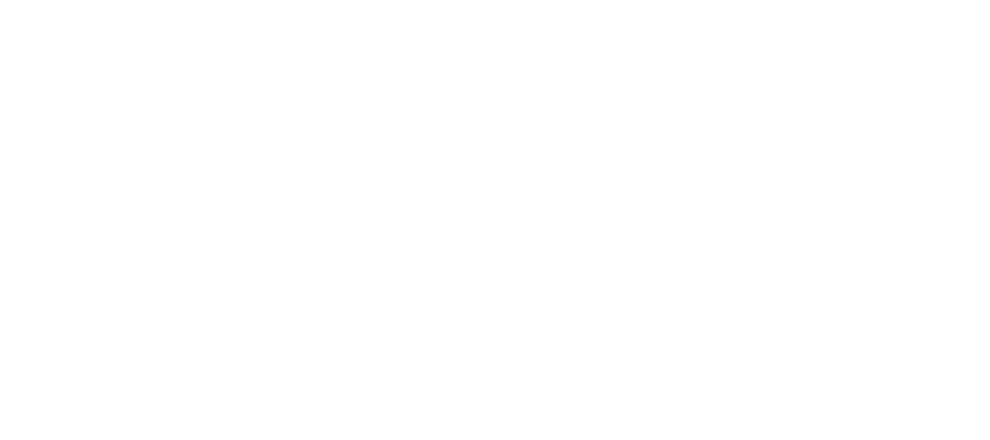

['q8'] 2021-06-13 22:00:08.426609


<IPython.core.display.Javascript object>


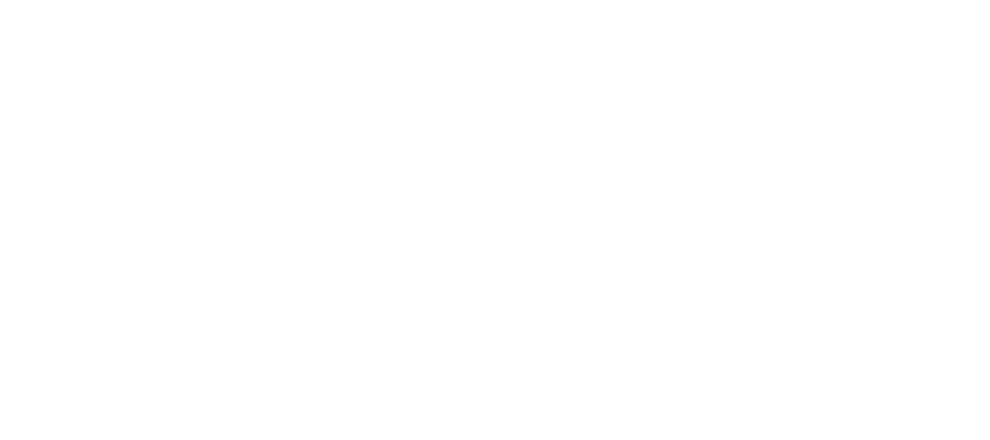

['q8'] 2021-06-13 21:49:49.762267


<IPython.core.display.Javascript object>


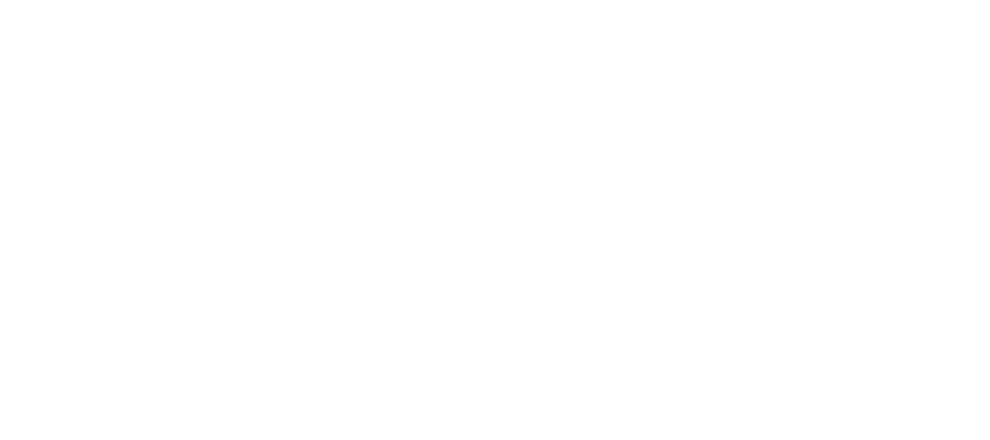

['q8'] 2021-06-13 21:39:29.427145


<IPython.core.display.Javascript object>


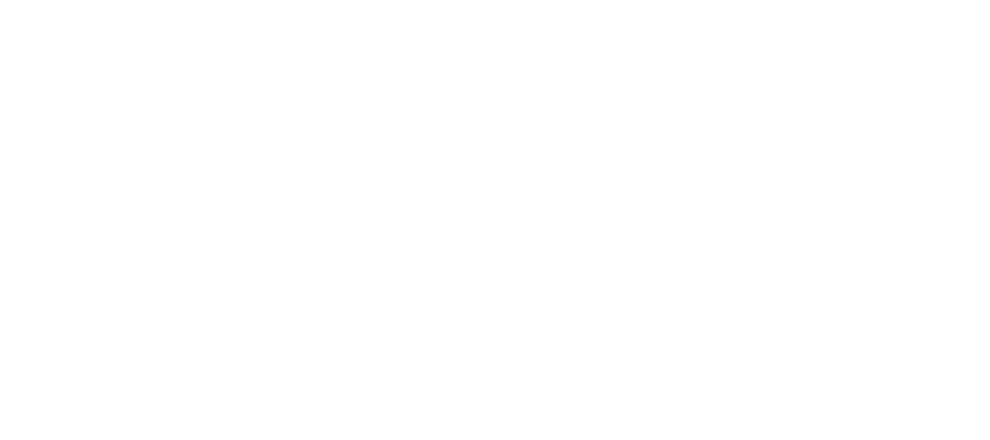

['q8'] 2021-06-13 21:28:56.009282


<IPython.core.display.Javascript object>


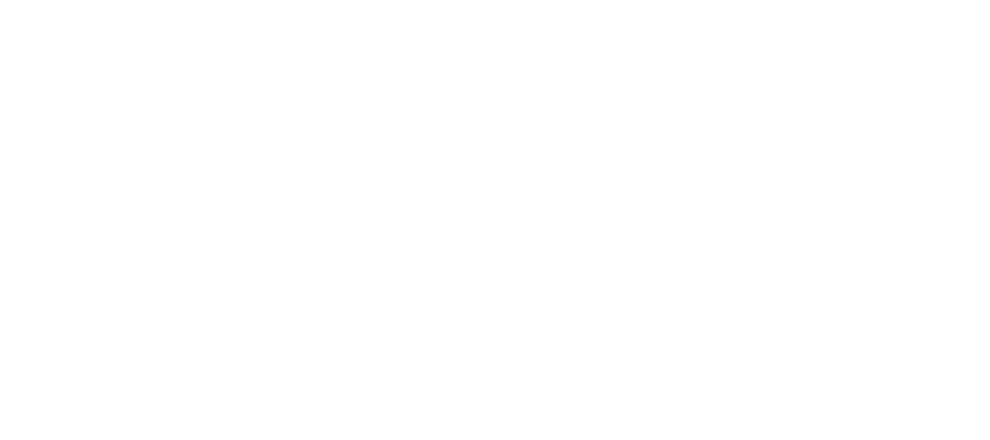

['q8'] 2021-06-13 21:18:10.191484


<IPython.core.display.Javascript object>


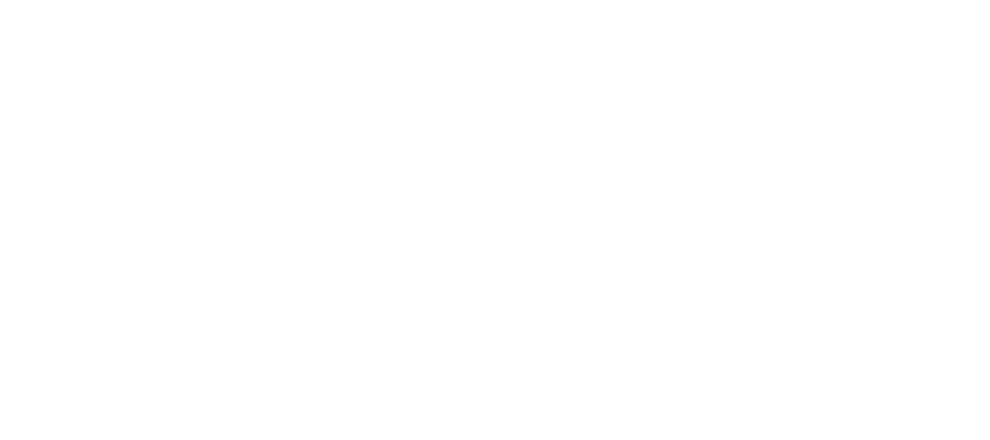

['q8'] 2021-06-13 21:07:16.620224


<IPython.core.display.Javascript object>


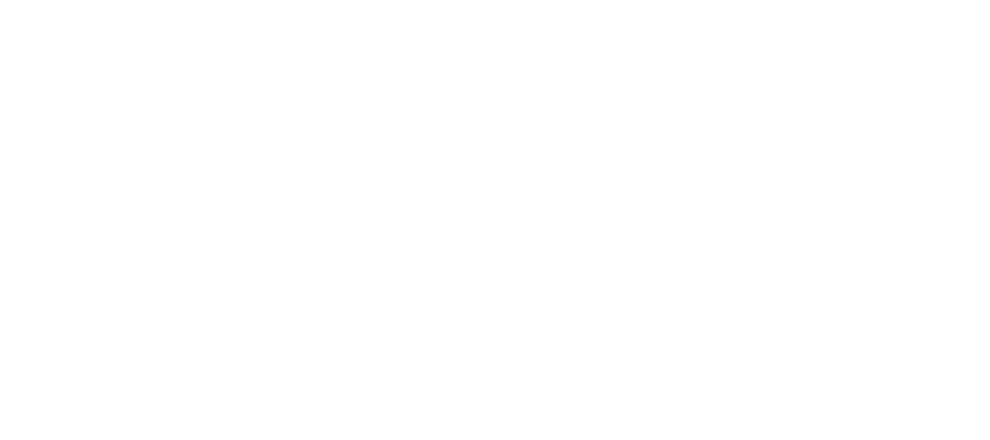

['q8'] 2021-06-13 20:56:36.403422


<IPython.core.display.Javascript object>


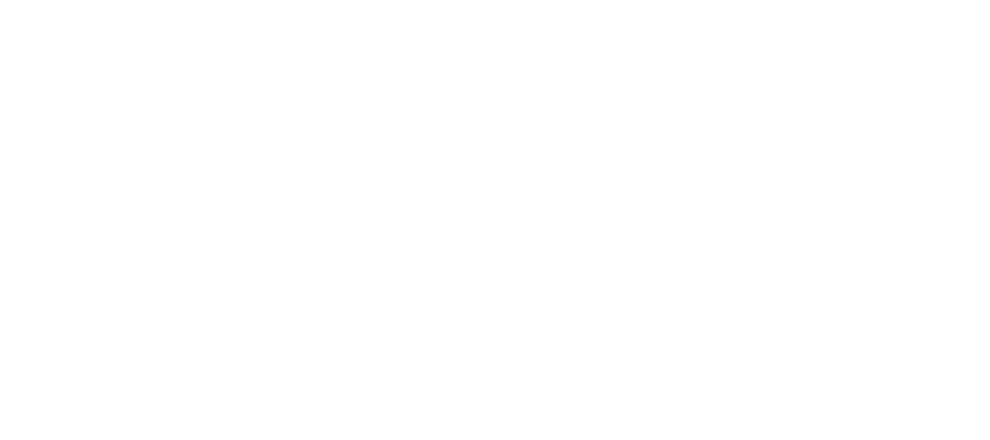

['q8'] 2021-06-13 20:46:23.371832


<IPython.core.display.Javascript object>


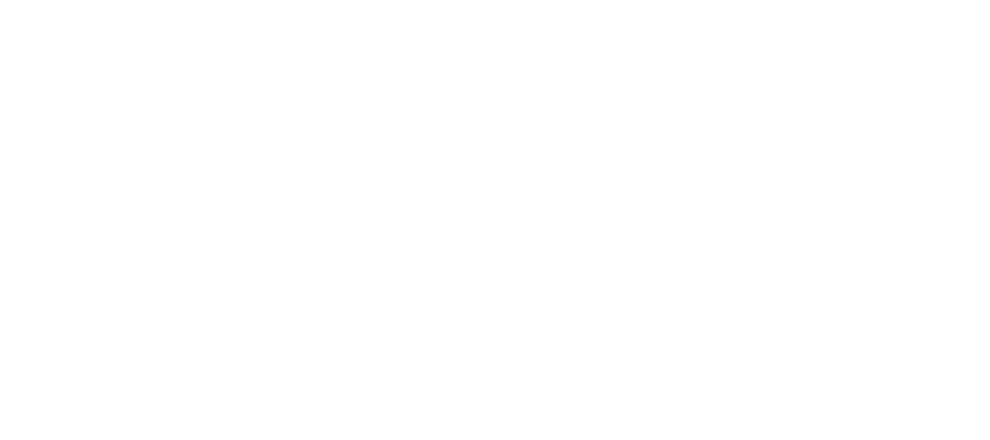

['q8'] 2021-06-13 20:36:02.745990


<IPython.core.display.Javascript object>


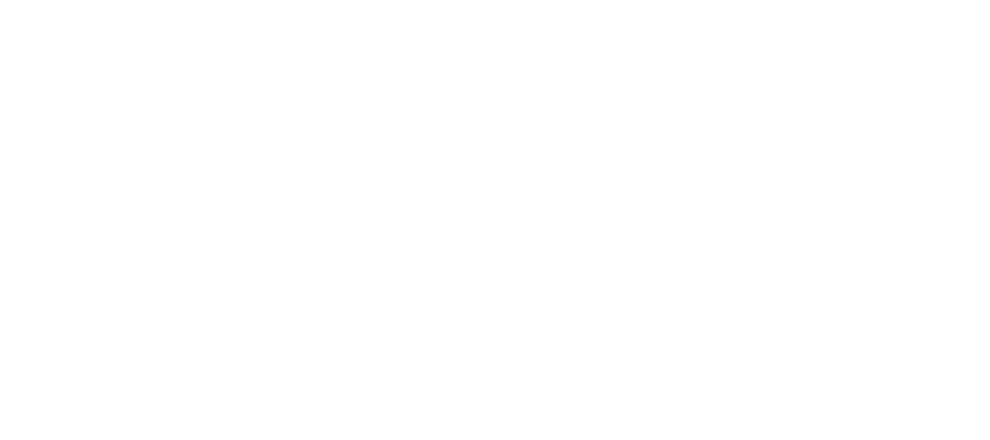

['q8'] 2021-06-13 20:25:16.208582


<IPython.core.display.Javascript object>


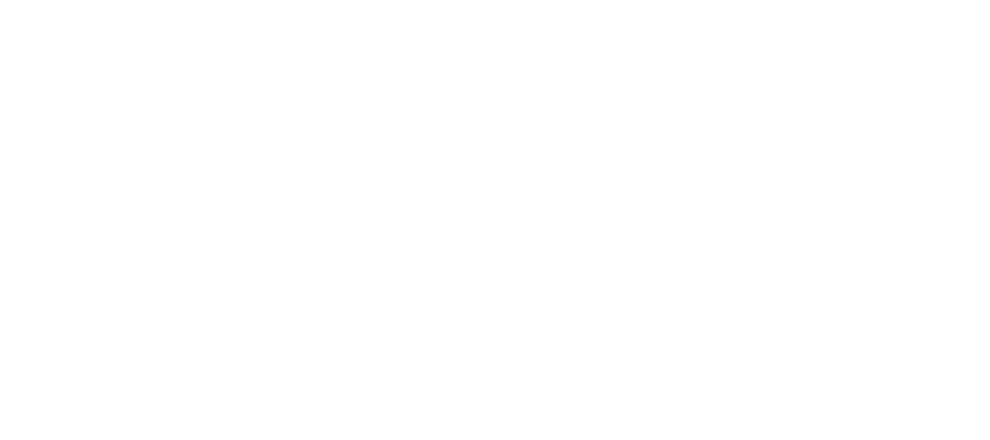

['q8'] 2021-06-13 20:14:50.887666


<IPython.core.display.Javascript object>


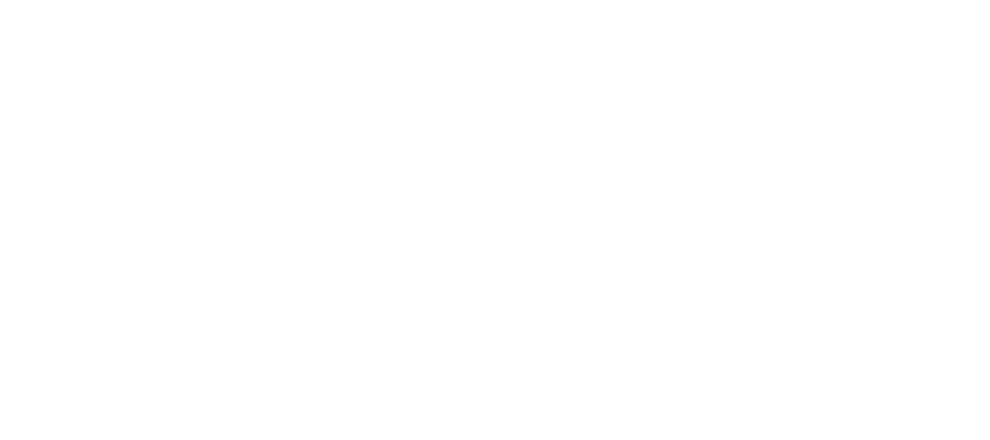

['q8'] 2021-06-13 20:04:06.175478


<IPython.core.display.Javascript object>


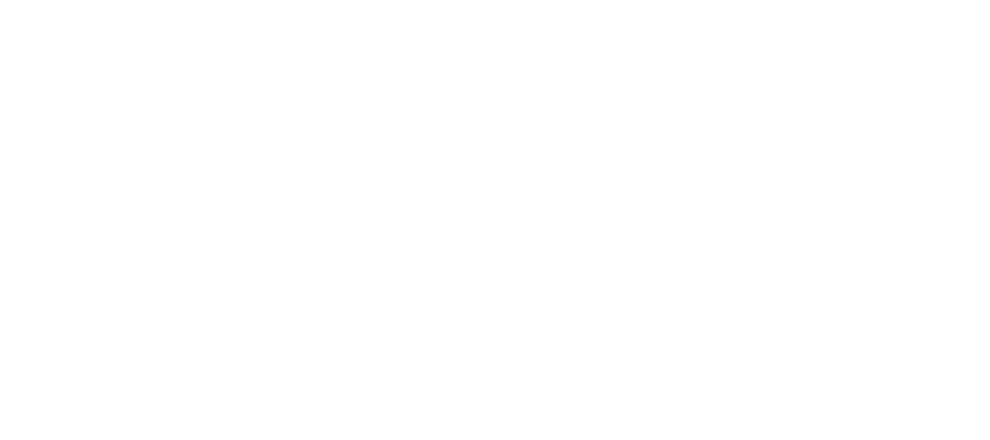

['q8'] 2021-06-13 19:53:45.327781


<IPython.core.display.Javascript object>


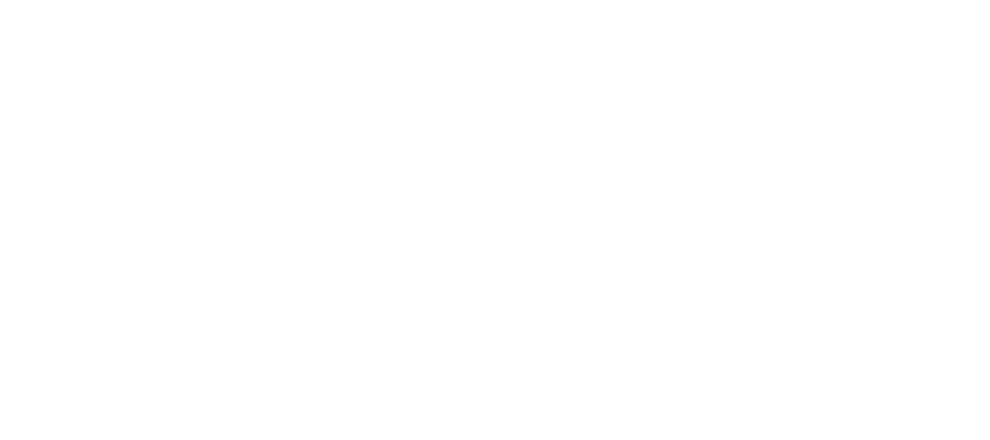

['q8'] 2021-06-13 19:42:58.124251


<IPython.core.display.Javascript object>


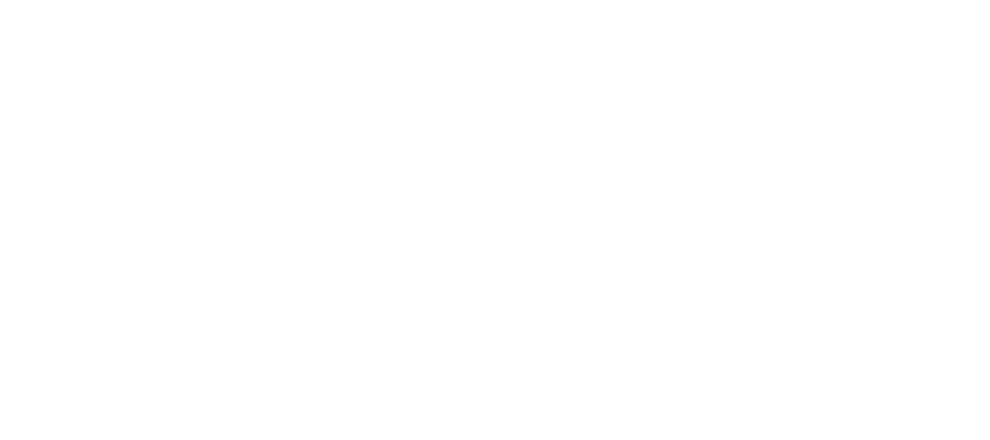

['q8'] 2021-06-13 19:32:09.609893


<IPython.core.display.Javascript object>


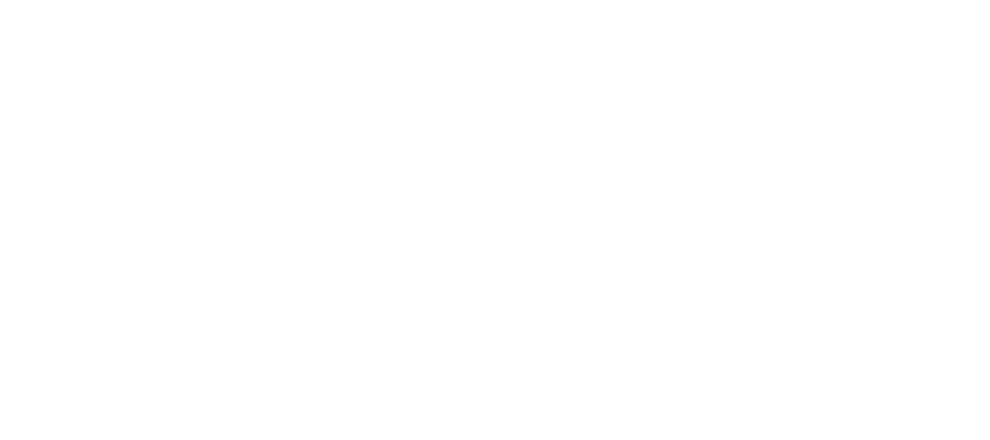

['q8'] 2021-06-13 19:21:38.524542


<IPython.core.display.Javascript object>


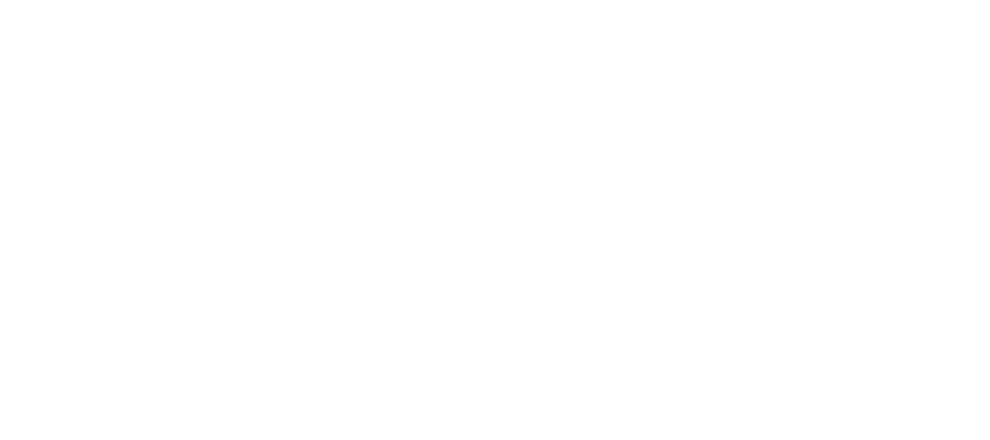

['q8'] 2021-06-13 19:11:15.671217


<IPython.core.display.Javascript object>


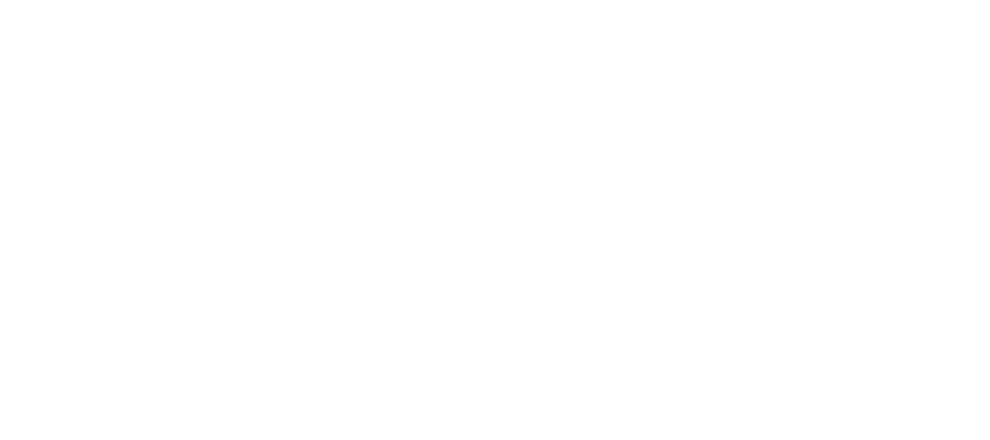

['q8'] 2021-06-13 19:00:26.773888


<IPython.core.display.Javascript object>


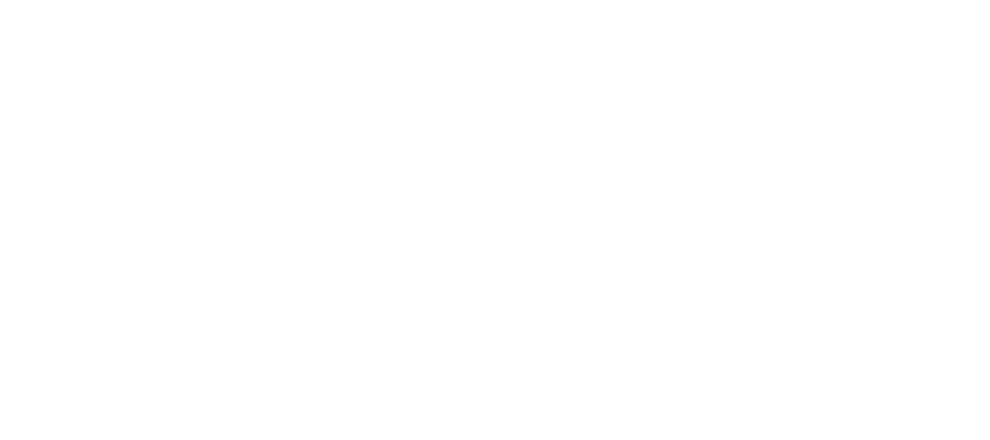

['q8'] 2021-06-13 18:49:36.896168


<IPython.core.display.Javascript object>


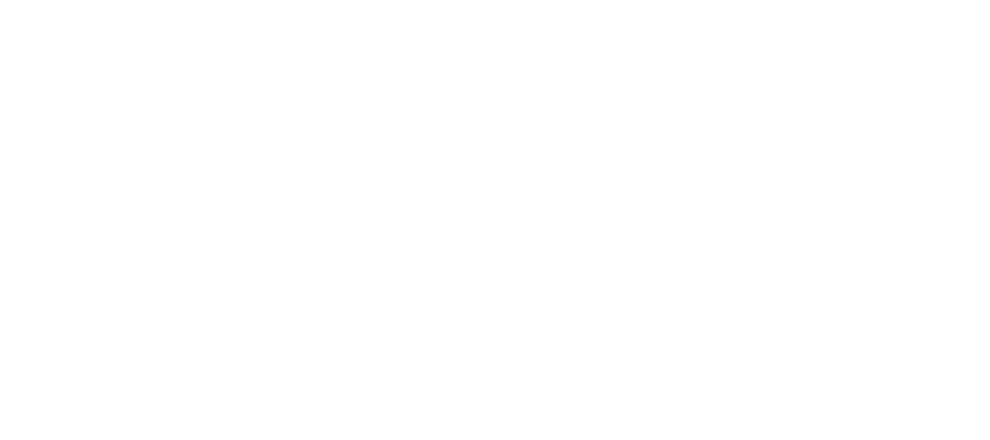

['q8'] 2021-06-13 18:39:04.603810


<IPython.core.display.Javascript object>


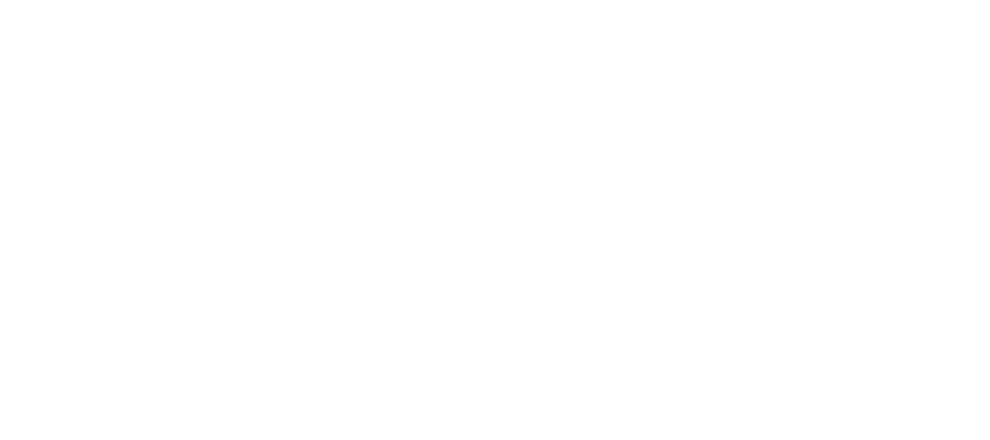

['q8'] 2021-06-13 18:28:17.728349


<IPython.core.display.Javascript object>


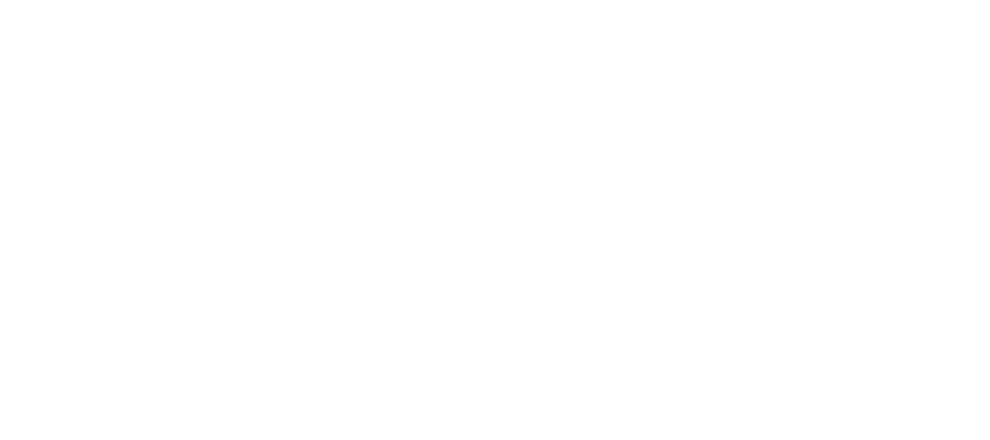

['q8'] 2021-06-13 18:17:35.766127


<IPython.core.display.Javascript object>


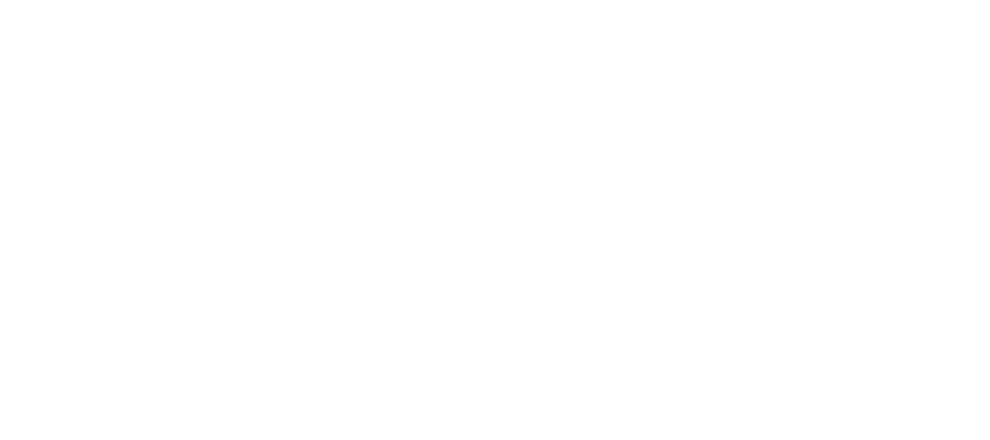

['q8'] 2021-06-13 18:06:47.526557


<IPython.core.display.Javascript object>


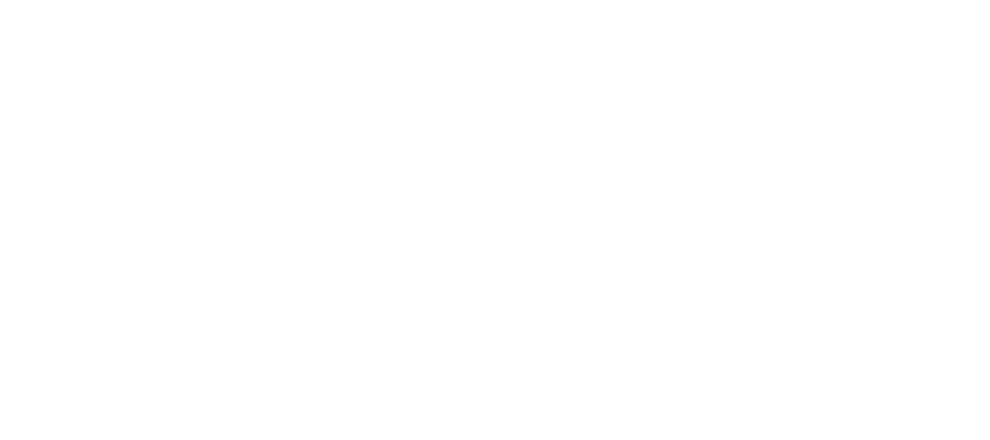

['q8'] 2021-06-13 17:56:13.217930


<IPython.core.display.Javascript object>


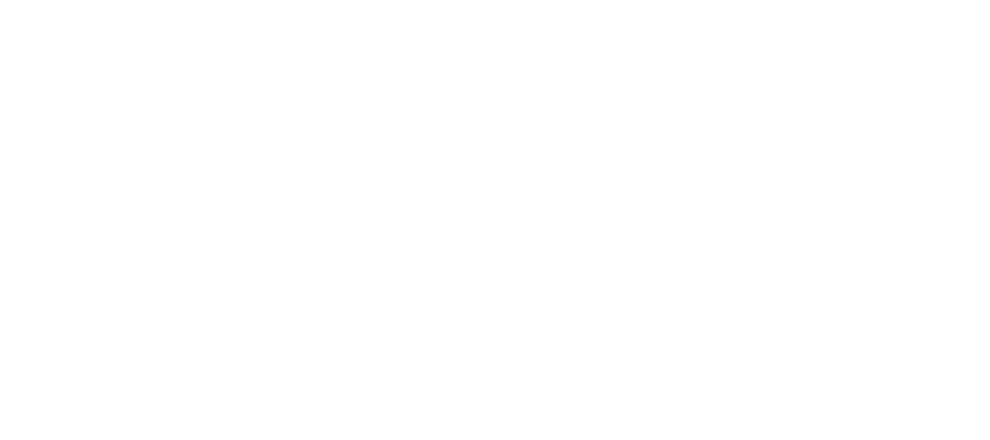

['q8'] 2021-06-13 17:45:52.569739


<IPython.core.display.Javascript object>


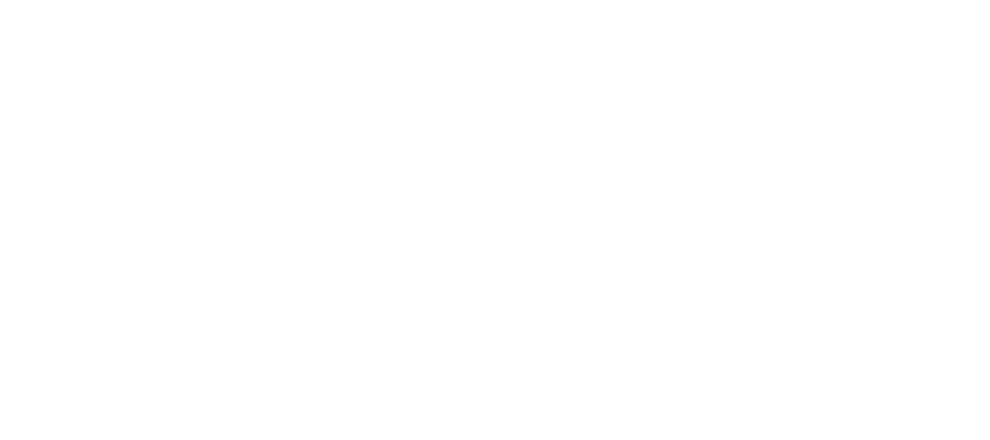

['q8'] 2021-06-13 17:35:31.788800


<IPython.core.display.Javascript object>


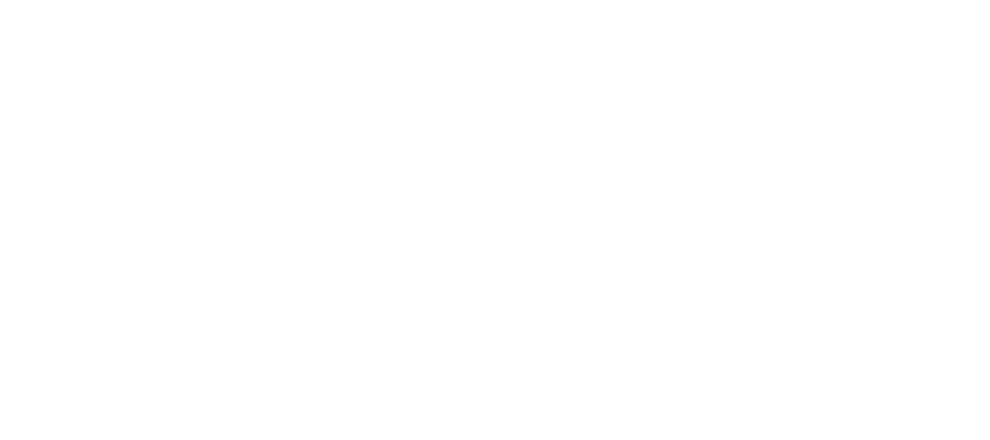

['q8'] 2021-06-13 17:25:07.607031


<IPython.core.display.Javascript object>


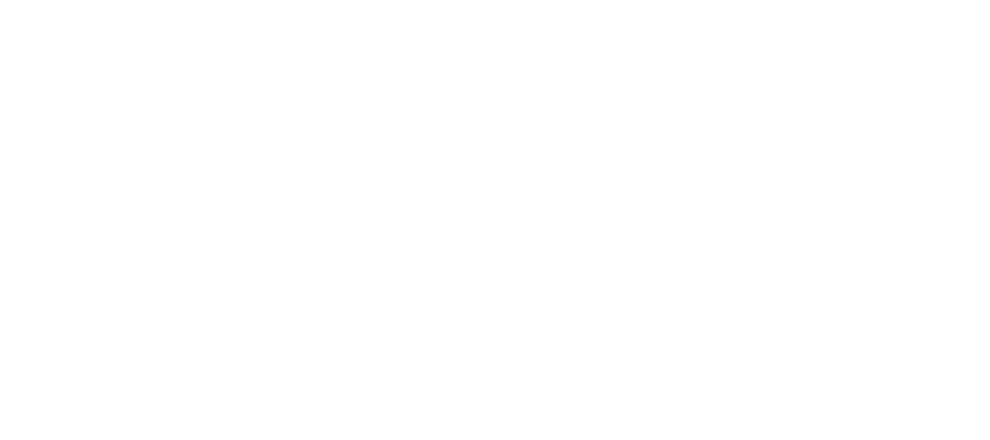

['q8'] 2021-06-13 17:14:43.397093


<IPython.core.display.Javascript object>


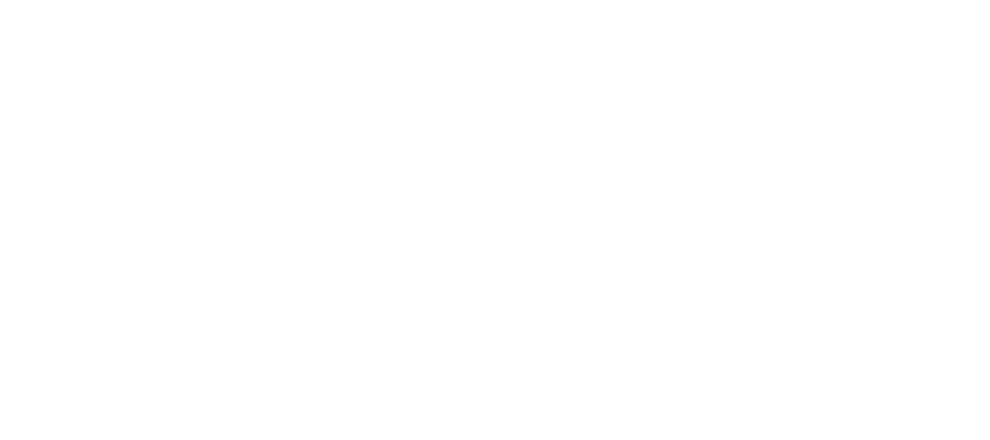

['q6'] 2021-06-13 17:01:36.302181


In [1140]:
N=list(np.arange(31))
for i,j in enumerate(N):
    value,num,tags, finishtime = write(height=4,title='rabi',which=i)
    print(tags,finishtime)
#     num = 0
#     x, y = value[num][0], value[num][1]
#     A, B, T1 = op.Exp_Fit().fitExp(x,np.abs(y))
#     z = A * np.exp(-x*T1) + B
#     fig = plt.gcf()
#     ax = plt.getp(fig,'axes')
#     ax[num].plot(x,z)
#     ax[num].set_title('$T_{1}=%.2fus$'%(1/T1/1e3))
#     ax[num].set_xlabel('time / ns')
#     ax[num].set_ylabel('Voltage / a.u.')
#     plt.show()
    s = (str(finishtime)[5]+str(finishtime)[6]+str(finishtime)[8]+str(finishtime)[9]
         +(str(finishtime))[11:13]+(str(finishtime))[14:16]+tags[0])
    plt.savefig(r'D:\notebooks\HS20200827\rabi\%s.png'%(s))
    plt.close()

In [950]:
(str(finishtime)[5]+str(finishtime)[6]+str(finishtime)[8]+str(finishtime)[9]+
 (str(finishtime))[11:13]+(str(finishtime))[14:16]+tags[0])

'06130849q9'

In [946]:
tags[0]

'q9'

In [483]:
s=(str(finishtime))[11:13]+(str(finishtime))[14:16]
plt.savefig(r'D:\notebooks\HS20200827\crosstalk\%s.png'%(s))

In [357]:
tag = ''
for i in tags:
    tag += i
save('T1',tag,base_path=r'D:\skzhao\data\ffsu\Nb10bits_2_cuqiang',row=value[0][0],col=value[0][1])

WindowsPath('D:/skzhao/data/ffsu/Nb10bits_2_cuqiang/2020/0824/T1/q6_20200824172031.npz')

In [280]:
np.savez(r'T1.npz',row=value[0][0],col=value[0][1])

In [934]:
num = 0
x, y = value[num][0], value[num][1]
A, B, T1 = op.Exp_Fit().fitExp(x,np.abs(y))
z = A * np.exp(-x*T1) + B
fig = plt.gcf()
ax = plt.getp(fig,'axes')
ax[num].plot(x,z)
ax[num].set_title('$T_{1}=%.2fus$'%(1/T1/1e3))
ax[num].set_xlabel('time / ns')
ax[num].set_ylabel('Voltage / a.u.')
plt.show()

In [218]:
np.shape(value[0])

(2, 101)

# 二维T1

<IPython.core.display.Javascript object>


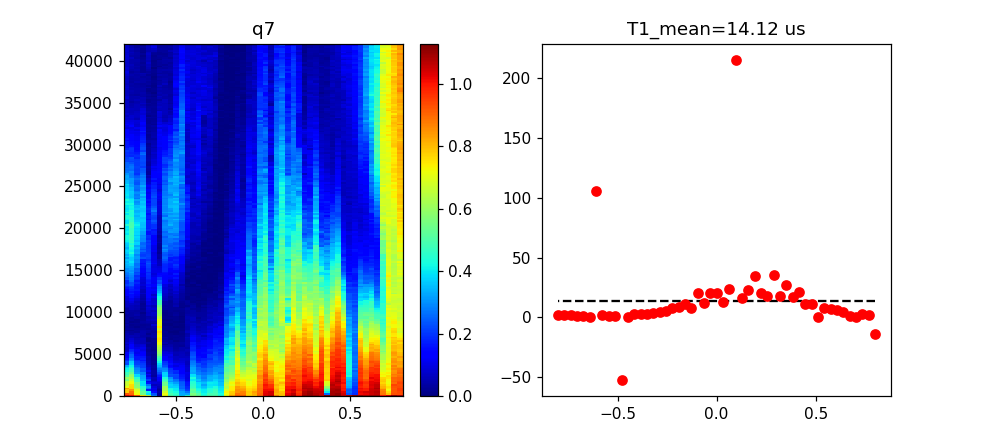

['q7'] 2021-06-09 17:24:56.678030


In [117]:
value,num,tags, finishtime = write(height=4,title='T1_2d',which=0,transposition=True)
print(tags,finishtime)

In [275]:
24/np.exp(1)

8.829106588114616

In [118]:
num = 0
x, y, s = value[num][0],value[num][1], value[num][2]
t1 = []
for i in range(len(x)):
    A, B, T1 = op.Exp_Fit().fitExp(y,np.abs(s[i]))
    t1.append(round(1/T1/1e3,2))
fig = plt.gcf()
ax = plt.getp(fig,'axes')
ax[1].plot(x,t1,'ro')
ax[1].hlines(np.mean(t1),np.max(x),np.min(x),'k','--')
ax[1].set_title('T1_mean=%.2f us'%np.mean(t1))
plt.show()

d:\qulab\qulab\zsk\optimize.py:264: RuntimeWarning: overflow encountered in exp
  return np.sum((A * np.exp(-x*T1) + B - y)**2)
d:\qulab\qulab\zsk\optimize.py:264: RuntimeWarning: overflow encountered in square
  return np.sum((A * np.exp(-x*T1) + B - y)**2)
C:\WPy64-3740\python-3.7.4.amd64\lib\site-packages\scipy\optimize\optimize.py:700: RuntimeWarning: invalid value encountered in subtract
  np.max(np.abs(fsim[0] - fsim[1:])) <= fatol):
d:\qulab\qulab\zsk\optimize.py:264: RuntimeWarning: overflow encountered in multiply
  return np.sum((A * np.exp(-x*T1) + B - y)**2)


In [908]:
value[num][0][19]

-0.19200000000000006

In [909]:
13
19

19

<IPython.core.display.Javascript object>


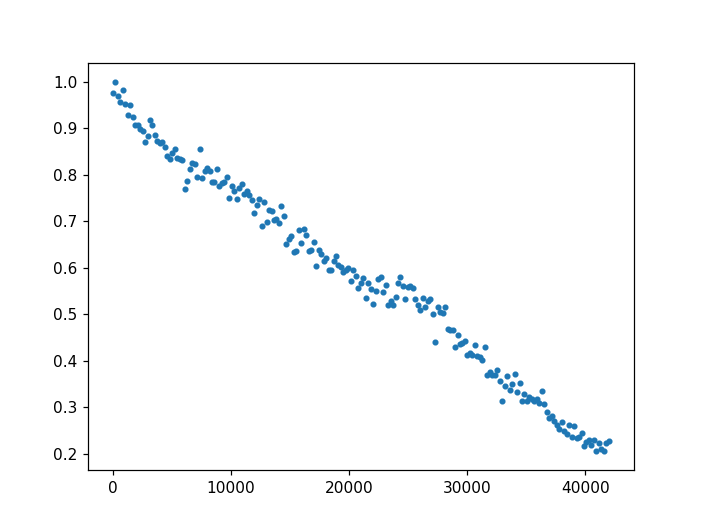

In [906]:
plt.figure()
plt.plot(value[num][1],abs(value[num][2][19,:]),'.')

<IPython.core.display.Javascript object>


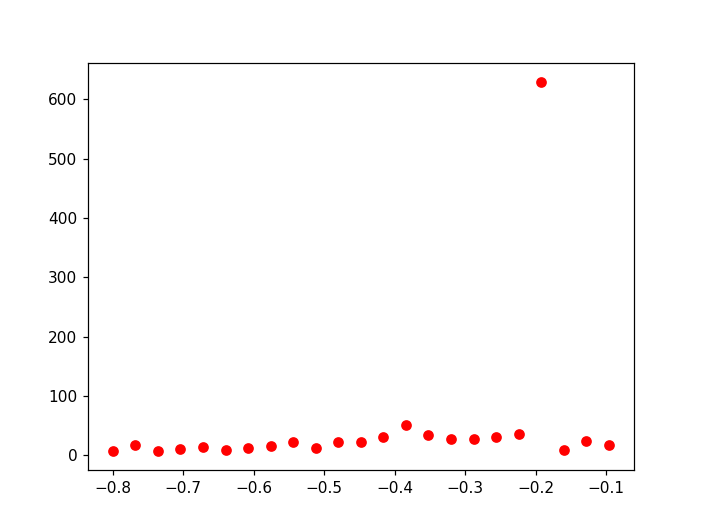

In [910]:
plt.figure()
plt.plot(x,np.abs(t1),'ro')

In [2362]:
t = np.linspace(-10,10,1001)
np.fi
# plt.figure()
# plt.plot(t,(scipy.special.erf((t-50)/1)-1)/2*0.8)

AttributeError: module 'numpy' has no attribute 'find_nearest'

In [1982]:
scipy.special.jv(0,1.94),scipy.special.jv(0,2.85)

(0.25859585990111394, -0.20510239059047372)

In [2361]:
y = lambda t: (-1-scipy.special.erf((t-4990)/2))/2*0.8
y(4990)

-0.4

In [1189]:
i=0.5
print('[qkfa]'+'[amp_overshot=%f]'%i)

[qkfa][amp_overshot=0.500000]


# 真空拉比

<IPython.core.display.Javascript object>


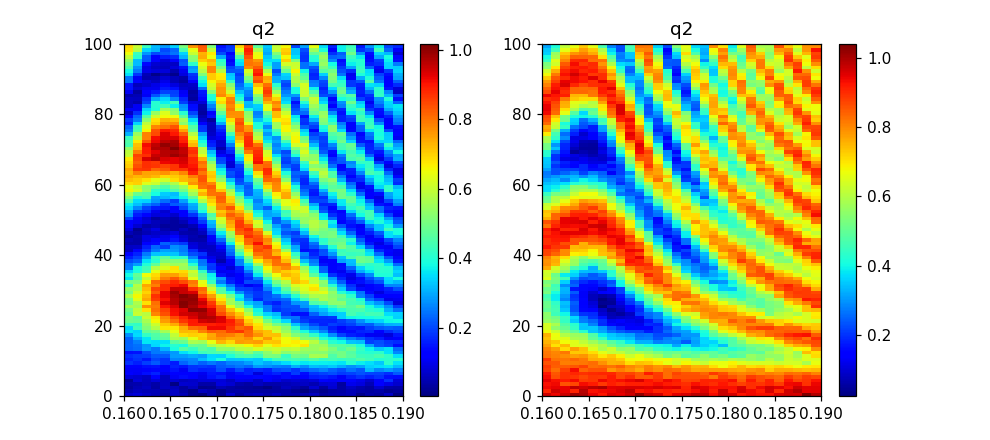

['q2', "{'q1': -0.2}"] 2021-06-27 12:07:27.765512


In [383]:
value,num,tags, finishtime = write(height=4,title='vRabi',which=0,transposition=True)
print(tags,finishtime)

In [1270]:
(np.around(np.array(ff)-4.57, decimals=3))
# np.array(ff)-4.57

array([ 0.078,  0.075,  0.073,  0.07 ,  0.068,  0.065,  0.063,  0.061,
        0.058,  0.056,  0.054,  0.051,  0.049,  0.046,  0.044,  0.042,
        0.039,  0.037,  0.035,  0.032,  0.03 ,  0.027,  0.025,  0.022,
        0.02 ,  0.018,  0.015,  0.013,  0.01 ,  0.008,  0.005,  0.003,
        0.   , -0.004, -0.005, -0.006, -0.009, -0.012, -0.015, -0.017,
       -0.02 , -0.022, -0.023, -0.024, -0.025, -0.026, -0.03 , -0.033,
       -0.037, -0.04 , -0.043, -0.045, -0.048, -0.051, -0.054, -0.057,
       -0.059, -0.062, -0.065, -0.068, -0.07 , -0.073, -0.076, -0.078,
       -0.081, -0.084, -0.087, -0.089, -0.092])

In [1286]:
(np.array(ff[26:-30])-4.57)

array([ 1.500000e-02,  1.300000e-02,  1.000000e-02,  8.000000e-03,
        5.000000e-03,  3.000000e-03,  1.234568e-13, -4.000000e-03,
       -5.000000e-03, -6.000000e-03, -9.000000e-03, -1.200000e-02,
       -1.500000e-02])

In [1279]:
len(x-0.566)

13

<IPython.core.display.Javascript object>


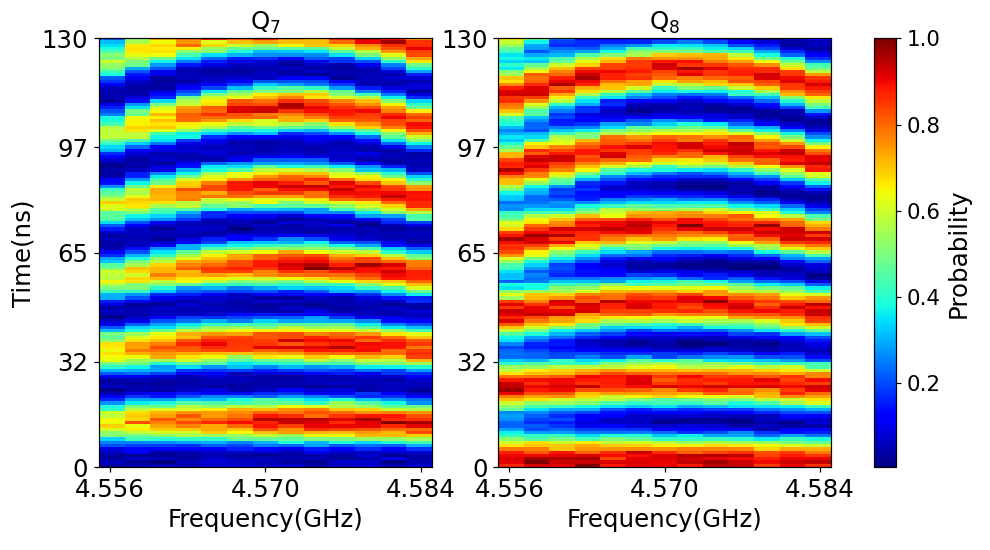

Text(0, 0.5, 'Time(ns)')

In [1632]:
fig, axes = plt.subplots(ncols=2,nrows=1,figsize=(9,5))
fig.subplots_adjust(left=0.1,right=0.97,top=0.93,bottom=0.15,hspace=2)
# plt.subplots_adjust(left=0.1, right=0.9, top=0.9, bottom=0.1)
fontsize = 16
axes[0].set_title('Q$_7$',fontsize=16)
axes[1].set_title('Q$_8$',fontsize=16)
axes[0].set_xlabel('Frequency(GHz)',fontsize=16)
axes[1].set_xlabel('Frequency(GHz)',fontsize=16)
axes[0].tick_params(labelsize=16)
axes[1].tick_params(labelsize=16)
axes[0].set_ylabel('Time(ns)',fontsize=16)

In [1635]:
plt.savefig(r'D:\skzhao\fig\swap.pdf',dpi=1200)

In [1633]:
num, ax_num = 0,0
cmap = 'jet'
x, y, s = value[num][0][27:-53-8], value[num][1][:], value[num][2][27:-53-8,:]
s = np.abs(s)/np.max(np.abs(s))
x = (np.array(ff[26:-30]))
extent = [min(x),max(x),min(y),max(y)]
cbmin, cbmax = np.min(np.abs(s)), np.max(np.abs(s))
xmin, xmax = np.min(x), np.max(x)
ymin, ymax = np.min(y), np.max(y)
im1 = axes[ax_num].imshow(np.abs(s).T,origin='lower',aspect='auto',cmap=cmap,extent=extent)
# cb = plt.colorbar(im,ax=axes[ax_num],ticks=np.linspace(cbmin,cbmax,6,dtype=int))
# cb.ax.tick_params(labelsize=fontsize) 
axes[ax_num].tick_params(labelsize=fontsize)
# axes[ax_num].set_xticks(np.around(np.linspace(xmin,xmax,3), decimals=3))
axes[ax_num].set_xticks(np.around([4.556,4.570,4.584], decimals=3))
axes[ax_num].set_yticks(np.linspace(ymin,ymax,5,dtype=int))

num, ax_num = 1,1
x, y, s = value[num][0][27:-53-8], value[num][1][:], value[num][2][27:-53-8,:]
s = np.abs(s)/np.max(np.abs(s))
x = (np.array(ff[26:-30]))
extent = [min(x),max(x),min(y),max(y)]
cbmin, cbmax = np.min(np.abs(s)), np.max(np.abs(s))
xmin, xmax = np.min(x), np.max(x)
ymin, ymax = np.min(y), np.max(y)
im1 = axes[ax_num].imshow(np.abs(s).T,origin='lower',aspect='auto',cmap=cmap,extent=extent)
# cb = plt.colorbar(im,ax=axes[ax_num],ticks=np.linspace(cbmin,cbmax,6,dtype=int))
# cb.ax.tick_params(labelsize=fontsize) 
axes[ax_num].tick_params(labelsize=fontsize)
# axes[ax_num].set_xticks(np.around(np.linspace(xmin,xmax,3), decimals=3))
axes[ax_num].set_xticks(np.around([4.556,4.570,4.584], decimals=3))
axes[ax_num].set_yticks(np.linspace(ymin,ymax,5,dtype=int))
cb = fig.colorbar(im1, ax=axes, orientation='vertical', fraction=.1)


In [1634]:
cb.ax.tick_params(labelsize=14)
cb.set_label('Probability',size=16)
# plt.legend(['A'])
# cb.set_label('colorbar',size=16)

In [470]:
axes[0].set_ylabel('$time/ns$',fontsize=fontsize)
axes[0].set_xlabel('$voltage/a.u.$',fontsize=fontsize)
axes[1].set_xlabel('$voltage/a.u.$',fontsize=fontsize)
plt.tight_layout()

In [471]:
plt.savefig(r'D:\skzhao\fig\nextneibor.pdf',dpi=1200)

In [861]:
np.shape(value[num][2])

(61, 101)

<IPython.core.display.Javascript object>


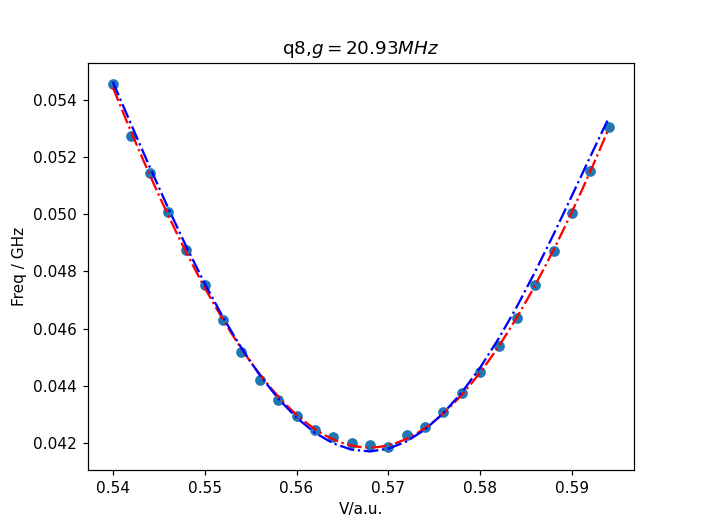

In [1608]:
num = 0
sta_d = 20
end_d = -53
x, y, s = value[num][0][sta_d:end_d],value[num][1],np.abs(value[num][2][sta_d:end_d,:])
w = []
phi = None
for j,i in enumerate(range(len(x))):
    y0 = op.RowToRipe().smooth(s[i,:],f0=0.2)
    res, f = op.Cos_Fit(phi=phi).fitCos(y,y0)
    A, C, W, phi = res.x

    w.append(np.abs(W))
plt.figure()
plt.plot(x,np.array(w),'o')

In [1858]:
t_T1 = np.linspace(0,60000,301,endpoint=True)
t_max = 43000
delay = np.array([0]*len(t_T1))
for i,j in enumerate (t_T1):
    if j>t_max:
        t_T1[i]=t_max
        delay[i]=j-t_max

<IPython.core.display.Javascript object>


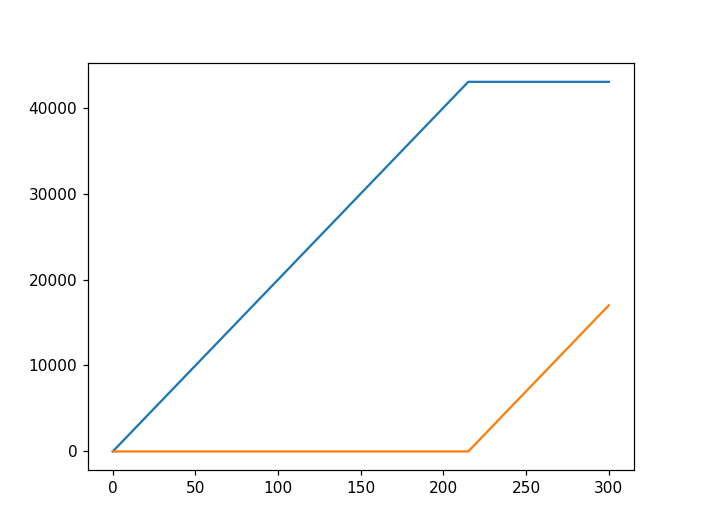

In [1860]:
plt.figure()
plt.plot(t_T1)
plt.plot(delay)

In [1609]:
x, y = x[:],np.array(w)[:]
y0 = op.RowToRipe().smooth(y,f0=0.1)
ret, func = op.Vcrabi_fit(length=7).fitVcrabi(x,y)
g, A0, Z0 = ret.x
print(ret.x)
xnew = np.linspace(min(x),max(x),1001)
z = func(xnew,ret.x)
# res, func = op.Exp_Fit().poly(x,y,2)
# z = func(x)
fig = plt.gcf()
ax = plt.getp(fig,'axes')
ax[0].plot(xnew,z,'r-.',markersize=2)
ax[0].plot(x,y0,'b-.',markersize=2)
ax[0].set_title('%s,$g=%.2fMHz$'%(tags[0],g*1e3))
ax[0].set_xlabel('V/a.u.')
ax[0].set_ylabel('Freq / GHz')
plt.show()

[0.0209278  1.24634539 0.56791921]


<IPython.core.display.Javascript object>


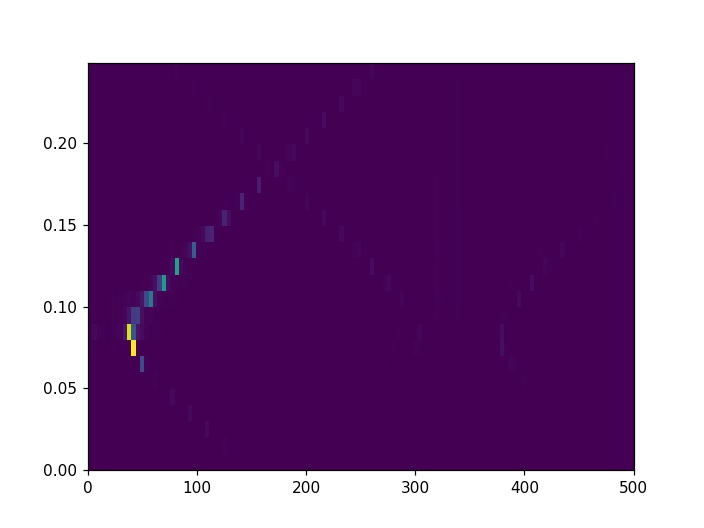

In [1469]:
# x, y, s = value[1][0],value[1][1], value[1][2]
x, y, s = f, y, P
plt.figure()
extent = [min(y),max(y),min(x),max(x)]
plt.imshow(np.abs(P),aspect='auto',origin='lower',extent=extent)
plt.show()

In [1243]:
g, A0, Z0

(0.014690901026867983, 3.024436291178022, 0.040463763699795124)

# 纵场调制

In [391]:
save('q3main_q4_bessel',tags,base_path=r'D:\skzhao\Vmodulation',value=value)

WindowsPath('D:/skzhao/Vmodulation/2021/0129/q3_lRabi_20210129161904.npz')

<IPython.core.display.Javascript object>


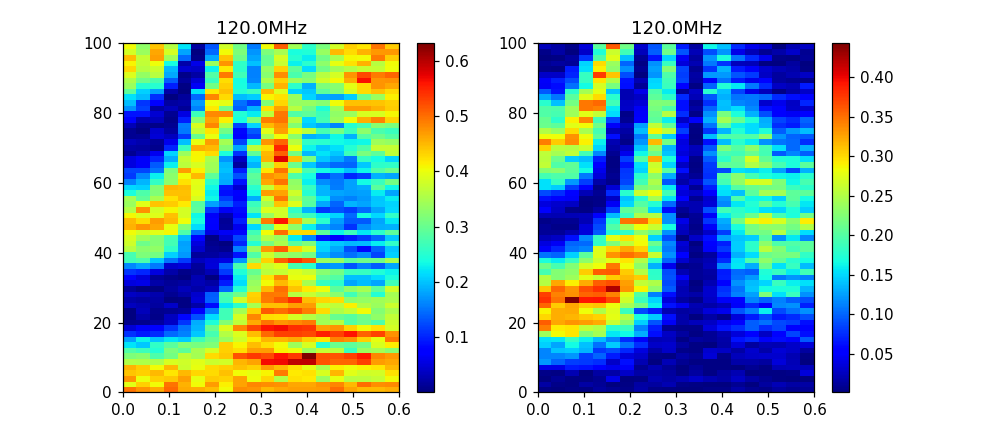

['120.0MHz', 'dc-q1', 'ex-q1'] 2020-12-09 21:29:54.675005


In [88]:
value,num,tags, finishtime = write(height=4,title='vModulation_pop',which=80,transposition=True)
print(tags,finishtime)

In [1198]:
1.3*0.12/0.9

0.17333333333333334

<IPython.core.display.Javascript object>


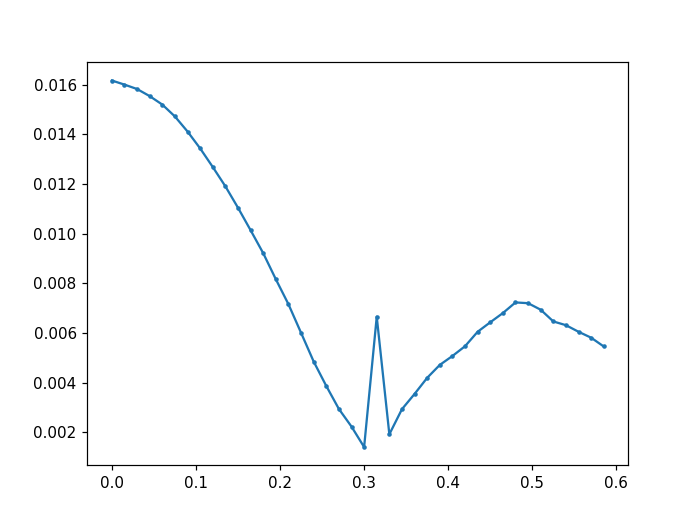

In [216]:
num = 0
x, y, s = value[num][0][:],value[num][1],np.abs(value[num][2][:,:])
w = []
phi = np.pi/2 if num == 1 else 0
for j,i in enumerate(range(len(x))):
    y0 = op.RowToRipe().smooth(s[i,:],f0=0.2)
    res, f = op.Cos_Fit(phi=phi).fitCos(y,y0)
    A, C, W, phi = res.x
#     plt.figure()
#     plt.plot(y,np.abs(s[i,:]),'o')
#     plt.plot(y,f(y,res.x),'-')
#     plt.savefig(r'\\QND-SERVER2\skzhao\fig\%s.png'%(f'{j}'))
#     plt.close()
    W = 0 if W > 0.025 else W
    w.append(np.abs(W))
plt.figure()
plt.plot(x,w,'-o',markersize=2)

(0.9161142857142857, 10.732820396216392)


<IPython.core.display.Javascript object>


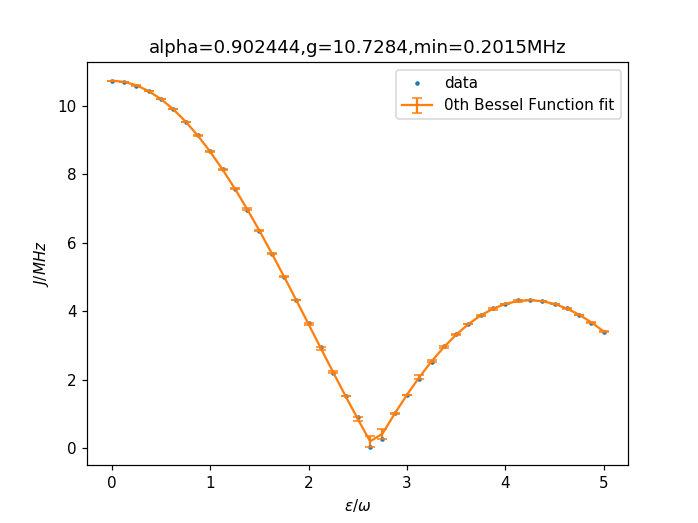

0.315


In [387]:
from scipy import special
wnew = np.array(w)*1e3/2
xnew = x/0.12
xplot = np.linspace(min(xnew),max(xnew),len(xnew))
res,funcbessel = op.Bessel_fit().fitBessel(xnew,wnew)
alpha, g = res.x
plt.figure()
plt.plot(xnew,wnew,'o',markersize=2,label='data')
# plt.plot(xplot,funcbessel(xplot,res.x),label='0th Bessel Function fit')
plt.errorbar(xplot,funcbessel(xplot,res.x),yerr=res.fun,label='0th Bessel Function fit',ms=3,mfc='r',mec='r',capsize=3)
plt.title(f'alpha={round(alpha,6)},g={round(g,4)},min={round(min(funcbessel(xplot,res.x)),4)}MHz')
print(xplot[np.argmin(funcbessel(xplot,res.x))]*0.12)
plt.xlabel('$\epsilon/\omega$')
plt.ylabel('$J/MHz$')
plt.legend(loc='best')

In [107]:
0.23/0.12

1.9166666666666667

In [194]:
x = np.array([i*0.04 for i in range(16)])
x/0.12*0.91

array([0.        , 0.30333333, 0.60666667, 0.91      , 1.21333333,
       1.51666667, 1.82      , 2.12333333, 2.42666667, 2.73      ,
       3.03333333, 3.33666667, 3.64      , 3.94333333, 4.24666667,
       4.55      ])

In [388]:
save('q1main_q2_bessel_fit',tags,base_path=r'D:\skzhao\Vmodulation',data=[xnew,wnew],fit=[xplot,funcbessel(xplot,res.x)],error=res.fun)

WindowsPath('D:/skzhao/Vmodulation/2021/0209/q1main_q2_bessel_fit_20210209213245.npz')

In [82]:
q = q10
q.bessel = [alpha, g,xplot[np.argmin(funcbessel(xplot,res.x))]*0.12]

In [50]:
q3.bessel

[0.9318638519821782, 10.782881997694384, 0.001763]

<IPython.core.display.Javascript object>


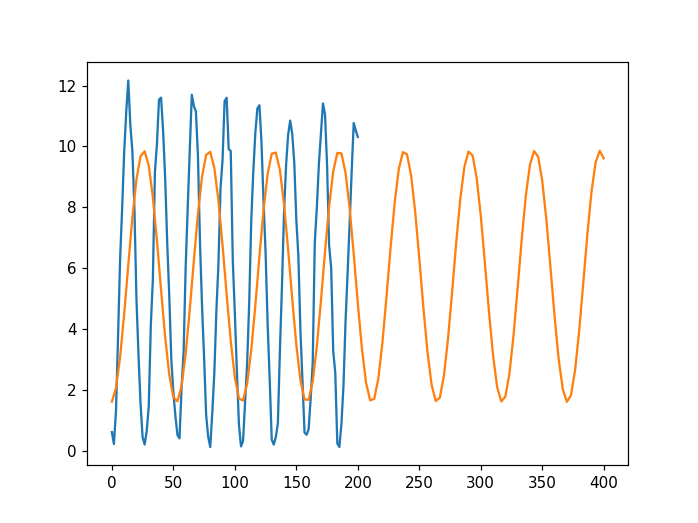

In [606]:
plt.figure()
num = 0
# plt.plot(value[0][1],np.abs(value[0][2][0,:]))
plt.plot(value[num][1],np.abs(value[num][2][1,:]))
y0 = op.RowToRipe().smooth(np.abs(value[num][2][1,:]),f0=0.15)
res, f = op.Cos_Fit().fitCos(value[num][1],y0)
plt.plot(y,f(value[num][1],res.x),'-')
# plt.plot(value[0][1],np.abs(value[0][2][2,:]))

<IPython.core.display.Javascript object>


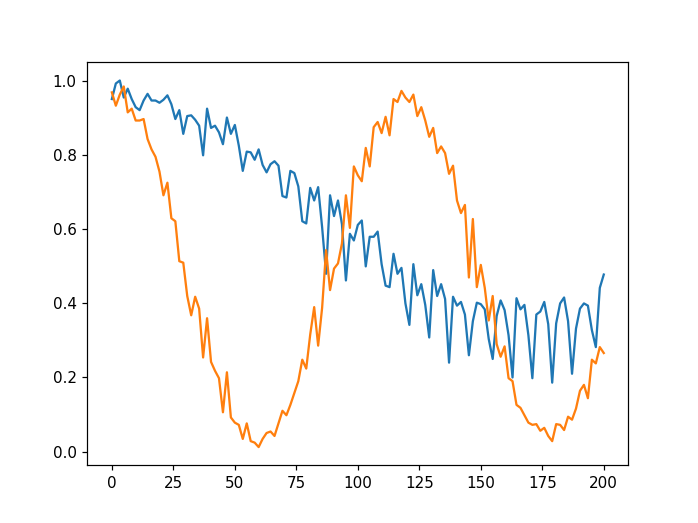

In [1387]:
plt.figure()
plt.plot(value[0][1],np.abs(value[0][2][0,:]))
plt.plot(value[0][1],np.abs(value[0][2][-1,:]))

(32, 7600)


<IPython.core.display.Javascript object>


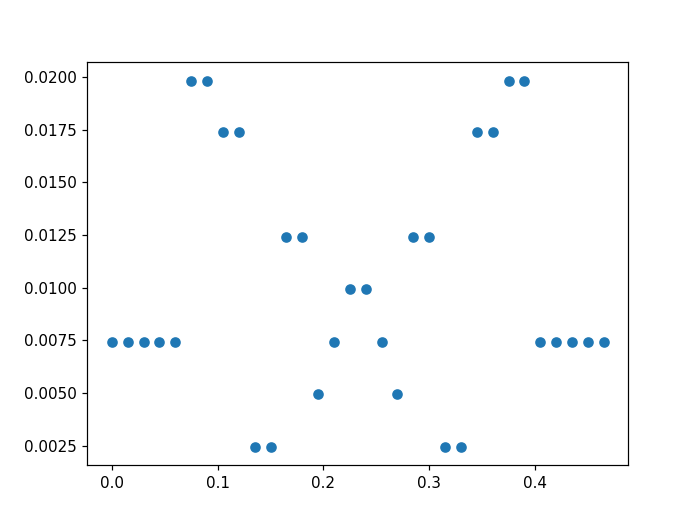

In [269]:
x, y, s = value[1][0][0:],value[1][1][:], value[1][2][0:,:]
# y, s = y, op.RowToRipe().extension(s,0,30,100)
w, f, P = op.RowToRipe().fourier(y,s,axis=1,shift=False)
plt.figure()
plt.plot(x,np.array(w),'o')
# plt.imshow(np.abs(P),aspect='auto')
# plt.plot(x,op.RowToRipe().smooth(w,0.3))

In [559]:
q1.volt
q.offset

-0.0308442

<IPython.core.display.Javascript object>


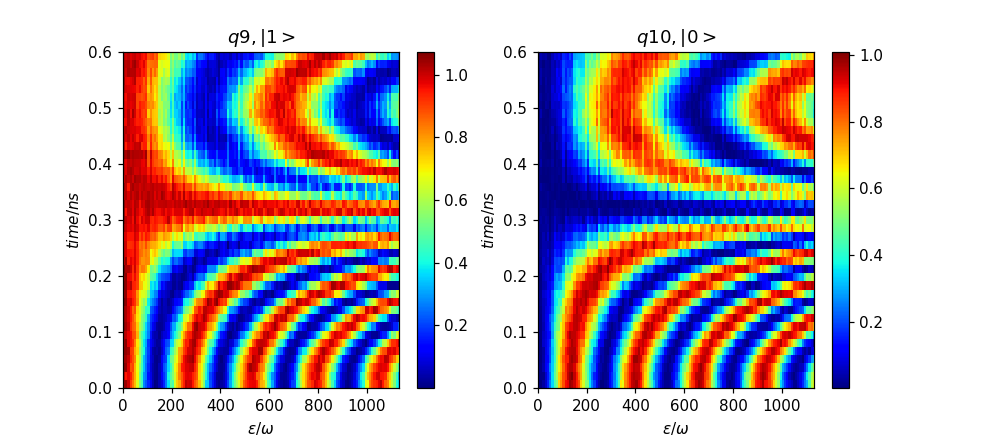

In [434]:
fig, axes = plt.subplots(ncols=2,nrows=1,figsize=(9,4))
im = []
for i in range(2):
    x, y, s = value[i][0],value[i][1],np.abs(value[i][2])
    extent = [min(y)*0.68/0.12,max(y)*0.68/0.12,min(x),max(x)]
    im0 = axes[i].imshow(s,extent=extent,aspect='auto',origin='lower',cmap='jet',label=f'modulation freq={120}MHz')
    im.append(im0)
    axes[i].set_xlabel('$\epsilon/\omega$')
    axes[i].set_ylabel('$time/ns$')
    axes[i].set_title(f'$q{i+9},|{1-i}>$')
plt.colorbar(im[0],ax=axes[0])
plt.colorbar(im[1],ax=axes[1])
#     axes[i].legend(loc='best')
plt.show()

In [108]:
from scipy import special
w = np.array(w)
ynew = y[:-20]*0.68/0.12
plt.figure()
plt.plot(ynew,w*1e3/2,'o',markersize=2,label='data')
plt.plot(ynew,w[0]*1e3/2*np.abs(special.jv(0,ynew)),label='0th Bessel Function')
plt.xlabel('$\epsilon/\omega$')
plt.ylabel('$J/MHz$')
plt.legend(loc='best')

NameError: name 'w' is not defined

In [571]:
special.jv(0,2.4048)

1.3268284301268604e-05

In [728]:
2.85*0.12/0.902982

0.3787450912642777

<IPython.core.display.Javascript object>


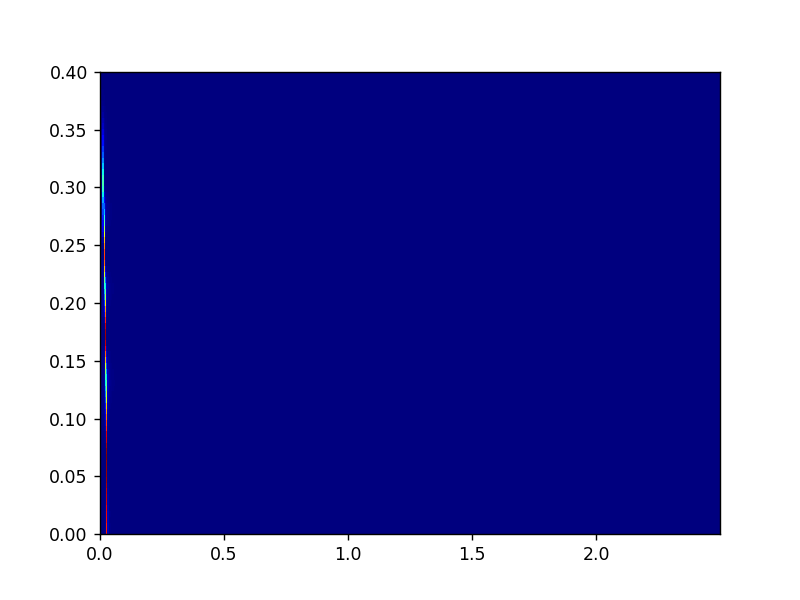

In [678]:
w,f,Pxx = op.RowToRipe().spectrum(xnew,ybar,axis=0,shift=False)
plt.figure()
extent = [min(f),max(f),min(y),max(y)]
plt.imshow(np.abs(Pxx).T,aspect='auto',extent=extent,origin='lower',cmap='jet')

In [618]:
np.max(Pxx),np.mean(Pxx)

(17.72216957428018, 0.0025766969748642833)

<IPython.core.display.Javascript object>


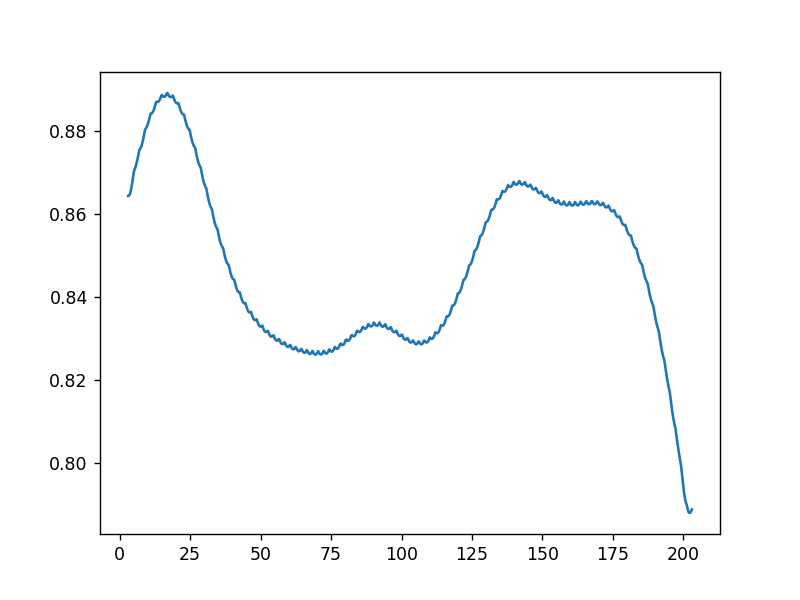

In [716]:
plt.figure()
# x, y = value[0][0],np.abs(value[0][2][:,-20])
# xnew, ynew = op.RowToRipe().resample(x,y,1001)
# ybar = op.RowToRipe().smooth(y,f0=0.1)
plt.plot(xnew,ynew)
# plt.plot(xnew,ynew)
# plt.plot(x,ybar)

<IPython.core.display.Javascript object>


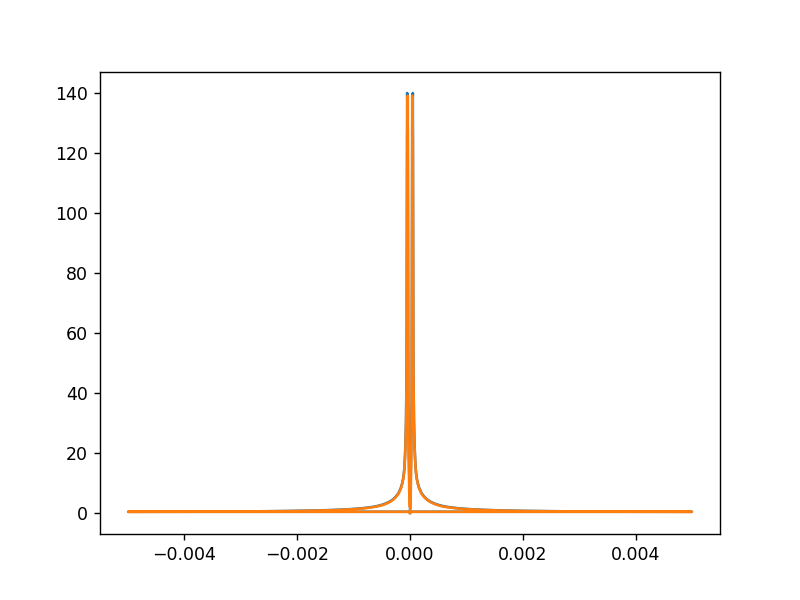

In [688]:
# x, y ,s = value[0][0],value[0][1], np.abs(value[1][2])
w,f1,Pxx1 = op.RowToRipe().fourier(xnew,ybar[:,26],axis=0,shift=False)
w2,f2,Pxx2 = op.RowToRipe().fourier(xnew,ybar[:,27],axis=0,shift=False)
plt.figure()
# plt.plot(y,w*1e3/2,'-o')
plt.plot(f1,np.abs(Pxx1))
plt.plot(f2,np.abs(Pxx2))

<IPython.core.display.Javascript object>


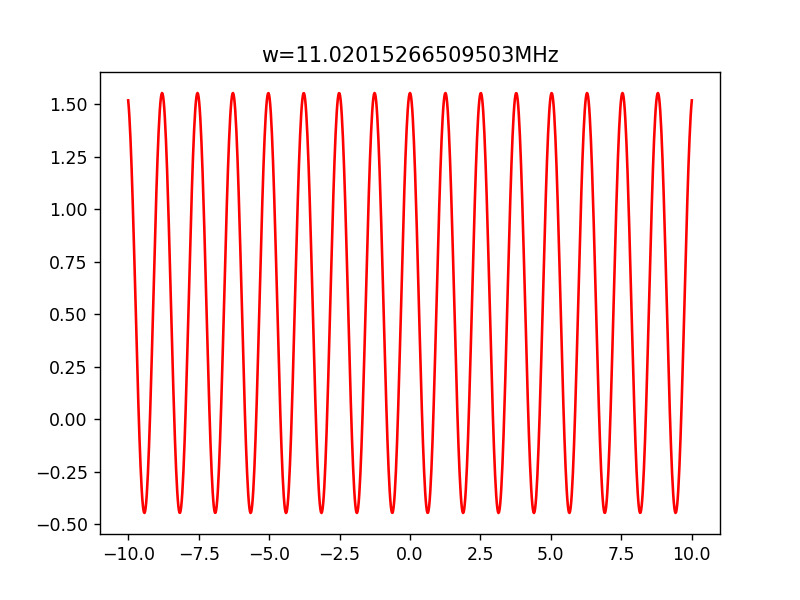

Text(0.5, 1.0, 'w=11.02015266509503MHz')

In [797]:
# x, y = xnew,ybar[:,0]
# A, C, W, phi = op.Cos_Fit().fitCos(x,y)
# y1 = A*np.cos(2*np.pi*W*x+phi)
x = np.linspace(-10,10,1001)
y1 = np.cos(5*x)
plt.figure()
plt.plot(x,y1+C,'r-')
# plt.plot(x,y)
plt.title(f'w={W*1e3}MHz')

<IPython.core.display.Javascript object>


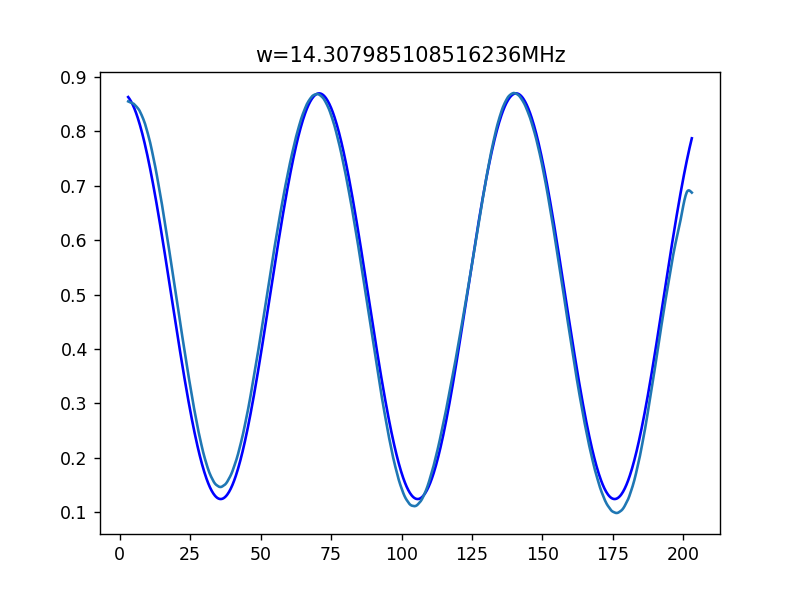

Text(0.5, 1.0, 'w=14.307985108516236MHz')

In [654]:
x, y = xnew,ybar[:,-30]
A, C, W, phi = op.Cos_Fit().fitCos(x,y)
y1 = A*np.cos(2*np.pi*W*x+phi)
plt.figure()
plt.plot(x,y1+C,'b-')
plt.plot(x,y)
plt.title(f'w={W*1e3}MHz')

In [684]:
w

0.003996003996003996

<IPython.core.display.Javascript object>


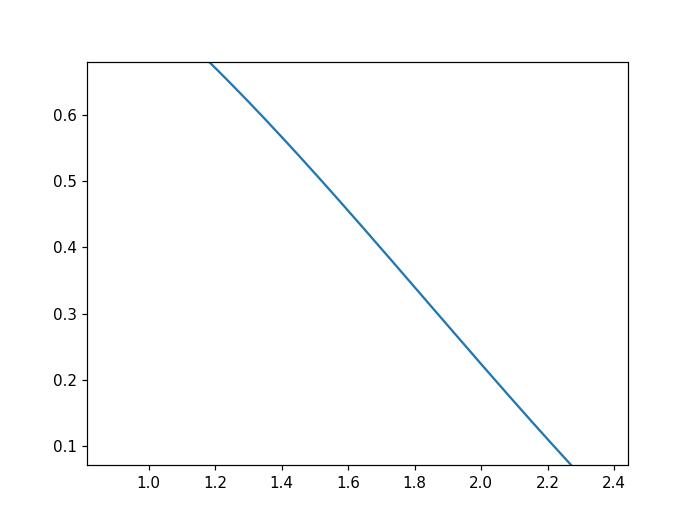

In [109]:
from scipy import special
plt.figure()
x = np.linspace(0,10,1001)
plt.plot(x,np.abs(special.jv(0,x)))

In [110]:
0.23*0.91/0.12

1.7441666666666669

In [111]:
90/0.37

243.24324324324326

# 拟合Rabi

<IPython.core.display.Javascript object>


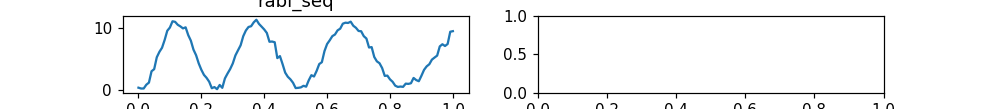

['q9'] 2021-03-03 21:51:29.065202


In [69]:
value,num,tags,finishtime = write(height=1,title='rabi_seq',which=10)
print(tags,finishtime)

In [267]:
np.savez(r'rabi.npz',rows=value[0][0],s=value[0][1])

<IPython.core.display.Javascript object>


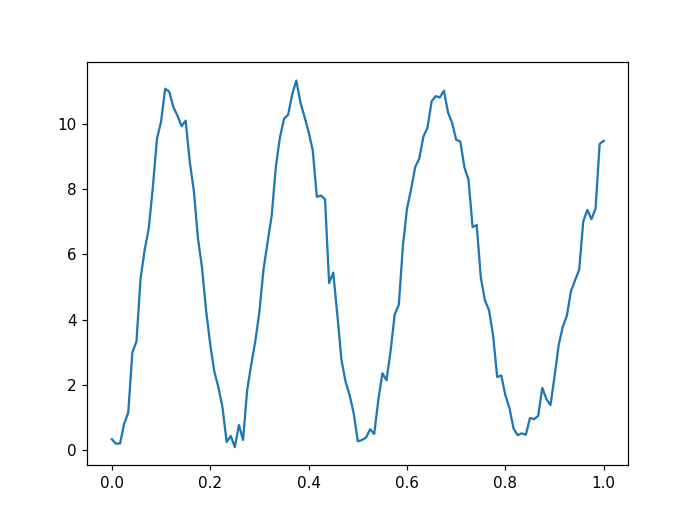

In [74]:
plt.figure()
plt.plot(value[0][0],np.abs(value[0][1]))

In [774]:
fig = plt.gcf()
ax = plt.getp(fig,'axes')
for i in range(num):
    x, y  = value[i][0], value[i][1]
    A,B,T1,w,phi,out = op.Rabi_Fit(envelopemethod='hilbert',phi=0,T1=60000).fitRabi(np.abs(x),np.abs(y))
    z = A*np.exp(-x/T1)*np.cos(2*np.pi*w*x+phi) + B
#     env = out[0]*np.exp(-x/out[2]) + out[1]
    env = A*np.exp(-x/T1) + B
    sample = (np.max(x) - np.min(x))/(len(x) - 1)
    yt  = np.fft.fftshift(np.fft.fftfreq(len(y))) / sample
    amp = np.fft.fftshift(np.fft.fft(y))
    ax[i].plot(x,z)
#     ax[i].plot(x,out[3])
    ax[i].plot(x,env)
    ax[i].set_title('$T_{1}=%fns,period=%fns$'%(T1,1/w/2))
    ax[i].set_xlabel('time / ns')
    ax[i].set_ylabel('Voltage / a.u.')
    ax[1].plot(yt[yt!=0],np.abs(amp[yt!=0]))
    ax[1].set_title('$W=%.3f$'%(np.abs(yt[yt!=0][np.argmax(np.abs(amp[yt!=0]))])))
plt.show()

(11.609983204322628, 12.625878980025979, 60000, 1.9801980198019802, 0)
(1.8532362564721678, 14.452023796739262, 60000, 1.9801980198019802, 0)
(0.5032659764838676, 0.5211813356445554, 60000, 1.9801980198019802, 0)
(0.5038278841927994, 0.41063629938132473, 60000, 49.504950495049506, 0)
(0.31816557051402894, 0.3778075503191889, 60000, 1.9801980198019802, 0)
(0.6250382121787701, 0.5559551833490668, 60000, 49.504950495049506, 0)
(0.40181317082909285, 0.4201365790313722, 60000, 1.9801980198019802, 0)
(0.4911072459555608, 0.7352107908654045, 60000, 49.504950495049506, 0)
(0.607560490379137, 0.5408191460153239, 60000, 1.9801980198019802, 0)
(0.8294820660776243, 0.9668870909210471, 60000, 1.9801980198019802, 0)


In [347]:
tag = ''
for i in tags:
    tag += i
save('Rabi',tag,base_path=r'D:\skzhao\data\ffsu\Nb10bits_2_cuqiang',row=value[0][0],col=value[0][1])

WindowsPath('D:/skzhao/data/ffsu/Nb10bits_2_cuqiang/2020/0824/Rabi/q6_20200824171712.npz')

# 拟合Ramsey及SpinEcho

<IPython.core.display.Javascript object>


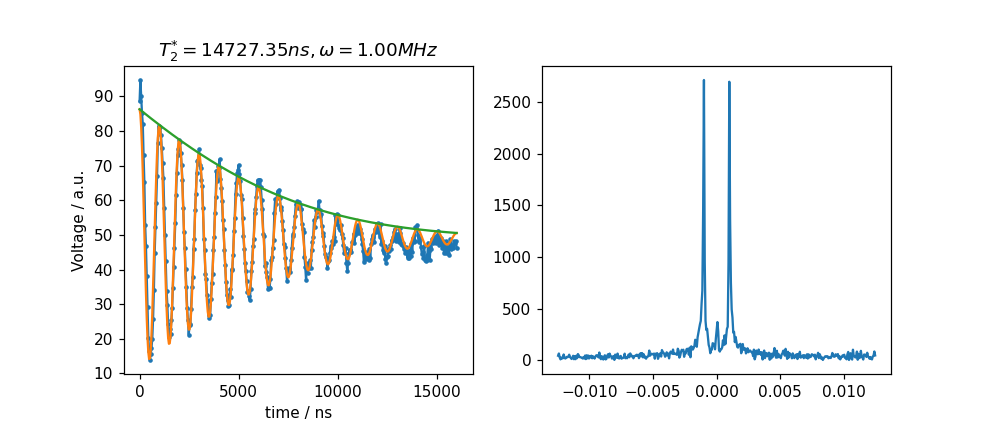

['q4'] 2021-06-13 16:39:20.384724


In [1073]:
value,num,tags,finishtime = write(height=4,title='SpinEcho',which=0)
print(tags,finishtime)

In [282]:
np.savez(r'spinecho.npz',rows=value[0][0],s=value[0][1])

In [351]:
tag = ''
for i in tags:
    tag += i
save('SpinEcho',tag,base_path=r'D:\skzhao\data\ffsu\Nb10bits_2_cuqiang',row=value[0][0],col=value[0][1])

WindowsPath('D:/skzhao/data/ffsu/Nb10bits_2_cuqiang/2020/0824/SpinEcho/q6_20200824171804.npz')

In [1074]:
fig = plt.gcf()
ax = plt.getp(fig,'axes')
for i in range(num):
    x, y  = value[i][0], value[i][1]
    sample = (np.max(x) - np.min(x))/(len(x) - 1)
    yt  = np.fft.fftshift(np.fft.fftfreq(len(y))) / sample
    amp = np.fft.fftshift(np.fft.fft(y))
    res, func = op.T2_Fit(T1=40000,funcname='gauss',envelopemethod='hilbert').fitT2(x,np.abs(y))
    A,B,T1,T2,w,phi = res.x
    z = func(x,res.x)
    z_env = A*np.exp(-(x/T2)**2-x/T1/2) + B
#     env = out[0]*np.exp(-(x/out[3])**2-x/out[2]/2)+out[1]
    ax[i].plot(x,z)
    ax[i].plot(x,z_env)
#     ax[i].plot(x,out[-1])
    #ax[i].set_title('$T_{1}=%f,T_{2}=%f,w=%f$'%(T1,T2,w*1e3))
    ax[i].set_title('$T_{2}^{*}=%.2fns,\omega=%.2fMHz$'%(T2,w*1e3))
    ax[1].plot(yt[yt!=0],np.abs(amp[yt!=0]))
    ax[i].set_xlabel('time / ns')
    ax[i].set_ylabel('Voltage / a.u.')
plt.show()

d:\qulab\qulab\zsk\optimize.py:261: RuntimeWarning: overflow encountered in exp
  return np.sum((A * np.exp(-T2*x**2-x*T1) + B - y)**2)
C:\WPy64-3740\python-3.7.4.amd64\lib\site-packages\scipy\optimize\optimize.py:700: RuntimeWarning: invalid value encountered in subtract
  np.max(np.abs(fsim[0] - fsim[1:])) <= fatol):
d:\qulab\qulab\zsk\optimize.py:261: RuntimeWarning: overflow encountered in square
  return np.sum((A * np.exp(-T2*x**2-x*T1) + B - y)**2)
d:\qulab\qulab\zsk\optimize.py:261: RuntimeWarning: overflow encountered in multiply
  return np.sum((A * np.exp(-T2*x**2-x*T1) + B - y)**2)


(40.41498090263895, -33.41185853243954, 40000, 4129.2, 0.000997506234413965, 0)


d:\qulab\qulab\zsk\optimize.py:464: RuntimeWarning: overflow encountered in exp
  return A*np.exp(-(x/T2)**2-x/T1/2)*np.cos(2*np.pi*w*x+phi) + B
d:\qulab\qulab\zsk\optimize.py:467: RuntimeWarning: overflow encountered in square
  return np.sum((self.func(x,para) - y)**2)
d:\qulab\qulab\zsk\optimize.py:464: RuntimeWarning: overflow encountered in multiply
  return A*np.exp(-(x/T2)**2-x/T1/2)*np.cos(2*np.pi*w*x+phi) + B


## 指数拟合

In [1044]:
fig = plt.gcf()
ax = plt.getp(fig,'axes')
for i in range(num):
    x, y  = value[i][0], value[i][1]
    A,B,T1,w,phi,out = op.Rabi_Fit(envelopemethod='hilbert',phi=0).fitRabi(np.abs(x),np.abs(y))
    z = A*np.exp(-x/T1)*np.cos(2*np.pi*w*x+phi) + B
#     env = out[0]*np.exp(-x/out[2]) + out[1]
    env = A*np.exp(-x/T1) + B
    sample = (np.max(x) - np.min(x))/(len(x) - 1)
    yt  = np.fft.fftshift(np.fft.fftfreq(len(y))) / sample
    amp = np.fft.fftshift(np.fft.fft(y))
    ax[i].plot(x,z)
#     ax[i].plot(x,out[3])
#     ax[i].plot(x,env)
    ax[i].set_title('$exp-fit,T_{2}=%.2fns$'%T1)
    ax[i].set_xlabel('time / ns')
    ax[i].set_ylabel('Voltage / a.u.')
    ax[1].plot(yt[yt!=0],np.abs(amp[yt!=0]))
    ax[1].set_title('$W=%.3f$'%(np.abs(yt[yt!=0][np.argmax(np.abs(amp[yt!=0]))])))
plt.show()

d:\qulab\qulab\zsk\optimize.py:264: RuntimeWarning: overflow encountered in square
  return np.sum((A * np.exp(-x*T1) + B - y)**2)
C:\WPy64-3740\python-3.7.4.amd64\lib\site-packages\scipy\optimize\optimize.py:700: RuntimeWarning: invalid value encountered in subtract
  np.max(np.abs(fsim[0] - fsim[1:])) <= fatol):
d:\qulab\qulab\zsk\optimize.py:264: RuntimeWarning: overflow encountered in exp
  return np.sum((A * np.exp(-x*T1) + B - y)**2)
d:\qulab\qulab\zsk\optimize.py:264: RuntimeWarning: overflow encountered in multiply
  return np.sum((A * np.exp(-x*T1) + B - y)**2)


(34.40474265661311, 39.771227323110004, 20000, 0.010106382978723405, 0)


d:\qulab\qulab\zsk\optimize.py:509: RuntimeWarning: overflow encountered in square
  return np.sum((A*np.exp(-x/T1)*np.cos(2*np.pi*w*x+phi) + B - y)**2)
d:\qulab\qulab\zsk\optimize.py:509: RuntimeWarning: overflow encountered in exp
  return np.sum((A*np.exp(-x/T1)*np.cos(2*np.pi*w*x+phi) + B - y)**2)
d:\qulab\qulab\zsk\optimize.py:509: RuntimeWarning: overflow encountered in multiply
  return np.sum((A*np.exp(-x/T1)*np.cos(2*np.pi*w*x+phi) + B - y)**2)


In [248]:
1/(1/4.75-1/16)

6.755555555555556

# ramseyZpulse

<IPython.core.display.Javascript object>


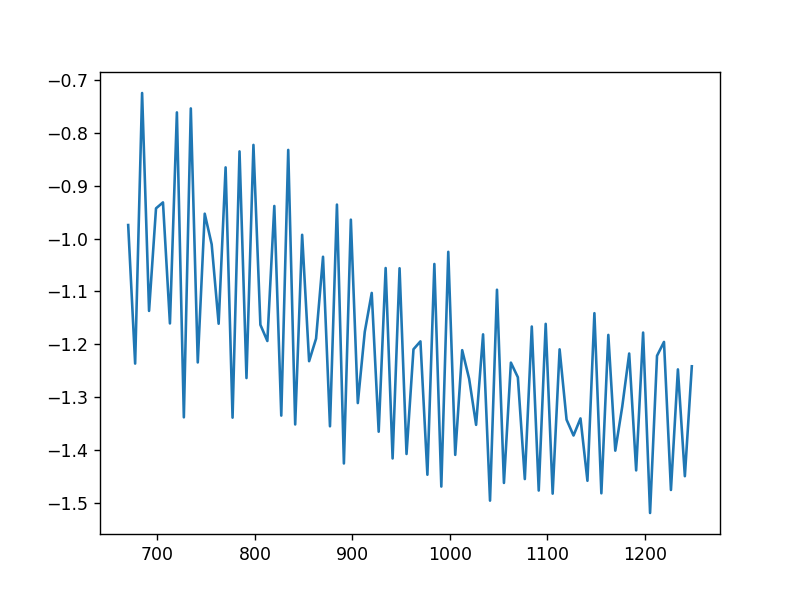

In [94]:
data, ID, comment, tags, name = read(title='ramseyZpulse',which=0)
x, y = data[0], data[1]
coordinate = [[1-2*j[i] for i in range(2)] for j in y]
theta = np.array([np.arctan(i[1]/i[0]) for i in coordinate])
plt.figure()
plt.plot(x[:,0],-theta)
plt.show()

# AC_Stark

<IPython.core.display.Javascript object>


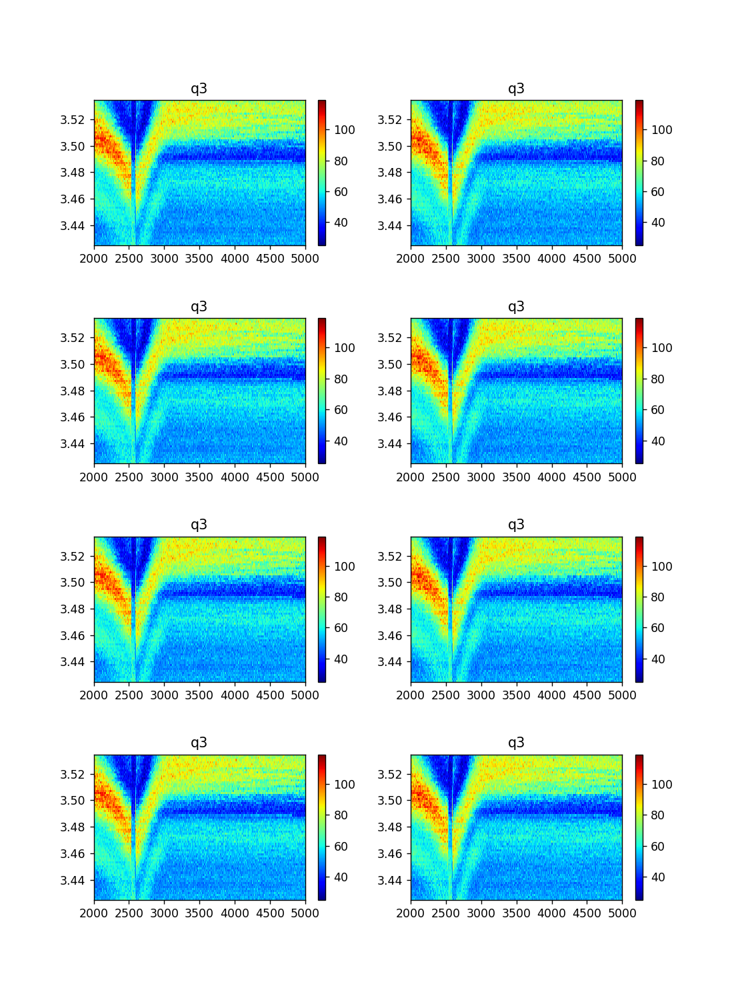

['q3'] 2020-12-15 23:58:12.660479


In [415]:
value,num,tags,finishtime = write(height=3,title='Ac_stark',which=8,peak=300)
print(tags,finishtime)

In [107]:
async def exMixing(f):
    qname = [i for i in f]
    f_ex = np.array([f[i] for i in f])
    ex_lo = f_ex.mean() + 50e6
    delta =  ex_lo - f_ex
    delta_ex = {qname[i]:delta[i] for i in range(len(qname))}
    # n = len(f_ex)
    return ex_lo, delta_ex

In [109]:
f_ex1, f_ex2 = {'f1':4e9},{'f2':3e9}
ex_lo1, delta_ex1 = await exMixing(f_ex1)
ex_lo2, delta_ex2 = await exMixing(f_ex2)

In [113]:
{**delta_ex1,**delta_ex2}

{'f1': 50000000.0, 'f2': 50000000.0}

<IPython.core.display.Javascript object>


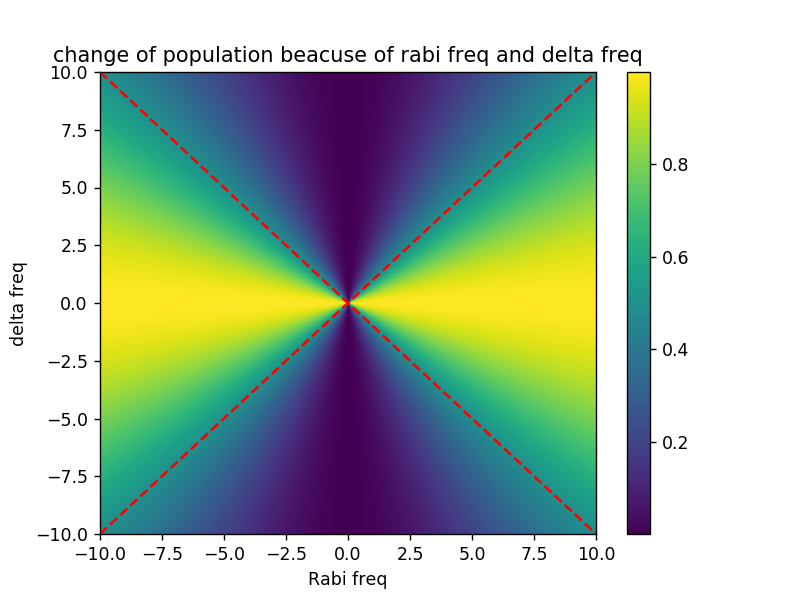

In [722]:
x = np.linspace(-10,10,1000)
z = np.linspace(-10,10,1000)
y = [x**2/(x**2+i**2) for i in z]
plt.figure()
plt.imshow(y,aspect='auto',origin='lower',extent=[min(x),max(x),min(z),max(z)])
plt.plot([-10,10],[-10,10],'r--')
plt.plot([-10,10],[10,-10],'r--')
plt.xlabel('Rabi freq')
plt.ylabel('delta freq')
plt.title('change of population beacuse of rabi freq and delta freq')
plt.colorbar()
plt.show()

In [515]:
def test(y,z=0,l=0):
    return y+z+l

In [516]:
def f(x,func,**kw):
    h = func(**kw)
    print('lala=',kw['l'])
    print(h+1)

In [518]:
f(10,test,y=1,z=2,l=11)

TypeError: f() takes 2 positional arguments but 3 were given

In [489]:
def f(l=[]):
    l.append(1)
    return l

In [490]:
f(l=['qq1'])

['qq1', 1]

In [491]:
f(l=['q2'])

['q2', 1]

In [492]:
f()

[1]

In [519]:
x = np.arange(0,1,0.01)

In [523]:
isinstance(x,np.ndarray)

True

In [533]:
f1, f2 = {}, {}

In [534]:
f2['q1'] = 1

In [535]:
f1

{}

In [25]:
def predistort(waveform, sRate, zCali):
    """Predistort input waveform.
    Parameters
    ----------
        waveform : complex numpy array
            Waveform data to be pre-distorted
        zCali: [2.55e-9, -28e-3, 8.02e-9, -28e-3, 101.5e-9, -14.5e-3,369.7e-9,-6.2e-3]
    Returns
    -------
    waveform : complex numpy array
        Pre-distorted waveform
    """
    dt = 1 / sRate
    wf_size = len(waveform)
    tau1, A1, tau2, A2, tau3, A3, tau4, A4, tau5, A5 = zCali
    print('tau:', tau1, A1, tau2, A2, tau3, A3, tau4, A4, tau5, A5)
    # pad with zeros at end to make sure response has time to go to zero
    # pad_time = 6 * max([tau1, tau2, tau3])
    pad_time = 4e-6  # 这里默认改为增加4us的pad，返回时舍去1us，保留3us拖尾
    pad_size = round(pad_time / dt)
    pad_size_2 = round(3e-6 / dt)  # 保留的点数
    padded_zero = np.zeros(pad_size)
    padded = np.append(waveform,padded_zero)

    Y = np.fft.rfft(padded, norm='ortho')

    omega = 2 * np.pi * np.fft.rfftfreq(wf_size+pad_size, dt)
    H = (1 + (1j * A1 * omega * tau1) / (1j * omega * tau1 + 1) +
         (1j * A2 * omega * tau2) / (1j * omega * tau2 + 1) +
         (1j * A3 * omega * tau3) / (1j * omega * tau3 + 1) +
         (1j * A4 * omega * tau4) / (1j * omega * tau4 + 1)+
         (1j * A5 * omega * tau5) / (1j * omega * tau5 + 1))

    Yc = Y / H
    yc = np.fft.irfft(Yc, norm='ortho')
    # return yc[:wf_size]
    #这里返回增加了3us拖尾的序列
    return yc[:(wf_size+pad_size_2)]

In [1757]:
250000-7500

242500

tau: 2.55e-09 -0.028 8.02e-09 -0.028 1.015e-07 -0.0145 3.697e-07 -0.0062 5e-09 -0.005


<IPython.core.display.Javascript object>


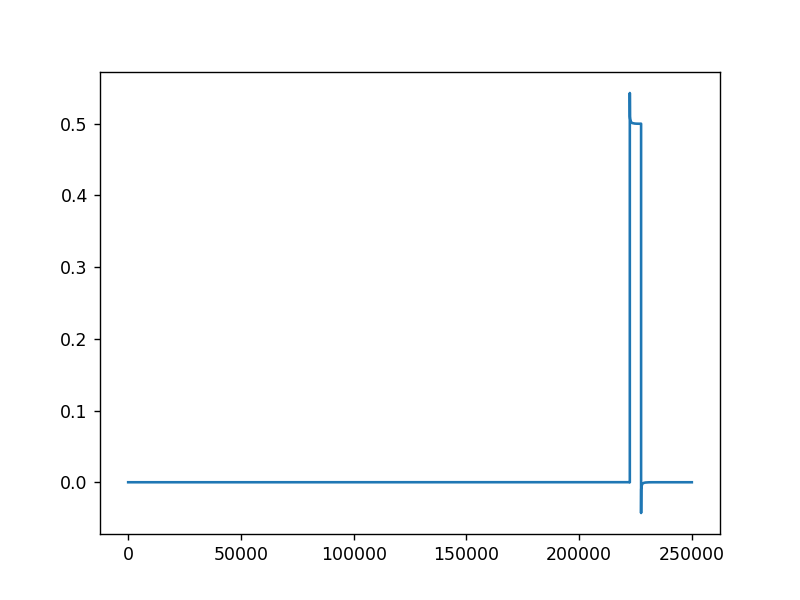

In [39]:
t = np.linspace(-90000,7000,242500)*1e-9
w = wn.square(2000e-9)*0.5
wave = w(t)
I = predistort(wave,2.5e9,[2.55e-9, -28e-3, 8.02e-9, -28e-3, 101.5e-9, -14.5e-3,369.7e-9,-6.2e-3,5e-9,-5e-3])
plt.figure()
plt.plot(I)
plt.show()

In [34]:
len(np.array((np.arange(10),))+np.array((np.arange(10),)))

1

In [16]:
z_new = a*b*np.exp(b*x) + c*d*np.exp(d*x) 
# z_new = z_new/np.max(np.abs(z_new))
# x = Twoexp(para,t)
def hfunc(x):
    global z_new
#     y = (a*b*np.exp(b*x) + c*d*np.exp(d*x))/np.max(np.abs(a*b*np.exp(b*x) + c*d*np.exp(d*x)))
    
    H = np.fft.fft(z_new) + 1/2/np.pi
    h = np.fft.ifft(H)
    return h, H

In [17]:
t = np.linspace(-90000,10000,250000)
w = wn.square(5000)
wave = w(t)
h, H = hfunc(t)
wave_cali = np.convolve(wave,h,'same')

In [1696]:
h, H = hfunc(t)
wave_cali = np.fft.irfft(np.fft.rfft(wave)/H)

C:\WPy64-3740\python-3.7.4.amd64\lib\site-packages\ipykernel_launcher.py:4: RuntimeWarning: overflow encountered in exp
  after removing the cwd from sys.path.


<IPython.core.display.Javascript object>


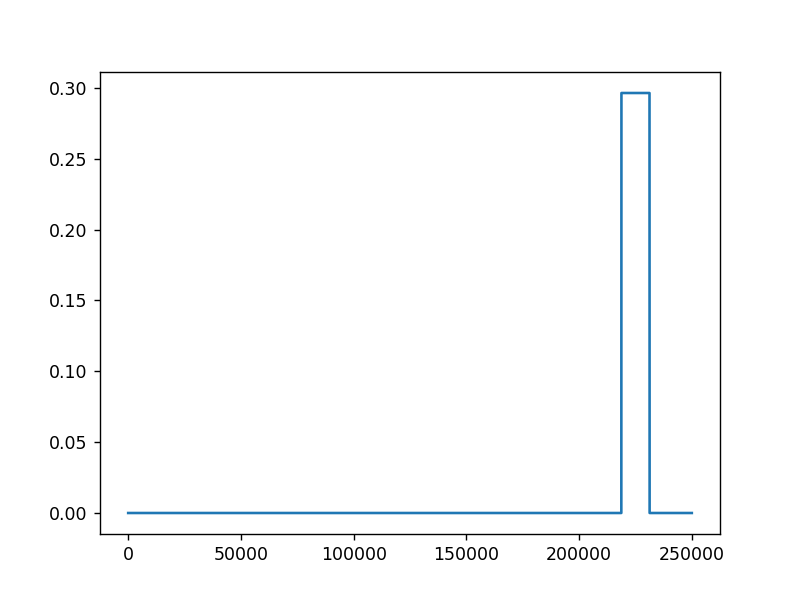

In [19]:
plt.figure()
plt.plot(np.abs(wave_cali))
plt.show()

In [82]:
# help(np.convolve)

# 处理html文件

In [484]:
from qulab import getplotlydat
gpd = imp.reload(getplotlydat)

In [469]:
htmlfile = open(r'D:\step1\14Q1changePwr.html', 'r', encoding='utf-8')
htmlhandle = htmlfile.read()

In [470]:
from bs4 import BeautifulSoup

soup = BeautifulSoup(htmlhandle, 'lxml')

In [485]:
path = r'D:\step1\14Q1changePwr.html'
x, y, z = gpd.gethtmldata(path,flag='x'), gpd.gethtmldata(path,flag='y'), gpd.gethtmldata(path,flag='z')

In [401]:
np.append(np.append(np.arange(1000,2900,40),np.arange(2900,2920,4)),np.arange(2920,2970,1))

array([1000, 1040, 1080, 1120, 1160, 1200, 1240, 1280, 1320, 1360, 1400,
       1440, 1480, 1520, 1560, 1600, 1640, 1680, 1720, 1760, 1800, 1840,
       1880, 1920, 1960, 2000, 2040, 2080, 2120, 2160, 2200, 2240, 2280,
       2320, 2360, 2400, 2440, 2480, 2520, 2560, 2600, 2640, 2680, 2720,
       2760, 2800, 2840, 2880, 2900, 2904, 2908, 2912, 2916, 2920, 2921,
       2922, 2923, 2924, 2925, 2926, 2927, 2928, 2929, 2930, 2931, 2932,
       2933, 2934, 2935, 2936, 2937, 2938, 2939, 2940, 2941, 2942, 2943,
       2944, 2945, 2946, 2947, 2948, 2949, 2950, 2951, 2952, 2953, 2954,
       2955, 2956, 2957, 2958, 2959, 2960, 2961, 2962, 2963, 2964, 2965,
       2966, 2967, 2968, 2969])

<IPython.core.display.Javascript object>


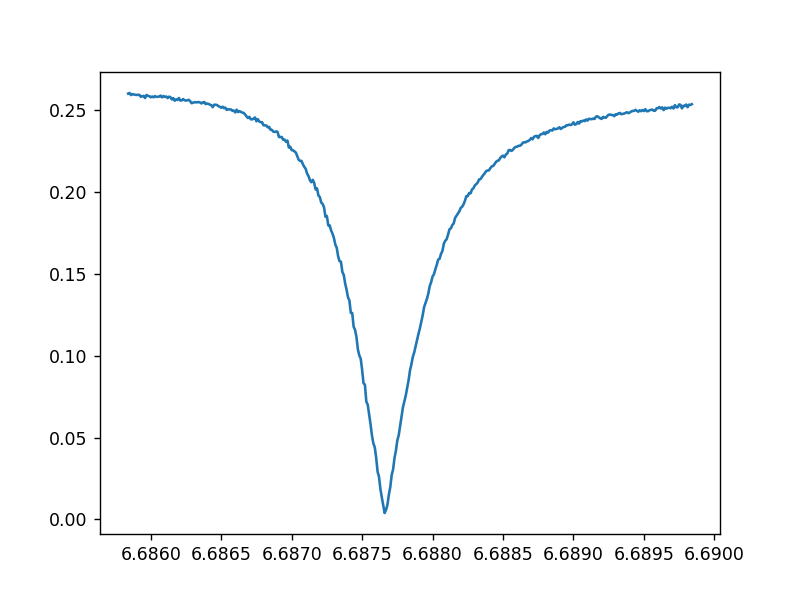

In [492]:
plt.figure()
plt.plot(x[0,:],z[-1])
plt.show()

In [461]:
gpd.initfile(path)[4]-gpd.initfile(path)[3]

422702

In [266]:
data = soup.find('div',{'class':"plotly-graph-div"})
data

<div class="plotly-graph-div" id="9a8d02f7-44bb-4595-8eb9-130b36381b22" style="height:100%; width:100%;"></div>

In [267]:
# help(data)

In [471]:
soup

<html>
<head><meta charset="utf-8"/></head>
<body>
<div>
<script type="text/javascript">window.PlotlyConfig = {MathJaxConfig: 'local'};</script>
<script type="text/javascript">/**
* plotly.js v1.48.1
* Copyright 2012-2019, Plotly, Inc.
* All rights reserved.
* Licensed under the MIT license
*/
!function(t){if("object"==typeof exports&&"undefined"!=typeof module)module.exports=t();else if("function"==typeof define&&define.amd)define([],t);else{("undefined"!=typeof window?window:"undefined"!=typeof global?global:"undefined"!=typeof self?self:this).Plotly=t()}}(function(){return function(){return function t(e,r,n){function i(o,s){if(!r[o]){if(!e[o]){var l="function"==typeof require&&require;if(!s&&l)return l(o,!0);if(a)return a(o,!0);var c=new Error("Cannot find module '"+o+"'");throw c.code="MODULE_NOT_FOUND",c}var u=r[o]={exports:{}};e[o][0].call(u.exports,function(t){return i(e[o][1][t]||t)},u,u.exports,t,e,r,n)}return r[o].exports}for(var a="function"==typeof require&&require,o=0;o<n.

In [199]:
f0, Qi, Qe, QL, phi, f, s = op.Cavity_fit().fitCavity(f,s21)

0.0003599999999996939


In [191]:
f0, Qi, Qe, QL, phi

(6.391316859672923,
 22621.98170102801,
 9125.835246856113,
 6502.635387493445,
 0.2938967941595496)

<IPython.core.display.Javascript object>


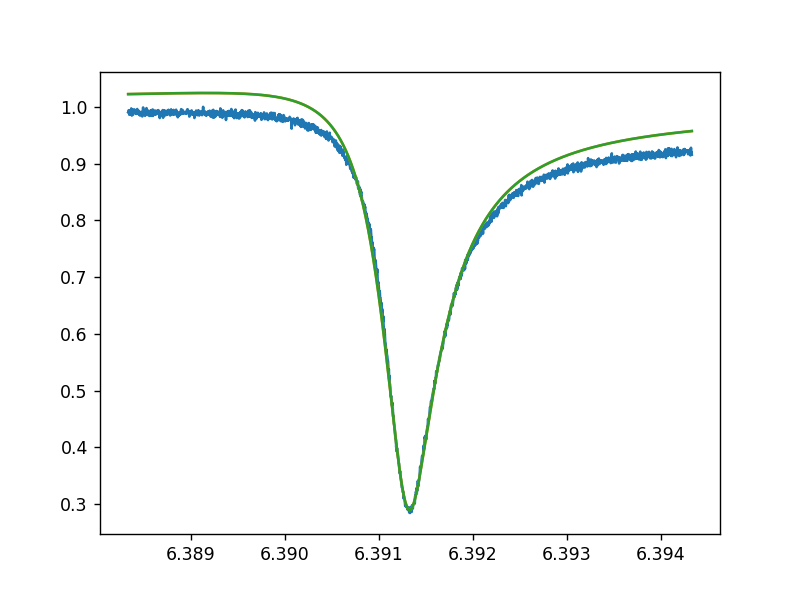

In [201]:
plt.figure()
plt.plot(f,np.abs(s))
plt.plot(f,1/np.abs(op.Cavity_fit().invS21(f, f0, Qi, Qe, phi)))
plt.show()

In [166]:
6.39176-6.39103

0.0007299999999998974

<IPython.core.display.Javascript object>


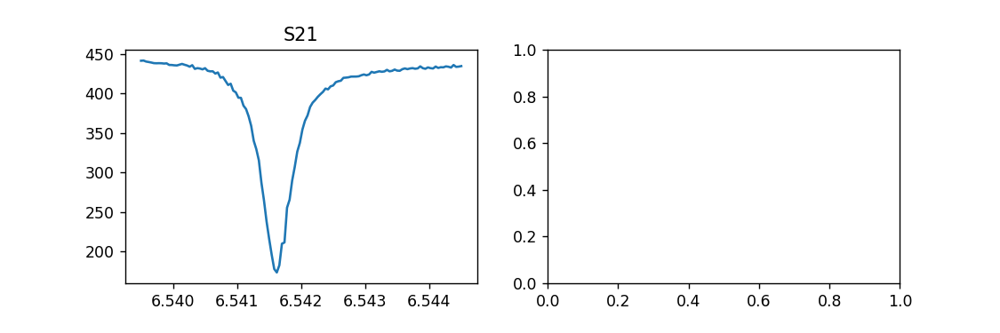

['q4'] 2020-07-12 16:31:13.371257


In [197]:
value,num,tags,finishtime = write(title='S21',height=3,which=1000,peak=11200)
print(tags,finishtime)

In [198]:
x, y = value[0][0], np.abs(value[0][1])

In [273]:
data = np.load(r'C:\Users\23967\Desktop\tozsk\192739Scanfr.npz')
x, y = data['ffrr'], np.abs(data['dataGhz'])

In [122]:
import scipy.signal as signal

In [123]:
x_new = np.linspace(min(x),max(x),1001)
z = signal.resample_poly(y,1001,126,padtype='line')

In [199]:
peaks_index= signal.find_peaks(-y,height=-300,width=0.002)
peaks_index

In [270]:
z= op.RowToRipe().smooth(y,f0=0.015)

In [274]:
index, prominences = op.RowToRipe().findPeaks(y)

<IPython.core.display.Javascript object>


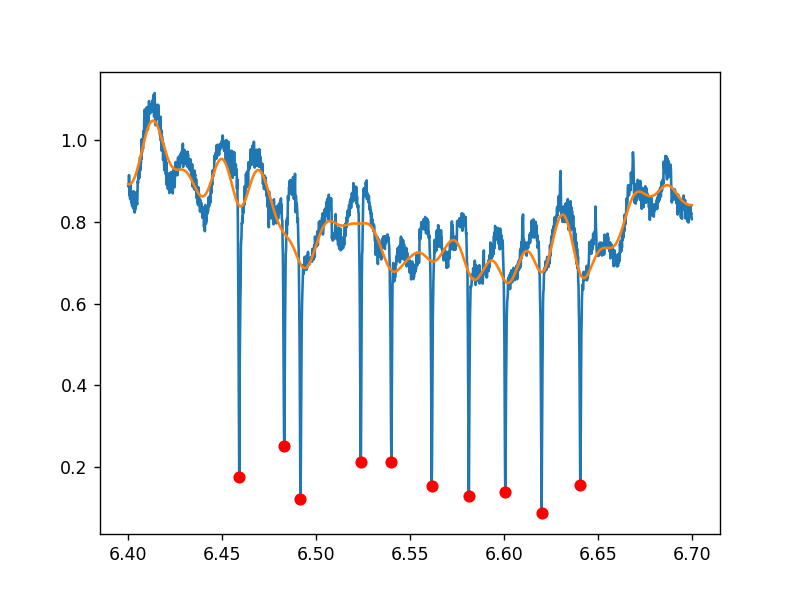

In [275]:
plt.figure()
plt.plot(x,y)
plt.plot(x,z)
plt.plot(x[index],y[index],'ro')
# plt.plot([x[46],x[60]],[y[46],y[60]])
# plt.plot([x[peaks_index[0][0]]]*2,[173.34117099,262.52528213+173.34117099])
# plt.plot(x[peaks_index[0]],y[peaks_index[0]],'ro')

In [338]:
t = np.linspace(-10,10,10001)
y = signal.chirp(t,0,10,100)

<IPython.core.display.Javascript object>


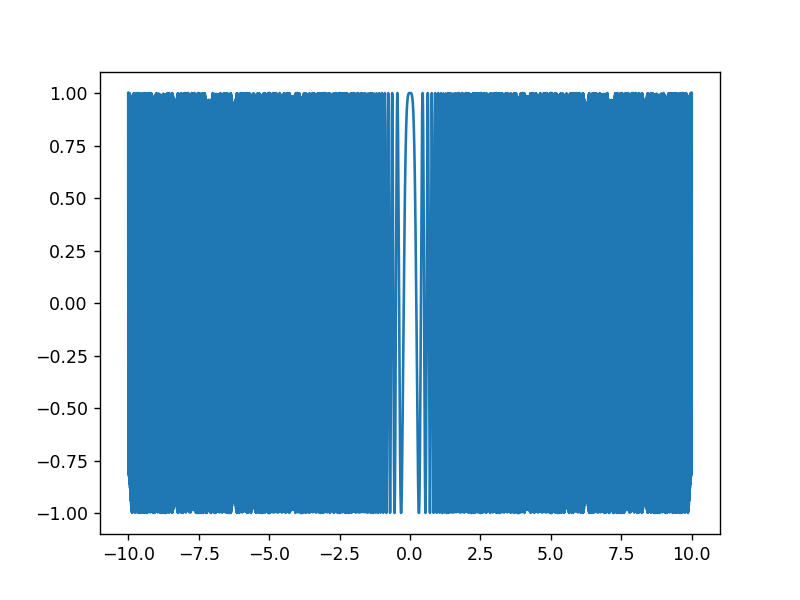

In [339]:
plt.figure()
plt.plot(t,y)
# plt.plot(x,z)

In [638]:
import inspect as insp

In [479]:
x = insp.getfullargspec(f)

In [642]:
functions_list = [o for o in insp.getmembers(op) if insp.isfunction(o[1])]

In [643]:
functions_list

[('bh',
  <function scipy.optimize._basinhopping.basinhopping(func, x0, niter=100, T=1.0, stepsize=0.5, minimizer_kwargs=None, take_step=None, accept_test=None, callback=None, interval=50, disp=False, niter_success=None, seed=None)>),
 ('curve_fit',
  <function scipy.optimize.minpack.curve_fit(f, xdata, ydata, p0=None, sigma=None, absolute_sigma=False, check_finite=True, bounds=(-inf, inf), method=None, jac=None, **kwargs)>),
 ('ls',
  <function scipy.optimize._lsq.least_squares.least_squares(fun, x0, jac='2-point', bounds=(-inf, inf), method='trf', ftol=1e-08, xtol=1e-08, gtol=1e-08, x_scale=1.0, loss='linear', f_scale=1.0, diff_step=None, tr_solver=None, tr_options={}, jac_sparsity=None, max_nfev=None, verbose=0, args=(), kwargs={})>),
 ('pTorho', <function qulab.optimize.pTorho(plist)>)]

FullArgSpec(args=['x', 'y', 'z', 'k'], varargs='args', varkw='kw', defaults=(0, 9), kwonlyargs=[], kwonlydefaults=None, annotations={})

In [485]:
x[3]

(0, 9)

In [483]:
help(insp.getfullargspec)

Help on function getfullargspec in module inspect:

getfullargspec(func)
    Get the names and default values of a callable object's parameters.
    
    A tuple of seven things is returned:
    (args, varargs, varkw, defaults, kwonlyargs, kwonlydefaults, annotations).
    'args' is a list of the parameter names.
    'varargs' and 'varkw' are the names of the * and ** parameters or None.
    'defaults' is an n-tuple of the default values of the last n parameters.
    'kwonlyargs' is a list of keyword-only parameter names.
    'kwonlydefaults' is a dictionary mapping names from kwonlyargs to defaults.
    'annotations' is a dictionary mapping parameter names to annotations.
    
    Notable differences from inspect.signature():
      - the "self" parameter is always reported, even for bound methods
      - wrapper chains defined by __wrapped__ *not* unwrapped automatically



In [468]:
def f(**kws):
    x,y = kws['x'], kws['y']
    print(x,y)

In [572]:
from configparser import ConfigParser

In [573]:
cp = ConfigParser()
cp.read(r'D:\QuLabData\config\status.ini')

['D:\\QuLabData\\config\\status.ini']

In [645]:
cp.set('rabi','nwave','')

In [581]:
cp.add_section('Ramsey')

In [582]:
with open(r'D:\QuLabData\config\status.ini','w') as file:
    cp.write(file)

In [505]:
x = insp.getfullargspec(f)

In [506]:
x

FullArgSpec(args=['x', 'y'], varargs=None, varkw=None, defaults=(1.1,), kwonlyargs=[], kwonlydefaults=None, annotations={'x': <class 'int'>})

In [507]:
x.annotations

{'x': int}

In [510]:
type(x.defaults[0])

float

In [511]:
type(None)

NoneType

In [525]:
def f(x,y=1,z=None):
    print(x,y,z)

In [527]:
f(**{'x':1,'y':2,'z':3})

1 2 3


In [564]:
import yaml

In [569]:
with open('D:\QuLabData\config\status.yaml','r',encoding='utf-8') as ym:
    data = ym.read()

In [567]:
data = yaml.load(data,Loader=yaml.Loader)

In [570]:
data

'test: haha\n'

In [553]:
from ruamel import yaml

In [561]:
x = {'test':'haha'}
with open('D:\QuLabData\config\status.yaml','w',encoding='utf-8') as ym:
    yaml.dump(x, ym, Dumper=yaml.RoundTripDumper)

In [583]:
from pathlib import Path

In [594]:
pathnow = Path('D:\QuLabData\config') / time.strftime('%Y') / time.strftime('%m%d')
fname = f"{name}_{time.strftime('%H%M%S')}.ini"
# pathnow = pathnow / fname
pathnow.mkdir(parents=True, exist_ok=True)

In [595]:
with open(pathnow/fname,'w') as file:
    pass

In [233]:
import pymongo
myclient = pymongo.MongoClient('10.122.7.19',27017)
mydb = myclient["test"]
mycol = mydb["test"]

In [600]:
x = ['1','2']

In [630]:
from mongoengine import (BooleanField, ComplexDateTimeField, Document,
                         FileField, IntField, ListField, ReferenceField,
                         StringField, ObjectIdField)

In [604]:
# from qulab.storage.schema import Record

In [631]:
f = ObjectIdField(cp)

TypeError: db_field should be a string.

In [653]:
from qulab import configread
configread.updatefileattr(cw)

In [654]:
configread.updatefileattr(cw)

NameError: name 'cw' is not defined

In [1]:
import asyncio

In [2]:
loop = asyncio.get_event_loop()

In [3]:
async def test():
    for i in range(10):
        print(f'{i}')

In [5]:
loop.run_until_complete(asyncio.wait([test()]))

RuntimeError: This event loop is already running

0
1
2
3
4
5
6
7
8
9


In [4]:
loop.stop()

In [4]:
loop.close()

RuntimeError: Cannot close a running event loop

In [122]:
def namepack(task):
    # task_run1 = []
    for i in task:
        keyname = list(i.keys())
        task1, task2, task3, task4 = [], [], [], []
        for j in keyname:
            if 'awg131' in j:
                task1.append(i[j])
            if 'awg132' in j:
                task2.append(i[j])
            if 'awg133' in j:
                task3.append(i[j])
            if 'awg134' in j:
                task4.append(i[j])
#         print(task1, task2, task3, task4)
        for k in range(8):
            task_run1 = []
            if len(task1) == len(task2) == len(task3) == len(task4) == 0:
                continue
            if len(task1) != 0:
                task_run1.append(task1.pop(0))
            if len(task2) != 0:
                task_run1.append(task2.pop(0))
            if len(task3) != 0:
                task_run1.append(task3.pop(0))
            if len(task4) != 0:
                task_run1.append(task4.pop(0))
#             print(task1, task2, task3, task4)
            yield task_run1

In [125]:
task = [{'awg131_ch1':1,'awg131_ch2':2,'awg133_ch1':3},{}]

In [478]:
async def zManage(measure,dcstate={},calimatrix=None,qnum=10):
    len_data = 0
    for i,j in enumerate(dcstate):
        x = dcstate[j]
        if not isinstance(dcstate[j],Iterable):
            x = np.array([dcstate[j]])
        dcstate[j] = x
        len_data = len(x)
            
    bias_dict = {}
    qubits = measure
    if qnum < 10:
        qubits = {}
        for i in measure:
            if i in dcstate:
                qubits[i] = measure[i]
    for i,j in enumerate(qubits):

        bias_dict[j] = np.array(dcstate[j]) if j in dcstate else np.array([0]*len_data)

    bias = np.array(list(bias_dict.values()))

    matrix = np.mat(np.eye(qnum)) if calimatrix is None else np.mat(calimatrix)
        
    current = np.array(matrix.I * np.mat(bias))
    current = {j:current[i,:] for i,j in enumerate(qubits)}
    return current

In [475]:
calimatrix1 = np.load(r'D:/QuLabData/2020/1212/crosstalk_cali_correct_20201212231657.npz')['mat']
# calimatrix1 = np.load(r'D:/QuLabData/2020/1203/crosstalk_cali/zheng2_crosstalk_q1-10_20201203154147.npz')['mat']
calimatrix=np.mat(calimatrix1)

In [476]:
measure = {f'q{i+1}':i for i in range(10)}

In [486]:
from collections import Iterable
await zManage(measure,dcstate={f'q{i+1}':[i,i+1] for i in range(10)},calimatrix=calimatrix,qnum=10)

{'q1': array([0.11013712, 1.10582168]),
 'q2': array([0.88856774, 1.89544743]),
 'q3': array([1.87320634, 2.8792815 ]),
 'q4': array([2.88084522, 3.8977401 ]),
 'q5': array([3.90313022, 4.92310802]),
 'q6': array([4.86329577, 5.88056191]),
 'q7': array([6.13431076, 7.12096499]),
 'q8': array([7.15303981, 8.14389269]),
 'q9': array([7.9675893 , 8.93875608]),
 'q10': array([8.95553595, 9.97444936])}

In [484]:
np.mat(calimatrix).I[2,:]*np.mat([0,1,2,3,4,5,6,7,8,9]).T

matrix([[1.87320634]])

In [8]:
import plotly.graph_objects as go

f = go.FigureWidget()
f.add_scatter(y=[2, 1, 4, 3])
f.add_bar(y=[1, 4, 3, 2])
f.layout.title = 'Hello FigureWidget'
scatter = f.data[0]
scatter.y = [3, 1, 4, 3]
f.layout.title.text = 'This is a new title'

In [760]:
import plotly.graph_objects as go

trace = go.Heatmap(z=[[1, 20, 30, 50, 1], [20, 1, 60, 80, 30], [30, 60, 1, -10, 20]],
                   x=['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday'],
                   y=['Morning', 'Afternoon', 'Evening'])
data=[trace]
layout = go.Layout(title='Activity Heatmap')

figure = go.Figure(data=data, layout=layout)

f2 = go.FigureWidget(figure)
f2

ModuleNotFoundError: No module named 'plotly'

In [9]:
f.show()

In [3]:
from qulab.math import qst

In [6]:
list(qst.transformList(10))

[('I', 'I', 'I', 'I', 'I', 'I', 'I', 'I', 'I', 'I'),
 ('I', 'I', 'I', 'I', 'I', 'I', 'I', 'I', 'I', 'X'),
 ('I', 'I', 'I', 'I', 'I', 'I', 'I', 'I', 'I', 'Y'),
 ('I', 'I', 'I', 'I', 'I', 'I', 'I', 'I', 'X', 'I'),
 ('I', 'I', 'I', 'I', 'I', 'I', 'I', 'I', 'X', 'X'),
 ('I', 'I', 'I', 'I', 'I', 'I', 'I', 'I', 'X', 'Y'),
 ('I', 'I', 'I', 'I', 'I', 'I', 'I', 'I', 'Y', 'I'),
 ('I', 'I', 'I', 'I', 'I', 'I', 'I', 'I', 'Y', 'X'),
 ('I', 'I', 'I', 'I', 'I', 'I', 'I', 'I', 'Y', 'Y'),
 ('I', 'I', 'I', 'I', 'I', 'I', 'I', 'X', 'I', 'I'),
 ('I', 'I', 'I', 'I', 'I', 'I', 'I', 'X', 'I', 'X'),
 ('I', 'I', 'I', 'I', 'I', 'I', 'I', 'X', 'I', 'Y'),
 ('I', 'I', 'I', 'I', 'I', 'I', 'I', 'X', 'X', 'I'),
 ('I', 'I', 'I', 'I', 'I', 'I', 'I', 'X', 'X', 'X'),
 ('I', 'I', 'I', 'I', 'I', 'I', 'I', 'X', 'X', 'Y'),
 ('I', 'I', 'I', 'I', 'I', 'I', 'I', 'X', 'Y', 'I'),
 ('I', 'I', 'I', 'I', 'I', 'I', 'I', 'X', 'Y', 'X'),
 ('I', 'I', 'I', 'I', 'I', 'I', 'I', 'X', 'Y', 'Y'),
 ('I', 'I', 'I', 'I', 'I', 'I', 'I', 'Y', 'I',